In [ ]:
1. Tokenization of text after various preprocessing
2. TFIDF
3. Variance Selection. Threshold

In [230]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:95% !important; }</style>"))

In [2]:
import pandas as pd
import numpy as np
import ast
import glob
import re
from string import punctuation
from emoji import demojize
from sklearn.feature_extraction.text import TfidfVectorizer
import plotly.express as px
from sklearn.decomposition import PCA
from sklearn.decomposition import LatentDirichletAllocation
import pyLDAvis
import pyLDAvis.sklearn
pyLDAvis.enable_notebook()

/Users/aayushagrawal/anaconda3/lib/python3.7/site-packages/past/builtins/misc.py:45: DeprecationWarning:

the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses



In [3]:
import pandas as pd
all_files = glob.glob("/Users/aayushagrawal/Downloads/gmail_api/emails_csv_all/*.csv")
li = []

for filename in all_files:
    df = pd.read_csv(filename)
    li.append(df)

frame = pd.concat(li, axis=0, ignore_index=True)
frame.head()

,id,threadId,labelIds,snippet,payload,sizeEstimate,historyId,internalDate
0,16feef748c2ecac1,16feef748c2ecac1,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Follow us on Download App ADDA Logo Trifecta S...,"{'partId': '', 'mimeType': 'text/html', 'filen...",17007,4819485,1580262180000
1,16febc8c08ac89a0,16febc8c08ac89a0,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Don&#39;t want convenience delivered to your i...,"{'partId': '', 'mimeType': 'multipart/alternat...",23141,4817367,1580208799000
2,16febaa703fdebbc,16febaa703fdebbc,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Splitwise Priya (priyakedia100@gmail.com) just...,"{'partId': '', 'mimeType': 'multipart/alternat...",17585,4817365,1580206811000
3,16feb9ef33105713,16feb9ef33105713,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",YOUR EXPERIAN CREDIT REPORT &amp; EXPERIAN CRE...,"{'partId': '', 'mimeType': 'multipart/mixed', ...",82035,4817364,1580206012000
4,16feb4e51245e098,16feb4e51245e098,"['CATEGORY_UPDATES', 'INBOX']",See What&#39;s New in January My Account Find ...,"{'partId': '', 'mimeType': 'multipart/alternat...",172213,4816694,1580197830000


In [4]:
def parse_mail(x, pattern = '(.+?)<'):
    try:
        found = re.search(pattern, x).group(1)
    except AttributeError:
        found = np.nan
    return(found)  

In [5]:
frame["headers"] = frame["payload"].apply(lambda x:ast.literal_eval(x).get("headers"))
frame["headers_keys"] = frame["headers"].apply(lambda x: pd.DataFrame(x)["name"].str.lower().values.tolist())
frame["from"] = frame["headers"].apply(
    lambda x:dict(
        zip(pd.DataFrame(x)["name"].str.lower().values.tolist(), 
            pd.DataFrame(x)["value"].values.tolist()))["from"]
)

frame["from_email"] = frame["from"].apply(lambda x:parse_mail(x, "<(.+?)>"))
frame["from_name"] = frame["from"].apply(lambda x:parse_mail(x, "(.+?)<"))

frame_sub = frame[["subject" in elem for elem in frame["headers_keys"]]].reset_index(drop = True)
frame_sub["subject"] = frame_sub["headers"].apply(
    lambda x:dict(zip(pd.DataFrame(x)["name"].str.lower().values.tolist(), 
                      pd.DataFrame(x)["value"].values.tolist()))["subject"]
)

frame_sub.head()

,id,threadId,labelIds,snippet,payload,sizeEstimate,historyId,internalDate,headers,headers_keys,from,from_email,from_name,subject
0,16feef748c2ecac1,16feef748c2ecac1,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Follow us on Download App ADDA Logo Trifecta S...,"{'partId': '', 'mimeType': 'text/html', 'filen...",17007,4819485,1580262180000,"[{'name': 'Delivered-To', 'value': 'aagrawal52...","[delivered-to, received, x-google-smtp-source,...",Trifecta Starlight ADDA <support@apartmentadda...,support@apartmentadda.com,Trifecta Starlight ADDA,Daily Digest
1,16febc8c08ac89a0,16febc8c08ac89a0,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Don&#39;t want convenience delivered to your i...,"{'partId': '', 'mimeType': 'multipart/alternat...",23141,4817367,1580208799000,"[{'name': 'Delivered-To', 'value': 'aagrawal52...","[delivered-to, received, x-google-smtp-source,...",Swiggy Go <no-reply@swiggy.in>,no-reply@swiggy.in,Swiggy Go,We’ve got your 2020 prediction for you. Ready? 🔮
2,16febaa703fdebbc,16febaa703fdebbc,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Splitwise Priya (priyakedia100@gmail.com) just...,"{'partId': '', 'mimeType': 'multipart/alternat...",17585,4817365,1580206811000,"[{'name': 'Delivered-To', 'value': 'aagrawal52...","[delivered-to, received, x-google-smtp-source,...",Splitwise <hello@splitwise.com>,hello@splitwise.com,Splitwise,Priya deleted the group 'Kolkata' on Splitwise
3,16feb9ef33105713,16feb9ef33105713,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",YOUR EXPERIAN CREDIT REPORT &amp; EXPERIAN CRE...,"{'partId': '', 'mimeType': 'multipart/mixed', ...",82035,4817364,1580206012000,"[{'name': 'Delivered-To', 'value': 'aagrawal52...","[delivered-to, received, x-google-smtp-source,...",<ExperianCreditView@experian.com>,ExperianCreditView@experian.com,NaN,Experian Credit Report and Credit Score throug...
4,16feb4e51245e098,16feb4e51245e098,"['CATEGORY_UPDATES', 'INBOX']",See What&#39;s New in January My Account Find ...,"{'partId': '', 'mimeType': 'multipart/alternat...",172213,4816694,1580197830000,"[{'name': 'Delivered-To', 'value': 'aagrawal52...","[delivered-to, received, x-google-smtp-source,...",Marriott Bonvoy <marriottbonvoy@email-marriott...,marriottbonvoy@email-marriott.com,Marriott Bonvoy,Your Marriott Bonvoy Account Update: Special O...


In [6]:
frame_sub["snippet_subject"] = frame_sub["subject"] + " " + frame_sub["snippet"]
frame_sub.head()

,id,threadId,labelIds,snippet,payload,sizeEstimate,historyId,internalDate,headers,headers_keys,from,from_email,from_name,subject,snippet_subject
0,16feef748c2ecac1,16feef748c2ecac1,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Follow us on Download App ADDA Logo Trifecta S...,"{'partId': '', 'mimeType': 'text/html', 'filen...",17007,4819485,1580262180000,"[{'name': 'Delivered-To', 'value': 'aagrawal52...","[delivered-to, received, x-google-smtp-source,...",Trifecta Starlight ADDA <support@apartmentadda...,support@apartmentadda.com,Trifecta Starlight ADDA,Daily Digest,Daily Digest Follow us on Download App ADDA Lo...
1,16febc8c08ac89a0,16febc8c08ac89a0,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Don&#39;t want convenience delivered to your i...,"{'partId': '', 'mimeType': 'multipart/alternat...",23141,4817367,1580208799000,"[{'name': 'Delivered-To', 'value': 'aagrawal52...","[delivered-to, received, x-google-smtp-source,...",Swiggy Go <no-reply@swiggy.in>,no-reply@swiggy.in,Swiggy Go,We’ve got your 2020 prediction for you. Ready? 🔮,We’ve got your 2020 prediction for you. Ready?...
2,16febaa703fdebbc,16febaa703fdebbc,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Splitwise Priya (priyakedia100@gmail.com) just...,"{'partId': '', 'mimeType': 'multipart/alternat...",17585,4817365,1580206811000,"[{'name': 'Delivered-To', 'value': 'aagrawal52...","[delivered-to, received, x-google-smtp-source,...",Splitwise <hello@splitwise.com>,hello@splitwise.com,Splitwise,Priya deleted the group 'Kolkata' on Splitwise,Priya deleted the group 'Kolkata' on Splitwise...
3,16feb9ef33105713,16feb9ef33105713,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",YOUR EXPERIAN CREDIT REPORT &amp; EXPERIAN CRE...,"{'partId': '', 'mimeType': 'multipart/mixed', ...",82035,4817364,1580206012000,"[{'name': 'Delivered-To', 'value': 'aagrawal52...","[delivered-to, received, x-google-smtp-source,...",<ExperianCreditView@experian.com>,ExperianCreditView@experian.com,NaN,Experian Credit Report and Credit Score throug...,Experian Credit Report and Credit Score throug...
4,16feb4e51245e098,16feb4e51245e098,"['CATEGORY_UPDATES', 'INBOX']",See What&#39;s New in January My Account Find ...,"{'partId': '', 'mimeType': 'multipart/alternat...",172213,4816694,1580197830000,"[{'name': 'Delivered-To', 'value': 'aagrawal52...","[delivered-to, received, x-google-smtp-source,...",Marriott Bonvoy <marriottbonvoy@email-marriott...,marriottbonvoy@email-marriott.com,Marriott Bonvoy,Your Marriott Bonvoy Account Update: Special O...,Your Marriott Bonvoy Account Update: Special O...


In [10]:
import string
printable = set(string.printable)

In [15]:
filter(lambda x: x in printable, "sjbcjsc2").

'<filter object at 0x7fcaddb96128>'

In [42]:
def process_text(x):
    x = x.lower()
    x = re.sub(r"https?://\S+", " ", x)
    x = re.sub(f"[{re.escape(punctuation)}]", " ", x)
    x = " ".join(x.split())
    x = " ".join([w for w in x.split() if w.isalpha()])
    x = re.sub(r'(.)\1{3,}',r'\1', x)
    ''.join(filter(lambda x: x in printable, x))
    x = demojize(x)
    doc = nlp(x)
    #tokens = [token.text for token in doc if len(token) > 1]
    tokens = [token.lemma_ for token in doc if len(token) > 1]
    
    return(tokens)

In [23]:
import warnings
warnings.filterwarnings('ignore', 'SelectableGroups dict interface')

In [24]:
import spacy
nlp = spacy.load("en_core_web_sm")

In [43]:
frame_sub["tokenized_text"] = frame_sub["snippet_subject"].apply(lambda x: process_text(x) if (type(x) == str) else [])

In [44]:
def identity_tokenizer(text):
    return text

tfidf = TfidfVectorizer(tokenizer=identity_tokenizer, lowercase=False, stop_words="english")    
X_transformed = tfidf.fit_transform(frame_sub["tokenized_text"].values.tolist())

/Users/aayushagrawal/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:391: UserWarning:

Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['b', 'c', 'd', 'e', 'f', 'g', 'h', 'k', 'l', 'm', 'n', 'o', 'p', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y'] not in stop_words.



In [45]:
tfidf.get_feature_names()

['-PRON-',
 'aa',
 'aaa',
 'aadaar',
 'aadhaar',
 'aadhar',
 'aadil',
 'aaditya',
 'aadmi',
 'aadvik',
 'aae',
 'aaj',
 'aakanksha',
 'aakash',
 'aakhiri',
 'aam',
 'aap',
 'aarey',
 'aargo',
 'aaron',
 'aaush',
 'aavas',
 'aave',
 'aaya',
 'aayenge',
 'aayu',
 'aayuagr',
 'aayus',
 'aayush',
 'aayushaayush',
 'aayushagr',
 'aayushagrawal',
 'aayushi',
 'ab',
 'abacus',
 'abandon',
 'abc',
 'abcd',
 'abcdef',
 'abcr',
 'abd',
 'abdominal',
 'abhay',
 'abhaygbhatt',
 'abhigtjumech',
 'abhinav',
 'abhiroop',
 'abhirup',
 'abhishek',
 'abhra',
 'abhraabirk',
 'abide',
 'ability',
 'abinbev',
 'abir',
 'able',
 'abm',
 'abml',
 'abnormal',
 'abnormality',
 'aboard',
 'abolish',
 'abra',
 'abroad',
 'abscond',
 'absence',
 'absender',
 'absent',
 'absolute',
 'absolutely',
 'absorb',
 'abstract',
 'abstraction',
 'abundance',
 'abundant',
 'abuse',
 'abusive',
 'abuzz',
 'ac',
 'academia',
 'academic',
 'academy',
 'acceldata',
 'accelerate',
 'acceleration',
 'accelerator',
 'accent',
 'ac

In [98]:
from sklearn.feature_selection import VarianceThreshold
selector = VarianceThreshold(threshold=400e-6)
X_transformed_vt = selector.fit_transform(X_transformed)

In [99]:
temp = pd.Series(selector.variances_.reshape(-1,).tolist(), index = tfidf.get_feature_names(), name="Variance").reset_index()
px.box(temp, y = "Variance", hover_data=["index"], points="all")

In [100]:
X_transformed.shape

(13386, 12522)

In [101]:
X_transformed_vt.shape

(13386, 542)

In [102]:
pca = PCA(n_components=7)
X_transformed_pca = pca.fit_transform(X_transformed_vt.todense())

frame_sub["PCAComp0"] = X_transformed_pca[:,0]
frame_sub["PCAComp1"] = X_transformed_pca[:,1]
frame_sub["PCAComp2"] = X_transformed_pca[:,2]
frame_sub["PCAComp3"] = X_transformed_pca[:,3]
frame_sub["PCAComp4"] = X_transformed_pca[:,4]
frame_sub["PCAComp5"] = X_transformed_pca[:,5]
frame_sub["PCAComp6"] = X_transformed_pca[:,6]

In [103]:
px.scatter(frame_sub, x = "PCAComp0", y = "PCAComp1", hover_data=["labelIds", "subject", "from_name"])

In [197]:
fig = px.scatter_matrix(frame_sub, dimensions=["PCAComp0", "PCAComp1", "PCAComp2", "PCAComp3"], height=1000, width=1300, hover_data=["labelIds", "subject", "from_name"])
fig.show("notebook")

In [115]:
X_transformed_vt

<13386x542 sparse matrix of type '<class 'numpy.float64'>'
	with 135770 stored elements in Compressed Sparse Row format>

In [119]:
frame_sub.shape

(13386, 23)

In [121]:
for i, elem in enumerate(X_transformed_vt.todense().T):
    frame_sub[f"Comp{i}"] = elem.tolist()[0]
frame_sub.head()

,id,threadId,labelIds,snippet,payload,sizeEstimate,historyId,internalDate,headers,headers_keys,...,Comp532,Comp533,Comp534,Comp535,Comp536,Comp537,Comp538,Comp539,Comp540,Comp541
0,16feef748c2ecac1,16feef748c2ecac1,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Follow us on Download App ADDA Logo Trifecta S...,"{'partId': '', 'mimeType': 'text/html', 'filen...",17007,4819485,1580262180000,"[{'name': 'Delivered-To', 'value': 'aagrawal52...","[delivered-to, received, x-google-smtp-source,...",...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,16febc8c08ac89a0,16febc8c08ac89a0,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Don&#39;t want convenience delivered to your i...,"{'partId': '', 'mimeType': 'multipart/alternat...",23141,4817367,1580208799000,"[{'name': 'Delivered-To', 'value': 'aagrawal52...","[delivered-to, received, x-google-smtp-source,...",...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,16febaa703fdebbc,16febaa703fdebbc,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Splitwise Priya (priyakedia100@gmail.com) just...,"{'partId': '', 'mimeType': 'multipart/alternat...",17585,4817365,1580206811000,"[{'name': 'Delivered-To', 'value': 'aagrawal52...","[delivered-to, received, x-google-smtp-source,...",...,0.126653,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,16feb9ef33105713,16feb9ef33105713,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",YOUR EXPERIAN CREDIT REPORT &amp; EXPERIAN CRE...,"{'partId': '', 'mimeType': 'multipart/mixed', ...",82035,4817364,1580206012000,"[{'name': 'Delivered-To', 'value': 'aagrawal52...","[delivered-to, received, x-google-smtp-source,...",...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,16feb4e51245e098,16feb4e51245e098,"['CATEGORY_UPDATES', 'INBOX']",See What&#39;s New in January My Account Find ...,"{'partId': '', 'mimeType': 'multipart/alternat...",172213,4816694,1580197830000,"[{'name': 'Delivered-To', 'value': 'aagrawal52...","[delivered-to, received, x-google-smtp-source,...",...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [132]:
frame_sub_sampled = frame_sub.sample(5000).set_index("id")

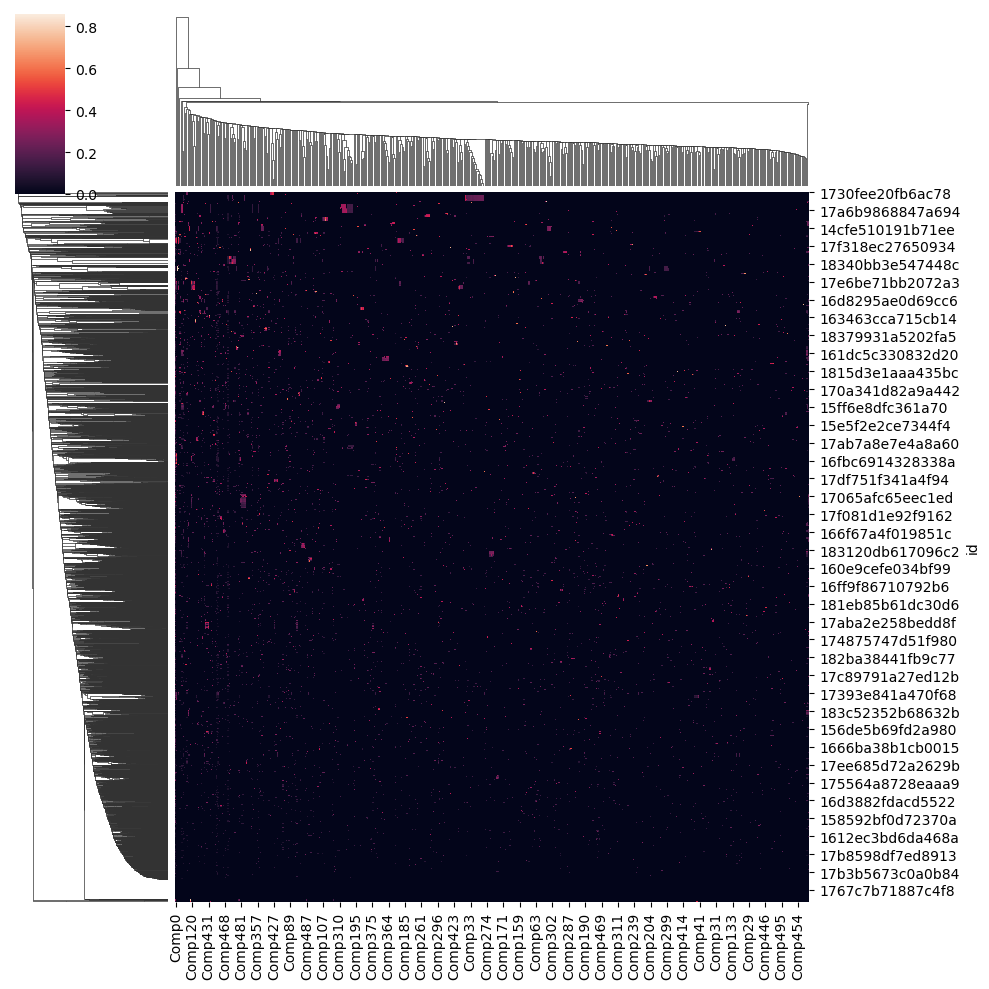

In [134]:
import seaborn as sns
fig = sns.clustermap(frame_sub_sampled[[f"Comp{i}" for i in range(542)]])

In [150]:
temp = pd.Series(np.array(tfidf.get_feature_names())[selector.variances_ > 400e-6].tolist(), index = [f"Comp{i}" for i in range(542)]).loc[np.array([f"Comp{i}" for i in range(542)])[fig.dendrogram_col.reordered_ind]]

In [152]:
for elem in temp:
    print(elem)

-PRON-
order
otp
amazon
account
com
gmail
email
card
credit
new
newsletter
weekly
purchase
deliver
delivery
package
invoice
pay
payment
day
statement
update
bank
uco
view
job
datum
scientist
jio
google
application
open
flight
free
hi
aayush
agrawal
offer
course
welcome
receive
stop
mail
gt
dear
date
january
balance
nse
fund
security
password
reset
link
thank
swiggy
want
don
convenience
inbox
message
r
score
refund
start
time
health
insurance
generate
plan
india
change
good
report
week
paytm
loan
personal
transaction
online
app
document
fastscanner
scan
check
complete
web
hello
clear
right
rs
year
quot
oct
join
puma
amp
confirm
experience
market
stock
stay
just
like
device
login
know
member
edition
medium
service
term
pm
image
brilliant
problem
help
today
mobile
recharge
successful
premium
save
code
registration
customer
number
jiofiber
connection
jiofixedvoice
income
tax
aadhaar
make
apply
photo
home
tab
list
moveout
jan
sun
calendar
lesson
piano
sit
notification
kolkata
invitation
ist

In [189]:
from sklearn.cluster import DBSCAN
clustering = DBSCAN(eps=0.5, min_samples=2).fit(X_transformed_vt.todense())
clustering.labels_

array([ 0,  0,  1, ..., -1,  0, -1])

In [198]:
cluster_dict = {}
for elem in set(clustering.labels_):
    cluster_dict[elem] = frame_sub[clustering.labels_ == elem]["from"].shape[0]
cluster_dict

{0: 6735,
 1: 4,
 2: 8,
 3: 22,
 4: 6,
 5: 7,
 6: 5,
 7: 3,
 8: 10,
 9: 37,
 10: 30,
 11: 3,
 12: 3,
 13: 6,
 14: 2,
 15: 3,
 16: 2,
 17: 3,
 18: 11,
 19: 69,
 20: 142,
 21: 22,
 22: 135,
 23: 2,
 24: 2,
 25: 2,
 26: 3,
 27: 26,
 28: 75,
 29: 2,
 30: 34,
 31: 10,
 32: 41,
 33: 16,
 34: 22,
 35: 47,
 36: 15,
 37: 15,
 38: 2,
 39: 12,
 40: 6,
 41: 12,
 42: 4,
 43: 16,
 44: 8,
 45: 35,
 46: 2,
 47: 4,
 48: 2,
 49: 4,
 50: 7,
 51: 14,
 52: 2,
 53: 4,
 54: 3,
 55: 2,
 56: 38,
 57: 2,
 58: 2,
 59: 5,
 60: 2,
 61: 2,
 62: 3,
 63: 2,
 64: 2,
 65: 2,
 66: 2,
 67: 2,
 68: 9,
 69: 9,
 70: 2,
 71: 4,
 72: 37,
 73: 12,
 74: 26,
 75: 10,
 76: 38,
 77: 63,
 78: 13,
 79: 4,
 80: 7,
 81: 2,
 82: 25,
 83: 5,
 84: 2,
 85: 2,
 86: 3,
 87: 2,
 88: 5,
 89: 4,
 90: 37,
 91: 31,
 92: 15,
 93: 3,
 94: 37,
 95: 7,
 96: 14,
 97: 14,
 98: 3,
 99: 10,
 100: 4,
 101: 26,
 102: 2,
 103: 2,
 104: 12,
 105: 2,
 106: 17,
 107: 14,
 108: 69,
 109: 2,
 110: 7,
 111: 3,
 112: 5,
 113: 7,
 114: 10,
 115: 10,
 116: 11,
 117

In [201]:
{k: v for k, v in sorted(cluster_dict.items(), key=lambda item: item[1])[::-1]}

{0: 6735,
 -1: 2259,
 20: 142,
 22: 135,
 238: 90,
 185: 75,
 28: 75,
 108: 69,
 19: 69,
 679: 63,
 77: 63,
 237: 50,
 35: 47,
 288: 45,
 32: 41,
 76: 38,
 56: 38,
 94: 37,
 90: 37,
 72: 37,
 9: 37,
 126: 36,
 45: 35,
 30: 34,
 270: 33,
 91: 31,
 121: 30,
 10: 30,
 101: 26,
 74: 26,
 27: 26,
 82: 25,
 537: 23,
 34: 22,
 21: 22,
 3: 22,
 215: 21,
 439: 20,
 155: 20,
 259: 17,
 106: 17,
 540: 16,
 269: 16,
 199: 16,
 43: 16,
 33: 16,
 438: 15,
 371: 15,
 92: 15,
 37: 15,
 36: 15,
 602: 14,
 240: 14,
 107: 14,
 97: 14,
 96: 14,
 51: 14,
 442: 13,
 129: 13,
 78: 13,
 231: 12,
 180: 12,
 127: 12,
 104: 12,
 73: 12,
 41: 12,
 39: 12,
 314: 11,
 257: 11,
 234: 11,
 200: 11,
 161: 11,
 148: 11,
 116: 11,
 18: 11,
 364: 10,
 331: 10,
 206: 10,
 184: 10,
 123: 10,
 115: 10,
 114: 10,
 99: 10,
 75: 10,
 31: 10,
 8: 10,
 532: 9,
 530: 9,
 468: 9,
 405: 9,
 322: 9,
 317: 9,
 312: 9,
 282: 9,
 141: 9,
 69: 9,
 68: 9,
 661: 8,
 491: 8,
 474: 8,
 437: 8,
 369: 8,
 343: 8,
 339: 8,
 336: 8,
 284: 8,
 2

In [203]:
for k, v in sorted(cluster_dict.items(), key=lambda item: item[1])[::-1]:
    print(f"Cluster - {k}")
    display(frame_sub[clustering.labels_ == k][["snippet", "subject", "labelIds", "from_name", "from_email", "from"]])
    display(frame_sub[clustering.labels_ == k]["from"].unique())

Cluster - 0


,snippet,subject,labelIds,from_name,from_email,from
0,Follow us on Download App ADDA Logo Trifecta S...,Daily Digest,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Trifecta Starlight ADDA,support@apartmentadda.com,Trifecta Starlight ADDA <support@apartmentadda...
1,Don&#39;t want convenience delivered to your i...,We’ve got your 2020 prediction for you. Ready? 🔮,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Swiggy Go,no-reply@swiggy.in,Swiggy Go <no-reply@swiggy.in>
6,Follow us on Download App ADDA Logo Trifecta S...,Daily Digest,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Trifecta Starlight ADDA,support@apartmentadda.com,Trifecta Starlight ADDA <support@apartmentadda...
8,Your application for Lead Quant Data Scientist...,Your application for Lead Quant Data Scientist...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>
11,Update your job search status Looking Intervie...,"New jobs: Business Operations at Rivet Labs, a...","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",AngelList Jobs Digest,talent@angel.co,AngelList Jobs Digest <talent@angel.co>
...,...,...,...,...,...,...
13376,AUROBINDO PHARMA LIMITED (CIN - L24239TG1986PL...,AUROBINDO PHARMA LIMITED - POSTAL BALLOT - COM...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Aurobindo Pharma Limited,apl.cs@kfintech.com,Aurobindo Pharma Limited <apl.cs@kfintech.com>
13378,"Dear Customer, Enclosed is the update on your ...",BlueDart >> MailDart,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""response@bluedart.com""",response@bluedart.com,"""response@bluedart.com"" <response@bluedart.com>"
13380,Level 3 rewards unlocked Get rewarded with adi...,You levelled up in adiClub,"['CATEGORY_UPDATES', 'INBOX']",adidas,adidas@in-info.adidas.com,adidas <adidas@in-info.adidas.com>
13382,December 2022 | MIT Sloan Admissions Newslette...,❄️ Happy Holidays from MIT Sloan's Office of A...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",MIT Sloan Admissions,admissions.mitsloan@mit.edu,MIT Sloan Admissions <admissions.mitsloan@mit....


array(['Trifecta Starlight ADDA <support@apartmentadda.com>',
       'Swiggy Go <no-reply@swiggy.in>',
       'LinkedIn <jobs-noreply@linkedin.com>', ...,
       '"Ultrahuman Cyborg (via Calendly)" <notifications@calendly.com>',
       '"Diwa C." <hit-reply@linkedin.com>',
       'Team Wint Wealth <updates@updates.wintwealth.com>'], dtype=object)

Cluster - -1


,snippet,subject,labelIds,from_name,from_email,from
9,👀 A founder of hBits viewed your profile You&#...,People are looking at your AngelList Profile,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",AngelList Talent,talent@angel.co,AngelList Talent <talent@angel.co>
12,"Hey Aayush, Your current CTC is quite on the h...",RE: Position of Quantitative Analyst - Dolat C...,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",NaN,fatema.dholkawala@dolatcapital.com,<fatema.dholkawala@dolatcapital.com>
13,"After you create a data project, you&#39;ll wa...",How to find the right data for your projects,"['CATEGORY_UPDATES', 'INBOX']","""data.world team""",help@data.world,"""data.world team"" <help@data.world>"
23,IndiGo Itinerary If you are unable to view thi...,Refund Email,"['CATEGORY_UPDATES', 'INBOX']",goIndiGo,services@goindigo.in,goIndiGo <services@goindigo.in>
37,"Hi Aayush, We&#39;re happy to offer you additi...",Data Science Fundamentals - Complimentary Cour...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Pearson Professional Programs,ppp.edge@pearson.com,Pearson Professional Programs <ppp.edge@pearso...
...,...,...,...,...,...,...
13371,Dear Aayush Agrawal 2022 came and went in what...,What a year! 🥳 Let’s recap.,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""DeepLearning.AI""",no-reply@m.mail.coursera.org,"""DeepLearning.AI"" <no-reply@m.mail.coursera.org>"
13374,"Hi Aayush, We have an opportunity for Senior M...","Senior ML Engineer, QA Opportunity","['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...","""Diwa C.""",inmail-hit-reply@linkedin.com,"""Diwa C."" <inmail-hit-reply@linkedin.com>"
13377,"Dear Friend, I hope this finds you and your fa...",A few changes...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Unived,feedback@unived.in,Unived <feedback@unived.in>
13383,Take a look at the changes made You are receiv...,We have updated our Terms of Use Policy,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Dunzo,DONOTREPLY@dunzo.in,Dunzo <DONOTREPLY@dunzo.in>


array(['AngelList Talent <talent@angel.co>',
       '<fatema.dholkawala@dolatcapital.com>',
       '"data.world team" <help@data.world>', ...,
       '"Diwa C." <inmail-hit-reply@linkedin.com>',
       'Unived <feedback@unived.in>', 'Apple <noreply@apple.com>'],
      dtype=object)

Cluster - 20


,snippet,subject,labelIds,from_name,from_email,from
123,Piano Lessons When Sun 26 Sept 2021 3pm – 4pm ...,Notification: Piano Lessons @ Sun 26 Sept 2021...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Calendar,calendar-notification@google.com,Google Calendar <calendar-notification@google....
133,Piano Lessons When Sat 25 Sept 2021 3pm – 4pm ...,Notification: Piano Lessons @ Sat 25 Sept 2021...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Calendar,calendar-notification@google.com,Google Calendar <calendar-notification@google....
177,Piano Lessons When Sun 19 Sept 2021 3pm – 4pm ...,Notification: Piano Lessons @ Sun 19 Sept 2021...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Calendar,calendar-notification@google.com,Google Calendar <calendar-notification@google....
180,Piano Lessons When Sat 18 Sept 2021 3pm – 4pm ...,Notification: Piano Lessons @ Sat 18 Sept 2021...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Calendar,calendar-notification@google.com,Google Calendar <calendar-notification@google....
300,Piano Lessons When Sat 26 Dec 2020 3pm – 4pm I...,Notification: Piano Lessons @ Sat 26 Dec 2020 ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Calendar,calendar-notification@google.com,Google Calendar <calendar-notification@google....
...,...,...,...,...,...,...
12755,Piano Lessons When Sat 3 Jul 2021 3pm – 4pm In...,Notification: Piano Lessons @ Sat 3 Jul 2021 3...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Calendar,calendar-notification@google.com,Google Calendar <calendar-notification@google....
12780,Piano Lessons When Sun 27 Jun 2021 3pm – 4pm I...,Notification: Piano Lessons @ Sun 27 Jun 2021 ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Calendar,calendar-notification@google.com,Google Calendar <calendar-notification@google....
12783,Piano Lessons When Sat 26 Jun 2021 3pm – 4pm I...,Notification: Piano Lessons @ Sat 26 Jun 2021 ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Calendar,calendar-notification@google.com,Google Calendar <calendar-notification@google....
13150,Piano Lessons When Sun 6 Mar 2022 3pm – 4pm In...,Notification: Piano Lessons @ Sun 6 Mar 2022 3...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Calendar,calendar-notification@google.com,Google Calendar <calendar-notification@google....


array(['Google Calendar <calendar-notification@google.com>'], dtype=object)

Cluster - 22


,snippet,subject,labelIds,from_name,from_email,from
138,"Dear Investor, With reference to SEBI circular...",Trades executed at NSE,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NSE-Direct,nse-direct@nse.co.in,NSE-Direct <nse-direct@nse.co.in>
146,"Dear Investor, With reference to SEBI circular...",Trades executed at NSE,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NSE-Direct,nse-direct@nse.co.in,NSE-Direct <nse-direct@nse.co.in>
418,"Dear Investor, With reference to SEBI circular...",Trades executed at NSE,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NSE-Direct,nse-direct@nse.co.in,NSE-Direct <nse-direct@nse.co.in>
467,"Dear Investor, With reference to SEBI circular...",Trades executed at NSE,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NSE-Direct,nse-direct@nse.co.in,NSE-Direct <nse-direct@nse.co.in>
481,"Dear Investor, With reference to SEBI circular...",Trades executed at NSE,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NSE-Direct,nse-direct@nse.co.in,NSE-Direct <nse-direct@nse.co.in>
...,...,...,...,...,...,...
13148,"Dear Investor, With reference to SEBI circular...",Trades executed at NSE,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NSE-Direct,nse-direct@nse.co.in,NSE-Direct <nse-direct@nse.co.in>
13162,"Dear Investor, With reference to SEBI circular...",Trades executed at NSE,"['CATEGORY_UPDATES', 'INBOX']",NSE-Direct,nse-direct@nse.co.in,NSE-Direct <nse-direct@nse.co.in>
13311,"Dear Investor, With reference to SEBI circular...",Trades executed at NSE,"['CATEGORY_UPDATES', 'INBOX']",NSE-Direct,nse-direct@nse.co.in,NSE-Direct <nse-direct@nse.co.in>
13335,"Dear Investor, With reference to SEBI circular...",Trades executed at NSE,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NSE-Direct,nse-direct@nse.co.in,NSE-Direct <nse-direct@nse.co.in>


array(['NSE-Direct <nse-direct@nse.co.in>'], dtype=object)

Cluster - 238


,snippet,subject,labelIds,from_name,from_email,from
1594,"Hi Aayush, here are your weekly stats. Jan 12,...",Your weekly progress report from Fitbit!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Fitbit,noreply@fitbit.com,Fitbit <noreply@fitbit.com>
1611,"Hi Aayush, here are your weekly stats. Jan 05,...",Your weekly progress report from Fitbit!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Fitbit,noreply@fitbit.com,Fitbit <noreply@fitbit.com>
1632,"Hi Aayush, here are your weekly stats. Dec 29,...",Your weekly progress report from Fitbit!,"['CATEGORY_UPDATES', 'INBOX']",Fitbit,noreply@fitbit.com,Fitbit <noreply@fitbit.com>
1655,"Hi Aayush, here are your weekly stats. Dec 22,...",Your weekly progress report from Fitbit!,"['CATEGORY_UPDATES', 'INBOX']",Fitbit,noreply@fitbit.com,Fitbit <noreply@fitbit.com>
1673,"Hi Aayush, here are your weekly stats. Dec 15,...",Your weekly progress report from Fitbit!,"['CATEGORY_UPDATES', 'INBOX']",Fitbit,noreply@fitbit.com,Fitbit <noreply@fitbit.com>
...,...,...,...,...,...,...
12841,"Hi Aayush, here are your weekly stats. Feb 08,...",Your weekly progress report from Fitbit!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Fitbit,noreply@fitbit.com,Fitbit <noreply@fitbit.com>
12857,"Hi Aayush, here are your weekly stats. Feb 01,...",Your weekly progress report from Fitbit!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Fitbit,noreply@fitbit.com,Fitbit <noreply@fitbit.com>
12868,"Hi Aayush, here are your weekly stats. Jan 25,...",Your weekly progress report from Fitbit!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Fitbit,noreply@fitbit.com,Fitbit <noreply@fitbit.com>
12880,"Hi Aayush, here are your weekly stats. Jan 18,...",Your weekly progress report from Fitbit!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Fitbit,noreply@fitbit.com,Fitbit <noreply@fitbit.com>


array(['Fitbit <noreply@fitbit.com>'], dtype=object)

Cluster - 185


,snippet,subject,labelIds,from_name,from_email,from
1239,Scanned by FastScanner app!,"New Document(5) - 12-Feb-2020, 08:34","['IMPORTANT', 'STARRED', 'SENT', 'INBOX']",Aayush Agrawal,aagrawal52@gmail.com,Aayush Agrawal <aagrawal52@gmail.com>
1945,Scanned by FastScanner app!,"New Document(197) - 24-Feb-2021, 12:15","['IMPORTANT', 'SENT', 'INBOX']",Aayush Agrawal,mr.aayushagrawal@gmail.com,Aayush Agrawal <mr.aayushagrawal@gmail.com>
2514,Scanned by FastScanner app!,"New Document(191) - 06-Nov-2020, 12:22","['IMPORTANT', 'SENT', 'INBOX']",Aayush Agrawal,aagrawal52@gmail.com,Aayush Agrawal <aagrawal52@gmail.com>
2516,Scanned by FastScanner app!,"New Document(190) - 06-Nov-2020, 12:00","['IMPORTANT', 'SENT', 'INBOX']",Aayush Agrawal,aagrawal52@gmail.com,Aayush Agrawal <aagrawal52@gmail.com>
2517,Scanned by FastScanner app!,"New Document(189) - 06-Nov-2020, 11:54","['IMPORTANT', 'SENT', 'INBOX']",Aayush Agrawal,aagrawal52@gmail.com,Aayush Agrawal <aagrawal52@gmail.com>
...,...,...,...,...,...,...
13280,Scanned by FastScanner app!,"New Document(150) - 02-Jul-2020, 22:38","['IMPORTANT', 'SENT', 'INBOX']",Aayush Agrawal,aagrawal52@gmail.com,Aayush Agrawal <aagrawal52@gmail.com>
13281,Scanned by FastScanner app!,"New Document(149) - 02-Jul-2020, 22:33","['IMPORTANT', 'SENT', 'INBOX']",Aayush Agrawal,aagrawal52@gmail.com,Aayush Agrawal <aagrawal52@gmail.com>
13283,Scanned by FastScanner app!,"New Document(148) - 02-Jul-2020, 20:14","['IMPORTANT', 'SENT', 'INBOX']",Aayush Agrawal,aagrawal52@gmail.com,Aayush Agrawal <aagrawal52@gmail.com>
13284,Scanned by FastScanner app!,"New Document(147) - 02-Jul-2020, 19:57","['IMPORTANT', 'SENT', 'INBOX']",Aayush Agrawal,aagrawal52@gmail.com,Aayush Agrawal <aagrawal52@gmail.com>


array(['Aayush Agrawal <aagrawal52@gmail.com>',
       'Aayush Agrawal <mr.aayushagrawal@gmail.com>'], dtype=object)

Cluster - 28


,snippet,subject,labelIds,from_name,from_email,from
157,Amazon Your Orders | Your Account | Amazon.in ...,Your Amazon.in order #405-0387165-9782723 of 1...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",shipment-tracking@amazon.in,"""Amazon.in"" <shipment-tracking@amazon.in>"
583,Amazon Your Orders | Your Account | Amazon.in ...,Your Amazon.in order #171-3003583-6224318 of 1...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",shipment-tracking@amazon.in,"""Amazon.in"" <shipment-tracking@amazon.in>"
702,Amazon Your Orders | Your Account | Amazon.in ...,Your Amazon.in order #171-7452337-9769154 of 1...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",shipment-tracking@amazon.in,"""Amazon.in"" <shipment-tracking@amazon.in>"
716,Amazon Your Orders | Your Account | Amazon.in ...,Your Amazon.in order #171-3716300-7621913 of 1...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",shipment-tracking@amazon.in,"""Amazon.in"" <shipment-tracking@amazon.in>"
725,Amazon Your Orders | Your Account | Amazon.in ...,Your Amazon.in order #171-2459003-4515504 of 1...,"['CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",shipment-tracking@amazon.in,"""Amazon.in"" <shipment-tracking@amazon.in>"
...,...,...,...,...,...,...
12573,Amazon Your Orders | Your Account | Amazon.in ...,Your Amazon.in order #405-8101337-5380366 of 1...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",shipment-tracking@amazon.in,"""Amazon.in"" <shipment-tracking@amazon.in>"
12621,Amazon Your Orders | Your Account | Amazon.in ...,Your Amazon.in order #171-5884320-5910740 of 1...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",shipment-tracking@amazon.in,"""Amazon.in"" <shipment-tracking@amazon.in>"
12658,Amazon Your Orders | Your Account | Amazon.in ...,Your Amazon.in order #171-9184306-9294730 of 1...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",shipment-tracking@amazon.in,"""Amazon.in"" <shipment-tracking@amazon.in>"
13209,Amazon Your Orders | Your Account | Amazon.in ...,Your Amazon.in order #402-5105775-5904365 of 1...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",shipment-tracking@amazon.in,"""Amazon.in"" <shipment-tracking@amazon.in>"


array(['"Amazon.in" <shipment-tracking@amazon.in>'], dtype=object)

Cluster - 108


,snippet,subject,labelIds,from_name,from_email,from
579,"Hi Aayush, Your package will be delivered betw...",Your Amazon.in order #171-3003583-6224318,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...","""Amazon.in""",shipment-tracking@amazon.in,"""Amazon.in"" <shipment-tracking@amazon.in>"
668,"Hi Aayush, Your package will be delivered betw...",Your Amazon.in order #402-5598168-3933134,"['CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",shipment-tracking@amazon.in,"""Amazon.in"" <shipment-tracking@amazon.in>"
701,"Hi Aayush, Your package with 1 item will be de...",Your Amazon.in order #171-7452337-9769154,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",shipment-tracking@amazon.in,"""Amazon.in"" <shipment-tracking@amazon.in>"
710,"Hi Aayush, Your package will be delivered betw...",Your Amazon.in order #171-3716300-7621913,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",shipment-tracking@amazon.in,"""Amazon.in"" <shipment-tracking@amazon.in>"
720,"Hi Aayush, Your package will be delivered betw...",Your Amazon.in order #171-2459003-4515504,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...","""Amazon.in""",shipment-tracking@amazon.in,"""Amazon.in"" <shipment-tracking@amazon.in>"
...,...,...,...,...,...,...
12611,"Hi Aayush, Your package will be delivered betw...",Your Amazon.in order #171-5884320-5910740,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",shipment-tracking@amazon.in,"""Amazon.in"" <shipment-tracking@amazon.in>"
12657,"Hi Aayush, Your package with 1 item will be de...",Your Amazon.in order #171-9184306-9294730,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...","""Amazon.in""",shipment-tracking@amazon.in,"""Amazon.in"" <shipment-tracking@amazon.in>"
13195,"Hi Aayush, Your package will be delivered betw...",Arriving today: Alfred's Basic Adult Piano...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",shipment-tracking@amazon.in,"""Amazon.in"" <shipment-tracking@amazon.in>"
13262,"Hi Aayush, Your package will be delivered betw...",Arriving today: Fooled by Randomness: The...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",shipment-tracking@amazon.in,"""Amazon.in"" <shipment-tracking@amazon.in>"


array(['"Amazon.in" <shipment-tracking@amazon.in>',
       '"Amazon.in" <order-update@amazon.in>'], dtype=object)

Cluster - 19


,snippet,subject,labelIds,from_name,from_email,from
122,"Dear Sir / Madam, Your One Time Password(OTP) ...",Transaction OTP,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,edis@cdslindia.co.in
168,"Dear Sir / Madam, Your One Time Password(OTP) ...",Transaction OTP,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,edis@cdslindia.co.in
496,"Dear Sir / Madam, Your One Time Password(OTP) ...",Transaction OTP,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,edis@cdslindia.co.in
740,"Dear Sir / Madam, Your One Time Password(OTP) ...",Transaction OTP,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,edis@cdslindia.co.in
776,"Dear Sir / Madam, Your One Time Password(OTP) ...",Transaction OTP,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,edis@cdslindia.co.in
...,...,...,...,...,...,...
12599,"Dear Sir / Madam, Your One Time Password(OTP) ...",Transaction OTP,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,edis@cdslindia.co.in
12770,"Dear Sir / Madam, Your One Time Password(OTP) ...",One Time Password(OTP),"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,edis@cdslindia.co.in
13101,"Dear Sir / Madam, Your One Time Password(OTP) ...",Transaction OTP,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,edis@cdslindia.co.in
13173,"Dear Sir / Madam, Your One Time Password(OTP) ...",Transaction OTP,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,edis@cdslindia.co.in


array(['edis@cdslindia.co.in'], dtype=object)

Cluster - 679


,snippet,subject,labelIds,from_name,from_email,from
9689,"Welcome Subscriber,This Email Was Sent On Beha...",Welcome To Big Billion Days Sale Upto 60%OFF O...,"['CATEGORY_UPDATES', 'INBOX']","""Adidas (Order Online)""",notification@trigen.in,"""Adidas (Order Online)"" <notification@trigen.in>"
9691,"Welcome Subscriber,This Email Was Sent On Beha...","बधाई हो, आयुष्मान भारत योजना के तहत 5 लाख तक क...","['CATEGORY_UPDATES', 'INBOX']","""आयुष्मान भारत योजना""",notification@trigen.in,"""आयुष्मान भारत योजना"" <notification@trigen.in>"
9695,"Welcome Subscriber,This Email Was Sent On Beha...",Enter Your Vehicle Number and Verify.,"['CATEGORY_UPDATES', 'INBOX']","""Reg.No-157""",notification@trigen.in,"""Reg.No-157"" <notification@trigen.in>"
9697,"Welcome Subscriber,This Email Was Sent On Beha...",Welcome Your~Solution for Daughter Marriage Cost.,"['CATEGORY_UPDATES', 'INBOX']","""Sukanya (Daughter Plan)""",notification@trigen.in,"""Sukanya (Daughter Plan)"" <notification@trigen..."
9700,"Welcome Subscriber,This Email Was Sent On Beha...",Sell Your Car in 1 Visit | Instant Payment | B...,"['CATEGORY_UPDATES', 'INBOX']","""Sell On (OLX Cashmy Car)""",notification@trigen.in,"""Sell On (OLX Cashmy Car)"" <notification@trige..."
...,...,...,...,...,...,...
12270,"Welcome Subscriber,This Email Was Sent On Beha...",Enter Your Car Number and Select RTO to Get St...,"['CATEGORY_UPDATES', 'INBOX']","""RTO (Renewal Notice)""",notification@trigen.in,"""RTO (Renewal Notice)"" <notification@trigen.in>"
12273,"Welcome Subscriber,This Email Was Sent On Beha...",Congrat's Clearance Sale | BUY 1 GET 1 FREE,"['CATEGORY_UPDATES', 'INBOX']",Mosquitos Controller,notification@trigen.in,Mosquitos Controller <notification@trigen.in>
12279,"Welcome Subscriber,This Email Was Sent On Beha...",Welcome To Check Out the New NEXON KRAZ – Look...,"['CATEGORY_UPDATES', 'INBOX']",TATA Nexon,notification@trigen.in,TATA Nexon <notification@trigen.in>
12280,"Welcome Subscriber,This Email Was Sent On Beha...",Your-Credit-Score is 810 Out of 900. Check Now.,"['CATEGORY_UPDATES', 'INBOX']","""Sep.Report 2019""",notification@trigen.in,"""Sep.Report 2019"" <notification@trigen.in>"


array(['"Adidas (Order Online)" <notification@trigen.in>',
       '"आयुष्मान भारत योजना" <notification@trigen.in>',
       '"Reg.No-157" <notification@trigen.in>',
       '"Sukanya (Daughter Plan)" <notification@trigen.in>',
       '"Sell On (OLX Cashmy Car)" <notification@trigen.in>',
       'Mosquitos Removal <notification@trigen.in>',
       'TATA Nexon <notification@trigen.in>',
       '"P.M. (Pension 2019)" <notification@trigen.in>',
       'Sell On CARS24 <notification@trigen.in>',
       '"RTO (Renewal Notice)" <notification@trigen.in>',
       'PM Yojna Plan <notification@trigen.in>',
       '"Your (Electricity Bill)" <notification@trigen.in>',
       '"Sep.Report2019" <notification@trigen.in>',
       '"RTO (Notice-4 Renewal)" <notification@trigen.in>',
       '"P.M.PENSION 2019" <notification@trigen.in>',
       'Italy Trip <notification@trigen.in>',
       '"रोलेक्स (आखरी मौका)" <notification@trigen.in>',
       '"RTO (Renewal Alert)" <notification@trigen.in>',
       '60 Te

Cluster - 77


,snippet,subject,labelIds,from_name,from_email,from
431,"Dear Valued Customer, In compliance with NSE C...",Weekly client wise funds and securities balances,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Aditya Birla Capital,ereports.stocksandsecurities@abm.adityabirlaca...,Aditya Birla Capital <ereports.stocksandsecuri...
469,"Dear Valued Customer, In compliance with NSE C...",Weekly client wise funds and securities balances,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Aditya Birla Capital,ereports.stocksandsecurities@abm.adityabirlaca...,Aditya Birla Capital <ereports.stocksandsecuri...
518,"Dear Valued Customer, In compliance with NSE C...",Weekly client wise funds and securities balances,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Aditya Birla Capital,ereports.stocksandsecurities@abm.adityabirlaca...,Aditya Birla Capital <ereports.stocksandsecuri...
585,"Dear Valued Customer, In compliance with NSE C...",Weekly client wise funds and securities balances,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Aditya Birla Capital,ereports.stocksandsecurities@abm.adityabirlaca...,Aditya Birla Capital <ereports.stocksandsecuri...
588,"Dear Valued Customer, In compliance with NSE C...",Weekly client wise funds and securities balances,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Aditya Birla Capital,ereports.stocksandsecurities@abm.adityabirlaca...,Aditya Birla Capital <ereports.stocksandsecuri...
...,...,...,...,...,...,...
12475,"Dear Valued Customer, In compliance with NSE C...",Weekly client wise funds and securities balances,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Aditya Birla Capital,ereports.stocksandsecurities@abm.adityabirlaca...,Aditya Birla Capital <ereports.stocksandsecuri...
12661,"Dear Valued Customer, In compliance with NSE C...",Weekly client wise funds and securities balances,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Aditya Birla Capital,ereports.stocksandsecurities@abm.adityabirlaca...,Aditya Birla Capital <ereports.stocksandsecuri...
13108,"Dear Valued Customer, In compliance with NSE C...",Weekly client wise funds and securities balances,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Aditya Birla Capital,ereports.stocksandsecurities@abm.adityabirlaca...,Aditya Birla Capital <ereports.stocksandsecuri...
13156,"Dear Valued Customer, In compliance with NSE C...",Weekly client wise funds and securities balances,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Aditya Birla Capital,ereports.stocksandsecurities@abm.adityabirlaca...,Aditya Birla Capital <ereports.stocksandsecuri...


array(['Aditya Birla Capital <ereports.stocksandsecurities@abm.adityabirlacapital.org>',
       'Aditya Birla Capital <ebills.stocksandsecurities@abm.adityabirlacapital.org>'],
      dtype=object)

Cluster - 237


,snippet,subject,labelIds,from_name,from_email,from
1590,01/22/15 Daily Digest for UT. 7.01X: Foundatio...,01/22/15 Daily Digest for UT. 7.01X on Piazza,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Piazza Team,no-reply@piazza.com,Piazza Team <no-reply@piazza.com>
1592,01/21/15 Daily Digest for UT. 7.01X: Foundatio...,01/21/15 Daily Digest for UT. 7.01X on Piazza,"['CATEGORY_UPDATES', 'INBOX']",Piazza Team,no-reply@piazza.com,Piazza Team <no-reply@piazza.com>
1596,01/20/15 Daily Digest for UT. 7.01X: Foundatio...,01/20/15 Daily Digest for UT. 7.01X on Piazza,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Piazza Team,no-reply@piazza.com,Piazza Team <no-reply@piazza.com>
1599,01/19/15 Daily Digest for UT. 7.01X: Foundatio...,01/19/15 Daily Digest for UT. 7.01X on Piazza,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Piazza Team,no-reply@piazza.com,Piazza Team <no-reply@piazza.com>
1606,01/16/15 Daily Digest for UT. 7.01X: Foundatio...,01/16/15 Daily Digest for UT. 7.01X on Piazza,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Piazza Team,no-reply@piazza.com,Piazza Team <no-reply@piazza.com>
1609,01/15/15 Daily Digest for UT. 7.01X: Foundatio...,01/15/15 Daily Digest for UT. 7.01X on Piazza,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Piazza Team,no-reply@piazza.com,Piazza Team <no-reply@piazza.com>
1613,01/14/15 Daily Digest for UT. 7.01X: Foundatio...,01/14/15 Daily Digest for UT. 7.01X on Piazza,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Piazza Team,no-reply@piazza.com,Piazza Team <no-reply@piazza.com>
1615,01/13/15 Daily Digest for UT. 7.01X: Foundatio...,01/13/15 Daily Digest for UT. 7.01X on Piazza,"['CATEGORY_UPDATES', 'INBOX']",Piazza Team,no-reply@piazza.com,Piazza Team <no-reply@piazza.com>
1617,01/12/15 Daily Digest for UT. 7.01X: Foundatio...,01/12/15 Daily Digest for UT. 7.01X on Piazza,"['CATEGORY_UPDATES', 'INBOX']",Piazza Team,no-reply@piazza.com,Piazza Team <no-reply@piazza.com>
1620,01/11/15 Daily Digest for UT. 7.01X: Foundatio...,01/11/15 Daily Digest for UT. 7.01X on Piazza,"['CATEGORY_UPDATES', 'INBOX']",Piazza Team,no-reply@piazza.com,Piazza Team <no-reply@piazza.com>


array(['Piazza Team <no-reply@piazza.com>'], dtype=object)

Cluster - 35


,snippet,subject,labelIds,from_name,from_email,from
183,"Dear Customer, Thank you for choosing JioFiber...",Plan active on JioFiber connection having JioF...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
184,"Dear Customer, Your plan JioFiber_1M_999 for J...",Plan JioFiber_1M_999 for JioFiber connection h...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
199,"Dear Customer, Your current plan JioFiber_1M_9...",Current plan JioFiber_1M_999 for JioFiber conn...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
504,"Dear Customer, Your current plan JioFiber_1M_9...",Current plan JioFiber_1M_999 for JioFiber conn...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
1067,"Dear Customer, Thank you for choosing JioFiber...",Plan active on JioFiber connection having JioF...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
1069,"Dear Customer, Your plan JioFiber_1M_999 for J...",Plan JioFiber_1M_999 for JioFiber connection h...,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
1079,"Dear Customer, Your current plan JioFiber_1M_9...",Current plan JioFiber_1M_999 for JioFiber conn...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
1488,"Dear Customer, Your plan JioFiber_1M_999 for J...",Plan JioFiber_1M_999 for JioFiber connection h...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
1514,"Dear Customer, Your current plan JioFiber_1M_9...",Current plan JioFiber_1M_999 for JioFiber conn...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
3036,"Dear Customer, Thank you for choosing JioFiber...",Plan active on JioFiber connection having JioF...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com


array(['notifications_jiofiber@jio.com'], dtype=object)

Cluster - 288


,snippet,subject,labelIds,from_name,from_email,from
2092,See insights about your Page between January 2...,Weekly Facebook Page update for DPS Mandla Roa...,"['CATEGORY_UPDATES', 'INBOX']",Facebook,page-notification-noreply@support.facebook.com,Facebook <page-notification-noreply@support.fa...
2104,See insights about your Page between January 2...,Weekly Facebook Page update for DPS Mandla Roa...,"['CATEGORY_UPDATES', 'INBOX']",Facebook,page-notification-noreply@support.facebook.com,Facebook <page-notification-noreply@support.fa...
2109,See insights about your Page between January 1...,Weekly Facebook Page update for DPS Mandla Roa...,"['CATEGORY_UPDATES', 'INBOX']",Facebook,page-notification-noreply@support.facebook.com,Facebook <page-notification-noreply@support.fa...
2115,See insights about your Page between January 1...,Weekly Facebook Page update for DPS Mandla Roa...,"['CATEGORY_UPDATES', 'INBOX']",Facebook,page-notification-noreply@support.facebook.com,Facebook <page-notification-noreply@support.fa...
2124,See insights about your Page between January 8...,Weekly Facebook Page update for DPS Mandla Roa...,"['CATEGORY_UPDATES', 'INBOX']",Facebook,page-notification-noreply@support.facebook.com,Facebook <page-notification-noreply@support.fa...
2133,See insights about your Page between January 3...,Weekly Facebook Page update for DPS Mandla Roa...,"['CATEGORY_UPDATES', 'INBOX']",Facebook,page-notification-noreply@support.facebook.com,Facebook <page-notification-noreply@support.fa...
2139,See insights about your Page between December ...,Weekly Facebook Page update for DPS Mandla Roa...,"['CATEGORY_UPDATES', 'INBOX']",Facebook,page-notification-noreply@support.facebook.com,Facebook <page-notification-noreply@support.fa...
2152,You have 1 check in for the week of December 2...,Weekly Facebook Page update for DPS Mandla Roa...,"['CATEGORY_UPDATES', 'INBOX']",Facebook,page-notification-noreply@support.facebook.com,Facebook <page-notification-noreply@support.fa...
2163,See insights about your Page between December ...,Weekly Facebook Page update for DPS Mandla Roa...,"['CATEGORY_UPDATES', 'INBOX']",Facebook,page-notification-noreply@support.facebook.com,Facebook <page-notification-noreply@support.fa...
2185,See insights about your Page between December ...,Weekly Facebook Page update for DPS Mandla Roa...,"['CATEGORY_UPDATES', 'INBOX']",Facebook,page-notification-noreply@support.facebook.com,Facebook <page-notification-noreply@support.fa...


array(['Facebook <page-notification-noreply@support.facebook.com>'],
      dtype=object)

Cluster - 32


,snippet,subject,labelIds,from_name,from_email,from
173,Ankur Warikoo ₹399.00 Paid Successfully Paymen...,Payment successful for Ankur Warikoo,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Payments,no-reply@razorpay.com,Payments <no-reply@razorpay.com>
174,ZAAN WEBVEDA PRIVATE LIMITED ₹399.00 Paid Succ...,Payment receipt for your successful transactio...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",ZAAN WEBVEDA PRIVATE LIMITED,no-reply@razorpay.com,ZAAN WEBVEDA PRIVATE LIMITED <no-reply@razorpa...
1283,Powered by Swiggy ₹225.00 Paid Successfully Pa...,Payment successful for Swiggy,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Team Razorpay,no-reply@razorpay.com,Team Razorpay <no-reply@razorpay.com>
2381,BAL RAKSHA BHARAT ₹2400.00 Paid Successfully P...,Payment successful for BAL RAKSHA BHARAT,"['CATEGORY_UPDATES', 'INBOX']",Payments,no-reply@razorpay.com,Payments <no-reply@razorpay.com>
2521,CureFit ₹1299.00 Paid Successfully Payment Id ...,Payment successful for CureFit,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Payments,no-reply@razorpay.com,Payments <no-reply@razorpay.com>
4566,Creatures of Habit ₹5997.00 Paid Successfully ...,Payment successful for Creatures of Habit,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Payments,no-reply@razorpay.com,Payments <no-reply@razorpay.com>
4927,Gadgetshieldz ₹539.00 Paid Successfully Paymen...,Payment successful for Gadgetshieldz,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Payments,no-reply@razorpay.com,Payments <no-reply@razorpay.com>
7036,Divine ₹2240.00 Paid Successfully Payment Id p...,Payment successful for Divine,"['CATEGORY_UPDATES', 'INBOX']",Payments,no-reply@razorpay.com,Payments <no-reply@razorpay.com>
7096,Red Raven ₹1198.00 Paid Successfully Payment I...,Payment successful for Red Raven,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Team Razorpay,no-reply@razorpay.com,Team Razorpay <no-reply@razorpay.com>
7274,MB Enterprise ₹600.00 Paid Successfully Paymen...,Payment successful for MB Enterprise,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Payments,no-reply@razorpay.com,Payments <no-reply@razorpay.com>


array(['Payments <no-reply@razorpay.com>',
       'ZAAN WEBVEDA PRIVATE LIMITED <no-reply@razorpay.com>',
       'Team Razorpay <no-reply@razorpay.com>',
       'Team Dunzo <DONOTREPLY@dunzo.in>'], dtype=object)

Cluster - 76


,snippet,subject,labelIds,from_name,from_email,from
429,"Tax Invoice Dear Aayush Agrawal, Please find a...",Tax invoice for your Hotel Booking id NH700902...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
432,"Tax Invoice Dear Aayush Agrawal, Please find a...",Tax Invoice for your Rail Booking id NR7200260...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
478,"Tax Invoice Dear Aayush Agrawal, Please find a...",Tax Invoice for your Cab Booking id NC78654418...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
482,"Tax Invoice Dear Aayush Agrawal, Please find a...",Tax Invoice for your Cab Booking id NC78654418...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
2444,"Tax Invoice Dear Aayush Agrawal, Please find a...",Tax Invoice for your Cab Booking id NC74660367...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
2447,"Tax Invoice Dear Aayush Agrawal, Please find a...",Tax Invoice for your Cab Booking id NC74660367...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
3150,"Tax Invoice Dear Aayush Agrawal, Please find a...",Tax Invoice for your Flight Booking id NF799G6...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
3433,"Tax Invoice Dear Aayush Agrawal, Please find a...",Tax Invoice for your Flight Booking id NF7KALC...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
3438,"Tax Invoice Dear Aayush Agrawal, Please find a...",Tax Invoice for your Flight Booking id NF76UW7...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
4328,"Tax Invoice Dear Aayush Agrawal, Please find a...",Tax Invoice for your Flight Booking id NF70QNQ...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>


array(['MakeMyTrip <noreply@makemytrip.com>',
       'Goibibo <noreply@goibibo.com>'], dtype=object)

Cluster - 56


,snippet,subject,labelIds,from_name,from_email,from
319,Aayush&lt;&gt;Shubha: Technical Screening When...,Notification: Aayush<>Shubha: Technical Screen...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Calendar,calendar-notification@google.com,Google Calendar <calendar-notification@google....
330,You have been invited to the following event. ...,Invitation: Aayush<>Shubha: Technical Screenin...,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Shubha Shedthikere,shubha.s@swiggy.in,Shubha Shedthikere <shubha.s@swiggy.in>
675,Interview with Swiggy: Hangout call: HM round ...,Notification: Interview with Swiggy: Hangout c...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Calendar,calendar-notification@google.com,Google Calendar <calendar-notification@google....
686,Interview with Swiggy: Hangout call: ML Engg r...,Notification: Interview with Swiggy: Hangout c...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Google Calendar,calendar-notification@google.com,Google Calendar <calendar-notification@google....
689,Interview with Swiggy: DS2: ML Depth round Whe...,Notification: Interview with Swiggy: DS2: ML D...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Google Calendar,calendar-notification@google.com,Google Calendar <calendar-notification@google....
690,This event has been changed. Interview with Sw...,Updated invitation: Interview with Swiggy: Han...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Meenu Arora,meenu.arora@swiggy.in,Meenu Arora <meenu.arora@swiggy.in>
695,Interview with Swiggy: Hangout Call: ML Breadt...,Notification: Interview with Swiggy: Hangout C...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Google Calendar,calendar-notification@google.com,Google Calendar <calendar-notification@google....
994,Interview with Jupiter When Fri 29 Oct 2021 2p...,Notification: Interview with Jupiter @ Fri 29 ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Calendar,calendar-notification@google.com,Google Calendar <calendar-notification@google....
1003,This event has been changed. Interview with Ju...,Updated invitation: Interview with Jupiter @ F...,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",NaN,NaN,syeda.humera@jupiter.money
1005,Interview with Jupiter When Thu 28 Oct 2021 1p...,Notification: Interview with Jupiter @ Thu 28 ...,"['CATEGORY_UPDATES', 'INBOX']",Google Calendar,calendar-notification@google.com,Google Calendar <calendar-notification@google....


array(['Google Calendar <calendar-notification@google.com>',
       'Shubha Shedthikere <shubha.s@swiggy.in>',
       'Meenu Arora <meenu.arora@swiggy.in>',
       'syeda.humera@jupiter.money', 'deepthi.vusirikayala@jupiter.money',
       'mamta@indwealth.in'], dtype=object)

Cluster - 94


,snippet,subject,labelIds,from_name,from_email,from
484,"pre Header Dear AAYUSH, As per DGCA guidelines...",Complete Your Mandatory Web Check-in Now!,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
491,"pre Header Dear AAYUSH, As per DGCA guidelines...",Complete Your Mandatory Web Check-in Now!,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
797,"pre Header Dear AAYUSH, As per DGCA guidelines...",Complete Your Mandatory Web Check-in Now!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
2456,"Dear AAYUSH, Your request for Web Check-in for...",Web Check-In Failed for Your Bangalore Flight!,"['CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
2466,"pre Header Dear AAYUSH, As per DGCA guidelines...",Complete Your Mandatory Web Check-in Now!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
2477,"pre Header Dear AAYUSH, As per DGCA guidelines...",Complete Your Mandatory Web Check-in Now!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
2587,"pre Header Dear AAYUSH, As per DGCA guidelines...",Complete Your Mandatory Web Check-in Now!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
2636,"pre Header Dear AAYUSH, As per DGCA guidelines...",Web Check-in Now Open for Your Flight to Jabal...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
3096,"pre Header Dear AAYUSH, As per DGCA guidelines...",Complete Your Mandatory Web Check-in Now!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
3115,"pre Header Dear AAYUSH, As per DGCA guidelines...",Complete Your Mandatory Web Check-in Now!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>


array(['MakeMyTrip <noreply@makemytrip.com>'], dtype=object)

Cluster - 90


,snippet,subject,labelIds,from_name,from_email,from
466,"Dear Investor, With reference to NSE circular ...",Funds/Securities Balance,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""nse_alerts@nse.co.in""",nse_alerts@nse.co.in,"""nse_alerts@nse.co.in"" <nse_alerts@nse.co.in>"
517,"Dear Investor, With reference to NSE circular ...",Funds/Securities Balance,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",nse_alerts,nse_alerts@nse.co.in,nse_alerts <nse_alerts@nse.co.in>
555,"Dear Investor, With reference to NSE circular ...",Funds/Securities Balance,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""nse_alerts@nse.co.in""",nse_alerts@nse.co.in,"""nse_alerts@nse.co.in"" <nse_alerts@nse.co.in>"
754,"Dear Investor, With reference to NSE circular ...",Funds/Securities Balance,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",nse_alerts,nse_alerts@nse.co.in,nse_alerts <nse_alerts@nse.co.in>
988,"Dear Investor, With reference to NSE circular ...",Funds/Securities Balance,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",nse_alerts,nse_alerts@nse.co.in,nse_alerts <nse_alerts@nse.co.in>
1441,"Dear Investor, With reference to NSE circular ...",Funds/Securities Balance,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",nse_alerts,nse_alerts@nse.co.in,nse_alerts <nse_alerts@nse.co.in>
2417,"Dear Investor, With reference to NSE circular ...",Funds/Securities Balance,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",nse_alerts,nse_alerts@nse.co.in,nse_alerts <nse_alerts@nse.co.in>
3043,"Dear Investor, With reference to NSE circular ...",Funds/Securities Balance,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",nse_alerts,nse_alerts@nse.co.in,nse_alerts <nse_alerts@nse.co.in>
3110,"Dear Investor, With reference to NSE circular ...",Funds/Securities Balance,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",nse_alerts,nse_alerts@nse.co.in,nse_alerts <nse_alerts@nse.co.in>
3408,"Dear Investor, With reference to NSE circular ...",Funds/Securities Balance,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",nse_alerts,nse_alerts@nse.co.in,nse_alerts <nse_alerts@nse.co.in>


array(['"nse_alerts@nse.co.in" <nse_alerts@nse.co.in>',
       'nse_alerts <nse_alerts@nse.co.in>'], dtype=object)

Cluster - 72


,snippet,subject,labelIds,from_name,from_email,from
413,"Dear Investor, With reference to BSE Notice 20...",Funds / Securities Balance,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",BSE ALERTS,info@bseindia.in,BSE ALERTS <info@bseindia.in>
442,"Dear Investor, With reference to BSE Notice 20...",Funds / Securities Balance,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",BSE ALERTS,info@bseindia.in,BSE ALERTS <info@bseindia.in>
511,"Dear Investor, With reference to BSE Notice 20...",Funds / Securities Balance,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",BSE ALERTS,info@bseindia.in,BSE ALERTS <info@bseindia.in>
726,"Dear Investor, With reference to BSE Notice 20...",Funds / Securities Balance,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",BSE ALERTS,info@bseindia.in,BSE ALERTS <info@bseindia.in>
770,"Dear Investor, With reference to BSE Notice 20...",Funds / Securities Balance,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",BSE ALERTS,info@bseindia.in,BSE ALERTS <info@bseindia.in>
2608,"Dear Investor, With reference to BSE Notice 20...",Funds / Securities Balance,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",BSE ALERTS,info@bseindia.in,BSE ALERTS <info@bseindia.in>
2662,"Dear Investor, With reference to BSE Notice 20...",Funds / Securities Balance,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",BSE ALERTS,info@bseindia.in,BSE ALERTS <info@bseindia.in>
3515,"Dear Investor, With reference to BSE Notice 20...",Funds / Securities Balance,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",BSE ALERTS,info@bseindia.in,BSE ALERTS <info@bseindia.in>
4355,"Dear Investor, With reference to BSE Notice 20...",Funds / Securities Balance,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",BSE ALERTS,info@bseindia.in,BSE ALERTS <info@bseindia.in>
4523,"Dear Investor, With reference to BSE Notice 20...",Funds / Securities Balance,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",BSE ALERTS,info@bseindia.in,BSE ALERTS <info@bseindia.in>


array(['BSE ALERTS <info@bseindia.in>'], dtype=object)

Cluster - 9


,snippet,subject,labelIds,from_name,from_email,from
30,Your Citi Credit Card monthly e-statement is h...,Statement Online - CITIBANK REWARDS PLATINUM CARD,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>
132,Credit Card Statement Having trouble viewing t...,Statement Online - CITIBANK REWARDS PLATINUM CARD,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>
311,Your Citi Credit Card monthly e-statement is h...,Statement Online - CITIBANK REWARDS PLATINUM CARD,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>
536,Credit Card Statement Having trouble viewing t...,Statement Online - CITIBANK REWARDS PLATINUM CARD,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>
791,Credit Card Statement Having trouble viewing t...,Statement Online - CITIBANK REWARDS PLATINUM CARD,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>
1020,Credit Card Statement Having trouble viewing t...,Statement Online - CITIBANK REWARDS PLATINUM CARD,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>
1177,Your Citi Credit Card monthly e-statement is h...,Statement Online - CITIBANK REWARDS PLATINUM CARD,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>
1483,Credit Card Statement Having trouble viewing t...,Statement Online - CITIBANK REWARDS PLATINUM CARD,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>
1925,Your Citi Credit Card monthly e-statement is h...,Statement Online - CITIBANK REWARDS PLATINUM CARD,"['CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>
2343,Your Citi Credit Card monthly e-statement is h...,Statement Online - CITIBANK REWARDS PLATINUM CARD,"['CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>


array(['Citibank India <net.statement@citicorp.com>'], dtype=object)

Cluster - 126


,snippet,subject,labelIds,from_name,from_email,from
728,Having trouble viewing this emailer? Click her...,Citibank Account Statement,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>
1439,Having trouble viewing this emailer? Click her...,Citibank Account Statement,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>
1749,Having trouble viewing this emailer? Click her...,Citibank Account Statement,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>
1857,Having trouble viewing this emailer? Click her...,Citibank Account Statement,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>
1902,Having trouble viewing this emailer? Click her...,Citibank Account Statement,"['CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>
2289,Having trouble viewing this emailer? Click her...,Citibank Account Statement,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>
2541,Having trouble viewing this emailer? Click her...,Citibank Account Statement,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>
2865,Having trouble viewing this emailer? Click her...,Citibank Account Statement,"['CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>
3456,Having trouble viewing this emailer? Click her...,Citibank Account Statement,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>
3963,Having trouble viewing this emailer? Click her...,Citibank Account Statement,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>


array(['Citibank India <net.statement@citicorp.com>'], dtype=object)

Cluster - 45


,snippet,subject,labelIds,from_name,from_email,from
226,Monthly Statement 02/12/2017 Samsung Smart Clu...,Samsung Smart Club Monthly Statement,"['CATEGORY_UPDATES', 'INBOX']",Samsung Smart Club,smartclub@samsung.com,Samsung Smart Club <smartclub@samsung.com>
1130,03/06/2020 Samsung Smart Club Monthly Statemen...,Samsung Smart Club Monthly Statement,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Samsung Smart Club,smartclub@samsung.com,Samsung Smart Club <smartclub@samsung.com>
1281,07/02/2020 Samsung Smart Club Monthly Statemen...,Samsung Smart Club Monthly Statement,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Samsung Smart Club,smartclub@samsung.com,Samsung Smart Club <smartclub@samsung.com>
1338,Monthly Statement 01/02/2018 Samsung Smart Clu...,Samsung Smart Club Monthly Statement,"['CATEGORY_UPDATES', 'INBOX']",Samsung Smart Club,smartclub@samsung.com,Samsung Smart Club <smartclub@samsung.com>
1766,01/04/2020 Samsung Smart Club Monthly Statemen...,Samsung Smart Club Monthly Statement,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Samsung Smart Club,smartclub@samsung.com,Samsung Smart Club <smartclub@samsung.com>
1898,03/03/2021 Samsung Smart Club Monthly Statemen...,Samsung Smart Club Monthly Statement,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Samsung Smart Club,smartclub@samsung.com,Samsung Smart Club <smartclub@samsung.com>
2098,Monthly Statement 01/02/2019 Samsung Smart Clu...,Samsung Smart Club Monthly Statement,"['CATEGORY_UPDATES', 'INBOX']",Samsung Smart Club,smartclub@samsung.com,Samsung Smart Club <smartclub@samsung.com>
2145,Monthly Statement 01/01/2019 Samsung Smart Clu...,Samsung Smart Club Monthly Statement,"['CATEGORY_UPDATES', 'INBOX']",Samsung Smart Club,smartclub@samsung.com,Samsung Smart Club <smartclub@samsung.com>
2715,Monthly Statement 01/07/2017 Samsung Smart Clu...,Samsung Smart Club Monthly Statement,"['CATEGORY_UPDATES', 'INBOX']",Samsung Smart Club,smartclub@samsung.com,Samsung Smart Club <smartclub@samsung.com>
2780,Monthly Statement 01/05/2017 Samsung Smart Clu...,Samsung Smart Club Monthly Statement,"['CATEGORY_UPDATES', 'INBOX']",Samsung Smart Club,smartclub@samsung.com,Samsung Smart Club <smartclub@samsung.com>


array(['Samsung Smart Club <smartclub@samsung.com>'], dtype=object)

Cluster - 30


,snippet,subject,labelIds,from_name,from_email,from
166,Dear AAYUSH AGRAWAL Your Consolidated Statemen...,CDSL Consolidated Account Statement (CAS) acro...,"['Label_7843443659568122841', 'IMPORTANT', 'La...",NaN,NaN,eCAS@cdslstatement.com
598,Dear AAYUSH AGRAWAL Your Consolidated Statemen...,CDSL Consolidated Account Statement (CAS) acro...,"['Label_7843443659568122841', 'IMPORTANT', 'La...",NaN,NaN,eCAS@cdslstatement.com
633,Dear AAYUSH AGRAWAL Your Consolidated Statemen...,CDSL Consolidated Account Statement (CAS) acro...,"['Label_7843443659568122841', 'IMPORTANT', 'La...",NaN,NaN,eCAS@cdslstatement.com
998,Dear AAYUSH AGRAWAL Your Consolidated Statemen...,CDSL Consolidated Account Statement (CAS) acro...,"['Label_7843443659568122841', 'IMPORTANT', 'La...",NaN,NaN,eCAS@cdslstatement.com
1112,Dear AAYUSH AGRAWAL Your Consolidated Statemen...,CDSL Consolidated Account Statement (CAS) acro...,"['Label_7843443659568122841', 'IMPORTANT', 'La...",NaN,NaN,eCAS@cdslstatement.com
1492,Dear AAYUSH AGRAWAL Your Consolidated Statemen...,CDSL Consolidated Account Statement (CAS) acro...,"['Label_7843443659568122841', 'IMPORTANT', 'La...",NaN,NaN,eCAS@cdslstatement.com
2562,Dear AAYUSH AGRAWAL Your Consolidated Statemen...,CDSL Consolidated Account Statement (CAS) acro...,"['Label_7843443659568122841', 'IMPORTANT', 'La...",NaN,NaN,eCAS@cdslstatement.com
2624,Dear AAYUSH AGRAWAL Your Consolidated Statemen...,CDSL Consolidated Account Statement (CAS) acro...,"['Label_7843443659568122841', 'IMPORTANT', 'La...",NaN,NaN,eCAS@cdslstatement.com
3003,Dear AAYUSH AGRAWAL Your Consolidated Statemen...,CDSL Consolidated Account Statement (CAS) acro...,"['Label_7843443659568122841', 'IMPORTANT', 'La...",NaN,NaN,eCAS@cdslstatement.com
3568,Dear AAYUSH AGRAWAL Your Consolidated Statemen...,CDSL Consolidated Account Statement (CAS) acro...,"['Label_7843443659568122841', 'IMPORTANT', 'La...",NaN,NaN,eCAS@cdslstatement.com


array(['eCAS@cdslstatement.com'], dtype=object)

Cluster - 270


,snippet,subject,labelIds,from_name,from_email,from
1896,Apply Now on Paytm. Don&#39;t Wait! #Paytmkaro...,"Aayush Agrawal, Your Personal Loan* is a Click...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,mail@info.paytm.com,Paytm <mail@info.paytm.com>
1922,Apply Now on Paytm. Don&#39;t Wait! #Paytmkaro...,"Aayush Agrawal, Your Personal Loan* is a Click...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,mail@info.paytm.com,Paytm <mail@info.paytm.com>
1947,Apply Now on Paytm. Don&#39;t Wait! #Paytmkaro...,"Aayush Agrawal, Your Personal Loan* is a Click...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,mail@info.paytm.com,Paytm <mail@info.paytm.com>
6089,Apply Now. Don&#39;t Wait! #Paytmkaro Paytm Pe...,"Aayush Agrawal, Personal Loan* is a Click Away👇","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,mail@info.paytm.com,Paytm <mail@info.paytm.com>
6107,Apply Now. Don&#39;t Wait! #Paytmkaro Paytm Pe...,"Aayush Agrawal, Personal Loan* is a Click Away👇","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,mail@info.paytm.com,Paytm <mail@info.paytm.com>
6119,Apply Now. Don&#39;t Wait! #Paytmkaro Paytm Pe...,"Aayush Agrawal, Personal Loan* is a Click Away👇","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,mail@info.paytm.com,Paytm <mail@info.paytm.com>
6137,Apply Now. Don&#39;t Wait! #Paytmkaro Paytm Pe...,"Aayush Agrawal, Personal Loan* is a Click Away👇","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,mail@info.paytm.com,Paytm <mail@info.paytm.com>
6144,Apply Now. Don&#39;t Wait! #Paytmkaro Paytm Pe...,"Aayush Agrawal, Personal Loan* is a Click Away👇","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,mail@info.paytm.com,Paytm <mail@info.paytm.com>
6173,Apply Now. Don&#39;t Wait! #Paytmkaro Paytm Pe...,"Aayush Agrawal, Personal Loan* is a Click Away👇","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,mail@info.paytm.com,Paytm <mail@info.paytm.com>
7689,Apply Now on Paytm. Don&#39;t Wait! #Paytmkaro...,"Aayush Agrawal, Your Personal Loan* is a Click...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,mail@info.paytm.com,Paytm <mail@info.paytm.com>


array(['Paytm <mail@info.paytm.com>'], dtype=object)

Cluster - 91


,snippet,subject,labelIds,from_name,from_email,from
470,"Dear Subscriber, Greetings from Central Record...",Monthly Transaction Statement of your NPS acco...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CRA,CRA@nsdl.co.in,CRA <CRA@nsdl.co.in>
671,"Dear Subscriber, Greetings from Central Record...",Monthly Transaction Statement of your NPS acco...,"['CATEGORY_UPDATES', 'INBOX']",CRA,CRA@nsdl.co.in,CRA <CRA@nsdl.co.in>
1093,"﻿ Dear Subscriber, Greetings from Central Reco...",Monthly Transaction Statement of your NPS acco...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",CRA,CRA@nsdl.co.in,CRA <CRA@nsdl.co.in>
1411,"Dear Subscriber, Greetings from Protean - Cent...",Monthly Transaction Statement of your NPS acco...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",CRA,CRA@nsdl.co.in,CRA <CRA@nsdl.co.in>
1553,"﻿ Dear Subscriber, Greetings from Central Reco...",Monthly Transaction Statement of your NPS acco...,"['CATEGORY_UPDATES', 'INBOX']",CRA,CRA@nsdl.co.in,CRA <CRA@nsdl.co.in>
1702,"﻿ Dear Subscriber, Greetings from Central Reco...",Monthly Transaction Statement of your NPS acco...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",CRA,CRA@nsdl.co.in,CRA <CRA@nsdl.co.in>
2492,Greetings from Central Recordkeeping Agency (C...,Monthly Transaction Statement of your NPS acco...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CRA,CRA@nsdl.co.in,CRA <CRA@nsdl.co.in>
3406,"Dear Subscriber, Greetings from Protean - Cent...",Monthly Transaction Statement of your NPS acco...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",CRA,CRA@nsdl.co.in,CRA <CRA@nsdl.co.in>
3667,﻿ Greetings from Central Recordkeeping Agency ...,Monthly Transaction Statement of your NPS acco...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",CRA,CRA@nsdl.co.in,CRA <CRA@nsdl.co.in>
3742,"﻿ Dear Subscriber, Greetings from Central Reco...",Monthly Transaction Statement of your NPS acco...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",CRA,CRA@nsdl.co.in,CRA <CRA@nsdl.co.in>


array(['CRA <CRA@nsdl.co.in>'], dtype=object)

Cluster - 121


,snippet,subject,labelIds,from_name,from_email,from
669,Thank you for your purchase from PlayStation™S...,Thank You For Your Purchase,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",PlayStation,reply@txn-email.playstation.com,PlayStation <reply@txn-email.playstation.com>
1128,Thank you for your purchase from PlayStation™S...,Thank You For Your Purchase,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",PlayStation,Sony@email.sonyentertainmentnetwork.com,PlayStation <Sony@email.sonyentertainmentnetwo...
1285,Thank you for your purchase from PlayStation™S...,Thank You For Your Purchase,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",PlayStation,Sony@email.sonyentertainmentnetwork.com,PlayStation <Sony@email.sonyentertainmentnetwo...
1734,PlayStation Thank you for your purchase from P...,Thank You For Your Purchase,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",PlayStation,Sony@email.sonyentertainmentnetwork.com,PlayStation <Sony@email.sonyentertainmentnetwo...
2490,PlayStation Thank you for your purchase from P...,Thank You For Your Purchase,"['CATEGORY_UPDATES', 'INBOX']",PlayStation,Sony@email.sonyentertainmentnetwork.com,PlayStation <Sony@email.sonyentertainmentnetwo...
2829,Thank you for your purchase from PlayStation™S...,Thank You For Your Purchase,"['CATEGORY_UPDATES', 'INBOX']",PlayStation,Sony@email.sonyentertainmentnetwork.com,PlayStation <Sony@email.sonyentertainmentnetwo...
3069,Thank you for your purchase from PlayStation™S...,Thank You For Your Purchase,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",PlayStation,reply@txn-email.playstation.com,PlayStation <reply@txn-email.playstation.com>
3685,Thank you for your purchase from PlayStation™S...,Thank You For Your Purchase,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",PlayStation,Sony@email.sonyentertainmentnetwork.com,PlayStation <Sony@email.sonyentertainmentnetwo...
4028,PlayStation Thank you for your purchase from P...,Thank You For Your Purchase,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",PlayStation,Sony@email.sonyentertainmentnetwork.com,PlayStation <Sony@email.sonyentertainmentnetwo...
5864,PlayStation Thank you for your purchase from P...,Thank You For Your Purchase,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",PlayStation,Sony@email.sonyentertainmentnetwork.com,PlayStation <Sony@email.sonyentertainmentnetwo...


array(['PlayStation <reply@txn-email.playstation.com>',
       'PlayStation <Sony@email.sonyentertainmentnetwork.com>'],
      dtype=object)

Cluster - 10


,snippet,subject,labelIds,from_name,from_email,from
36,Mobile Recharge Successful ₹ 100 For Jio Mobil...,Your Recharge For Jio 9752902222 for Rs.100 is...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
602,Mobile Recharge Successful ₹ 201 For Jio Mobil...,Your Recharge of Jio Mobile 7987739914 for Rs....,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
1715,Mobile Recharge Successful ₹ 101 For Jio Mobil...,Your Recharge For Jio 7987739914 for Rs.101 is...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
1912,Mobile Recharge Successful ₹ 599 For Jio Mobil...,Your Recharge of Jio Mobile 7987739914 for Rs....,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
2308,Mobile Recharge Successful ₹ 201 For Jio Mobil...,Your Recharge of Jio Mobile 7987739914 for Rs....,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
2445,Mobile Recharge Successful ₹ 239 For Airtel Mo...,Your Recharge of Airtel Mobile 7880054554 for ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
2558,Mobile Recharge Successful ₹ 201 For Jio Mobil...,Your Recharge of Jio Mobile 7987739914 for Rs....,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
2575,Mobile Recharge Successful ₹ 101 For Jio Mobil...,Your Recharge of Jio Mobile 7987739914 for Rs....,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
2808,Mobile Recharge Successful ₹ 101 For Jio Mobil...,Your Recharge For Jio 7987739914 for Rs.101 is...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
3128,Mobile Recharge Successful ₹ 239 For Airtel Mo...,Your Recharge of Airtel Mobile 7880054554 for ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>


array(['Paytm <no-reply@paytm.com>'], dtype=object)

Cluster - 101


,snippet,subject,labelIds,from_name,from_email,from
516,Your new list of games has arrived. Get more f...,10 games picked just for you,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",App Store,appstore@insideapple.apple.com,App Store <appstore@insideapple.apple.com>
1425,Your new list of games has arrived. Get more f...,Your next favourite game is right here,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",App Store,appstore@insideapple.apple.com,App Store <appstore@insideapple.apple.com>
2627,Choose one of these games to play from a curat...,Break your routine – try some new games,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",App Store,appstore@insideapple.apple.com,App Store <appstore@insideapple.apple.com>
2683,Get a new game to play this week. We&#39;ve co...,10 games you don't want to miss,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",App Store,appstore@insideapple.apple.com,App Store <appstore@insideapple.apple.com>
3445,Get a new game to play this week. We&#39;ve co...,Your must-play games this week,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",App Store,appstore@insideapple.apple.com,App Store <appstore@insideapple.apple.com>
3548,Surprise! A fresh line-up of games has been se...,10 must-play games this week,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",App Store,appstore@insideapple.apple.com,App Store <appstore@insideapple.apple.com>
4544,Choose one of these games to play from a curat...,Find a new favourite game,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",App Store,appstore@insideapple.apple.com,App Store <appstore@insideapple.apple.com>
5765,They&#39;re here! Take a look at these games f...,Discover your next favourite game,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",App Store,appstore@insideapple.apple.com,App Store <appstore@insideapple.apple.com>
6223,Get a new game to play this week. We&#39;ve co...,Your must-play games this week,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",App Store,appstore@insideapple.apple.com,App Store <appstore@insideapple.apple.com>
7794,Get excited! Your new personalised list of gam...,Your next favourite game,"['CATEGORY_UPDATES', 'INBOX']",App Store,appstore@insideapple.apple.com,App Store <appstore@insideapple.apple.com>


array(['App Store <appstore@insideapple.apple.com>'], dtype=object)

Cluster - 74


,snippet,subject,labelIds,from_name,from_email,from
421,MNIDELHIQAMAY2022 Warm Regards Axis Bank This ...,Payment Initiated to your account,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,noreply-paypro.support@axisbank.com
607,MNIDELHIQADEC2020 Warm Regards Axis Bank This ...,Payment Initiated to your account,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,noreply-paypro.support@axisbank.com
1101,MNIVIZAGQAMAY2020 Warm Regards Axis Bank This ...,Payment Initiated to your account,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,noreply-paypro.support@axisbank.com
1219,MNIVIZAGQAJAN2020 Warm Regards Axis Bank This ...,Payment Initiated to your account,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,noreply-paypro.support@axisbank.com
1522,MNIDELHIQANOV2021 Warm Regards Axis Bank This ...,Payment Initiated to your account,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,noreply-paypro.support@axisbank.com
1689,MNIVIZAGQAMAR2020 Warm Regards Axis Bank This ...,Payment Initiated to your account,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,noreply-paypro.support@axisbank.com
2459,MNI-DELHIQAJUL2022 Warm Regards Axis Bank This...,Payment Initiated to your account,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,noreply-paypro.support@axisbank.com
2800,MNIVIZAGQAFEB2020 Warm Regards Axis Bank This ...,Payment Initiated to your account,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,noreply-paypro.support@axisbank.com
3632,MNIVIZAGQAAPR2020 Warm Regards Axis Bank This ...,Payment Initiated to your account,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,noreply-paypro.support@axisbank.com
4518,MNIDELHIQAJUN2022 Warm Regards Axis Bank This ...,Payment Initiated to your account,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,noreply-paypro.support@axisbank.com


array(['noreply-paypro.support@axisbank.com'], dtype=object)

Cluster - 27


,snippet,subject,labelIds,from_name,from_email,from
150,Find the ones that match your financial needs....,Here is another weekly update on our top-perfo...,"['CATEGORY_UPDATES', 'INBOX']",GoldenPi,contact-us@goldenpi.com,GoldenPi <contact-us@goldenpi.com>
1012,Find the ones that match your financial needs....,Here is another weekly update on our top-perfo...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",GoldenPi,contact-us@goldenpi.com,GoldenPi <contact-us@goldenpi.com>
1057,Find the ones that match your financial needs....,Here is another weekly update on our top-perfo...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",GoldenPi,contact-us@goldenpi.com,GoldenPi <contact-us@goldenpi.com>
1504,Find the ones that match your financial needs....,Here is another weekly update on our top-perfo...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",GoldenPi,contact-us@goldenpi.com,GoldenPi <contact-us@goldenpi.com>
3015,Find the ones that match your financial needs....,Here is another weekly update on our top-perfo...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",GoldenPi,contact-us@goldenpi.com,GoldenPi <contact-us@goldenpi.com>
3073,Find the ones that match your financial needs....,Here is another weekly update on our top-perfo...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",GoldenPi,contact-us@goldenpi.com,GoldenPi <contact-us@goldenpi.com>
4073,Find the ones that match your financial needs....,Here is another weekly update on our top-perfo...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",GoldenPi,contact-us@goldenpi.com,GoldenPi <contact-us@goldenpi.com>
4906,Find the ones that match your financial needs....,Here is another weekly update on our top-perfo...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",GoldenPi,contact-us@goldenpi.com,GoldenPi <contact-us@goldenpi.com>
4969,Find the ones that match your financial needs....,Here is another weekly update on our top-perfo...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",GoldenPi,contact-us@goldenpi.com,GoldenPi <contact-us@goldenpi.com>
5225,Find the ones that match your financial needs....,Here is another weekly update on our top-perfo...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",GoldenPi,contact-us@goldenpi.com,GoldenPi <contact-us@goldenpi.com>


array(['GoldenPi <contact-us@goldenpi.com>'], dtype=object)

Cluster - 82


,snippet,subject,labelIds,from_name,from_email,from
448,STATS ON POPULAR COINS Coins Weekly % Change M...,Here's what happened in the crypto space last ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch Kuber,no-reply@coinswitch.co,CoinSwitch Kuber <no-reply@coinswitch.co>
749,Grab a Snack! Get Twitter Ready STATS ON POPUL...,Here's what happened in the crypto space last ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch Kuber,no-reply@coinswitch.co,CoinSwitch Kuber <no-reply@coinswitch.co>
1520,STATS ON POPULAR COINS Coins Weekly % Change M...,Here's what happened in the crypto space last ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch Kuber,no-reply@coinswitch.co,CoinSwitch Kuber <no-reply@coinswitch.co>
1798,STATS ON POPULAR COINS Coins Weekly % Change M...,Here's what happened in the crypto space last ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch Kuber,no-reply@coinswitch.co,CoinSwitch Kuber <no-reply@coinswitch.co>
3176,STATS ON POPULAR COINS Coins Weekly % Change M...,Here's what happened in the crypto space last ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch Kuber,no-reply@coinswitch.co,CoinSwitch Kuber <no-reply@coinswitch.co>
4287,CRE8 Explained STATS ON POPULAR COINS Coins We...,We CRE8’ed this newsletter with ❤️,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch Kuber,no-reply@coinswitch.co,CoinSwitch Kuber <no-reply@coinswitch.co>
4343,STATS ON POPULAR COINS Coins Weekly % Change M...,Here's what happened in the crypto space last ...,"['CATEGORY_UPDATES', 'INBOX']",CoinSwitch Kuber,no-reply@coinswitch.co,CoinSwitch Kuber <no-reply@coinswitch.co>
5216,STATS ON POPULAR COINS Coins Weekly % Change M...,Here's what happened in the crypto space last ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch Kuber,no-reply@coinswitch.co,CoinSwitch Kuber <no-reply@coinswitch.co>
5339,STATS ON POPULAR COINS Coins Weekly % Change M...,Here's what happened in the crypto space last ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch Kuber,no-reply@coinswitch.co,CoinSwitch Kuber <no-reply@coinswitch.co>
5730,Grab a Snack! Get Twitter Ready STATS ON POPUL...,Here's what happened in the crypto space last ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch Kuber,no-reply@coinswitch.co,CoinSwitch Kuber <no-reply@coinswitch.co>


array(['CoinSwitch Kuber <no-reply@coinswitch.co>'], dtype=object)

Cluster - 537


,snippet,subject,labelIds,from_name,from_email,from
6487,Book before prices go up! Flight Booking Jabal...,"Upto Rs. 1,500 OFF on flights. Complete your b...","['CATEGORY_UPDATES', 'INBOX']",Team Yatra,notification@notification.emails-ytra.com,Team Yatra <notification@notification.emails-y...
6494,Book now &amp; Get upto Rs. 1500 OFF on Domest...,Flight fares for Nagpur are likely to rise!,"['CATEGORY_UPDATES', 'INBOX']",Team Yatra,notification@notification.emails-ytra.com,Team Yatra <notification@notification.emails-y...
6496,Get upto Rs. 1500 OFF on Domestic Flights. Fli...,Still searching for Nagpur flights? Here's an ...,"['CATEGORY_UPDATES', 'INBOX']",Team Yatra,notification@notification.emails-ytra.com,Team Yatra <notification@notification.emails-y...
6499,Book before prices go up! Flight Booking Banga...,"Upto Rs. 1,500 OFF on flights. Complete your b...","['CATEGORY_UPDATES', 'INBOX']",Team Yatra,notification@notification.emails-ytra.com,Team Yatra <notification@notification.emails-y...
6504,Book now &amp; Get upto Rs. 1500 OFF on Domest...,Flight fares for Nagpur are likely to rise!,"['CATEGORY_UPDATES', 'INBOX']",Team Yatra,notification@notification.emails-ytra.com,Team Yatra <notification@notification.emails-y...
6508,Get upto Rs. 1500 OFF on Domestic Flights. Fli...,Still searching for Nagpur flights? Here's an ...,"['CATEGORY_UPDATES', 'INBOX']",Team Yatra,notification@notification.emails-ytra.com,Team Yatra <notification@notification.emails-y...
6510,Book before prices go up! Flight Booking Banga...,"Upto Rs. 1,500 OFF on flights. Complete your b...","['CATEGORY_UPDATES', 'INBOX']",Team Yatra,notification@notification.emails-ytra.com,Team Yatra <notification@notification.emails-y...
6511,Get upto Rs. 1500 OFF on Domestic Flights. Fli...,Still searching for Bangalore flights? Here's ...,"['CATEGORY_UPDATES', 'INBOX']",Team Yatra,notification@notification.emails-ytra.com,Team Yatra <notification@notification.emails-y...
6512,Book now &amp; Get upto Rs. 1500 OFF on Domest...,Flight fares for Bangalore are likely to rise!,"['CATEGORY_UPDATES', 'INBOX']",Team Yatra,notification@notification.emails-ytra.com,Team Yatra <notification@notification.emails-y...
6563,Get upto Rs. 1500 OFF on Domestic Flights. Fli...,Still searching for Nagpur flights? Here's an ...,"['CATEGORY_UPDATES', 'INBOX']",Team Yatra,notification@notification.emails-ytra.com,Team Yatra <notification@notification.emails-y...


array(['Team Yatra <notification@notification.emails-ytra.com>'],
      dtype=object)

Cluster - 34


,snippet,subject,labelIds,from_name,from_email,from
179,It&#39;s your credit day! Treat yourself to a ...,"🎉 Aayush, it's your credit day! You have 3 cre...","['CATEGORY_UPDATES', 'INBOX']","""Audible.in""",donotreply@audible.in,"""Audible.in"" <donotreply@audible.in>"
1962,It&#39;s your credit day! Treat yourself to a ...,"🎉 Aayush, it's your credit day! Treat yourself...","['CATEGORY_UPDATES', 'INBOX']","""Audible.in""",donotreply@audible.in,"""Audible.in"" <donotreply@audible.in>"
2427,It&#39;s your credit day! Treat yourself to a ...,"Aayush, you have 6 credits now. Treat yourself...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Audible.in""",donotreply@audible.in,"""Audible.in"" <donotreply@audible.in>"
3168,It&#39;s your credit day! Treat yourself to a ...,"Aayush, you have 7 credits now. Why not browse...","['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...","""Audible.in""",donotreply@audible.in,"""Audible.in"" <donotreply@audible.in>"
4491,It&#39;s your credit day! Treat yourself to a ...,"Aayush, you have 6 credits now. Treat yourself...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Audible.in""",donotreply@audible.in,"""Audible.in"" <donotreply@audible.in>"
5365,It&#39;s your credit day! Treat yourself to a ...,"Aayush, you have 6 credits now. Treat yourself...","['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...","""Audible.in""",donotreply@audible.in,"""Audible.in"" <donotreply@audible.in>"
6150,It&#39;s your credit day! Treat yourself to a ...,"🎉 Aayush, it's your credit day! Treat yourself...","['CATEGORY_UPDATES', 'INBOX']","""Audible.in""",donotreply@audible.in,"""Audible.in"" <donotreply@audible.in>"
7080,It&#39;s your credit day! Treat yourself to a ...,"Aayush, you have 6 credits now. Treat yourself...","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Audible.in""",donotreply@audible.in,"""Audible.in"" <donotreply@audible.in>"
7687,It&#39;s your credit day! Treat yourself to a ...,"🎉 Aayush, it's your credit day! Treat yourself...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Audible.in""",donotreply@audible.in,"""Audible.in"" <donotreply@audible.in>"
8004,It&#39;s your credit day! Treat yourself to a ...,"🎉 Aayush, it's your credit day! Treat yourself...","['CATEGORY_UPDATES', 'INBOX']","""Audible.in""",donotreply@audible.in,"""Audible.in"" <donotreply@audible.in>"


array(['"Audible.in" <donotreply@audible.in>'], dtype=object)

Cluster - 21


,snippet,subject,labelIds,from_name,from_email,from
131,-- Click Here to unsubscribe from this newslet...,Member ID 153776685 : Celebrate the festivitie...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Ind Advantage,no-reply@indadvantage.com,Ind Advantage <no-reply@indadvantage.com>
352,Click here if you cannot read this email To en...,Member ID 153776685 : Innovative tech with ama...,"['CATEGORY_UPDATES', 'INBOX']",Ind Advantage,no-reply@indadvantage.com,Ind Advantage <no-reply@indadvantage.com>
1019,-- Click Here to unsubscribe from this newslet...,Member ID 153776685 : Make your festivities li...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Ind Advantage,no-reply@indadvantage.com,Ind Advantage <no-reply@indadvantage.com>
1530,-- Click Here to unsubscribe from this newslet...,"Member ID 153776685 : Empower their future, wi...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Ind Advantage,no-reply@indadvantage.com,Ind Advantage <no-reply@indadvantage.com>
2515,Click here if you cannot read this email To en...,Member ID 153776685 : High performance meets s...,"['CATEGORY_UPDATES', 'INBOX']",Ind Advantage,no-reply@indadvantage.com,Ind Advantage <no-reply@indadvantage.com>
3009,-- Click Here to unsubscribe from this newslet...,Member ID 153776685 : You're not too late to s...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Ind Advantage,no-reply@indadvantage.com,Ind Advantage <no-reply@indadvantage.com>
3725,Click here if you cannot read this email To en...,UCOBank Rewardz E-Statement : Account summary ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",UCOBank Rewardz,no-reply@ucobankrewardz.com,UCOBank Rewardz <no-reply@ucobankrewardz.com>
3889,-- Click Here to unsubscribe from this newslet...,Member ID 153776685 : Celebrate with the brigh...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Ind Advantage,no-reply@indadvantage.com,Ind Advantage <no-reply@indadvantage.com>
4647,Click here if you cannot read this email To en...,Member ID 153776685 : Gift the light of blazin...,"['CATEGORY_UPDATES', 'INBOX']",Ind Advantage,no-reply@indadvantage.com,Ind Advantage <no-reply@indadvantage.com>
6174,To ensure that you receive our updates &amp; o...,Member ID 153776685 : Set up for a bright future,"['CATEGORY_UPDATES', 'INBOX']",Ind Advantage,no-reply@indadvantage.com,Ind Advantage <no-reply@indadvantage.com>


array(['Ind Advantage <no-reply@indadvantage.com>',
       'UCOBank Rewardz <no-reply@ucobankrewardz.com>'], dtype=object)

Cluster - 3


,snippet,subject,labelIds,from_name,from_email,from
4,See What&#39;s New in January My Account Find ...,Your Marriott Bonvoy Account Update: Special O...,"['CATEGORY_UPDATES', 'INBOX']",Marriott Bonvoy,marriottbonvoy@email-marriott.com,Marriott Bonvoy <marriottbonvoy@email-marriott...
193,See what&#39;s new in September MARRIOTT BONVO...,Your Marriott Bonvoy Account Update: Special O...,"['CATEGORY_UPDATES', 'INBOX']",Marriott Bonvoy,marriottbonvoy@email-marriott.com,Marriott Bonvoy <marriottbonvoy@email-marriott...
597,See What&#39;s New in August MARRIOTT BONVOY® ...,Your Marriott Bonvoy Account Update: Special O...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marriott Bonvoy,marriottbonvoy@email-marriott.com,Marriott Bonvoy <marriottbonvoy@email-marriott...
1965,See What&#39;s New in February My Account Find...,Your Marriott Bonvoy Account Update: Special O...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marriott Bonvoy,marriottbonvoy@email-marriott.com,Marriott Bonvoy <marriottbonvoy@email-marriott...
2651,See what&#39;s new in July MARRIOTT BONVOY® » ...,Your Marriott Bonvoy Account Update: Special O...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marriott Bonvoy,marriottbonvoy@email-marriott.com,Marriott Bonvoy <marriottbonvoy@email-marriott...
3172,See what&#39;s new this month. MARRIOTT BONVOY...,Your Marriott Bonvoy Account Update: Special O...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marriott Bonvoy,marriottbonvoy@email-marriott.com,Marriott Bonvoy <marriottbonvoy@email-marriott...
3572,See What&#39;s New in November MARRIOTT BONVOY...,Your Marriott Bonvoy Account Update: Special O...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marriott Bonvoy,marriottbonvoy@email-marriott.com,Marriott Bonvoy <marriottbonvoy@email-marriott...
3761,See What&#39;s New in February My Account Find...,Your Marriott Bonvoy Account Update: Special O...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marriott Bonvoy,marriottbonvoy@email-marriott.com,Marriott Bonvoy <marriottbonvoy@email-marriott...
5378,See What&#39;s New in December MARRIOTT BONVOY...,Your Marriott Bonvoy Account Update: Special O...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marriott Bonvoy,marriottbonvoy@email-marriott.com,Marriott Bonvoy <marriottbonvoy@email-marriott...
6185,See What&#39;s New in April My Account Find &a...,Your Marriott Bonvoy Account Update: Special O...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marriott Bonvoy,marriottbonvoy@email-marriott.com,Marriott Bonvoy <marriottbonvoy@email-marriott...


array(['Marriott Bonvoy <marriottbonvoy@email-marriott.com>'],
      dtype=object)

Cluster - 215


,snippet,subject,labelIds,from_name,from_email,from
1469,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 30th November 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
1476,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 29th November 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
1486,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 28th November 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
3511,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 25th November 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
3521,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 24th November 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
3526,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 23rd November 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
3538,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update 22nd November 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
3546,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 21st November 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
3569,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update 18th November 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
3582,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update 17th November 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."


array(['"ABC – Aditya Birla Money" <adityabirla.money@abm.adityabirlacapital.org>'],
      dtype=object)

Cluster - 439


,snippet,subject,labelIds,from_name,from_email,from
4326,"Dear Aayush, Your booking is confirmed! Sessio...",Cult Session Booking Confirmed (#CJBL13FK06DEU7),"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""cult.fit""",noreply@cult.fit,"""cult.fit"" <noreply@cult.fit>"
9687,"Dear Aayush, Your booking is confirmed! Sessio...",CureFit: Cult Booking Confirmed (#MDP3JC8F38XL),"['CATEGORY_UPDATES', 'INBOX']","""cure.fit""",hello@cure.fit,"""cure.fit"" <hello@cure.fit>"
9716,"Dear Aayush, Your booking is confirmed! Sessio...",CureFit: Cult Booking Confirmed (#WFLSNTWJVNI7...,"['CATEGORY_UPDATES', 'INBOX']","""cure.fit""",hello@cure.fit,"""cure.fit"" <hello@cure.fit>"
9725,"Dear Aayush, Your booking is confirmed! Sessio...",CureFit: Cult Booking Confirmed (#WFLSNTUJMPPA...,"['CATEGORY_UPDATES', 'INBOX']","""cure.fit""",hello@cure.fit,"""cure.fit"" <hello@cure.fit>"
11863,"Dear Aayush, Your booking is confirmed! Sessio...",CureFit: Cult Booking Confirmed (#WFLSNTSKA8YS...,"['CATEGORY_UPDATES', 'INBOX']","""cure.fit""",hello@cure.fit,"""cure.fit"" <hello@cure.fit>"
11876,"Dear Aayush, Your booking is confirmed! Sessio...",CureFit: Cult Booking Confirmed (#WFLSNTQKE95A...,"['CATEGORY_UPDATES', 'INBOX']","""cure.fit""",hello@cure.fit,"""cure.fit"" <hello@cure.fit>"
12194,"Dear Aayush, Your booking is confirmed! Sessio...",CureFit: Cult Booking Confirmed (#WFLSNTMKQIIT...,"['CATEGORY_UPDATES', 'INBOX']","""cure.fit""",hello@cure.fit,"""cure.fit"" <hello@cure.fit>"
12217,"Dear Aayush, Your booking is confirmed! Sessio...",CureFit: Cult Booking Confirmed (#WFLSNTJK05JP...,"['CATEGORY_UPDATES', 'INBOX']","""cure.fit""",hello@cure.fit,"""cure.fit"" <hello@cure.fit>"
12226,"Dear Aayush, Your booking is confirmed! Sessio...",CureFit: Cult Booking Confirmed (#WFLSNTHK2ZD0...,"['CATEGORY_UPDATES', 'INBOX']","""cure.fit""",hello@cure.fit,"""cure.fit"" <hello@cure.fit>"
12236,"Dear Aayush, Your booking is confirmed! Sessio...",CureFit: Cult Booking Confirmed (#WFLSNTGKM30Y...,"['CATEGORY_UPDATES', 'INBOX']","""cure.fit""",hello@cure.fit,"""cure.fit"" <hello@cure.fit>"


array(['"cult.fit" <noreply@cult.fit>', '"cure.fit" <hello@cure.fit>'],
      dtype=object)

Cluster - 155


,snippet,subject,labelIds,from_name,from_email,from
1044,Your Zomato Online Ordering receipt Paid ₹416....,Your Zomato order from Baskin Robbins,"['CATEGORY_UPDATES', 'INBOX']",Zomato Order,noreply@zomato.com,Zomato Order <noreply@zomato.com>
4081,Your Zomato Online Ordering receipt Paid ₹575 ...,Your Zomato order from Baskin Robbins,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Zomato Order,noreply@zomato.com,Zomato Order <noreply@zomato.com>
4319,Your Zomato Online Ordering receipt Paid ₹194....,Your Zomato order from Baskin Robbins,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Zomato Order,noreply@zomato.com,Zomato Order <noreply@zomato.com>
4359,Your Zomato Online Ordering receipt Paid ₹234....,Your Zomato order from Baskin Robbins,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Zomato Order,noreply@zomato.com,Zomato Order <noreply@zomato.com>
5363,Your Zomato Online Ordering receipt Paid ₹375....,Your Zomato order from Baskin Robbins,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Zomato Order,noreply@zomato.com,Zomato Order <noreply@zomato.com>
6092,Your Zomato Online Ordering receipt Paid ₹538 ...,Your Zomato order from Baskin Robbins,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Zomato Order,noreply@zomato.com,Zomato Order <noreply@zomato.com>
8599,Your Zomato Online Ordering receipt Paid ₹219....,Your Zomato order from Baskin Robbins,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Zomato Order,noreply@zomato.com,Zomato Order <noreply@zomato.com>
8698,Your Zomato Online Ordering receipt Paid ₹410....,Your Zomato order from Baskin Robbins,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Zomato Order,noreply@zomato.com,Zomato Order <noreply@zomato.com>
9038,Your Zomato Online Ordering receipt Paid ₹318....,Your Zomato order from Baskin Robbins,"['CATEGORY_UPDATES', 'INBOX']",Zomato Order,noreply@zomato.com,Zomato Order <noreply@zomato.com>
9069,Your Zomato Online Ordering receipt Paid ₹227....,Your Zomato order from Baskin Robbins,"['CATEGORY_UPDATES', 'INBOX']",Zomato Order,noreply@zomato.com,Zomato Order <noreply@zomato.com>


array(['Zomato Order <noreply@zomato.com>'], dtype=object)

Cluster - 259


,snippet,subject,labelIds,from_name,from_email,from
1779,EA View online click here. Your EA Security Co...,Your EA Security Code is: 635558,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",EA,EA@e.ea.com,EA <EA@e.ea.com>
6611,EA View online click here. Your EA Security Co...,Your EA Security Code is: 928045,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",EA,EA@e.ea.com,EA <EA@e.ea.com>
6615,EA View online click here. Your EA Security Co...,Your EA Security Code is: 938343,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",EA,EA@e.ea.com,EA <EA@e.ea.com>
8135,EA View online click here. Your EA Security Co...,Your EA Security Code is: 774091,"['CATEGORY_UPDATES', 'INBOX']",EA,EA@e.ea.com,EA <EA@e.ea.com>
8975,EA View online click here. Your EA Security Co...,Your EA Security Code is: 537748,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",EA,EA@e.ea.com,EA <EA@e.ea.com>
9472,EA View online click here. Your EA Security Co...,Your EA Security Code is: 810323,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",EA,EA@e.ea.com,EA <EA@e.ea.com>
9823,View online click here. EA logo Your EA Securi...,Your EA Security Code is: 997069,"['CATEGORY_UPDATES', 'INBOX']",EA,EA@e.ea.com,EA <EA@e.ea.com>
9824,View online click here. EA logo Your EA Securi...,Your EA Security Code is: 997069,"['CATEGORY_UPDATES', 'INBOX']",EA,EA@e.ea.com,EA <EA@e.ea.com>
10483,EA View online click here. Your EA Security Co...,Your EA Security Code is: 401362,"['CATEGORY_UPDATES', 'INBOX']",EA,EA@e.ea.com,EA <EA@e.ea.com>
10897,EA View online click here. Your EA Security Co...,Your EA Security Code is: 474276,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",EA,EA@e.ea.com,EA <EA@e.ea.com>


array(['EA <EA@e.ea.com>'], dtype=object)

Cluster - 106


,snippet,subject,labelIds,from_name,from_email,from
565,"Is that you? Hey, We noticed you logged in to ...",New device login,"['CATEGORY_UPDATES', 'INBOX']",SonyLIV,noreply@setindia.com,SonyLIV <noreply@setindia.com>
3071,"Is that you? Hey, We noticed you logged in to ...",New device login,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",SonyLIV,noreply@setindia.com,SonyLIV <noreply@setindia.com>
4984,"Is that you? Hey, We noticed you logged in to ...",New device login,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",SonyLIV,noreply@setindia.com,SonyLIV <noreply@setindia.com>
5852,"Is that you? Hey, We noticed you logged in to ...",New device login,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",SonyLIV,noreply@setindia.com,SonyLIV <noreply@setindia.com>
6162,"Is that you? Hey, We noticed you logged in to ...",New device login,"['CATEGORY_PERSONAL', 'INBOX']",SonyLIV,noreply@setindia.com,SonyLIV <noreply@setindia.com>
6163,"Is that you? Hey, We noticed you logged in to ...",New device login,"['CATEGORY_UPDATES', 'INBOX']",SonyLIV,noreply@setindia.com,SonyLIV <noreply@setindia.com>
7471,"Is that you? Hey, We noticed you logged in to ...",New device login,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",SonyLIV,noreply@setindia.com,SonyLIV <noreply@setindia.com>
8971,"Is that you? Hey, We noticed you logged in to ...",New device login,"['CATEGORY_UPDATES', 'INBOX']",SonyLIV,noreply@setindia.com,SonyLIV <noreply@setindia.com>
10482,"Is that you? Hey, We noticed you logged in to ...",New device login,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",SonyLIV,noreply@setindia.com,SonyLIV <noreply@setindia.com>
11594,"Is that you? Hey, We noticed you logged in to ...",New device login,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",SonyLIV,noreply@setindia.com,SonyLIV <noreply@setindia.com>


array(['SonyLIV <noreply@setindia.com>'], dtype=object)

Cluster - 540


,snippet,subject,labelIds,from_name,from_email,from
6559,We got your flight tickets sorted with Irresis...,Planning a Summer Vacation?,"['CATEGORY_UPDATES', 'INBOX']",Team Yatra,notification@notification.emails-ytra.com,Team Yatra <notification@notification.emails-y...
7895,Upto Rs. 30000 OFF on your travel using ICICI ...,FLY. STAY. SAVE.,"['CATEGORY_UPDATES', 'INBOX']",Team Yatra,notification@notification.emails-ytra.com,Team Yatra <notification@notification.emails-y...
9774,Discount Upto Rs.800 With MobiKwik We are Soci...,Save Big On Domestic Flights with MobiKwik,"['CATEGORY_UPDATES', 'INBOX']",Team Yatra,notification@notification.emails-ytra.com,Team Yatra <notification@notification.emails-y...
9777,It&#39;s raining Offers on FLight Tickets Holi...,Jaw Dropping Savings on Flights,"['CATEGORY_UPDATES', 'INBOX']",Team Yatra,notification@notification.emails-ytra.com,Team Yatra <notification@notification.emails-y...
10690,Now fly to your fav. destination &amp; save up...,Salary Credited to your account?,"['CATEGORY_UPDATES', 'INBOX']",Team Yatra,notification@notification.emails-ytra.com,Team Yatra <notification@notification.emails-y...
10691,Book your flight &amp; save upto Rs. 8000 usin...,Take a break & Travel the world!!,"['CATEGORY_UPDATES', 'INBOX']",Team Yatra,notification@notification.emails-ytra.com,Team Yatra <notification@notification.emails-y...
10694,Save upto Rs. 8000 on flights with SBI Debit C...,🌧This monsoon calls for a break️!,"['CATEGORY_UPDATES', 'INBOX']",Team Yatra,notification@notification.emails-ytra.com,Team Yatra <notification@notification.emails-y...
10724,Book tickets to your dream location today &amp...,📢 Final Call!!,"['CATEGORY_UPDATES', 'INBOX']",Team Yatra,notification@notification.emails-ytra.com,Team Yatra <notification@notification.emails-y...
10730,Book tickets to your dream location &amp; Save...,Let your dreams take a Flight 🛫,"['CATEGORY_UPDATES', 'INBOX']",Team Yatra,notification@notification.emails-ytra.com,Team Yatra <notification@notification.emails-y...
10731,Exclusive offer with SBI Credit Cards | We are...,🌙 EID Mubarak: Save upto Rs. 8000 on Flights t...,"['CATEGORY_UPDATES', 'INBOX']",Team Yatra,notification@notification.emails-ytra.com,Team Yatra <notification@notification.emails-y...


array(['Team Yatra <notification@notification.emails-ytra.com>'],
      dtype=object)

Cluster - 269


,snippet,subject,labelIds,from_name,from_email,from
1889,"Dear Members, The Annual Membership fee for ye...",Annual Membership fee for year 2021-22,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
2813,"Dear Members, The Annual Membership fee for ye...",Annual Membership Fees 2020-21,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
2884,"Dear Members, The Annual Membership fee for ye...",Annual Membership Fees 2020-21,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
4154,"Dear Members, The Annual Membership fee for ye...",Annual Membership Fees 2020-21,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
4993,"Dear Members, The Annual Membership fee for ye...",Annual Membership Fees 2020-21,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
5032,"Dear Members, The Annual Membership fee for ye...",Annual Membership Fees 2020-21,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
5071,"Dear Members, The Annual Membership fee for ye...",Annual Membership Fees 2020-21,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
7698,"Dear Member, The Annual Membership fee for yea...",Annual Membership fee for year 2021-22,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
7710,"Dear Member, The Annual Membership fee for yea...",Annual Membership fee for year 2021-22,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
7727,"Dear Member, The Annual Membership fee for yea...",Annual Membership fee for year 2021-22,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>


array(['noreply <noreply@actuariesindia.org>'], dtype=object)

Cluster - 199


,snippet,subject,labelIds,from_name,from_email,from
1387,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 8th December 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
1401,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update_07th December 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
1421,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 5th December 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
1444,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 2nd December 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
1458,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 1st December 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
8292,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 19th December 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
8337,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 13th December 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
8350,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update_12th December 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
8375,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 9th December 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
8878,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 30th December 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."


array(['"ABC – Aditya Birla Money" <adityabirla.money@abm.adityabirlacapital.org>'],
      dtype=object)

Cluster - 43


,snippet,subject,labelIds,from_name,from_email,from
215,"Hello, Subscriber ID 1046022933 As per our rec...",Tata Sky Payment overdue,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,tatasky@tataskyhelp.com
237,"Hello, Subscriber ID 1046022933 As per our rec...",Tata Sky Payment overdue,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,tatasky@tataskyhelp.com
269,"Hello, Subscriber ID 1046022933 As per our rec...",Tata Sky Payment overdue,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,tatasky@tataskyhelp.com
297,"Hello, Subscriber ID 1046022933 Your Tata Sky ...",Tata Sky Payment overdue,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,tatasky@tataskyhelp.com
2767,"Hello, Subscriber ID 1046022933 Your Tata Sky ...",Tata Sky payment reminder,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,tatasky@tataskyhelp.com
2941,Greetings from Tata Sky! Payment for your Tata...,Tata Sky payment due today!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,tatasky@tataskyhelp.com
2943,Greetings from Tata Sky! Payment for your Tata...,Tata Sky payment reminder,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,tatasky@tataskyhelp.com
4205,"Hello, Subscriber ID 1046022933 Your Tata Sky ...",Tata Sky payment due today!,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,tatasky@tataskyhelp.com
6478,"Hello, Subscriber ID 1046022933 Your Tata Sky ...",Tata Sky payment due today!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,tatasky@tataskyhelp.com
8233,"Hello, Subscriber ID 1046022933 Your Tata Sky ...",Tata Sky payment due today!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,tatasky@tataskyhelp.com


array(['tatasky@tataskyhelp.com'], dtype=object)

Cluster - 33


,snippet,subject,labelIds,from_name,from_email,from
176,Play Fantasy Cricket &amp; Win Up to Rs. 10 Cr...,"Bada Score, Badi Winnings.🥳 Jeeto 10 Crore Apn...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>
1030,Play Fantasy Cricket &amp; Win Up to Rs. 10 Cr...,🇮🇳IND vs PAK🇵🇰 pe ₹10 CRORE tak Jeeto! Play Now 👉,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>
3987,Play Fantasy Cricket &amp; Win Up to Rs. 10 Cr...,Kaun hoga Champion?🏆 Jeeto ₹10 CRORE Apni Fant...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>
6114,"Also, get a chance to Win Car. T&amp;C Apply P...",Spin the Wheel & Get upto ₹100 Paytm Cash!💰,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,mail@info.paytm.com,Paytm <mail@info.paytm.com>
6134,Make Your Team Now on Paytm First Games. T&amp...,Delhi Vs Bangalore T20! Win upto ₹10 Crore. Ma...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,mail@info.paytm.com,Paytm <mail@info.paytm.com>
6165,"Also, get a chance to Win Car. T&amp;C Apply P...",Spin the Wheel & Get upto ₹100 Paytm Cash!💰,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,mail@info.paytm.com,Paytm <mail@info.paytm.com>
6184,Make Your Team Now on Paytm First Games. T&amp...,Punjab Vs Chennai T20! Win upto ₹10 Crore. Mak...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,mail@info.paytm.com,Paytm <mail@info.paytm.com>
7717,Make Your Team Now on Paytm First Games. T&amp...,Win upto ₹10 Crore in INDvsENG 3rd T20. Make y...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,mail@info.paytm.com,Paytm <mail@info.paytm.com>
7755,Play &amp; Win on Paytm First Games. T&amp;C A...,Win Up to ₹1 Crore! Make your India Vs England...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,mail@info.paytm.com,Paytm <mail@info.paytm.com>
10391,Make Your Team Now on Paytm First Games. T&amp...,4 Steps to Win upto ₹10 CRORE on ⚔️Kolkata vs ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,mail@info.paytm.com,Paytm <mail@info.paytm.com>


array(['Paytm Offers <noreply@paytmoffers.in>',
       'Paytm <mail@info.paytm.com>'], dtype=object)

Cluster - 438


,snippet,subject,labelIds,from_name,from_email,from
4325,Thank you for choosing cure.fit Your booking f...,cult.fit: Confirmation for OrderId : 2956688122,"['CATEGORY_UPDATES', 'INBOX']","""cult.fit""",noreply@cult.fit,"""cult.fit"" <noreply@cult.fit>"
9686,Thank you for choosing cure.fit Your booking f...,CureFit: Confirmation for OrderId : 1633565261,"['CATEGORY_UPDATES', 'INBOX']","""'cure.fit'""",noreply@cure.fit,"""'cure.fit'"" <noreply@cure.fit>"
9715,Thank you for choosing cure.fit Your booking f...,CureFit: Confirmation for OrderId : 1615381077,"['CATEGORY_UPDATES', 'INBOX']","""'cure.fit'""",noreply@cure.fit,"""'cure.fit'"" <noreply@cure.fit>"
11862,Thank you for choosing cure.fit Your booking f...,CureFit: Confirmation for OrderId : 1689543540,"['CATEGORY_UPDATES', 'INBOX']","""'cure.fit'""",noreply@cure.fit,"""'cure.fit'"" <noreply@cure.fit>"
11875,Thank you for choosing cure.fit Your booking f...,CureFit: Confirmation for OrderId : 1683446005,"['CATEGORY_UPDATES', 'INBOX']","""'cure.fit'""",noreply@cure.fit,"""'cure.fit'"" <noreply@cure.fit>"
12192,Thank you for choosing cure.fit Your booking f...,CureFit: Confirmation for OrderId : 1672772941,"['CATEGORY_UPDATES', 'INBOX']","""'cure.fit'""",noreply@cure.fit,"""'cure.fit'"" <noreply@cure.fit>"
12216,Thank you for choosing cure.fit Your booking f...,CureFit: Confirmation for OrderId : 1662165752,"['CATEGORY_UPDATES', 'INBOX']","""'cure.fit'""",noreply@cure.fit,"""'cure.fit'"" <noreply@cure.fit>"
12225,Thank you for choosing cure.fit Your booking f...,CureFit: Confirmation for OrderId : 1659274227,"['CATEGORY_UPDATES', 'INBOX']","""'cure.fit'""",noreply@cure.fit,"""'cure.fit'"" <noreply@cure.fit>"
12235,Thank you for choosing cure.fit Your booking f...,CureFit: Confirmation for OrderId : 1656587264,"['CATEGORY_UPDATES', 'INBOX']","""'cure.fit'""",noreply@cure.fit,"""'cure.fit'"" <noreply@cure.fit>"
12256,Thank you for choosing cure.fit Your booking f...,CureFit: Confirmation for OrderId : 1647893417,"['CATEGORY_UPDATES', 'INBOX']","""'cure.fit'""",noreply@cure.fit,"""'cure.fit'"" <noreply@cure.fit>"


array(['"cult.fit" <noreply@cult.fit>',
       '"\'cure.fit\'" <noreply@cure.fit>'], dtype=object)

Cluster - 371


,snippet,subject,labelIds,from_name,from_email,from
3121,IndiGo Booked on: 22Jun22 04:00:03 (UTC) *Book...,Your IndiGo Itinerary - GM6PGM,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",IndiGo,reservations@customer.goindigo.in,IndiGo <reservations@customer.goindigo.in>
3122,IndiGo Booked on: 22Jun22 04:00:03 (UTC) *Book...,Your IndiGo Itinerary - GM6PGM,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",IndiGo,reservations@customer.goindigo.in,IndiGo <reservations@customer.goindigo.in>
3147,IndiGo Booked on: 19Jun22 08:51:21 (UTC) *Book...,Your IndiGo Itinerary - ZKMLYI,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",IndiGo,reservations@customer.goindigo.in,IndiGo <reservations@customer.goindigo.in>
3148,IndiGo Booked on: 19Jun22 08:51:21 (UTC) *Book...,Your IndiGo Itinerary - ZKMLYI,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",IndiGo,reservations@customer.goindigo.in,IndiGo <reservations@customer.goindigo.in>
3435,PNR/Booking Ref.: UN9HSP Status Date of Bookin...,Your IndiGo Itinerary - UN9HSP,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",IndiGo,reservations@customer.goindigo.in,IndiGo <reservations@customer.goindigo.in>
3436,PNR/Booking Ref.: UN9HSP Status Date of Bookin...,Your IndiGo Itinerary - UN9HSP,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",IndiGo,reservations@customer.goindigo.in,IndiGo <reservations@customer.goindigo.in>
3441,PNR/Booking Ref.: UIGKXB Status Date of Bookin...,Your IndiGo Itinerary - UIGKXB,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",IndiGo,reservations@customer.goindigo.in,IndiGo <reservations@customer.goindigo.in>
3692,PNR/Booking Ref.: HLHDVD Status Date of Bookin...,Your IndiGo Itinerary - HLHDVD,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",IndiGo,reservations@customer.goindigo.in,IndiGo <reservations@customer.goindigo.in>
5065,PNR/Booking Ref.: HLHDVD Status Date of Bookin...,Your IndiGo Itinerary - HLHDVD,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",IndiGo,reservations@customer.goindigo.in,IndiGo <reservations@customer.goindigo.in>
5066,PNR/Booking Ref.: HLHDVD Status Date of Bookin...,Your IndiGo Itinerary - HLHDVD,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",IndiGo,reservations@customer.goindigo.in,IndiGo <reservations@customer.goindigo.in>


array(['IndiGo <reservations@customer.goindigo.in>'], dtype=object)

Cluster - 92


,snippet,subject,labelIds,from_name,from_email,from
471,Get Daily Updates on WhatsApp Click here to un...,🆕 Subscriber Benefits: Activate now or visit M...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Mint,info@livemint.net,Mint <info@livemint.net>
591,Get Daily Updates on WhatsApp Click here to un...,🆕 Subscriber Benefits: Activate now or visit M...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Mint,info@livemint.net,Mint <info@livemint.net>
2657,Get Daily Updates on WhatsApp Click here to un...,🆕 Subscriber Benefits: Activate now or visit M...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Mint,info@livemint.net,Mint <info@livemint.net>
3130,Get Daily Updates on WhatsApp Click here to un...,🆕 Subscriber Benefits: Activate now or visit M...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Mint,info@livemint.net,Mint <info@livemint.net>
3446,Get Daily Updates on WhatsApp Click here to un...,🆕 Subscriber Benefits: Activate now or visit M...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Mint,info@livemint.net,Mint <info@livemint.net>
3565,Get Daily Updates on WhatsApp Click here to un...,🆕 Subscriber Benefits: Activate now or visit M...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Mint,info@livemint.net,Mint <info@livemint.net>
4379,Get Daily Updates on WhatsApp Click here to un...,🆕 Subscriber Benefits: Activate now or visit M...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Mint,info@livemint.net,Mint <info@livemint.net>
4568,Get Daily Updates on WhatsApp Click here to un...,🆕 Subscriber Benefits: Activate now or visit M...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Mint,info@livemint.net,Mint <info@livemint.net>
8166,Get Daily Updates on WhatsApp Click here to un...,🆕 Subscriber Benefits: Activate now or visit M...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Mint,info@livemint.net,Mint <info@livemint.net>
9566,Get Daily Updates on WhatsApp Click here to un...,🆕 Subscriber Benefits: Activate now or visit M...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Mint,info@livemint.net,Mint <info@livemint.net>


array(['Mint <info@livemint.net>',
       'Mint Premium <info@hindustantimesnewletter.com>',
       'Mint <info@hindustantimesnewletter.com>'], dtype=object)

Cluster - 37


,snippet,subject,labelIds,from_name,from_email,from
190,"Dear Customer, We have received recharge reque...",Recharge request received for JioFiber connect...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
1066,"Dear Customer, We have received recharge reque...",Recharge request received for JioFiber connect...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
3038,"Dear Customer, We have received recharge reque...",Recharge request received for JioFiber connect...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
4376,"Dear Customer, We have received recharge reque...",Recharge request received for JioFiber connect...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
5188,"Dear Customer, We have received recharge reque...",Recharge request received for JioFiber connect...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
5385,"Dear Customer, We have received recharge reque...",Recharge request received for JioFiber connect...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
5759,"Dear Customer, We have received recharge reque...",Recharge request received for JioFiber connect...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
6169,"Dear Customer, We have received recharge reque...",Recharge request received for JioFiber connect...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
6905,"Dear Customer, We have received recharge reque...",Recharge request received for JioFiber connect...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
7695,"Dear Customer, We have received recharge reque...",Recharge request received for JioFiber connect...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com


array(['notifications_jiofiber@jio.com'], dtype=object)

Cluster - 36


,snippet,subject,labelIds,from_name,from_email,from
189,"Dear Customer, Thank you for choosing JioFiber...",Recharge successful for JioFiber connection ha...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
1068,"Dear Customer, Thank you for choosing JioFiber...",Recharge successful for JioFiber connection ha...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
1487,"Dear Customer, Thank you for choosing JioFiber...",Recharge successful for JioFiber connection ha...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
3037,"Dear Customer, Thank you for choosing JioFiber...",Recharge successful for JioFiber connection ha...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
4375,"Dear Customer, Thank you for choosing JioFiber...",Recharge successful for JioFiber connection ha...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
5189,"Dear Customer, Thank you for choosing JioFiber...",Recharge successful for JioFiber connection ha...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
5761,"Dear Customer, Thank you for choosing JioFiber...",Recharge successful for JioFiber connection ha...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
6168,"Dear Customer, Thank you for choosing JioFiber...",Recharge successful for JioFiber connection ha...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
6906,"Dear Customer, Thank you for choosing JioFiber...",Recharge successful for JioFiber connection ha...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
7696,"Dear Customer, Thank you for choosing JioFiber...",Recharge successful for JioFiber connection ha...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com


array(['notifications_jiofiber@jio.com'], dtype=object)

Cluster - 602


,snippet,subject,labelIds,from_name,from_email,from
7792,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 31st October 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
7815,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 28th October 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
7825,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 27th October 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
7842,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 25th October 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
7872,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 21st October 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
9496,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 11th October 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
9509,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 10th October 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
10287,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 20th October 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
10303,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 19th October 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
10319,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 18th October 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."


array(['"ABC – Aditya Birla Money" <adityabirla.money@abm.adityabirlacapital.org>'],
      dtype=object)

Cluster - 240


,snippet,subject,labelIds,from_name,from_email,from
1621,Saavn.com Your friend Abhishek just joined Saa...,Your friend Abhishek just joined Saavn!,"['CATEGORY_UPDATES', 'INBOX']",Saavn,no-reply@email.social.saavn.com,Saavn <no-reply@email.social.saavn.com>
1645,Saavn.com Your friend Yash just joined Saavn. ...,Your friend Yash just joined Saavn!,"['CATEGORY_UPDATES', 'INBOX']",Saavn,no-reply@email.social.saavn.com,Saavn <no-reply@email.social.saavn.com>
2026,Saavn.com Your friend Pankaj just joined Saavn...,Your friend Pankaj just joined Saavn!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Saavn,no-reply@email.social.saavn.com,Saavn <no-reply@email.social.saavn.com>
2049,Saavn.com Your friend Haji Mohammad just joine...,Your friend Haji Mohammad just joined Saavn!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Saavn,no-reply@email.social.saavn.com,Saavn <no-reply@email.social.saavn.com>
2910,Saavn.com Your friend Ujjwal just joined Saavn...,Your friend Ujjwal just joined Saavn!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Saavn,no-reply@email.social.saavn.com,Saavn <no-reply@email.social.saavn.com>
5420,Saavn.com Your friend Aakanksha just joined Sa...,Your friend Aakanksha just joined Saavn!,"['CATEGORY_UPDATES', 'INBOX']",Saavn,no-reply@email.social.saavn.com,Saavn <no-reply@email.social.saavn.com>
5446,Saavn.com Your friend Ra just joined Saavn. Ch...,Your friend Ra just joined Saavn!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Saavn,no-reply@email.social.saavn.com,Saavn <no-reply@email.social.saavn.com>
5452,Saavn.com Your friend Apurv just joined Saavn....,Your friend Apurv just joined Saavn!,"['CATEGORY_UPDATES', 'INBOX']",Saavn,no-reply@email.social.saavn.com,Saavn <no-reply@email.social.saavn.com>
5464,Saavn.com Your friend Debanil just joined Saav...,Your friend Debanil just joined Saavn!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Saavn,no-reply@email.social.saavn.com,Saavn <no-reply@email.social.saavn.com>
5478,Saavn.com Your friend Kush just joined Saavn. ...,Your friend Kush just joined Saavn!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Saavn,no-reply@email.social.saavn.com,Saavn <no-reply@email.social.saavn.com>


array(['Saavn <no-reply@email.social.saavn.com>'], dtype=object)

Cluster - 107


,snippet,subject,labelIds,from_name,from_email,from
576,smallcase logo We noticed your watchlist buzzi...,"Aayush, your watchlisted smallcase is up by 5.08%","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",smallcase,info@mailer.smallcase.com,smallcase <info@mailer.smallcase.com>
775,smallcase logo We noticed your watchlist buzzi...,"Aayush, your watchlisted smallcase is up by 6.93%","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",smallcase,info@mailer.smallcase.com,smallcase <info@mailer.smallcase.com>
1475,smallcase logo We noticed your watchlist buzzi...,"Aayush, your watchlisted smallcase is up by 3.13%","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",smallcase,info@mailer.smallcase.com,smallcase <info@mailer.smallcase.com>
2425,smallcase logo We noticed your watchlist buzzi...,"Aayush, your watchlisted smallcase is up by 7.15%","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",smallcase,info@mailer.smallcase.com,smallcase <info@mailer.smallcase.com>
2622,smallcase logo We noticed your watchlist buzzi...,"Aayush, your watchlisted smallcase is up by 6.33%","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",smallcase,info@mailer.smallcase.com,smallcase <info@mailer.smallcase.com>
2681,smallcase logo We noticed your watchlist buzzi...,"Aayush, your watchlisted smallcase is up by 7.41%","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",smallcase,info@mailer.smallcase.com,smallcase <info@mailer.smallcase.com>
4534,smallcase logo We noticed your watchlist buzzi...,"Aayush, your watchlisted smallcase is up by 5.12%","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",smallcase,info@mailer.smallcase.com,smallcase <info@mailer.smallcase.com>
5703,smallcase logo We noticed your watchlist buzzi...,"Aayush, your watchlisted smallcase is up by 5.98%","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",smallcase,info@mailer.smallcase.com,smallcase <info@mailer.smallcase.com>
6216,smallcase logo We noticed your watchlist buzzi...,"Aayush, your watchlisted smallcase is up by 6.54%","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",smallcase,info@mailer.smallcase.com,smallcase <info@mailer.smallcase.com>
6249,smallcase logo We noticed your watchlist buzzi...,"Aayush, your watchlisted smallcase is up by 6.21%","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",smallcase,info@mailer.smallcase.com,smallcase <info@mailer.smallcase.com>


array(['smallcase <info@mailer.smallcase.com>'], dtype=object)

Cluster - 97


,snippet,subject,labelIds,from_name,from_email,from
499,logo header View your SmartStatement Dear Aayu...,HDFC Bank Combined Email Statement for May-2022,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",HDFC Bank Smart Statement,hdfcbanksmartstatement@hdfcbank.net,HDFC Bank Smart Statement <hdfcbanksmartstatem...
723,logo header View your SmartStatement Dear Aayu...,HDFC Bank Combined Email Statement for June-2022,"['CATEGORY_UPDATES', 'INBOX']",HDFC Bank Smart Statement,hdfcbanksmartstatement@hdfcbank.net,HDFC Bank Smart Statement <hdfcbanksmartstatem...
1431,logo header View your SmartStatement Dear Aayu...,HDFC Bank Combined Email Statement for Nov-2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",HDFC Bank Smart Statement,hdfcbanksmartstatement@hdfcbank.net,HDFC Bank Smart Statement <hdfcbanksmartstatem...
1851,logo header View your SmartStatement Dear Aayu...,HDFC Bank Combined Email Statement for Dec-2021,"['CATEGORY_UPDATES', 'INBOX']",HDFC Bank Smart Statement,hdfcbanksmartstatement@hdfcbank.net,HDFC Bank Smart Statement <hdfcbanksmartstatem...
3452,logo header View your SmartStatement Dear Aayu...,HDFC Bank Combined Email Statement for Aug-2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",HDFC Bank Smart Statement,hdfcbanksmartstatement@hdfcbank.net,HDFC Bank Smart Statement <hdfcbanksmartstatem...
5742,logo header View your SmartStatement Dear Aayu...,HDFC Bank Combined Email Statement for July-2022,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",HDFC Bank Smart Statement,hdfcbanksmartstatement@hdfcbank.net,HDFC Bank Smart Statement <hdfcbanksmartstatem...
7226,logo header View your SmartStatement Dear Aayu...,HDFC Bank Combined Email Statement for Jan-2022,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",HDFC Bank Smart Statement,hdfcbanksmartstatement@hdfcbank.net,HDFC Bank Smart Statement <hdfcbanksmartstatem...
8846,logo header View your SmartStatement Dear Aayu...,HDFC Bank Combined Email Statement for Dec-2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",HDFC Bank Smart Statement,hdfcbanksmartstatement@hdfcbank.net,HDFC Bank Smart Statement <hdfcbanksmartstatem...
9571,logo header View your SmartStatement Dear Aayu...,HDFC Bank Combined Email Statement for Sep-2022,"['CATEGORY_UPDATES', 'INBOX']",HDFC Bank Smart Statement,hdfcbanksmartstatement@hdfcbank.net,HDFC Bank Smart Statement <hdfcbanksmartstatem...
9617,logo header View your SmartStatement Dear Aayu...,HDFC Bank Combined Email Statement for Apr-2022,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",HDFC Bank Smart Statement,hdfcbanksmartstatement@hdfcbank.net,HDFC Bank Smart Statement <hdfcbanksmartstatem...


array(['HDFC Bank Smart Statement <hdfcbanksmartstatement@hdfcbank.net>'],
      dtype=object)

Cluster - 96


,snippet,subject,labelIds,from_name,from_email,from
493,"Hi Aayush, Here are some active job openings w...",Congrats Aayush - you have 9 new job opportuni...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Instahyre.com""",noreply@instahyre.com,"""Instahyre.com"" <noreply@instahyre.com>"
1853,"Hi Aayush, Here are some active job openings w...","Aayush, you have 7 new job opportunities!","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Instahyre.com""",noreply+can@instahyre.com,"""Instahyre.com"" <noreply+can@instahyre.com>"
1854,"Hi Aayush, Here are some active job openings w...","Hey Aayush, these 7 companies are competing to...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Instahyre.com""",noreply+can@instahyre.com,"""Instahyre.com"" <noreply+can@instahyre.com>"
3455,"Hi Aayush, Here are some active job openings w...",Congrats Aayush - you have 7 new job opportuni...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Instahyre.com""",noreply@instahyre.com,"""Instahyre.com"" <noreply@instahyre.com>"
4408,"Hi Aayush, Here are some active job openings w...",2 new job opportunities are here Aayush!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Instahyre.com""",noreply+can@instahyre.com,"""Instahyre.com"" <noreply+can@instahyre.com>"
5745,"Hi Aayush, Here are some active job openings w...",New jobs - Data Scientist II at Media.net and ...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Instahyre.com""",noreply@instahyre.com,"""Instahyre.com"" <noreply@instahyre.com>"
6120,"Hi Aayush, Here are some active job openings w...",3 new job opportunities are here Aayush!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Instahyre.com""",noreply+can@instahyre.com,"""Instahyre.com"" <noreply+can@instahyre.com>"
6893,"Hi Aayush, Here are some active job openings w...","Hi Aayush, check out this month's active jobs","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Instahyre.com""",noreply@instahyre.com,"""Instahyre.com"" <noreply@instahyre.com>"
7229,"Hi Aayush, Here are some active job openings w...",New jobs - Data Scientist and Lead Instructor ...,"['CATEGORY_UPDATES', 'INBOX']","""Instahyre.com""",noreply@instahyre.com,"""Instahyre.com"" <noreply@instahyre.com>"
8753,"Hi Aayush, Here are some active job openings w...","Hi Aayush, these 6 new job opportunities are w...","['CATEGORY_UPDATES', 'INBOX']","""Instahyre.com""",noreply+can@instahyre.com,"""Instahyre.com"" <noreply+can@instahyre.com>"


array(['"Instahyre.com" <noreply@instahyre.com>',
       '"Instahyre.com" <noreply+can@instahyre.com>'], dtype=object)

Cluster - 51


,snippet,subject,labelIds,from_name,from_email,from
265,Check your EPF Account Balance in 6 Easy Steps...,How to see your EPF balance,"['CATEGORY_UPDATES', 'INBOX']",PF Notification,info@sacustomerdelight.co.in,PF Notification <info@sacustomerdelight.co.in>
294,Check your EPFO account Balance Do you know th...,How to check your EPF balance in 6 easy steps,"['CATEGORY_UPDATES', 'INBOX']",PF Notification,hello@mailerassist.com,PF Notification <hello@mailerassist.com>
1320,Check your EPF Account Balance in 6 Easy Steps...,Check Your PF Balance,"['CATEGORY_UPDATES', 'INBOX']",PF Notification,info@sacustomerdelight.co.in,PF Notification <info@sacustomerdelight.co.in>
1332,Check your EPF Account Balance in 6 Easy Steps...,Check Your PF Balance,"['CATEGORY_UPDATES', 'INBOX']",PF Notification,info@sacustomerdelight.co.in,PF Notification <info@sacustomerdelight.co.in>
1356,Check your EPF Account Balance in 6 Easy Steps...,Check Your PF Balance,"['CATEGORY_UPDATES', 'INBOX']",PF Notification,info@sacustomerdelight.co.in,PF Notification <info@sacustomerdelight.co.in>
1357,Check your EPF Account Balance in 6 Easy Steps...,Check Your PF Balance,"['CATEGORY_UPDATES', 'INBOX']",PF Notification,info@sacustomerdelight.co.in,PF Notification <info@sacustomerdelight.co.in>
1368,Check your EPF Account Balance in 6 Easy Steps...,Check Your PF Balance,"['CATEGORY_UPDATES', 'INBOX']",PF Notification,info@sacustomerdelight.co.in,PF Notification <info@sacustomerdelight.co.in>
2224,Check your EPF Account Balance in 6 Easy Steps...,Check Your PF Balance,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",PF Notification,info@tran.india-furniture.co.in,PF Notification <info@tran.india-furniture.co.in>
2259,Check your EPF Account Balance in 6 Easy Steps...,Check your EPF Account Balance Now,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",PF Notification,info@tran.india-furniture.co.in,PF Notification <info@tran.india-furniture.co.in>
2271,Check your EPF Account Balance in 6 Easy Steps...,Check your EPF Account Balance Now,"['CATEGORY_UPDATES', 'INBOX']",PF Notification,info@crm.casaconsultant.com,PF Notification <info@crm.casaconsultant.com>


array(['PF Notification <info@sacustomerdelight.co.in>',
       'PF Notification <hello@mailerassist.com>',
       'PF Notification <info@tran.india-furniture.co.in>',
       'PF Notification <info@crm.casaconsultant.com>'], dtype=object)

Cluster - 442


,snippet,subject,labelIds,from_name,from_email,from
4426,Aadhaar Authentication Successful Dear Aayush ...,Aadhaar XXXX XXXX 8869: Authentication Succes...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,aadhaar@uidai.gov.in
5258,Aadhaar Authentication Successful Dear Aayush ...,Aadhaar XXXX XXXX 8869: Authentication Succes...,"['CATEGORY_PERSONAL', 'INBOX']",NaN,NaN,aadhaar@uidai.gov.in
5259,Aadhaar Authentication Successful Dear Aayush ...,Aadhaar XXXX XXXX 8869: Authentication Succes...,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,aadhaar@uidai.gov.in
7478,Aadhaar Authentication Successful Dear Aayush ...,Aadhaar XXXX XXXX 8869: Authentication Succes...,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,aadhaar@uidai.gov.in
7981,Aadhaar Authentication Successful Dear Aayush ...,Aadhaar XXXX XXXX 8869: Authentication Succes...,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,aadhaar@uidai.gov.in
7983,Aadhaar Authentication Failed Dear Aayush Agra...,Aadhaar XXXX XXXX 8869: Authentication Failed,"['CATEGORY_PERSONAL', 'INBOX']",NaN,NaN,aadhaar@uidai.gov.in
7985,Aadhaar Authentication Failed Dear Aayush Agra...,Aadhaar XXXX XXXX 8869: Authentication Failed,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,aadhaar@uidai.gov.in
9609,Aadhaar Authentication Successful Dear Aayush ...,Aadhaar XXXX XXXX 8869: Authentication Succes...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,aadhaar@uidai.gov.in
12397,Aadhaar Authentication Successful Dear Aayush ...,Aadhaar XXXX XXXX 8869: Authentication Succes...,"['CATEGORY_PERSONAL', 'INBOX']",NaN,NaN,aadhaar@uidai.gov.in
12398,Aadhaar Authentication Successful Dear Aayush ...,Aadhaar XXXX XXXX 8869: Authentication Succes...,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,aadhaar@uidai.gov.in


array(['aadhaar@uidai.gov.in'], dtype=object)

Cluster - 129


,snippet,subject,labelIds,from_name,from_email,from
763,"Dear IndiGo Customer, Please find attached the...",TaxInvoice - MH1222306AT07862,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,6EGSTInvoice@goindigo.in
987,"Dear IndiGo Customer, Please find attached the...",TaxInvoice - DL1212210AV91388,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,6EGSTInvoice@goindigo.in
999,"Dear IndiGo Customer, Please find attached the...",TaxInvoice - MP1212210AD84610,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,6EGSTInvoice@goindigo.in
1474,"Dear IndiGo Customer, Please find attached the...",TaxInvoice - KA1222311BO57559,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,6EGSTInvoice@goindigo.in
3089,"Dear IndiGo Customer, Please find attached the...",TaxInvoice - KA1222306AO05431,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,6EGSTInvoice@goindigo.in
3494,"Dear IndiGo Customer, Please find attached the...",TaxInvoice - KA1222311BN28089,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,6EGSTInvoice@goindigo.in
7838,"Dear IndiGo Customer, Please find attached the...",TaxInvoice - KA1222310BI94697,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,6EGSTInvoice@goindigo.in
12644,"Dear IndiGo Customer, Please find attached the...",TaxInvoice - KA1222309BB47732,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,6EGSTInvoice@goindigo.in
12645,"Dear IndiGo Customer, Please find attached the...",TaxInvoice - KA1222309BB47525,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,6EGSTInvoice@goindigo.in
13346,"Dear IndiGo Customer, Please find attached the...",TaxInvoice - MP1222312AK06690,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,6EGSTInvoice@goindigo.in


array(['6EGSTInvoice@goindigo.in',
       'Akasa Air <updates@travel-akasaair.in>'], dtype=object)

Cluster - 78


,snippet,subject,labelIds,from_name,from_email,from
434,This is a system generated mail. Please do not...,"Booking Confirmation on IRCTC, Train: 11013, 2...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,ticketadmin@irctc.co.in
3120,This is a system generated mail. Please do not...,Cancel Ticket,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,ticketadmin@irctc.co.in
3786,This is a system generated mail. Please do not...,"Booking Confirmation on IRCTC, Train: 12122, 0...","['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",NaN,NaN,ticketadmin@irctc.co.in
4959,This is a system generated mail. Please do not...,"Booking Confirmation on IRCTC, Train: 12854, 2...","['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",NaN,NaN,ticketadmin@irctc.co.in
4960,This is a system generated mail. Please do not...,"Booking Confirmation on IRCTC, Train: 12194, 2...","['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",NaN,NaN,ticketadmin@irctc.co.in
4961,This is a system generated mail. Please do not...,"Booking Confirmation on IRCTC, Train: 12854, 2...","['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",NaN,NaN,ticketadmin@irctc.co.in
4964,This is a system generated mail. Please do not...,IRCTC' s Online Rail Ticket Reservation User R...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,ticketadmin@irctc.co.in
8109,This is a system generated mail. Please do not...,Cancel Ticket,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,ticketadmin@irctc.co.in
8110,This is a system generated mail. Please do not...,IRCTC' s Online Rail Ticket Reservation User R...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,ticketadmin@irctc.co.in
8169,This is a system generated mail. Please do not...,"Booking Confirmation on IRCTC, Train: 12322, 2...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,ticketadmin@irctc.co.in


array(['ticketadmin@irctc.co.in'], dtype=object)

Cluster - 231


,snippet,subject,labelIds,from_name,from_email,from
1556,"Sign-in Aayush Agrawal, Someone signed-in to y...","amazon.com, action needed: Sign-in","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""amazon.com""",account-update@amazon.com,"""amazon.com"" <account-update@amazon.com>"
1856,"Sign-in Aayush Agrawal, Someone signed-in to y...","amazon.in, action needed: Sign-in","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""amazon.in""",account-update@amazon.in,"""amazon.in"" <account-update@amazon.in>"
2988,"Sign-in Aayush Agrawal, Someone signed-in to y...","amazon.in, action needed: Sign-in","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""amazon.in""",account-update@amazon.in,"""amazon.in"" <account-update@amazon.in>"
3040,"Sign-in Aayush Agrawal, Someone signed-in to y...","amazon.in, action needed: Sign-in","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""amazon.in""",account-update@amazon.in,"""amazon.in"" <account-update@amazon.in>"
3042,"Sign-in Aayush Agrawal, Someone signed-in to y...","amazon.in, action needed: Sign-in","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""amazon.in""",account-update@amazon.in,"""amazon.in"" <account-update@amazon.in>"
3270,"Sign-in Aayush Agrawal, Someone signed-in to y...",Amazon security alert: Sign-in,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Amazon,account-update@amazon.com,Amazon <account-update@amazon.com>
4597,"Sign-in Aayush Agrawal, Someone signed-in to y...",Amazon security alert: Sign-in,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Amazon,account-update@amazon.com,Amazon <account-update@amazon.com>
6946,"Sign-in Aayush Agrawal, Someone signed-in to y...","amazon.com, action needed: Sign-in","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""amazon.com""",account-update@amazon.com,"""amazon.com"" <account-update@amazon.com>"
8770,"Sign-in Aayush Agrawal, Someone signed-in to y...","amazon.in, action needed: Sign-in","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""amazon.in""",account-update@amazon.in,"""amazon.in"" <account-update@amazon.in>"
9071,"Sign-in Aayush Agrawal, Someone signed-in to y...","amazon.com, action needed: Sign-in","['CATEGORY_UPDATES', 'INBOX']","""amazon.com""",account-update@amazon.com,"""amazon.com"" <account-update@amazon.com>"


array(['"amazon.com" <account-update@amazon.com>',
       '"amazon.in" <account-update@amazon.in>',
       'Amazon <account-update@amazon.com>'], dtype=object)

Cluster - 180


,snippet,subject,labelIds,from_name,from_email,from
1227,"Aayush, Your Feb&#39; 2020 Credit Score from c...","Aayush, Your Feb' 2020 Credit Report has incre...","['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,support@paisabazaar.com
1894,"Aayush, Your Mar&#39;21 Credit Score from cibi...",Your credit score has decreased in Mar'21 refr...,"['CATEGORY_UPDATES', 'INBOX']",Paisabazaar Support,support@paisabazaar.com,Paisabazaar Support <support@paisabazaar.com>
2851,"Aayush, Your Mar&#39; 2020 Credit Score from c...","Aayush, Your Mar' 2020 Credit Report has incre...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,support@paisabazaar.com
3190,"Aayush, Your Feb&#39;21 Credit Score from cibi...",Your credit score has increased in Feb'21 refr...,"['CATEGORY_UPDATES', 'INBOX']",Paisabazaar Support,support@paisabazaar.com,Paisabazaar Support <support@paisabazaar.com>
3222,"Aayush, Your Jan&#39;21 Credit Score from cibi...",Check your Jan'21 Credit Score in less than 2 ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paisabazaar Support,support@paisabazaar.com,Paisabazaar Support <support@paisabazaar.com>
4402,"Aayush, Your Jan&#39;21 Credit Score from cibi...",Your Jan'21 cibil Credit Score is here. CHECK ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paisabazaar Support,support@paisabazaar.com,Paisabazaar Support <support@paisabazaar.com>
5068,"Aayush, Your Mar&#39; 2020 Credit Score from c...","Aayush, Your Mar' 2020 Credit Report has incre...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,support@paisabazaar.com
5102,"Aayush, Your May&#39; 2020 Credit Score from e...","Aayush, Your May' 2020 Credit Report from equi...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,support@paisabazaar.com
8937,"Aayush, Your Jul&#39;20 Credit Score from cibi...",Your Jul'20 Credit Score is updated. CHECK NOW!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paisabazaar Support,support@paisabazaar.com,Paisabazaar Support <support@paisabazaar.com>
10047,"Aayush, Your Sep&#39;20 Credit Score from cibi...",Your Sep'20 Credit Score has increased. LEARN ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paisabazaar Support,support@paisabazaar.com,Paisabazaar Support <support@paisabazaar.com>


array(['support@paisabazaar.com',
       'Paisabazaar Support <support@paisabazaar.com>'], dtype=object)

Cluster - 127


,snippet,subject,labelIds,from_name,from_email,from
734,Join us at upcoming sessions to learn more abo...,You're Invited: Upcoming Carlson MS in Busines...,"['CATEGORY_UPDATES', 'INBOX']",MS in Business Analytics Program,msba@umn.edu,MS in Business Analytics Program <msba@umn.edu>
1450,Join us at upcoming sessions to learn more abo...,You're Invited: Upcoming Carlson MS in Busines...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",MS in Business Analytics Program,msba@umn.edu,MS in Business Analytics Program <msba@umn.edu>
1861,Join us at upcoming sessions to learn more abo...,You're Invited: Upcoming Carlson MS in Busines...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",MS in Business Analytics Program,msba@umn.edu,MS in Business Analytics Program <msba@umn.edu>
3466,Join us at upcoming sessions to learn more abo...,You're Invited: Upcoming Carlson MS in Busines...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",MS in Business Analytics Program,msba@umn.edu,MS in Business Analytics Program <msba@umn.edu>
4296,Join us at upcoming sessions to learn more abo...,You're Invited: Upcoming Carlson MS in Busines...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",MS in Business Analytics Program,msba@umn.edu,MS in Business Analytics Program <msba@umn.edu>
5755,Join us at upcoming sessions to learn more abo...,You're Invited: Upcoming Carlson MS in Busines...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",MS in Business Analytics Program,msba@umn.edu,MS in Business Analytics Program <msba@umn.edu>
6898,Join us at upcoming sessions to learn more abo...,You're Invited: Upcoming Carlson MS in Busines...,"['CATEGORY_UPDATES', 'INBOX']",MS in Business Analytics Program,msba@umn.edu,MS in Business Analytics Program <msba@umn.edu>
7235,Join us at upcoming sessions to learn more abo...,You're Invited: Upcoming Carlson MS in Busines...,"['CATEGORY_UPDATES', 'INBOX']",MS in Business Analytics Program,msba@umn.edu,MS in Business Analytics Program <msba@umn.edu>
9636,Join us at upcoming sessions to learn more abo...,You're Invited: Upcoming Carlson MS in Busines...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",MS in Business Analytics Program,msba@umn.edu,MS in Business Analytics Program <msba@umn.edu>
10961,Join us at upcoming sessions to learn more abo...,You're Invited: Upcoming Carlson MS in Busines...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",MS in Business Analytics Program,msba@umn.edu,MS in Business Analytics Program <msba@umn.edu>


array(['MS in Business Analytics Program <msba@umn.edu>'], dtype=object)

Cluster - 104


,snippet,subject,labelIds,from_name,from_email,from
544,"Check out this week&#39;s badge. Hi Aayush, Yo...",Stats & Prob Badge | Chegg Q&A,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Chegg India,expertinfo@chegg.com,Chegg India <expertinfo@chegg.com>
2404,"Check out this week&#39;s badge. Hi Aayush, Yo...",Stats & Prob Badge | Chegg Q&A,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Chegg India,expertinfo@chegg.com,Chegg India <expertinfo@chegg.com>
2471,"Check out this week&#39;s badge. Hi Aayush, Yo...",Stats & Prob Badge | Chegg Q&A,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Chegg India,expertinfo@chegg.com,Chegg India <expertinfo@chegg.com>
2593,"Check out this week&#39;s badge. Hi Aayush, Yo...",Stats & Prob Badge | Chegg Q&A,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Chegg India,expertinfo@chegg.com,Chegg India <expertinfo@chegg.com>
2648,"Check out this week&#39;s badge. Hi Aayush, Yo...",Stats & Prob Badge | Chegg Q&A,"['CATEGORY_UPDATES', 'INBOX']",Chegg India,expertinfo@chegg.com,Chegg India <expertinfo@chegg.com>
3468,"Check out this week&#39;s badge. Hi Aayush, Yo...",Stats & Prob Badge | Chegg Q&A,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Chegg India,expertinfo@chegg.com,Chegg India <expertinfo@chegg.com>
4515,"Check out this week&#39;s badge. Hi Aayush, Yo...",Stats & Prob Badge | Chegg Q&A,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Chegg India,expertinfo@chegg.com,Chegg India <expertinfo@chegg.com>
5731,"Check out this week&#39;s badge. Hi Aayush, Yo...",Stats & Prob Badge | Chegg Q&A,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Chegg India,expertinfo@chegg.com,Chegg India <expertinfo@chegg.com>
8112,"Check out this week&#39;s badge. Hi Aayush, Yo...",Stats & Prob Badge | Chegg Q&A,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Chegg India,expertinfo@chegg.com,Chegg India <expertinfo@chegg.com>
12427,"Check out this week&#39;s badge. Hi Aayush, Yo...",Stats & Prob Badge | Chegg Q&A,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Chegg India,expertinfo@chegg.com,Chegg India <expertinfo@chegg.com>


array(['Chegg India <expertinfo@chegg.com>'], dtype=object)

Cluster - 73


,snippet,subject,labelIds,from_name,from_email,from
416,Mint My Reads Bookmark your favourite articles...,📌 Now get your bookmarked stories delivered to...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Mint,info@livemint.net,Mint <info@livemint.net>
1473,Mint My Reads Bookmark your favourite articles...,📌 Now get your bookmarked stories delivered to...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Mint,info@livemint.net,Mint <info@livemint.net>
2423,Mint My Reads Bookmark your favourite articles...,📌 Now get your bookmarked stories delivered to...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Mint,info@livemint.net,Mint <info@livemint.net>
2615,Mint My Reads Bookmark your favourite articles...,📌 Now get your bookmarked stories delivered to...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Mint,info@livemint.net,Mint <info@livemint.net>
3404,Mint My Reads Bookmark your favourite articles...,📌 Now get your bookmarked stories delivered to...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Mint,info@livemint.net,Mint <info@livemint.net>
4363,Mint My Reads Bookmark your favourite articles...,📌 Now get your bookmarked stories delivered to...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Mint,info@livemint.net,Mint <info@livemint.net>
4585,Mint My Reads Bookmark your favourite articles...,📌 Now get your bookmarked stories delivered to...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Mint,info@livemint.net,Mint <info@livemint.net>
6271,Mint My Reads Bookmark your favourite articles...,📌 Now get your bookmarked stories delivered to...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Mint,info@livemint.net,Mint <info@livemint.net>
8289,Mint My Reads Bookmark your favourite articles...,📌 Now get your bookmarked stories delivered to...,"['Label_4986213670456924233', 'CATEGORY_UPDATE...",Mint Premium,info@hindustantimesnewletter.com,Mint Premium <info@hindustantimesnewletter.com>
10317,Mint My Reads Bookmark your favourite articles...,📌 Now get your bookmarked stories delivered to...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Mint,info@livemint.net,Mint <info@livemint.net>


array(['Mint <info@livemint.net>',
       'Mint Premium <info@hindustantimesnewletter.com>',
       'Mint Premium <newsletters@hindustantimesnewletter.com>'],
      dtype=object)

Cluster - 41


,snippet,subject,labelIds,from_name,from_email,from
205,Wishfin Disclaimer: Wishfin does not provide o...,Whatever the need get Instant approved in mins,"['CATEGORY_UPDATES', 'INBOX']",Wishfin,notifications@extrobuzzapp.com,Wishfin <notifications@extrobuzzapp.com>
280,Wishfin Disclaimer: Information is sourced fro...,Get approved on anyCard which suits your needs,"['CATEGORY_UPDATES', 'INBOX']",E-Approval,notifications@extrobuzzapp.com,E-Approval <notifications@extrobuzzapp.com>
2195,Wishfin Disclaimer: Information is sourced fro...,Get E-approved on any card which suits your needs,"['CATEGORY_UPDATES', 'INBOX']",Card Approved,notifications@extrobuzzapp.com,Card Approved <notifications@extrobuzzapp.com>
2277,Disclaimer: Information is sourced from respec...,Get Instant approval online on Your Credit card,"['CATEGORY_UPDATES', 'INBOX']",Card Approval,newsletters@lapnikmail.com,Card Approval <newsletters@lapnikmail.com>
3358,Wishfin Disclaimer: Information is sourced fro...,Get approved on anyCard which suits your needs,"['CATEGORY_UPDATES', 'INBOX']",E-Approval,notifications@extrobuzzapp.com,E-Approval <notifications@extrobuzzapp.com>
4253,Wishfin Disclaimer: Information is sourced fro...,Get approved on anyCard which suits your needs,"['CATEGORY_UPDATES', 'INBOX']",E-Approval,notifications@extrobuzzapp.com,E-Approval <notifications@extrobuzzapp.com>
5587,Disclaimer: Information is sourced from respec...,Get Instant approval online on Your Credit card,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Card Approval,newsletters@lapnikmail.com,Card Approval <newsletters@lapnikmail.com>
10106,Disclaimer: Information is sourced from respec...,Select anyLoan which resolves your needs in min,"['CATEGORY_UPDATES', 'INBOX']",E-Inst,notifications@extrobuzzapp.com,E-Inst <notifications@extrobuzzapp.com>
10134,*Disclaimer: Information is sourced from respe...,Open zero account without anyCharges Instantly.,"['CATEGORY_UPDATES', 'INBOX']",SavingAccount,notifications@extrobuzzapp.com,SavingAccount <notifications@extrobuzzapp.com>
10176,*Disclaimer: Information is sourced from respe...,Open zero account without any charges Instantly.,"['CATEGORY_UPDATES', 'INBOX']",Saving Account,notifications@extrobuzzapp.com,Saving Account <notifications@extrobuzzapp.com>


array(['Wishfin <notifications@extrobuzzapp.com>',
       'E-Approval <notifications@extrobuzzapp.com>',
       'Card Approved <notifications@extrobuzzapp.com>',
       'Card Approval <newsletters@lapnikmail.com>',
       'E-Inst <notifications@extrobuzzapp.com>',
       'SavingAccount <notifications@extrobuzzapp.com>',
       'Saving Account <notifications@extrobuzzapp.com>',
       'E-approval <notifications@extrobuzzapp.com>',
       'SavingAccount <newsletters@lapnikmail.com>'], dtype=object)

Cluster - 39


,snippet,subject,labelIds,from_name,from_email,from
202,"Aadhaar Card Correction (Name, Address, Mobile...","Aadhaar Card Correction (Name, Address, Mobile...","['CATEGORY_UPDATES', 'INBOX']",Aadhaar,info@sacustomerdelight.co.in,Aadhaar <info@sacustomerdelight.co.in>
211,"Aadhaar Card Correction (Name, Address, Mobile...","Aadhaar Card Correction (Name, Address, Mobile...","['CATEGORY_UPDATES', 'INBOX']",Aadhaar,hello@mailerassist.com,Aadhaar <hello@mailerassist.com>
212,"Aadhaar Card Correction (Name, Address, Mobile...","Aadhaar Card Correction (Name, Address, Mobile...","['CATEGORY_UPDATES', 'INBOX']",Aadhaar,info@sacustomerdelight.co.in,Aadhaar <info@sacustomerdelight.co.in>
218,"Aadhaar Card Correction (Name, Address, Mobile...","Aadhaar Card Correction (Name, Address, Mobile...","['CATEGORY_UPDATES', 'INBOX']",Aadhaar,hello@mailerassist.com,Aadhaar <hello@mailerassist.com>
221,"Aadhaar Card Correction (Name, Address, Mobile...","Aadhaar Card Correction (Name, Address, Mobile...","['CATEGORY_UPDATES', 'INBOX']",Aadhaar,hello@mailerassist.com,Aadhaar <hello@mailerassist.com>
849,"Aadhaar Card Correction (Name, Address, Mobile...","Aadhaar Card Correction (Name, Address, Mobile...","['CATEGORY_UPDATES', 'INBOX']",Aadhaar,hello@mailerassist.com,Aadhaar <hello@mailerassist.com>
1312,"Aadhaar Card Correction (Name, Address, Mobile...","Aadhaar Card Correction (Name, Address, Mobile...","['CATEGORY_UPDATES', 'INBOX']",Aadhaar,info@sacustomerdelight.co.in,Aadhaar <info@sacustomerdelight.co.in>
1346,"Aadhaar Card Correction (Name, Address, Mobile...","Aadhaar Card Correction (Name, Address, Mobile...","['CATEGORY_UPDATES', 'INBOX']",Aadhaar,info@sacustomerdelight.co.in,Aadhaar <info@sacustomerdelight.co.in>
3343,"Aadhaar Card Correction (Name, Address, Mobile...","Aadhaar Card Correction (Name, Address, Mobile...","['CATEGORY_UPDATES', 'INBOX']",Aadhaar,hello@mailerassist.com,Aadhaar <hello@mailerassist.com>
3345,"Aadhaar Card Correction (Name, Address, Mobile...","Aadhaar Card Correction (Name, Address, Mobile...","['CATEGORY_UPDATES', 'INBOX']",Aadhaar,info@sacustomerdelight.co.in,Aadhaar <info@sacustomerdelight.co.in>


array(['Aadhaar <info@sacustomerdelight.co.in>',
       'Aadhaar <hello@mailerassist.com>'], dtype=object)

Cluster - 314


,snippet,subject,labelIds,from_name,from_email,from
2420,"Hi AayushAgrawal, You&#39;re invited to take p...",Take the 2022 Kaggle DS & ML Survey!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Kaggle,noreply@kaggle.com,Kaggle <noreply@kaggle.com>
3471,"Hi AayushAgrawal, This is a friendly reminder ...",[Reminder] Consider taking the 2022 Kaggle DS ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Kaggle,noreply@kaggle.com,Kaggle <noreply@kaggle.com>
4079,"Hi AayushAgrawal, This is your last chance to ...",[Final Reminder] Take the 2021 Kaggle DS & ML ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Kaggle,noreply@kaggle.com,Kaggle <noreply@kaggle.com>
5644,"Hello, This is a friendly reminder to complete...",Finish the 2017 Kaggle Machine Learning and Da...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Mark McDonald,surveys@google.com,Mark McDonald <surveys@google.com>
5649,"Hello, You&#39;re invited to be a part of the ...",Take Kaggle’s 2017 Data Science Survey,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Mark McDonald,surveys@google.com,Mark McDonald <surveys@google.com>
6765,"Hello, This is your last chance to complete th...",Don't forget to finish the 2018 Kaggle Machine...,"['CATEGORY_UPDATES', 'INBOX']",Paul from Kaggle,surveys@google.com,Paul from Kaggle <surveys@google.com>
10811,"Hello @aayushagrawal, This is your last chance...",Reminder: Take the 2020 Kaggle DS & ML Survey!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",The Kaggle Team,surveys@google.com,The Kaggle Team <surveys@google.com>
11188,"Hello, You&#39;re invited to take part in our ...",Take Kaggle's 2018 Machine Learning and Data S...,"['CATEGORY_UPDATES', 'INBOX']",Paul Mooney,surveys@google.com,Paul Mooney <surveys@google.com>
11414,"Hello @aayushagrawal, You&#39;re invited to ta...",Take the 2020 Kaggle DS & ML Survey!,"['CATEGORY_UPDATES', 'INBOX']",The Kaggle Team,surveys@google.com,The Kaggle Team <surveys@google.com>
11884,"Hello, This is your last chance to complete th...",Don’t forget to finish the 2019 Kaggle Data Sc...,"['CATEGORY_UPDATES', 'INBOX']",Kaggle Team,surveys@google.com,Kaggle Team <surveys@google.com>


array(['Kaggle <noreply@kaggle.com>',
       'Mark McDonald <surveys@google.com>',
       'Paul from Kaggle <surveys@google.com>',
       'The Kaggle Team <surveys@google.com>',
       'Paul Mooney <surveys@google.com>',
       'Kaggle Team <surveys@google.com>'], dtype=object)

Cluster - 257


,snippet,subject,labelIds,from_name,from_email,from
1765,Having a connection vouch for you is the best ...,Want to get your application to Jio noticed?,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>
3611,Having a connection vouch for you is the best ...,Want to get your application to Jio noticed?,"['CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>
3723,Having a connection vouch for you is the best ...,Want to get your application to LinkedIn noticed?,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>
4113,Having a connection vouch for you is the best ...,Want to get your application to LinkedIn noticed?,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>
5045,Having a connection vouch for you is the best ...,Want to get your application to Jio noticed?,"['CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>
5112,Having a connection vouch for you is the best ...,Want to get your application to Jio noticed?,"['CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>
7070,Having a connection vouch for you is the best ...,Want to get your application to Fi noticed?,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>
8013,Having a connection vouch for you is the best ...,Want to get your application to nference noticed?,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>
9459,Having a connection vouch for you is the best ...,Want to get your application to Quadeye noticed?,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>
11039,Having a connection vouch for you is the best ...,Want to get your application to LinkedIn noticed?,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>


array(['LinkedIn <jobs-noreply@linkedin.com>'], dtype=object)

Cluster - 234


,snippet,subject,labelIds,from_name,from_email,from
1580,Less than 2 days to PGP R2 Deadline- 5 Dec 202...,Session Recordings: PGP Application Helpline W...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Indian School of Business,pgp@marketings.isb.edu,Indian School of Business <pgp@marketings.isb....
4917,Direct joining Link in the email. Wednesday an...,Attend PGP Application Helpline Workshop and Q...,"['CATEGORY_UPDATES', 'INBOX']",Indian School of Business,pgp@marketings.isb.edu,Indian School of Business <pgp@marketings.isb....
4923,"Direct joining Link in the email. Tuesday, Wed...",Attend PGP Application Helpline Workshop and Q...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Indian School of Business,pgp@marketings.isb.edu,Indian School of Business <pgp@marketings.isb....
5207,Register now. PGP R3 Deadline - 30 Jan 2022 De...,ISB PGP session on Placements and Diversity,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Indian School of Business,pgp@marketing.isb.edu,Indian School of Business <pgp@marketing.isb.edu>
5218,Register now. PGP R3 Deadline - 30 Jan 2022 De...,ISB PGP session on Placements and Diversity,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Indian School of Business,pgp@marketing.isb.edu,Indian School of Business <pgp@marketing.isb.edu>
5229,Register now. PGP R3 Deadline- 30 Jan 2022. Vi...,What is a Good GRE/GMAT Score for ISB | Join t...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Indian School of Business,pgp@marketings.isb.edu,Indian School of Business <pgp@marketings.isb....
5239,Register now. PGP R3 Deadline- 30 Jan 2022. Vi...,What is a Good GRE/GMAT Score for ISB | Join t...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Indian School of Business,pgp@marketings.isb.edu,Indian School of Business <pgp@marketings.isb....
5276,Attend Q&amp;A with Admissions Team. PGP R3 De...,ISB PGP Upcoming Events this week,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Indian School of Business,pgp@marketings.isb.edu,Indian School of Business <pgp@marketings.isb....
5286,Attend Q&amp;A with Admissions Team. PGP R3 De...,ISB PGP Upcoming Events this week,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Indian School of Business,pgp@marketing.isb.edu,Indian School of Business <pgp@marketing.isb.edu>
7280,Register now to interact with the admissions t...,Do not lose another year of opportunity. Apply...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Indian School of Business,pgp@marketing.isb.edu,Indian School of Business <pgp@marketing.isb.edu>


array(['Indian School of Business <pgp@marketings.isb.edu>',
       'Indian School of Business <pgp@marketing.isb.edu>'], dtype=object)

Cluster - 200


,snippet,subject,labelIds,from_name,from_email,from
1389,Equity Research Report Money Trend Disclaimer ...,Money Trend,"['CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
1402,Equity Research Report Money Trend Disclaimer ...,Money Trend,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
1457,Equity Research Report Please click on the bel...,Money Trend,"['CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
1470,Equity Research Report Please click on the bel...,Money Trend,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
3520,Equity Research Report Please click on the bel...,Money Trend,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
3537,Equity Research Report Please click on the bel...,Money Trend 21/11/2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
3583,Equity Research Report Please click on the bel...,Money Trend 17/11/2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
6190,Equity Research Report Please click on the bel...,Money Trend 15/11/2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
6193,Equity Research Report Please click on the bel...,Money Trend 16/11/2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
6205,Equity Research Report Please click on the bel...,Money Trend 15/11/2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."


array(['"ABC – Aditya Birla Money" <adityabirla.money@abm.adityabirlacapital.org>'],
      dtype=object)

Cluster - 161


,snippet,subject,labelIds,from_name,from_email,from
1102,Safety plus savings. Pay your bills online. Se...,Minimum 5% cashback on bill payments,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
1144,Safety plus savings. Pay your bills online. Se...,Minimum 5% cashback on bill payments,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
1153,Safety plus savings. Pay your bills online. Se...,Minimum 5% cashback on bill payments,"['CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
1174,Safety plus savings. Pay your bills online. Se...,Minimum 5% cashback on bill payments,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
3619,Safety plus savings. Pay your bills online. Se...,Minimum 5% cashback on bill payments,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
5103,Safety plus savings. Pay your bills online. Se...,Minimum 5% cashback on bill payments,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
5137,Safety plus savings. Pay your bills online. Se...,Minimum 5% cashback on bill payments,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
8508,Safety plus savings. Pay your bills online. Se...,Hurry! Min. 5% cashback on bill payments,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
8523,Safety plus savings. Pay your bills online. Se...,Hurry! Min. 5% cashback on bill payments,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
8554,Safety plus savings. Pay your bills online. Se...,Hurry! Min. 5% cashback on bill payments,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>


array(['Citibank India <Service@india.citi.com>'], dtype=object)

Cluster - 148


,snippet,subject,labelIds,from_name,from_email,from
920,"Hi there, DINESH MISHRA invites you to try Dro...",DINESH MISHRA invites you to check out Dropbox,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",DINESH MISHRA via Dropbox,no-reply@dropboxmail.com,DINESH MISHRA via Dropbox <no-reply@dropboxmai...
4792,You haven&#39;t installed Dropbox yet! Install...,Start using Dropbox!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Dropbox,no-reply@dropboxmail.com,Dropbox <no-reply@dropboxmail.com>
4804,Download Dropbox on your computer to complete ...,Download Dropbox on your computer!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Dropbox,no-reply@dropbox.com,Dropbox <no-reply@dropbox.com>
5007,Come back to Dropbox. Keep your work flowing G...,3 tips to make your Dropbox work for you,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Dropbox,no-reply@dropbox.com,Dropbox <no-reply@dropbox.com>
5034,How to make Dropbox work for you. Keep your fi...,Take your Dropbox to the next level,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Dropbox,no-reply@dropbox.com,Dropbox <no-reply@dropbox.com>
5548,Get up and running. Take your Dropbox to the n...,Complete your Dropbox setup,"['CATEGORY_UPDATES', 'INBOX']",Dropbox,no-reply@dropbox.com,Dropbox <no-reply@dropbox.com>
5987,"Hi Aayush, Did you know that it&#39;s easy to ...",Upgrade your Dropbox!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Dropbox,no-reply@dropboxmail.com,Dropbox <no-reply@dropboxmail.com>
7527,"Find the file you need, when and where you nee...",Organize your files with Dropbox folders,"['CATEGORY_UPDATES', 'INBOX']",Dropbox,no-reply@dropbox.com,Dropbox <no-reply@dropbox.com>
7934,All your files at your fingertips Visit your D...,Take your Dropbox files anywhere.,"['CATEGORY_UPDATES', 'INBOX']",Dropbox,no-reply@dropbox.com,Dropbox <no-reply@dropbox.com>
11211,Capture inspiration wherever it hits and keep ...,"Dropbox and Paper, together","['CATEGORY_UPDATES', 'INBOX']",Dropbox,no-reply@dropboxmail.com,Dropbox <no-reply@dropboxmail.com>


array(['DINESH MISHRA via Dropbox <no-reply@dropboxmail.com>',
       'Dropbox <no-reply@dropboxmail.com>',
       'Dropbox <no-reply@dropbox.com>'], dtype=object)

Cluster - 116


,snippet,subject,labelIds,from_name,from_email,from
644,"CRED Saturday, Jan 09, 2021 hi Aayush Agrawal,...","Aayush Agrawal, your credit card payment is due","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CRED,protect@cred.club,CRED <protect@cred.club>
1122,"CRED Tuesday, Jun 09, 2020 hi Aayush Agrawal, ...","Aayush Agrawal, your credit card payment is due","['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",CRED,protect@cred.club,CRED <protect@cred.club>
1131,"CRED Sunday, Jun 07, 2020 hi Aayush Agrawal, y...","Aayush Agrawal, your credit card payment is due","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",CRED,protect@cred.club,CRED <protect@cred.club>
1705,"CRED Saturday, Apr 11, 2020 hi Aayush Agrawal,...","Aayush Agrawal, your credit card payment is due","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",CRED,protect@cred.club,CRED <protect@cred.club>
1728,"CRED Thursday, Apr 09, 2020 hi Aayush Agrawal,...","Aayush Agrawal, your credit card payment is due","['CATEGORY_UPDATES', 'INBOX']",CRED,protect@cred.club,CRED <protect@cred.club>
3662,"CRED Monday, May 11, 2020 hi Aayush Agrawal, y...","Aayush Agrawal, your credit card payment is due","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,protect@cred.club
3672,"CRED Saturday, May 09, 2020 hi Aayush Agrawal,...","Aayush Agrawal, your credit card payment is due","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",CRED,protect@cred.club,CRED <protect@cred.club>
5830,"CRED Saturday, Dec 12, 2020 hi Aayush Agrawal,...","Aayush Agrawal, your credit card payment is due","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CRED,protect@cred.club,CRED <protect@cred.club>
5848,"CRED Thursday, Dec 10, 2020 hi Aayush Agrawal,...","Aayush Agrawal, your credit card payment is due","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CRED,protect@cred.club,CRED <protect@cred.club>
13212,"CRED Saturday, Jul 11, 2020 hi Aayush Agrawal,...","Aayush Agrawal, your credit card payment is due","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CRED,protect@cred.club,CRED <protect@cred.club>


array(['CRED <protect@cred.club>', 'protect@cred.club'], dtype=object)

Cluster - 18


,snippet,subject,labelIds,from_name,from_email,from
116,"Dear Aayush, Our event begins in an hour! We a...",One More Hour!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",MSCF Program at CMU,mscf@cmu.edu,MSCF Program at CMU <mscf@cmu.edu>
119,"Dear Aayush, Your event is just hours away! We...",Reminder: Your Event Starts Soon!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",MSCF Program at CMU,mscf@cmu.edu,MSCF Program at CMU <mscf@cmu.edu>
129,"Dear Aayush, Your event is just days away! We ...",Reminder: Your Event is Two Days Away!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",MSCF Program at CMU,mscf@cmu.edu,MSCF Program at CMU <mscf@cmu.edu>
3992,"Dear Aayush, Our event begins in an hour! We a...",One More Hour!,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",MSCF Program at CMU,mscf@cmu.edu,MSCF Program at CMU <mscf@cmu.edu>
3995,"Dear Aayush, Your event is just hours away! We...",Reminder: Your Event Starts Soon!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",MSCF Program at CMU,mscf@cmu.edu,MSCF Program at CMU <mscf@cmu.edu>
4006,"Dear Aayush, Your event is just days away! We ...",Reminder: Your Event is Two Days Away!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",MSCF Program at CMU,mscf@cmu.edu,MSCF Program at CMU <mscf@cmu.edu>
4030,"Dear Aayush, Our event begins in an hour! We a...",One More Hour!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",MSCF Program at CMU,mscf@cmu.edu,MSCF Program at CMU <mscf@cmu.edu>
4045,"Dear Aayush, Your event is just days away! We ...",Reminder: Your Event is Two Days Away!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",MSCF Program at CMU,mscf@cmu.edu,MSCF Program at CMU <mscf@cmu.edu>
8695,"Dear Aayush, Your event is starting in just on...",Your Event Starts Soon!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",MSCF Program at CMU,mscf@cmu.edu,MSCF Program at CMU <mscf@cmu.edu>
8696,"Dear Aayush, Your event is just hours away! We...",Reminder: Your Event Starts Soon!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",MSCF Program at CMU,mscf@cmu.edu,MSCF Program at CMU <mscf@cmu.edu>


array(['MSCF Program at CMU <mscf@cmu.edu>'], dtype=object)

Cluster - 364


,snippet,subject,labelIds,from_name,from_email,from
3023,Apply now &amp; get in just 2 hours Paytm Pers...,"Hi Aayush Agrawal, Get pre-qualified Citi Quic...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>
3070,Apply now &amp; get an attractive interest rat...,"Hi Aayush Agrawal, Pre-qualified Citi Quick Ca...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>
3901,Apply now &amp; get in just 2 hours Paytm Pers...,"Hi Aayush Agrawal, Get pre-qualified Citi Quic...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>
3939,Apply now &amp; get an attractive interest rat...,"Hi Aayush Agrawal, Pre-qualified Citi Quick Ca...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>
3960,Apply now &amp; get in just 2 hours Paytm Pers...,"Hi Aayush Agrawal, Get pre-qualified Citi Quic...","['CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>
3986,Apply now &amp; get in just 2 hours Paytm Pers...,"Hi Aayush Agrawal, Get pre-qualified Citi Quic...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>
4021,Apply now &amp; get in just 2 hours Paytm Pers...,"Hi Aayush Agrawal, Get pre-qualified Citi Quic...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>
4080,Apply now &amp; get in just 2 hours Paytm Pers...,"Hi Aayush Agrawal, Get pre-qualified Citi Quic...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>
4945,Apply now &amp; get an attractive interest rat...,"Hi Aayush Agrawal, Pre-qualified Citi Quick Ca...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>
4973,Apply now &amp; get in just 2 hours Paytm Pers...,"Hi Aayush Agrawal, Get pre-qualified Citi Quic...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>


array(['Paytm Offers <noreply@paytmoffers.in>'], dtype=object)

Cluster - 331


,snippet,subject,labelIds,from_name,from_email,from
2637,TICKET - Confirmed Booking ID: NF7EK4GI6OID3P0...,E-Ticket for Your Flight Booking ID : NF7EK4GI...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
3123,TICKET - Confirmed Booking ID: NF7A3B7Z86XCPRD...,E-Ticket for Your Flight Booking ID : NF7A3B7Z...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
3152,TICKET - Confirmed Booking ID: NF799G628FWJBLK...,E-Ticket for Your Flight Booking ID : NF799G62...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
3437,TICKET - Confirmed Booking ID: NF7KALCCYPTO8EC...,E-Ticket for Your Flight Booking ID : NF7KALCC...,"['CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
3442,TICKET - Confirmed Booking ID: NF76UW7AV1D1I3J...,E-Ticket for Your Flight Booking ID : NF76UW7A...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
4330,TICKET - Confirmed Booking ID: NF70QNQWO02KOJH...,E-Ticket for Your Flight Booking ID : NF70QNQW...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
5693,TICKET - Confirmed Booking ID: NF7KMJFCHKHHVU3...,E-Ticket for Your Flight Booking ID : NF7KMJFC...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
8178,TICKET - Confirmed Booking ID: NF7H02YRF7OXUQF...,E-Ticket for Your Flight Booking ID : NF7H02YR...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
9044,TICKET - Confirmed Booking ID: NF7V91RFLWCNHB6...,E-Ticket for Your Flight Booking ID : NF7V91RF...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
11561,TICKET - Confirmed Booking ID: NF72G9P1FDFAKM9...,E-Ticket for Your Flight Booking ID : NF72G9P1...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>


array(['MakeMyTrip <noreply@makemytrip.com>'], dtype=object)

Cluster - 206


,snippet,subject,labelIds,from_name,from_email,from
1419,-- Click Here to unsubscribe from this newslet...,ABM Pick Of The Week,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
1485,-- Click Here to unsubscribe from this newslet...,ABM Pick Of The Week,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
3544,-- Click Here to unsubscribe from this newslet...,ABM Pick Of The Week,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
6286,-- Click Here to unsubscribe from this newslet...,ABM Pick Of The Week,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
7791,-- Click Here to unsubscribe from this newslet...,ABM Pick Of The Week,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
7841,-- Click Here to unsubscribe from this newslet...,ABM Pick Of The Week,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
8291,-- Click Here to unsubscribe from this newslet...,ABM Pick Of The Week,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
8349,-- Click Here to unsubscribe from this newslet...,ABM Pick Of The Week,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
8847,-- Click Here to unsubscribe from this newslet...,ABM Pick Of The Week,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
13317,-- Click Here to unsubscribe from this newslet...,ABM Pick Of The Week,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."


array(['"ABC – Aditya Birla Money" <adityabirla.money@abm.adityabirlacapital.org>'],
      dtype=object)

Cluster - 184


,snippet,subject,labelIds,from_name,from_email,from
1238,The party&#39;s almost over. Don&#39;t miss yo...,"Going, going, almost gone: 3 months of Premium...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
8950,Premium Duo. The perfect match. Double the ben...,"Premium Duo. 1 plan, 2 accounts. One month free.","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
8977,Premium Duo. Fit for two. Premium Duo was made...,Double the benefits with Premium Duo. One mont...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
9402,Give your playlist a classical twist with ad-f...,"Enjoy timeless classics, now without ads. Get ...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
9449,Ad free music for the Bollywood fan in you. Yo...,Get on the dance floor! Buy a 6-month Premium ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
9696,Play the songs that help you power through ad-...,Pump it up. Try Premium free for 3 months.,"['CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
11802,Nothing should interrupt your shine. Try Premi...,"Make your move with Premium: 3 months, free","['CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
12567,Limited time Premium offer for your retro nigh...,Limited time offer. Buy a 6-month Premium plan...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
13206,Introducing Premium Duo. The plan for two. Fin...,"Premium Duo. The party for two, one month free.","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
13242,Introducing Premium Duo. For both your tastes....,"Premium Duo, two accounts together. One month ...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>


array(['Spotify <no-reply@spotify.com>'], dtype=object)

Cluster - 123


,snippet,subject,labelIds,from_name,from_email,from
709,Amazon.in Payment Declined Order #171-5992103-...,Payment Declined: Revise the payment now to co...,"['CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",payments-update@amazon.in,"""Amazon.in"" <payments-update@amazon.in>"
722,Amazon.in Payment Declined Order #171-3716300-...,Payment Declined: Revise the payment now to co...,"['CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",payments-update@amazon.in,"""Amazon.in"" <payments-update@amazon.in>"
1751,Amazon.in Your Orders | Your Account | Amazon....,Payment Declined: Revise the payment now to co...,"['CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",payments-update@amazon.in,"""Amazon.in"" <payments-update@amazon.in>"
1855,Amazon.in Payment Declined Order #403-3392082-...,Payment Declined: Revise the payment now to co...,"['CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",payments-update@amazon.in,"""Amazon.in"" <payments-update@amazon.in>"
3134,Amazon.in Payment Declined Order #171-1063940-...,Payment Declined: Revise the payment now to co...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",payments-update@amazon.in,"""Amazon.in"" <payments-update@amazon.in>"
3623,Amazon.in Your Orders | Your Account | Amazon....,Payment Declined: Revise the payment now to co...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",payments-update@amazon.in,"""Amazon.in"" <payments-update@amazon.in>"
5850,Amazon.in Payment Declined Order #402-8166715-...,Payment Declined: Revise the payment now to co...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",payments-update@amazon.in,"""Amazon.in"" <payments-update@amazon.in>"
5851,Amazon.in Payment Declined Order #402-9385810-...,Payment Declined: Revise the payment now to co...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",payments-update@amazon.in,"""Amazon.in"" <payments-update@amazon.in>"
9451,Amazon.in Payment Declined Order #405-8336785-...,Payment Declined: Revise the payment now to co...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",payments-update@amazon.in,"""Amazon.in"" <payments-update@amazon.in>"
11540,Amazon.in Payment Declined Order #171-3995125-...,Payment Declined: Revise the payment now to co...,"['CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",payments-update@amazon.in,"""Amazon.in"" <payments-update@amazon.in>"


array(['"Amazon.in" <payments-update@amazon.in>'], dtype=object)

Cluster - 115


,snippet,subject,labelIds,from_name,from_email,from
640,"Listen anytime, anywhere with the free Audible...","Thanks, your order is complete.","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Audible.in""",donotreply@audible.in,"""Audible.in"" <donotreply@audible.in>"
4541,"Listen anytime, anywhere with the free Audible...","Thanks, your order is complete.","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Audible.in""",donotreply@audible.in,"""Audible.in"" <donotreply@audible.in>"
5958,"Listen anytime, anywhere with the free Audible...","Thanks, your order is complete.","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Audible.in""",donotreply@audible.in,"""Audible.in"" <donotreply@audible.in>"
7725,"Listen anytime, anywhere with the free Audible...","Thanks, your order is complete.","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Audible.in""",donotreply@audible.in,"""Audible.in"" <donotreply@audible.in>"
7726,"Listen anytime, anywhere with the free Audible...","Thanks, your order is complete.","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Audible.in""",donotreply@audible.in,"""Audible.in"" <donotreply@audible.in>"
10473,"Listen anytime, anywhere with the free Audible...","Thanks, your order is complete.","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Audible.in""",donotreply@audible.in,"""Audible.in"" <donotreply@audible.in>"
11000,"Listen anytime, anywhere with the free Audible...","Thanks, your order is complete.","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Audible.in""",donotreply@audible.in,"""Audible.in"" <donotreply@audible.in>"
11495,"Listen anytime, anywhere with the free Audible...","Thanks, your order is complete.","['CATEGORY_UPDATES', 'INBOX']","""Audible.in""",donotreply@audible.in,"""Audible.in"" <donotreply@audible.in>"
12043,"Listen anytime, anywhere with the free Audible...","Thanks, your order is complete.","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Audible.in""",donotreply@audible.in,"""Audible.in"" <donotreply@audible.in>"
12779,"Listen anytime, anywhere with the free Audible...","Thanks, your order is complete.","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Audible.in""",donotreply@audible.in,"""Audible.in"" <donotreply@audible.in>"


array(['"Audible.in" <donotreply@audible.in>'], dtype=object)

Cluster - 114


,snippet,subject,labelIds,from_name,from_email,from
610,Money Added Successfully ₹ 250 To AAYUSH AGRAW...,Rs.250 added successfully.,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
1260,Money Added Successfully ₹ 500 To AAYUSH AGRAW...,Rs.500 added successfully.,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
1262,Money Added Successfully ₹ 209 To AAYUSH AGRAW...,Rs.209 added successfully.,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
1271,Money Added Successfully ₹ 500 To AAYUSH AGRAW...,Rs.500 added successfully.,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
2885,Money Added Successfully ₹ 500 To AAYUSH AGRAW...,Rs.500 added successfully.,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
2997,Money Added Successfully ₹ 25 To Aayush Agrawa...,Rs.25 added successfully.,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
3224,Money Added Successfully ₹ 1499 To Aayush Agra...,Rs.1499 added successfully.,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
7136,Money Added Successfully ₹ 708 To AAYUSH AGRAW...,Rs.708 added successfully.,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
7149,Money Added Successfully ₹ 100 To AAYUSH AGRAW...,Rs.100 added successfully.,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
10829,Money Added Successfully ₹ 825 To AAYUSH AGRAW...,Rs.825 added successfully.,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>


array(['Paytm <no-reply@paytm.com>'], dtype=object)

Cluster - 99


,snippet,subject,labelIds,from_name,from_email,from
503,"Dear Customer, Thank you for interacting with ...",Feedback on your experience with HDFC Bank,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",feedback,feedback@hdfcbank.net,feedback <feedback@hdfcbank.net>
3153,"Dear Customer, Thank you for interacting with ...",Feedback on your experience with HDFC Bank,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",feedback,feedback@hdfcbank.net,feedback <feedback@hdfcbank.net>
4297,"Dear Customer, Thank you for interacting with ...",Feedback on your experience with HDFC Bank,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",feedback,feedback@hdfcbank.net,feedback <feedback@hdfcbank.net>
5228,"Dear Customer, Thank you for opening a deposit...",Gentle Reminder: Feedback on your experience w...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",feedback,feedback@hdfcbank.net,feedback <feedback@hdfcbank.net>
5263,"Dear Customer, Thank you for opening a deposit...",Feedback on your experience with HDFC Bank,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",feedback,feedback@hdfcbank.net,feedback <feedback@hdfcbank.net>
8852,"Dear Customer, Thank you for interacting with ...",Feedback on your experience with HDFC Bank,"['CATEGORY_UPDATES', 'INBOX']",feedback,feedback@hdfcbank.net,feedback <feedback@hdfcbank.net>
9027,"Dear Customer, Thank you for interacting with ...",Feedback on your experience with HDFC Bank,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",feedback,feedback@hdfcbank.net,feedback <feedback@hdfcbank.net>
11290,"Dear Customer, Thank you for interacting with ...",Feedback on your experience with HDFC Bank,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",feedback,feedback@hdfcbank.net,feedback <feedback@hdfcbank.net>
11292,"Dear Customer, Thank you for interacting with ...",Gentle Reminder: Feedback on your experience w...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",feedback,feedback@hdfcbank.net,feedback <feedback@hdfcbank.net>
13109,"Dear Customer, Thank you for interacting with ...",Feedback on your experience with HDFC Bank,"['CATEGORY_UPDATES', 'INBOX']",feedback,feedback@hdfcbank.net,feedback <feedback@hdfcbank.net>


array(['feedback <feedback@hdfcbank.net>'], dtype=object)

Cluster - 75


,snippet,subject,labelIds,from_name,from_email,from
424,"Hi Aayush, Congratulations, you just received ...",Your EPF balance has been updated,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""'Transactions INDmoney'""",no-reply@transactions.indwealth.in,"""'Transactions INDmoney'"" <no-reply@transactio..."
1422,"Hi Aayush, Congratulations, you just received ...",Your EPF balance has been updated,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...","""'Transactions INDmoney'""",no-reply@transactions.indwealth.in,"""'Transactions INDmoney'"" <no-reply@transactio..."
2472,"Hi Aayush, Congratulations, you just received ...",Your EPF balance has been updated,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...","""'Transactions INDmoney'""",no-reply@transactions.indwealth.in,"""'Transactions INDmoney'"" <no-reply@transactio..."
2668,"Hi Aayush, Congratulations, you just received ...",Your EPF balance has been updated,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""'Transactions INDmoney'""",no-reply@transactions.indwealth.in,"""'Transactions INDmoney'"" <no-reply@transactio..."
6269,"Hi Aayush, Congratulations, you just received ...",Your EPF balance has been updated,"['CATEGORY_UPDATES', 'INBOX']","""'Transactions INDmoney'""",no-reply@transactions.indwealth.in,"""'Transactions INDmoney'"" <no-reply@transactio..."
7208,"Hi Aayush, Congratulations, you just received ...",Your EPF balance has been updated,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""'Transactions INDmoney'""",no-reply@transactions.indwealth.in,"""'Transactions INDmoney'"" <no-reply@transactio..."
9562,"Hi Aayush, Congratulations, you just received ...",Your EPF balance has been updated,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""'Transactions INDmoney'""",no-reply@transactions.indwealth.in,"""'Transactions INDmoney'"" <no-reply@transactio..."
11534,"Hi Aayush, Congratulations, you just received ...",Your EPF balance has been updated,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""'Transactions INDmoney'""",no-reply@transactions.indwealth.in,"""'Transactions INDmoney'"" <no-reply@transactio..."
12101,"Hi Aayush, Congratulations, you just received ...",Your EPF balance has been updated,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""'Transactions INDmoney'""",no-reply@transactions.indwealth.in,"""'Transactions INDmoney'"" <no-reply@transactio..."
13144,"Hi Aayush, Congratulations, you just received ...",Your EPF balance has been updated,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""'Transactions INDmoney'""",no-reply@transactions.indwealth.in,"""'Transactions INDmoney'"" <no-reply@transactio..."


array(['"\'Transactions INDmoney\'" <no-reply@transactions.indwealth.in>'],
      dtype=object)

Cluster - 31


,snippet,subject,labelIds,from_name,from_email,from
167,New login to Spotify We noticed you logged in ...,New login to Spotify,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
2998,New login to Spotify We noticed you logged in ...,New login to Spotify,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
3013,New login to Spotify We noticed you logged in ...,New login to Spotify,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
6189,New login to Spotify We noticed you logged in ...,New login to Spotify,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
6845,New login to Spotify We noticed a new login to...,New login to Spotify,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
6907,New login to Spotify We noticed you logged in ...,New login to Spotify,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
7395,New login to Spotify We noticed you logged in ...,New login to Spotify,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
8054,New login to Spotify We noticed a new login to...,New login to Spotify,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
11618,New login to Spotify We noticed a new login to...,New login to Spotify,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
12085,New login to Spotify We noticed you logged in ...,New login to Spotify,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>


array(['Spotify <no-reply@spotify.com>'], dtype=object)

Cluster - 8


,snippet,subject,labelIds,from_name,from_email,from
27,Multiply benefits. Multiply happiness. Securit...,"Complimentary Add-on Credit Cards from Citi, t...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
47,Multiply benefits. Multiply happiness. Securit...,"Complimentary Add-on Credit Cards from Citi, t...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
97,Multiply benefits. Multiply happiness. Securit...,We are waiting to welcome your loved ones with...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,citicommunication@india.citi.com,Citibank India <citicommunication@india.citi.com>
2855,Multiply benefits. Multiply happiness. Securit...,"Complimentary Add-on Credit Cards from Citi, t...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
3712,Multiply benefits. Multiply happiness. Securit...,"Complimentary Add-on Credit Cards from Citi, t...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
3745,Multiply benefits. Multiply happiness. Securit...,Get your loved ones on the Citi bandwagon! Wit...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
3763,Multiply benefits. Multiply happiness. Securit...,Get your loved ones on the Citi bandwagon! Wit...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
4103,Multiply benefits. Multiply happiness. Securit...,Introduce us to your family!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
4171,Multiply benefits. Multiply happiness. Securit...,Introduce us to your family!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
9223,Multiply benefits. Multiply happiness. Securit...,We are waiting to welcome your loved ones with...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,citicommunication@india.citi.com,Citibank India <citicommunication@india.citi.com>


array(['Citibank India <Service@india.citi.com>',
       'Citibank India <citicommunication@india.citi.com>'], dtype=object)

Cluster - 532


,snippet,subject,labelIds,from_name,from_email,from
6353,"Hi, National Institute of Business Management ...","1 Year Online MBA, Course Fee Rs7500","['CATEGORY_UPDATES', 'INBOX']",OnlineMBA,noreply@etalizma.com,OnlineMBA <noreply@etalizma.com>
7636,"Hi, National Institute of Business Management ...","1 Year Online MBA, Course Fee Rs.7500. Apply Now","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Online MBA,noreply@etalizma.com,Online MBA <noreply@etalizma.com>
7637,"Hi, National Institute of Business Management ...","1 Year Online MBA, Course Fee Rs.7500. Apply Now","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",OnlineMBA,noreply@etalizma.com,OnlineMBA <noreply@etalizma.com>
7640,"Hi, National Institute of Business Management ...","1 Year Online MBA, Course Fee Rs.7500. Apply Now","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Online MBA,noreply@taalizma.com,Online MBA <noreply@taalizma.com>
7649,"Hi, National Institute of Business Management ...","Pursue Online MBA at Rs. 7,500/-","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NIBM,noreply@thalizma.com,NIBM <noreply@thalizma.com>
9301,If you are unable to view this mailer Click he...,1 Year Online MBA @ Rs 7500/- only,"['CATEGORY_UPDATES', 'INBOX']",Online MBA,noreply@etalizma.com,Online MBA <noreply@etalizma.com>
12856,Now complete your MBA @ Rs.7500 only From An I...,One Year Online MBA @ Rs 7500/- only,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",OnlineMBA,newsletter@rokiestews.com,OnlineMBA <newsletter@rokiestews.com>
12869,"Hi , Not only complete your MBA @ Rs.7500 but ...","1 Year Online MBA, Course Fee Rs.7500. Apply Now","['CATEGORY_UPDATES', 'INBOX']",OnlineMBA,noreply@etalizma.com,OnlineMBA <noreply@etalizma.com>
13021,Unsubscribe,"1 Year Online MBA, Course Fee Rs.7500. Apply Now","['CATEGORY_UPDATES', 'INBOX']",NIBM Global,update@track-serv.trade,NIBM Global <update@track-serv.trade>


array(['OnlineMBA <noreply@etalizma.com>',
       'Online MBA <noreply@etalizma.com>',
       'Online MBA <noreply@taalizma.com>', 'NIBM <noreply@thalizma.com>',
       'OnlineMBA <newsletter@rokiestews.com>',
       'NIBM Global <update@track-serv.trade>'], dtype=object)

Cluster - 530


,snippet,subject,labelIds,from_name,from_email,from
6311,FreeCharge Your prepaid mobile recharge for Rs...,Recharge Receipt from FreeCharge - Order Id: F...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",FreeCharge,noreply@freecharge.in,FreeCharge <noreply@freecharge.in>
6330,FreeCharge Your prepaid mobile recharge for Rs...,Recharge Receipt from FreeCharge - Order Id: F...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",FreeCharge,noreply@freecharge.in,FreeCharge <noreply@freecharge.in>
6339,FreeCharge Your prepaid mobile recharge for Rs...,Recharge Receipt from FreeCharge - Order Id: F...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",FreeCharge,noreply@freecharge.in,FreeCharge <noreply@freecharge.in>
7623,FreeCharge Your prepaid mobile recharge for Rs...,Recharge Receipt from FreeCharge - Order Id: F...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",FreeCharge,noreply@freecharge.in,FreeCharge <noreply@freecharge.in>
8278,FreeCharge Your prepaid mobile recharge for Rs...,Recharge Receipt from FreeCharge - Order Id: F...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",FreeCharge,noreply@freecharge.in,FreeCharge <noreply@freecharge.in>
11117,FreeCharge Your prepaid mobile recharge for Rs...,Recharge Receipt from FreeCharge - Order Id: F...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",FreeCharge,noreply@freecharge.in,FreeCharge <noreply@freecharge.in>
11118,FreeCharge Your prepaid mobile recharge for Rs...,Recharge Receipt from FreeCharge - Order Id: F...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",FreeCharge,noreply@freecharge.in,FreeCharge <noreply@freecharge.in>
11158,FreeCharge Your prepaid mobile recharge for Rs...,Recharge Receipt from FreeCharge - Order Id: F...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",FreeCharge,noreply@freecharge.in,FreeCharge <noreply@freecharge.in>
11159,FreeCharge Your prepaid mobile recharge for Rs...,Recharge Receipt from FreeCharge - Order Id: F...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",FreeCharge,noreply@freecharge.in,FreeCharge <noreply@freecharge.in>


array(['FreeCharge <noreply@freecharge.in>'], dtype=object)

Cluster - 468


,snippet,subject,labelIds,from_name,from_email,from
4963,"Coursera Dear Aayush Agrawal, Thank you for yo...",Your Receipt for Order #147066504,"['CATEGORY_UPDATES', 'INBOX']",Coursera,no-reply@t.mail.coursera.org,Coursera <no-reply@t.mail.coursera.org>
11312,"Coursera Dear Aayush Agrawal, Thank you for yo...",Your Receipt for Order #147066504,"['CATEGORY_UPDATES', 'INBOX']",Coursera,no-reply@t.mail.coursera.org,Coursera <no-reply@t.mail.coursera.org>
11313,"Coursera Dear Aayush Agrawal, Thank you for yo...",Your Receipt for Order #152252380,"['CATEGORY_UPDATES', 'INBOX']",Coursera,no-reply@t.mail.coursera.org,Coursera <no-reply@t.mail.coursera.org>
11314,"Coursera Dear Aayush Agrawal, Thank you for yo...",Your Receipt for Order #131732637,"['CATEGORY_UPDATES', 'INBOX']",Coursera,no-reply@t.mail.coursera.org,Coursera <no-reply@t.mail.coursera.org>
11315,"Coursera Dear Aayush Agrawal, Thank you for yo...",Your Receipt for Order #131692338,"['CATEGORY_UPDATES', 'INBOX']",Coursera,no-reply@t.mail.coursera.org,Coursera <no-reply@t.mail.coursera.org>
11316,"Coursera Dear Aayush Agrawal, Thank you for yo...",Your Receipt for Order #131691859,"['CATEGORY_UPDATES', 'INBOX']",Coursera,no-reply@t.mail.coursera.org,Coursera <no-reply@t.mail.coursera.org>
12690,"Coursera Dear Aayush Agrawal, Thank you for yo...",Your Receipt for Order #131732637,"['CATEGORY_UPDATES', 'INBOX']",Coursera,no-reply@t.mail.coursera.org,Coursera <no-reply@t.mail.coursera.org>
12695,"Coursera Dear Aayush Agrawal, Thank you for yo...",Your Receipt for Order #131692338,"['CATEGORY_UPDATES', 'INBOX']",Coursera,no-reply@t.mail.coursera.org,Coursera <no-reply@t.mail.coursera.org>
12697,"Coursera Dear Aayush Agrawal, Thank you for yo...",Your Receipt for Order #131691859,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Coursera,no-reply@t.mail.coursera.org,Coursera <no-reply@t.mail.coursera.org>


array(['Coursera <no-reply@t.mail.coursera.org>'], dtype=object)

Cluster - 405


,snippet,subject,labelIds,from_name,from_email,from
3743,"Dear All, Please find attached the CB3 subject...",CB3 Examination Registration - June 2020,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
5536,Dear All Please find attached Registration Ann...,Reminder - December 2018 Examination Registrat...,"['CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
6573,"Dear All, Please find attached Time table and ...",Reminder-June 2019 Examination Registration An...,"['CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
7313,Dear All Please find attached the CT9 announce...,CT9 December 2018 Examination – Registration a...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
10524,"Dear All, Please find attached the CB3 announc...",CB3 June 2019 Registrations,"['CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
10545,"Dear All, Please find attached the CB3 announc...",CB3 June 2019 Registrations,"['CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
10572,"Dear All, Please find attached the CB3 announc...",CB3 June 2019 Registrations,"['CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
10573,"Dear All, Please find attached Time table and ...",June 2019 Examination Registration Announcement,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
11240,Dear All Please find attached Time table and R...,December 2018 Examination Registration Announc...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>


array(['noreply <noreply@actuariesindia.org>'], dtype=object)

Cluster - 322


,snippet,subject,labelIds,from_name,from_email,from
2510,Amazon.in Your Orders | Your Account | Amazon....,Your order has been cancelled.,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""order-update@amazon.in""",order-update@amazon.in,"""order-update@amazon.in"" <order-update@amazon.in>"
2874,Amazon.in Your Orders | Your Account | Amazon....,Your order has been cancelled.,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...","""order-update@amazon.in""",order-update@amazon.in,"""order-update@amazon.in"" <order-update@amazon.in>"
3127,Amazon.in Your Orders | Your Account | Amazon....,Your Amazon.in order has been cancelled,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in Marketplace""",payments-update@amazon.in,"""Amazon.in Marketplace"" <payments-update@amazo..."
3622,Amazon.in Your Orders | Your Account | Amazon....,Your Amazon.in order has been cancelled,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in Marketplace""",payments-update@amazon.in,"""Amazon.in Marketplace"" <payments-update@amazo..."
5847,Amazon.in Your Orders | Your Account | Amazon....,Your Amazon.in order has been cancelled,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in Marketplace""",payments-update@amazon.in,"""Amazon.in Marketplace"" <payments-update@amazo..."
9445,Amazon.in Your Orders | Your Account | Amazon....,Your Amazon.in order has been cancelled,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in Marketplace""",payments-update@amazon.in,"""Amazon.in Marketplace"" <payments-update@amazo..."
11541,Amazon.in Your Orders | Your Account | Amazon....,Your order has been cancelled.,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""order-update@amazon.in""",order-update@amazon.in,"""order-update@amazon.in"" <order-update@amazon.in>"
11542,Amazon.in Your Orders | Your Account | Amazon....,Your order has been cancelled.,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""order-update@amazon.in""",order-update@amazon.in,"""order-update@amazon.in"" <order-update@amazon.in>"
12749,Amazon.in Your Orders | Your Account | Amazon....,Your order has been cancelled.,"['CATEGORY_UPDATES', 'INBOX']","""order-update@amazon.in""",order-update@amazon.in,"""order-update@amazon.in"" <order-update@amazon.in>"


array(['"order-update@amazon.in" <order-update@amazon.in>',
       '"Amazon.in Marketplace" <payments-update@amazon.in>'],
      dtype=object)

Cluster - 317


,snippet,subject,labelIds,from_name,from_email,from
2453,Dear Mr. Aayush Agrawal Thank you for choosing...,Boarding pass for SpiceJet Booking PNR IJWJHB,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,Itinerary@spicejet.com
7761,Dear Aayush Agrawal Thank you for choosing Spi...,Boarding pass for SpiceJet Booking PNR AHMJ7R,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,Itinerary@spicejet.com
7762,Dear Mr. Aayush Agrawal Thank you for choosing...,Boarding pass for SpiceJet Booking PNR AHMJ7R,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,Itinerary@spicejet.com
7763,Dear Aayush Agrawal Thank you for choosing Spi...,Boarding pass for SpiceJet Booking PNR AHMJ7R,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,Itinerary@spicejet.com
7764,Dear Mr. Aayush Agrawal Thank you for choosing...,Boarding pass for SpiceJet Booking PNR AHMJ7R,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,Itinerary@spicejet.com
7765,Dear Aayush Agrawal Thank you for choosing Spi...,Boarding pass for SpiceJet Booking PNR AHMJ7R,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,Itinerary@spicejet.com
7766,Dear Mr. Aayush Agrawal Thank you for choosing...,Boarding pass for SpiceJet Booking PNR AHMJ7R,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,Itinerary@spicejet.com
7767,Dear Aayush Agrawal Thank you for choosing Spi...,Boarding pass for SpiceJet Booking PNR AHMJ7R,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,Itinerary@spicejet.com
7768,Dear Mr. Aayush Agrawal Thank you for choosing...,Boarding pass for SpiceJet Booking PNR AHMJ7R,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,Itinerary@spicejet.com


array(['Itinerary@spicejet.com'], dtype=object)

Cluster - 312


,snippet,subject,labelIds,from_name,from_email,from
2386,Find your next favourite TV series or movie on...,"Aayush Agrawal, recently added on Prime Video","['CATEGORY_UPDATES', 'INBOX']",Prime Video,no-reply@primevideo.com,Prime Video <no-reply@primevideo.com>
3203,Find your next favourite TV series or movie on...,"Aayush Agrawal, recently added on Prime Video","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Prime Video,no-reply@primevideo.com,Prime Video <no-reply@primevideo.com>
3241,Find your next favourite TV series or movie on...,"Aayush Agrawal, recently added on Prime Video","['CATEGORY_UPDATES', 'INBOX']",Prime Video,no-reply@primevideo.com,Prime Video <no-reply@primevideo.com>
3639,Find your next favourite TV series or movie on...,"Aayush Agrawal, recently added on Prime Video","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Prime Video,no-reply@primevideo.com,Prime Video <no-reply@primevideo.com>
3958,Find your next favourite on Prime Video ‌ ‌ ‌ ...,"Aayush Agrawal, Recommended for you","['CATEGORY_UPDATES', 'INBOX']",Prime Video,no-reply@primevideo.com,Prime Video <no-reply@primevideo.com>
5342,Find your next favourite on Prime Video ‌ ‌ ‌ ...,"Aayush Agrawal, Recommended for you","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Prime Video,no-reply@primevideo.com,Prime Video <no-reply@primevideo.com>
5826,Find your next favourite TV series or movie on...,"Aayush Agrawal, recently added on Prime Video","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Prime Video,no-reply@primevideo.com,Prime Video <no-reply@primevideo.com>
5922,Find your next favourite TV series or movie on...,"Aayush Agrawal, now available for you","['CATEGORY_UPDATES', 'INBOX']",Prime Video,no-reply@primevideo.com,Prime Video <no-reply@primevideo.com>
9620,Find your next favourite on Prime Video ‌ ‌ ‌ ...,"Aayush Agrawal, available for you on Amazon Pr...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Prime Video,no-reply@primevideo.com,Prime Video <no-reply@primevideo.com>


array(['Prime Video <no-reply@primevideo.com>'], dtype=object)

Cluster - 282


,snippet,subject,labelIds,from_name,from_email,from
1994,Click Here to see the web version | View this ...,Become a Cloud Computing Expert with our onlin...,"['CATEGORY_UPDATES', 'INBOX']",Cloud Computing,certifications@manipalglobaledu.com,Cloud Computing <certifications@manipalglobale...
6017,CERTIFICATE PROGRAM in CLOUD COMPUTING WITH MS...,Become a Cloud Computing Expert with our onlin...,"['CATEGORY_UPDATES', 'INBOX']",Cloud Computing,certifications@manipalglobaledu.com,Cloud Computing <certifications@manipalglobale...
6294,CERTIFICATE PROGRAM in CLOUD COMPUTING WITH MS...,Become a Cloud Computing expert in 3 months. E...,"['CATEGORY_UPDATES', 'INBOX']",Cloud Computing,certifications@manipalglobaledu.com,Cloud Computing <certifications@manipalglobale...
6318,CERTIFICATE PROGRAM in CLOUD COMPUTING WITH MS...,Become a Cloud Computing expert in 3 months. E...,"['CATEGORY_UPDATES', 'INBOX']",Cloud Computing,certifications@manipalglobaledu.com,Cloud Computing <certifications@manipalglobale...
7601,CERTIFICATE PROGRAM in CLOUD COMPUTING WITH MS...,Learn to design and implement various types of...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Cloud Computing,certifications@manipalglobaledu.com,Cloud Computing <certifications@manipalglobale...
7660,CERTIFICATE PROGRAM in CLOUD COMPUTING WITH MS...,Become a Cloud Computing Expert with our onlin...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Cloud Computing,certifications@manipalglobaledu.com,Cloud Computing <certifications@manipalglobale...
10199,CERTIFICATE PROGRAM in CLOUD COMPUTING WITH MS...,Become a Cloud Computing Expert with our onlin...,"['CATEGORY_UPDATES', 'INBOX']",Cloud Computing,certifications@manipalglobaledu.com,Cloud Computing <certifications@manipalglobale...
11115,CERTIFICATE PROGRAM in CLOUD COMPUTING WITH MS...,Become a Cloud Computing expert in 3 months. E...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Cloud Computing,certifications@manipalglobaledu.com,Cloud Computing <certifications@manipalglobale...
11157,CERTIFICATE PROGRAM in CLOUD COMPUTING WITH MS...,Become a Cloud Computing expert in 3 months. E...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Cloud Computing,certifications@manipalglobaledu.com,Cloud Computing <certifications@manipalglobale...


array(['Cloud Computing <certifications@manipalglobaledu.com>'],
      dtype=object)

Cluster - 141


,snippet,subject,labelIds,from_name,from_email,from
876,Your December in review Your timeline in Googl...,🌎Your December in review,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Google Maps Timeline,noreply-maps-timeline@google.com,Google Maps Timeline <noreply-maps-timeline@go...
2093,Your January in review Your timeline in Google...,🌏 Your January in review,"['CATEGORY_UPDATES', 'INBOX']",Google Maps Timeline,noreply-maps-timeline@google.com,Google Maps Timeline <noreply-maps-timeline@go...
5493,Your November in review Your timeline in Googl...,🌎Your November in review,"['CATEGORY_UPDATES', 'INBOX']",Google Maps Timeline,noreply-maps-timeline@google.com,Google Maps Timeline <noreply-maps-timeline@go...
6711,Your October in review Your timeline in Google...,🌏Your October in review,"['CATEGORY_UPDATES', 'INBOX']",Google Maps Timeline,noreply-maps-timeline@google.com,Google Maps Timeline <noreply-maps-timeline@go...
9758,Your August in review Your timeline in Google ...,🌍 Your August in review,"['CATEGORY_UPDATES', 'INBOX']",Google Maps Timeline,noreply-maps-timeline@google.com,Google Maps Timeline <noreply-maps-timeline@go...
10538,Your March in review Your timeline in Google M...,🌍 Your March in review,"['CATEGORY_UPDATES', 'INBOX']",Google Maps Timeline,noreply-maps-timeline@google.com,Google Maps Timeline <noreply-maps-timeline@go...
10732,Your May in review Your timeline in Google Map...,🌍 Your May in review,"['CATEGORY_UPDATES', 'INBOX']",Google Maps Timeline,noreply-maps-timeline@google.com,Google Maps Timeline <noreply-maps-timeline@go...
11274,Your September in review Your timeline in Goog...,🌎Your September in review,"['CATEGORY_UPDATES', 'INBOX']",Google Maps Timeline,noreply-maps-timeline@google.com,Google Maps Timeline <noreply-maps-timeline@go...
12959,Your July in review Your timeline in Google Ma...,🌍 Your July in review,"['CATEGORY_UPDATES', 'INBOX']",Google Maps Timeline,noreply-maps-timeline@google.com,Google Maps Timeline <noreply-maps-timeline@go...


array(['Google Maps Timeline <noreply-maps-timeline@google.com>'],
      dtype=object)

Cluster - 69


,snippet,subject,labelIds,from_name,from_email,from
387,"Dear All, The Institute of Actuaries of India ...",4th Webinar on Health Insurance on December 1...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>
390,"Dear All, The Institute of Actuaries of India ...",4th Webinar on Health Insurance on December 1...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>
2334,"Dear All, The Institute of Actuaries of India ...",Announcement for 3rd Webinar on Health Care In...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>
2375,"Dear All, The Institute of Actuaries of India ...",Announcement for 4th Webinar on Health Insuran...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>
4592,"Dear All, The Institute of Actuaries of India ...",Announcement for 3rd Webinar on Health Care In...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>
5787,"Dear All, The Institute of Actuaries of India ...","3rd Webinar in General Insurance- ""Consolidati...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>
5860,"Dear All, The Institute of Actuaries of India ...",Announcement for 3rd Webinar in General Insura...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>
7160,"Dear All, Register Now for 2nd webinar hosted ...",Reminder for Announcement for 2nd Webinar in H...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>
11597,"Dear All, The Institute of Actuaries of India ...",Announcement for 2nd Webinar in Health Care In...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>


array(['Marketing Manager <marketing@actuariesindia.org>'], dtype=object)

Cluster - 68


,snippet,subject,labelIds,from_name,from_email,from
386,Electricity Bill Due Service Provider Bangalor...,Electricity Bill Due! Pay Now at Paytm.,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
1129,New Electricity Bill Service Provider Bangalor...,New Electricity Bill ! Pay Now At Paytm,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
2495,New Electricity Bill Service Provider Bangalor...,New Electricity Bill! Pay Now at Paytm.,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
4603,Electricity Bill Due Service Provider Bangalor...,Electricity Bill Due! Pay Now at Paytm.,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
5872,New Electricity Bill Service Provider Bangalor...,New Electricity Bill! Pay Now at Paytm.,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
10053,New Electricity Bill Service Provider Bangalor...,New Electricity Bill ! Pay Now at Paytm.,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
11429,New Electricity Bill Service Provider Bangalor...,New Electricity Bill! Pay Now at Paytm.,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
11646,New Electricity Bill Service Provider Bangalor...,New Electricity Bill ! Pay Now at Paytm.,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
13236,New Electricity Bill Service Provider Bangalor...,New Electricity Bill ! Pay Now at Paytm.,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>


array(['Paytm <no-reply@paytm.com>'], dtype=object)

Cluster - 661


,snippet,subject,labelIds,from_name,from_email,from
9108,"You were SO CLOSE, Aayush! You held on in Leag...",📊 LEAGUES WEEKLY REPORT 📊,"['CATEGORY_UPDATES', 'INBOX']",Zynga Poker,notifications@spe.zyngamail.com,Zynga Poker <notifications@spe.zyngamail.com>
9126,"CONGRATULATIONS, Aayush – you had a GREAT week...",📊 LEAGUES WEEKLY REPORT 📊,"['CATEGORY_UPDATES', 'INBOX']",Zynga Poker,notifications@spe.zyngamail.com,Zynga Poker <notifications@spe.zyngamail.com>
9145,"CONGRATULATIONS, Aayush – you had a GREAT week...",📊 LEAGUES WEEKLY REPORT 📊,"['CATEGORY_UPDATES', 'INBOX']",Zynga Poker,notifications@spe.zyngamail.com,Zynga Poker <notifications@spe.zyngamail.com>
9168,"CONGRATULATIONS, Aayush – you had a GREAT week...",📊 LEAGUES WEEKLY REPORT 📊,"['CATEGORY_UPDATES', 'INBOX']",Zynga Poker,notifications@spe.zyngamail.com,Zynga Poker <notifications@spe.zyngamail.com>
10170,"You were SO CLOSE, Aayush! You held on in Leag...",📊 LEAGUES WEEKLY REPORT 📊,"['CATEGORY_UPDATES', 'INBOX']",Zynga Poker,notifications@spe.zyngamail.com,Zynga Poker <notifications@spe.zyngamail.com>
11709,"You were SO CLOSE, Aayush! You held on in Leag...",📊 LEAGUES WEEKLY REPORT 📊,"['CATEGORY_UPDATES', 'INBOX']",Zynga Poker,notifications@spe.zyngamail.com,Zynga Poker <notifications@spe.zyngamail.com>
11742,"CONGRATULATIONS, Aayush – you had a GREAT week...",📊 LEAGUES WEEKLY REPORT 📊,"['CATEGORY_UPDATES', 'INBOX']",Zynga Poker,notifications@spe.zyngamail.com,Zynga Poker <notifications@spe.zyngamail.com>
11766,"CONGRATULATIONS, Aayush – you had a GREAT week...",📊 LEAGUES WEEKLY REPORT 📊,"['CATEGORY_UPDATES', 'INBOX']",Zynga Poker,notifications@spe.zyngamail.com,Zynga Poker <notifications@spe.zyngamail.com>


array(['Zynga Poker <notifications@spe.zyngamail.com>'], dtype=object)

Cluster - 491


,snippet,subject,labelIds,from_name,from_email,from
5509,"Hi, Thank you for your transaction on Insider....",Receipt for your recent purchase on Insider.in,"['CATEGORY_PERSONAL', 'INBOX']","""Insider.in""",purchases@insider.in,"""Insider.in"" <purchases@insider.in>"
5510,"Hi, Thank you for your transaction on Insider....",Receipt for your recent purchase on Insider.in,"['CATEGORY_PERSONAL', 'INBOX']","""Insider.in""",purchases@insider.in,"""Insider.in"" <purchases@insider.in>"
5511,"Hi, Thank you for your transaction on Insider....",Receipt for your recent purchase on Insider.in,"['CATEGORY_PERSONAL', 'INBOX']","""Insider.in""",purchases@insider.in,"""Insider.in"" <purchases@insider.in>"
5512,"Hi, Thank you for your transaction on Insider....",Receipt for your recent purchase on Insider.in,"['CATEGORY_UPDATES', 'INBOX']","""Insider.in""",purchases@insider.in,"""Insider.in"" <purchases@insider.in>"
11806,"Hi, Thank you for your transaction on Insider....",Receipt for your recent purchase on Insider.in,"['CATEGORY_UPDATES', 'INBOX']","""Insider.in""",purchases@insider.in,"""Insider.in"" <purchases@insider.in>"
11808,"Hi, Thank you for your transaction on Insider....",Receipt for your recent purchase on Insider.in,"['CATEGORY_UPDATES', 'INBOX']","""Insider.in""",purchases@insider.in,"""Insider.in"" <purchases@insider.in>"
12925,"Hi, Thank you for your transaction on Insider....",Receipt for your recent purchase on Insider.in,"['CATEGORY_UPDATES', 'INBOX']","""Insider.in""",purchases@insider.in,"""Insider.in"" <purchases@insider.in>"
12962,"Hi, Thank you for your transaction on Insider....",Receipt for your recent purchase on Insider.in,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Insider.in""",purchases@insider.in,"""Insider.in"" <purchases@insider.in>"


array(['"Insider.in" <purchases@insider.in>'], dtype=object)

Cluster - 474


,snippet,subject,labelIds,from_name,from_email,from
5144,Confirm your email to join Quant Quest Hello! ...,Confirm your email to join Quant Quest,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Slack,feedback@slack.com,Slack <feedback@slack.com>
6350,"Hi aagrawal52, Confirming your email address w...",Confirm your Freelancer Account,"['CATEGORY_UPDATES', 'INBOX']","""Freelancer.com""",noreply@freelancer.com,"""Freelancer.com"" <noreply@freelancer.com>"
6358,"Hi aagrawal52, Confirming your email address w...",URGENT! Confirm your Freelancer Account!,"['CATEGORY_UPDATES', 'INBOX']","""Freelancer.com""",noreply@freelancer.com,"""Freelancer.com"" <noreply@freelancer.com>"
6363,"Hi aagrawal52, Confirming your email address w...",Confirm your Freelancer Account,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Freelancer.com""",noreply@freelancer.com,"""Freelancer.com"" <noreply@freelancer.com>"
8055,Keep your account secure. Keep your account se...,Confirm your email address,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
9454,"Hello, Thanks for joining the SB Nation commun...",[SB Nation] Confirm your email address,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,noreply@sbnation.com
9780,You have confirmed an additional email address...,Additional email address confirmed on Carta,"['CATEGORY_UPDATES', 'INBOX']",Carta,welcome@carta.com,Carta <welcome@carta.com>
9781,Additional email address request. Hi Aayush Ag...,Confirm your additional email address on Carta,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Carta,welcome@carta.com,Carta <welcome@carta.com>


array(['Slack <feedback@slack.com>',
       '"Freelancer.com" <noreply@freelancer.com>',
       'Spotify <no-reply@spotify.com>', 'noreply@sbnation.com',
       'Carta <welcome@carta.com>'], dtype=object)

Cluster - 437


,snippet,subject,labelIds,from_name,from_email,from
4269,Planning To Apply For A Loan Or Credit Card An...,Maintain a CIBIL Score of 750+ and be Credit C...,"['CATEGORY_UPDATES', 'INBOX']",CIBIL SCORE,info@sacustomerdelight.co.in,CIBIL SCORE <info@sacustomerdelight.co.in>
8321,Paisabazaar.com Knock Knock! It&#39;s your upd...,Your Nov'22 cibil Credit Score is here. CHECK ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paisabazaar Support,support@paisabazaar.com,Paisabazaar Support <support@paisabazaar.com>
8641,Paisabazaar.com You haven&#39;t checked your F...,Check your Feb'22 Credit Score in less than 2 ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paisabazaar Support,support@paisabazaar.com,Paisabazaar Support <support@paisabazaar.com>
12075,Paisabazaar.com Knock Knock! It&#39;s your upd...,"Aayush, Your Credit Score is unchecked & can b...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paisabazaar Support,support@paisabazaar.com,Paisabazaar Support <support@paisabazaar.com>
12704,Paisabazaar.com Knock Knock! It&#39;s your upd...,Your Jul'21 cibil Credit Score is here. CHECK ...,"['CATEGORY_UPDATES', 'INBOX']",Paisabazaar Support,support@paisabazaar.com,Paisabazaar Support <support@paisabazaar.com>
12730,Paisabazaar.com Your Jul&#39;21 Credit Score h...,Check your Jul'21 Credit Score in less than 2 ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paisabazaar Support,support@paisabazaar.com,Paisabazaar Support <support@paisabazaar.com>
13106,Paisabazaar.com Knock Knock! It&#39;s your upd...,Your Feb'22 cibil Credit Score is here. CHECK ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paisabazaar Support,support@paisabazaar.com,Paisabazaar Support <support@paisabazaar.com>
13151,Paisabazaar.com Your Feb&#39;22 Credit Score h...,Check your Feb'22 Credit Score in less than 2 ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paisabazaar Support,support@paisabazaar.com,Paisabazaar Support <support@paisabazaar.com>


array(['CIBIL SCORE <info@sacustomerdelight.co.in>',
       'Paisabazaar Support <support@paisabazaar.com>'], dtype=object)

Cluster - 369


,snippet,subject,labelIds,from_name,from_email,from
3099,Celebrating 15 years of Street View ‍ ‍ ‍ ‍ ‍ ...,"Aayush, your Local Guides Community Newsletter...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Local Guides,noreply-local-guides@google.com,Google Local Guides <noreply-local-guides@goog...
3229,Learn about new features on Google Maps and se...,Local Guides community spotlight: January edit...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Local Guides,noreply-local-guides@google.com,Google Local Guides <noreply-local-guides@goog...
4339,Celebrating Global Accessibility Awareness in ...,"Aayush, your Local Guides community newsletter...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Local Guides,noreply-local-guides@google.com,Google Local Guides <noreply-local-guides@goog...
4769,Bring a Friend on Your Next Adventure Local Gu...,Local Guides Summit 2017,"['CATEGORY_UPDATES', 'INBOX']",Google Local Guides,noreply-local-guides@google.com,Google Local Guides <noreply-local-guides@goog...
6831,Learn about new features on Google Maps and se...,Local Guides community spotlight: September ed...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Google Local Guides,noreply-local-guides@google.com,Google Local Guides <noreply-local-guides@goog...
7115,Get wellness inspiration and see what&#39;s tr...,Local Guides community spotlight: wellness edi...,"['CATEGORY_UPDATES', 'INBOX']",Google Local Guides,noreply-local-guides@google.com,Google Local Guides <noreply-local-guides@goog...
7821,Explore new and improved ways to contribute.‍ ...,"Aayush, your Local Guides community newsletter...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Local Guides,noreply-local-guides@google.com,Google Local Guides <noreply-local-guides@goog...
11681,Meet a Local Guide who is paving the way for a...,Have a look at the Local Guides community spot...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Local Guides,noreply-local-guides@google.com,Google Local Guides <noreply-local-guides@goog...


array(['Google Local Guides <noreply-local-guides@google.com>'],
      dtype=object)

Cluster - 343


,snippet,subject,labelIds,from_name,from_email,from
2798,Family Floater plan | No docs | Book policy ov...,Get Rs. 20 lakhs health cover starting at Rs 2...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
2856,Family Floater plan | No docs | Book policy ov...,Get Rs. 20 lakhs health cover starting at Rs 2...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
3689,Family Floater plan | No docs | Book policy ov...,Get Rs. 20 lakhs health cover starting at Rs 2...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
3729,Family Floater plan | No docs | Book policy ov...,Get Rs. 20 lakhs health cover starting at Rs 2...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
3766,Family Floater plan | No docs | Book policy ov...,Get Rs. 20 lakhs health cover starting at Rs 2...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
4109,Family Floater plan | No docs | Book policy ov...,Get Rs. 20 lakhs health cover starting at Rs 2...,"['CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
5027,Family Floater plan | No docs | Book policy ov...,Get Rs. 20 lakhs health cover starting at Rs 2...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
5051,Family Floater plan | No docs | Book policy ov...,Get Rs. 20 lakhs health cover starting at Rs 2...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>


array(['Citibank India <Service@india.citi.com>'], dtype=object)

Cluster - 339


,snippet,subject,labelIds,from_name,from_email,from
2771,"Hello, Subscriber ID 1046022933 Your Long dura...",Tata Sky Package Renewal Due today,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,tatasky@tataskyhelp.com
2776,"Hello, Subscriber ID 1046022933 Your Long dura...",Tata Sky Package Renewal Reminder,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,tatasky@tataskyhelp.com
4208,"Hello, Subscriber ID 1046022933 Your Long dura...",Tata Sky Package Renewal Due today,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,tatasky@tataskyhelp.com
4217,"Hello, Subscriber ID 1046022933 Your TATA SKY ...",Tata Sky Package Renewal Reminder,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,tatasky@tataskyhelp.com
6479,"Hello, Subscriber ID 1046022933 Your account i...",Tata Sky Package Renewal Due today,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,tatasky@tataskyhelp.com
9288,"Hello, Subscriber ID 1046022933 Your account i...",Tata Sky Package Renewal Reminder,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,tatasky@tataskyhelp.com
12804,"Hello, Subscriber ID 1046022933 Your account i...",Tata Sky Package Renewal Due today,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,tatasky@tataskyhelp.com
12807,"Hello, Subscriber ID 1046022933 Your account i...",Tata Sky Package Renewal Reminder,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,tatasky@tataskyhelp.com


array(['tatasky@tataskyhelp.com'], dtype=object)

Cluster - 336


,snippet,subject,labelIds,from_name,from_email,from
2713,Thanks for filling in INDIAN STATISTICAL INSTI...,INDIAN STATISTICAL INSTITUTE,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Google Forms,forms-receipts-noreply@google.com,Google Forms <forms-receipts-noreply@google.com>
4198,Thanks for filling in INDIAN STATISTICAL INSTI...,INDIAN STATISTICAL INSTITUTE,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Google Forms,forms-receipts-noreply@google.com,Google Forms <forms-receipts-noreply@google.com>
4765,Aayush Agrawal Indian Statistical Institute,,"['IMPORTANT', 'Label_9', 'SENT', 'INBOX']",Aayush Agrawal,aagrawal52@gmail.com,Aayush Agrawal <aagrawal52@gmail.com>
10142,Thanks for filling in INDIAN STATISTICAL INSTI...,INDIAN STATISTICAL INSTITUTE KOLKATA,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Google Forms,forms-receipts-noreply@google.com,Google Forms <forms-receipts-noreply@google.com>
10592,Aayush Agrawal Indian Statistical Institute,,"['IMPORTANT', 'Label_9', 'SENT', 'INBOX']",Aayush Agrawal,aagrawal52@gmail.com,Aayush Agrawal <aagrawal52@gmail.com>
10634,Aayush Agrawal Indian Statistical Institute,,"['IMPORTANT', 'Label_9', 'SENT', 'INBOX']",Aayush Agrawal,aagrawal52@gmail.com,Aayush Agrawal <aagrawal52@gmail.com>
10652,Aayush Agrawal Indian Statistical Institute,,"['IMPORTANT', 'Label_9', 'SENT', 'INBOX']",Aayush Agrawal,aagrawal52@gmail.com,Aayush Agrawal <aagrawal52@gmail.com>
11712,Thanks for filling in INDIAN STATISTICAL INSTI...,INDIAN STATISTICAL INSTITUTE KOLKATA,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Google Forms,forms-receipts-noreply@google.com,Google Forms <forms-receipts-noreply@google.com>


array(['Google Forms <forms-receipts-noreply@google.com>',
       'Aayush Agrawal <aagrawal52@gmail.com>'], dtype=object)

Cluster - 284


,snippet,subject,labelIds,from_name,from_email,from
2009,"Hi , now open an account for free with Ventura...",Open an account for free and start trading wit...,"['CATEGORY_UPDATES', 'INBOX']",Ventura Securities,noreply@tadtoper.com,Ventura Securities <noreply@tadtoper.com>
2020,"Hi , now open an account for free with Ventura...",Open an account for free and start trading wit...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Ventura Securities,noreply@etalizma.com,Ventura Securities <noreply@etalizma.com>
5430,"Hi, now open an account for free with Ventura ...",Open an account for free and start trading wit...,"['CATEGORY_UPDATES', 'INBOX']",Ventura Securities Ltd,noreply@tadtoper.com,Ventura Securities Ltd <noreply@tadtoper.com>
5453,"Hi, now open an account for free with Ventura ...",Open an account for free and start trading wit...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Ventura Securities Ltd,noreply@rokiestew.com,Ventura Securities Ltd <noreply@rokiestew.com>
6039,"Hi, now open an account for free with Ventura ...",Open an account for free and start trading wit...,"['CATEGORY_UPDATES', 'INBOX']","""Ventura Securities Ltd.""",noreply@tadtoper.com,"""Ventura Securities Ltd."" <noreply@tadtoper.com>"
6064,"Hi, now open an account for free with Ventura ...",Open an account for free and start trading wit...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Ventura Securities Ltd.""",noreply@taalizma.com,"""Ventura Securities Ltd."" <noreply@taalizma.com>"
6086,"Hi, now open an account for free with Ventura ...",Open an account for free and start trading wit...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Ventura Securities Ltd.""",noreply@lapt2mails.com,"""Ventura Securities Ltd."" <noreply@lapt2mails...."
10270,"Hi , now open an account for free with Ventura...",Open an account for free and start trading wit...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Ventura Securities Ltd.""",newsletter@rookiestewsemails.com,"""Ventura Securities Ltd."" <newsletter@rookiest..."


array(['Ventura Securities <noreply@tadtoper.com>',
       'Ventura Securities <noreply@etalizma.com>',
       'Ventura Securities Ltd <noreply@tadtoper.com>',
       'Ventura Securities Ltd <noreply@rokiestew.com>',
       '"Ventura Securities Ltd." <noreply@tadtoper.com>',
       '"Ventura Securities Ltd." <noreply@taalizma.com>',
       '"Ventura Securities Ltd." <noreply@lapt2mails.com>',
       '"Ventura Securities Ltd." <newsletter@rookiestewsemails.com>'],
      dtype=object)

Cluster - 219


,snippet,subject,labelIds,from_name,from_email,from
1508,Your Zomato Online Ordering receipt Refund Pro...,Refund processing for order #2233538232,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Zomato Order,noreply@zomato.com,Zomato Order <noreply@zomato.com>
5341,Your Zomato Online Ordering receipt Refund Pro...,Refund processed for order #2233538232,"['CATEGORY_UPDATES', 'INBOX']",Zomato Order,noreply@zomato.com,Zomato Order <noreply@zomato.com>
7260,Your Zomato Online Ordering receipt Refund Pro...,Refund processed for order #2203764121,"['CATEGORY_UPDATES', 'INBOX']",Zomato Order,noreply@zomato.com,Zomato Order <noreply@zomato.com>
8988,Your Zomato Online Ordering receipt Refund Pro...,Refund processed for order #3364787223,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Zomato Order,noreply@zomato.com,Zomato Order <noreply@zomato.com>
9036,Your Zomato Online Ordering receipt Refund Pro...,Refund processing for order #3364787223,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Zomato Order,noreply@zomato.com,Zomato Order <noreply@zomato.com>
9062,Your Zomato Online Ordering receipt Refund Pro...,Refund processed for order #3795913114,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Zomato Order,noreply@zomato.com,Zomato Order <noreply@zomato.com>
9406,Your Zomato Online Ordering receipt Refund Pro...,Refund processing for order #3742372234,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Zomato Order,noreply@zomato.com,Zomato Order <noreply@zomato.com>
12566,Your Zomato Online Ordering receipt Refund Pro...,Refund processed for order #3742372234,"['CATEGORY_UPDATES', 'INBOX']",Zomato Order,noreply@zomato.com,Zomato Order <noreply@zomato.com>


array(['Zomato Order <noreply@zomato.com>'], dtype=object)

Cluster - 218


,snippet,subject,labelIds,from_name,from_email,from
1506,"Dear Aayush, Greetings from the Lally School o...",Round 2 Deadline - 1 Month Away!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Lally School of Management,lallygrad@rpi.edu,Lally School of Management <lallygrad@rpi.edu>
3914,"Dear Aayush, Greetings from the Lally School o...",Round 1 Deadline - 1 Week Away!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Lally School of Management,lallygrad@rpi.edu,Lally School of Management <lallygrad@rpi.edu>
5271,"Dear Aayush, Greetings from the Lally School o...",Round 2 Deadline - 1 Week Away!,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Lally School of Management,lallygrad@rpi.edu,Lally School of Management <lallygrad@rpi.edu>
5701,"Dear Aayush, Greetings from the Lally School o...",Spring 2023 Deadline is One Week Away!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Lally School of Management,lallygrad@rpi.edu,Lally School of Management <lallygrad@rpi.edu>
9056,"Dear Aayush, Greetings from the Lally School o...",Round 4 Deadline - 1 Month Away!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Lally School of Management,lallygrad@rpi.edu,Lally School of Management <lallygrad@rpi.edu>
9588,"Dear Aayush, Greetings from the Lally School o...",Round 4 Deadline - 1 Week Away!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Lally School of Management,lallygrad@rpi.edu,Lally School of Management <lallygrad@rpi.edu>
11336,"Dear Aayush, Greetings from the Lally School o...",Round 3 Deadline - 1 Month Away!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Lally School of Management,lallygrad@rpi.edu,Lally School of Management <lallygrad@rpi.edu>
13138,"Dear Aayush, Greetings from the Lally School o...",Round 3 Deadline - 1 Week Away!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Lally School of Management,lallygrad@rpi.edu,Lally School of Management <lallygrad@rpi.edu>


array(['Lally School of Management <lallygrad@rpi.edu>'], dtype=object)

Cluster - 182


,snippet,subject,labelIds,from_name,from_email,from
1233,"12th February 2020, 14:55 Paid to https://bbnl...",Successful transaction on https://bbnl.co.in/,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Easebuzz,info@easebuzz.com,Easebuzz <info@easebuzz.com>
1703,"11th April 2020, 14:50 Paid to https://bbnl.co...",Successful transaction on https://bbnl.co.in/,"['CATEGORY_UPDATES', 'INBOX']",Easebuzz,info@easebuzz.com,Easebuzz <info@easebuzz.com>
3659,"12th May 2020, 14:33 Paid to https://bbnl.co.i...",Successful transaction on https://bbnl.co.in/,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Easebuzz,info@easebuzz.com,Easebuzz <info@easebuzz.com>
5086,"13th March 2020, 14:54 Paid to https://bbnl.co...",Successful transaction on https://bbnl.co.in/,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Easebuzz,info@easebuzz.com,Easebuzz <info@easebuzz.com>
9188,"14th January 2020, 14:33 Paid to https://bbnl....",Successful transaction on https://bbnl.co.in/,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Easebuzz,info@easebuzz.com,Easebuzz <info@easebuzz.com>
10016,"10th September 2020, 14:27 Paid to https://bbn...",Successful transaction on https://bbnl.co.in/,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Easebuzz,info@easebuzz.com,Easebuzz <info@easebuzz.com>
11627,"11th August 2020, 14:31 Paid to https://bbnl.c...",Successful transaction on https://bbnl.co.in/,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Easebuzz,info@easebuzz.com,Easebuzz <info@easebuzz.com>
13205,"12th July 2020, 15:07 Paid to https://bbnl.co....",Successful transaction on https://bbnl.co.in/,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Easebuzz,info@easebuzz.com,Easebuzz <info@easebuzz.com>


array(['Easebuzz <info@easebuzz.com>'], dtype=object)

Cluster - 167


,snippet,subject,labelIds,from_name,from_email,from
1117,Electricity Bill Payment Successful ₹ 2111 For...,Bill Payment of Rs.2111 was Successful for Ban...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
1242,Electricity Bill Payment Successful ₹ 1843 For...,Bill Payment of Rs.1843 was Successful for Ban...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
1709,Electricity Bill Payment Successful ₹ 2029 For...,Bill Payment of Rs.2029 was Successful for Ban...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
2835,Electricity Bill Payment Successful ₹ 2326 For...,Bill Payment of Rs.2326 was Successful for Ban...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
3660,Electricity Bill Payment Successful ₹ 1889 For...,Bill Payment of Rs.1889 was Successful for Ban...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
9205,Electricity Bill Payment Successful ₹ 2085 For...,Bill Payment of Rs.2085 was Successful for Ban...,"['CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
11587,Electricity Bill Payment Successful ₹ 2111 For...,Bill Payment of Rs.2111 was Successful for Ban...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
13186,Electricity Bill Payment Successful ₹ 1556 For...,Bill Payment of Rs.1556 was Successful for Ban...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>


array(['Paytm <no-reply@paytm.com>'], dtype=object)

Cluster - 136


,snippet,subject,labelIds,from_name,from_email,from
836,Most Important points you must know being an i...,Most Important points you must know being an i...,"['CATEGORY_UPDATES', 'INBOX']",Income Tax update,hello@mailerassist.com,Income Tax update <hello@mailerassist.com>
1363,Most Important points you must know being an i...,Most Important points you must know being an i...,"['CATEGORY_UPDATES', 'INBOX']",Income Tax update,info@sacustomerdelight.co.in,Income Tax update <info@sacustomerdelight.co.in>
1366,Most Important points you must know being an i...,Most Important points you must know being an i...,"['CATEGORY_UPDATES', 'INBOX']",Income Tax update,info@sacustomerdelight.co.in,Income Tax update <info@sacustomerdelight.co.in>
2230,MOST IMPORTANT UPDATES YOU MUST KNOW BEING AN ...,Income tax payer - Most important points you m...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Tax Update,info@tran.india-furniture.co.in,Tax Update <info@tran.india-furniture.co.in>
3800,Most Important points you must know being an i...,"AAGRAWAL52@GMAIL.COM, Most Important points yo...","['CATEGORY_UPDATES', 'INBOX']",Income Tax update,info@sacustomerdelight.co.in,Income Tax update <info@sacustomerdelight.co.in>
3824,Most Important points you must know being an i...,"AAGRAWAL52@GMAIL.COM, Most Important points yo...","['CATEGORY_UPDATES', 'INBOX']",Income Tax update,info@sacustomerdelight.co.in,Income Tax update <info@sacustomerdelight.co.in>
9134,Most critical points you must understand being...,Most critical points you must Know being an in...,"['CATEGORY_UPDATES', 'INBOX']",Income-Tax update,hello@mailerassist.com,Income-Tax update <hello@mailerassist.com>
13034,Most critical points you must understand being...,"AAGRAWAL52@GMAIL.COM, Most critical points you...","['CATEGORY_UPDATES', 'INBOX']",Income Tax update,info@sacustomerdelight.co.in,Income Tax update <info@sacustomerdelight.co.in>


array(['Income Tax update <hello@mailerassist.com>',
       'Income Tax update <info@sacustomerdelight.co.in>',
       'Tax Update <info@tran.india-furniture.co.in>',
       'Income-Tax update <hello@mailerassist.com>'], dtype=object)

Cluster - 118


,snippet,subject,labelIds,from_name,from_email,from
649,"Reset your password. Hello, Aayush Agrawal Ver...",Verification code to reset PayPal password,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""service@intl.paypal.com""",service@intl.paypal.com,"""service@intl.paypal.com"" <service@intl.paypal..."
651,"Reset your password. Hello, Aayush Agrawal Ver...",Verification code to reset PayPal password,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""service@intl.paypal.com""",service@intl.paypal.com,"""service@intl.paypal.com"" <service@intl.paypal..."
653,"Reset your password. Hello, Aayush Agrawal Ver...",Verification code to reset PayPal password,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""service@intl.paypal.com""",service@intl.paypal.com,"""service@intl.paypal.com"" <service@intl.paypal..."
5815,"Reset your password. Hello, Aayush Agrawal Ver...",Verification code to reset PayPal password,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""service@intl.paypal.com""",service@intl.paypal.com,"""service@intl.paypal.com"" <service@intl.paypal..."
7333,Verification code to reset PayPal password Dea...,Verification code to reset PayPal password,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""service@intl.paypal.com""",service@intl.paypal.com,"""service@intl.paypal.com"" <service@intl.paypal..."
7334,Verification code to reset PayPal password Dea...,Verification code to reset PayPal password,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""service@intl.paypal.com""",service@intl.paypal.com,"""service@intl.paypal.com"" <service@intl.paypal..."
7335,Verification code to reset PayPal password Dea...,Verification code to reset PayPal password,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""service@intl.paypal.com""",service@intl.paypal.com,"""service@intl.paypal.com"" <service@intl.paypal..."
11269,Verification code to reset PayPal password Dea...,Verification code to reset PayPal password,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""service@intl.paypal.com""",service@intl.paypal.com,"""service@intl.paypal.com"" <service@intl.paypal..."


array(['"service@intl.paypal.com" <service@intl.paypal.com>'],
      dtype=object)

Cluster - 44


,snippet,subject,labelIds,from_name,from_email,from
224,"Hi Aayush, We noticed you haven&#39;t used you...","Aayush, your Dropbox account closes in 60 days...","['CATEGORY_UPDATES', 'INBOX']",Dropbox,no-reply@dropboxmail.com,Dropbox <no-reply@dropboxmail.com>
828,"Hi Aayush, We noticed you haven&#39;t used you...",Your Dropbox account closes in 15 days unless ...,"['CATEGORY_UPDATES', 'INBOX']",Dropbox,no-reply@dropboxmail.com,Dropbox <no-reply@dropboxmail.com>
892,"Hi Aayush, We noticed you haven&#39;t used you...",We're closing your Dropbox account in 30 days ...,"['CATEGORY_UPDATES', 'INBOX']",Dropbox,no-reply@dropboxmail.com,Dropbox <no-reply@dropboxmail.com>
1337,"Hi Aayush, The following information is relate...","Aayush, we've closed your Dropbox account","['CATEGORY_UPDATES', 'INBOX']",Dropbox,no-reply@dropboxmail.com,Dropbox <no-reply@dropboxmail.com>
1374,"Hi Aayush, We noticed you haven&#39;t used you...",Your Dropbox account is closing unless you tak...,"['CATEGORY_UPDATES', 'INBOX']",Dropbox,no-reply@dropboxmail.com,Dropbox <no-reply@dropboxmail.com>
4224,"Hi Aayush, We noticed you haven&#39;t used you...","Hi Aayush, your Dropbox account is closing in ...","['CATEGORY_UPDATES', 'INBOX']",Dropbox,no-reply@dropboxmail.com,Dropbox <no-reply@dropboxmail.com>
9292,"Hi Aayush, We noticed you haven&#39;t used you...","Aayush, your Dropbox account closes in 60 days...","['CATEGORY_UPDATES', 'INBOX']",Dropbox,no-reply@dropboxmail.com,Dropbox <no-reply@dropboxmail.com>
9345,"Hi Aayush, We noticed you haven&#39;t used you...","Hi Aayush, your Dropbox account is closing in ...","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Dropbox,no-reply@dropboxmail.com,Dropbox <no-reply@dropboxmail.com>


array(['Dropbox <no-reply@dropboxmail.com>'], dtype=object)

Cluster - 2


,snippet,subject,labelIds,from_name,from_email,from
3,YOUR EXPERIAN CREDIT REPORT &amp; EXPERIAN CRE...,Experian Credit Report and Credit Score throug...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",NaN,ExperianCreditView@experian.com,<ExperianCreditView@experian.com>
3965,Experian India Here&#39;s how your Experian Cr...,Learn what factors contribute to your credit s...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Experian India,info@consumereducation-in.experian.com,Experian India <info@consumereducation-in.expe...
4949,Experian India Here&#39;s how your Experian Cr...,Learn what factors contribute to your credit s...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Experian India,info@consumereducation-in.experian.com,Experian India <info@consumereducation-in.expe...
5322,YOUR EXPERIAN CREDIT REPORT &amp; EXPERIAN CRE...,Experian Credit Report and Credit Score throug...,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,ExperianCreditView@experian.com
7219,Experian India Here&#39;s how your Experian Cr...,How well do you understand your Experian Credi...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Experian India,info@consumereducation-in.experian.com,Experian India <info@consumereducation-in.expe...
9692,Your Experian CREDIT REPORT &amp; EXPERIAN CRE...,Experian Credit View: No Credit History found,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,ExperianCreditView@experian.com,<ExperianCreditView@experian.com>
9719,Your Experian CREDIT REPORT &amp; EXPERIAN CRE...,Experian Credit View: No Credit History found,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,ExperianCreditView@experian.com,<ExperianCreditView@experian.com>
12606,Experian India Here&#39;s how your Experian Cr...,How well do you know your credit score❓ 🤔,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Experian India,info@consumereducation-in.experian.com,Experian India <info@consumereducation-in.expe...


array(['<ExperianCreditView@experian.com>',
       'Experian India <info@consumereducation-in.experian.com>',
       'ExperianCreditView@experian.com'], dtype=object)

Cluster - 660


,snippet,subject,labelIds,from_name,from_email,from
9097,"Get Income tax deduction up to Rs.1,50000 Plan...",How to reduce Income Tax liability under Secti...,"['CATEGORY_UPDATES', 'INBOX']",Tax Planning,info@sacustomerdelight.co.in,Tax Planning <info@sacustomerdelight.co.in>
9101,"Get Income tax deduction up to Rs.1,50000 Plan...",How to reduce Income Tax liability under Secti...,"['CATEGORY_UPDATES', 'INBOX']",Tax Planning,info@sacustomerdelight.co.in,Tax Planning <info@sacustomerdelight.co.in>
9123,"Get Income tax deduction up to Rs.1,50000 Plan...",How to reduce Income Tax liability under Secti...,"['CATEGORY_UPDATES', 'INBOX']",Tax Planning,info@crm.casaconsultant.com,Tax Planning <info@crm.casaconsultant.com>
9162,"Get Income tax deduction up to Rs.1,50000 Plan...",Plan Pension remove Tension,"['CATEGORY_UPDATES', 'INBOX']",Pension Plan,info@sacustomerdelight.co.in,Pension Plan <info@sacustomerdelight.co.in>
9184,"Get Income tax deduction up to Rs.1,50000 Plan...",Plan Pension remove Tension,"['CATEGORY_UPDATES', 'INBOX']",Pension Plan,info@sacustomerdelight.co.in,Pension Plan <info@sacustomerdelight.co.in>
10177,"Dear AAGRAWAL52@GMAIL.COM, If you are unable t...",How to reduce Income Tax liability under Secti...,"['CATEGORY_UPDATES', 'INBOX']",Tax Planning,info@sacustomerdelight.co.in,Tax Planning <info@sacustomerdelight.co.in>
11686,"Get Income tax deduction up to Rs.1,50000 Plan...",Plan Pension remove Tension,"['CATEGORY_UPDATES', 'INBOX']",Pension Plan,info@sacustomerdelight.co.in,Pension Plan <info@sacustomerdelight.co.in>


array(['Tax Planning <info@sacustomerdelight.co.in>',
       'Tax Planning <info@crm.casaconsultant.com>',
       'Pension Plan <info@sacustomerdelight.co.in>'], dtype=object)

Cluster - 659


,snippet,subject,labelIds,from_name,from_email,from
9088,"Hi, Jio Launched JioPhone for free. Now You ca...",Your Free Jio Phone will be Delivered Soon.,"['CATEGORY_UPDATES', 'INBOX']","""Jio-Delivery.""",hello@mailerassist.com,"""Jio-Delivery."" <hello@mailerassist.com>"
9096,"Hi, Jio Launched JioPhone for free. Now You ca...",Your Phone will be Delivered ASAP.,"['CATEGORY_UPDATES', 'INBOX']",Dispatched,hello@mailerassist.com,Dispatched <hello@mailerassist.com>
9099,"Hi, Jio Launched JioPhone for free. Now You ca...",Your Jio Phone will be Delivered Soon.,"['CATEGORY_UPDATES', 'INBOX']",Delivery,info@sacustomerdelight.co.in,Delivery <info@sacustomerdelight.co.in>
9112,"Hi, Jio Launched JioPhone for free. Now You ca...",AAGRAWAL52@GMAIL.COM Your Jio Phone will be De...,"['CATEGORY_UPDATES', 'INBOX']",Delivery,info@crm.casaconsultant.com,Delivery <info@crm.casaconsultant.com>
9114,"Hi, Jio Launched JioPhone for free. Now You ca...",Your Jio Phone will be Delivered Soon.,"['CATEGORY_UPDATES', 'INBOX']",Delivery,info@crm.casaconsultant.com,Delivery <info@crm.casaconsultant.com>
9117,"Hi, Jio Launched JioPhone for free. Now You ca...",Your Jio Phone will be Delivered Soon.,"['CATEGORY_UPDATES', 'INBOX']",Delivery,info@sacustomerdelight.co.in,Delivery <info@sacustomerdelight.co.in>
9118,"Hi, Jio Launched JioPhone for free. Now You ca...",Your Jio Phone will be Delivered Soon.,"['CATEGORY_UPDATES', 'INBOX']",Delivery,hello@mailerassist.com,Delivery <hello@mailerassist.com>


array(['"Jio-Delivery." <hello@mailerassist.com>',
       'Dispatched <hello@mailerassist.com>',
       'Delivery <info@sacustomerdelight.co.in>',
       'Delivery <info@crm.casaconsultant.com>',
       'Delivery <hello@mailerassist.com>'], dtype=object)

Cluster - 653


,snippet,subject,labelIds,from_name,from_email,from
8818,Your application cannot be considered unless y...,Action required: your application is about to ...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Crossover No-Reply,no_reply@crossover.com,Crossover No-Reply <no_reply@crossover.com>
8851,Your application cannot be considered until yo...,Action required: complete your application for...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Crossover No-Reply,no_reply@crossover.com,Crossover No-Reply <no_reply@crossover.com>
9567,Your application cannot be considered unless y...,Action required: your application is about to ...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Crossover No-Reply,no_reply@crossover.com,Crossover No-Reply <no_reply@crossover.com>
12418,Your application cannot be considered until yo...,Action required: complete your application for...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Crossover No-Reply,no_reply@crossover.com,Crossover No-Reply <no_reply@crossover.com>
12436,We need you to answer a couple of questions To...,"Aayush, complete your application for Senior D...","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Crossover No-Reply,no_reply@crossover.com,Crossover No-Reply <no_reply@crossover.com>
12466,Your application cannot be considered until yo...,Action required: complete your application for...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Crossover No-Reply,no_reply@crossover.com,Crossover No-Reply <no_reply@crossover.com>
12485,We need you to answer a couple of questions To...,"Aayush, complete your application for Senior D...","['CATEGORY_UPDATES', 'INBOX']",Crossover No-Reply,no_reply@crossover.com,Crossover No-Reply <no_reply@crossover.com>


array(['Crossover No-Reply <no_reply@crossover.com>'], dtype=object)

Cluster - 618


,snippet,subject,labelIds,from_name,from_email,from
8114,LinkedIn Aayush Agrawal Your application was s...,"You applied for Data Scientist - Part-Time, Bl...","['CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-listings@linkedin.com,LinkedIn <jobs-listings@linkedin.com>
8119,LinkedIn Aayush Agrawal Your application was s...,You applied for Senior Data Analyst - Part-Tim...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-listings@linkedin.com,LinkedIn <jobs-listings@linkedin.com>
8121,LinkedIn Aayush Agrawal Your application was s...,"You applied for Data Research Analyst, Trilogy...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-listings@linkedin.com,LinkedIn <jobs-listings@linkedin.com>
8123,LinkedIn Aayush Agrawal Your application was s...,"You applied for Data Analyst, Trilogy (Remote)...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-listings@linkedin.com,LinkedIn <jobs-listings@linkedin.com>
8125,LinkedIn Aayush Agrawal Your application was s...,You applied for Senior Data Scientist - Part-T...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-listings@linkedin.com,LinkedIn <jobs-listings@linkedin.com>
13291,Your application was sent to Crossover ‌ ‌ ‌ ‌...,"You applied for Data Scientist, Totogi (Remote...","['CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>
13340,Your application was sent to Crossover ‌ ‌ ‌ ‌...,"You applied for Data Analyst, Forward Kitchens...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>


array(['LinkedIn <jobs-listings@linkedin.com>',
       'LinkedIn <jobs-noreply@linkedin.com>'], dtype=object)

Cluster - 495


,snippet,subject,labelIds,from_name,from_email,from
5562,"Hi, Please find attached Tax Invoice for your ...",TaxInvoice - WB1181911AT71508,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,6EGSTInvoice@goindigo.in
6534,"Hi, Please find attached Tax Invoice for your ...",TaxInvoice - WB1192005AE08791,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,6EGSTInvoice@goindigo.in
6537,"Hi, Please find attached Tax Invoice for your ...",TaxInvoice - KA1192005AG55142,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,6EGSTInvoice@goindigo.in
7356,"Hi, Please find attached Tax Invoice for your ...",TaxInvoice - WB1181908AL82346,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,6EGSTInvoice@goindigo.in
10492,"Hi, Please find attached Tax Invoice for your ...",TaxInvoice - MH1192004AG43387,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,6EGSTInvoice@goindigo.in
10496,"Hi, Please find attached Tax Invoice for your ...",TaxInvoice - MH1192004AF92507,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,6EGSTInvoice@goindigo.in
10784,"Hi, Please find attached Tax Invoice for your ...",TaxInvoice - MH1192005AK68800,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,6EGSTInvoice@goindigo.in


array(['6EGSTInvoice@goindigo.in'], dtype=object)

Cluster - 415


,snippet,subject,labelIds,from_name,from_email,from
3925,View this email with images » Thank you for at...,Thank you for attending our event!,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Stats Perform Recruitment Team,no-reply@clickmeeting.com,Stats Perform Recruitment Team <no-reply@click...
3928,View this email with images » Thank you for at...,Thank you for attending our event!,"['CATEGORY_PERSONAL', 'INBOX']",Stats Perform Recruitment Team,no-reply@clickmeeting.com,Stats Perform Recruitment Team <no-reply@click...
3929,View this email with images » Thank you for at...,Thank you for attending our event!,"['CATEGORY_PERSONAL', 'INBOX']",Stats Perform Recruitment Team,no-reply@clickmeeting.com,Stats Perform Recruitment Team <no-reply@click...
3930,View this email with images » Thank you for at...,Thank you for attending our event!,"['CATEGORY_PERSONAL', 'INBOX']",Stats Perform Recruitment Team,no-reply@clickmeeting.com,Stats Perform Recruitment Team <no-reply@click...
3931,View this email with images » Thank you for at...,Thank you for attending our event!,"['CATEGORY_PERSONAL', 'INBOX']",Stats Perform Recruitment Team,no-reply@clickmeeting.com,Stats Perform Recruitment Team <no-reply@click...
3932,View this email with images » Thank you for at...,Thank you for attending our event!,"['CATEGORY_PERSONAL', 'INBOX']",Stats Perform Recruitment Team,no-reply@clickmeeting.com,Stats Perform Recruitment Team <no-reply@click...
10090,View this email with images » ClickMeeting Tha...,Thank you for attending our event,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Maria Asemah,no-reply@clickmeeting.com,Maria Asemah <no-reply@clickmeeting.com>


array(['Stats Perform Recruitment Team <no-reply@clickmeeting.com>',
       'Maria Asemah <no-reply@clickmeeting.com>'], dtype=object)

Cluster - 412


,snippet,subject,labelIds,from_name,from_email,from
3891,﻿ Instructions to open Transaction Statement Y...,Monthly Transaction Statement of your NPS acco...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",CRA,CRA@nsdl.co.in,CRA <CRA@nsdl.co.in>
4027,Instructions to open Transaction Statement You...,Monthly Transaction Statement of your NPS acco...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",CRA,CRA@nsdl.co.in,CRA <CRA@nsdl.co.in>
6115,Instructions to open Transaction Statement You...,Annual Transaction Statement of your NPS accou...,"['CATEGORY_UPDATES', 'INBOX']",CRA,CRA@nsdl.co.in,CRA <CRA@nsdl.co.in>
8058,Instructions to open Transaction Statement You...,Monthly Transaction Statement of your NPS acco...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",CRA,CRA@nsdl.co.in,CRA <CRA@nsdl.co.in>
11063,Instructions to open Transaction Statement You...,Monthly Transaction Statement of your NPS acco...,"['CATEGORY_UPDATES', 'INBOX']",CRA,CRA@nsdl.co.in,CRA <CRA@nsdl.co.in>
12560,Instructions to open Transaction Statement You...,Monthly Transaction Statement of your NPS acco...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",CRA,CRA@nsdl.co.in,CRA <CRA@nsdl.co.in>
12738,Instructions to open Transaction Statement You...,Monthly Transaction Statement of your NPS acco...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",CRA,CRA@nsdl.co.in,CRA <CRA@nsdl.co.in>


array(['CRA <CRA@nsdl.co.in>'], dtype=object)

Cluster - 351


,snippet,subject,labelIds,from_name,from_email,from
2858,"Dear All, We have pleasure in sharing informat...",Job Vacancy Advertisement,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
4482,"Dear All, We have pleasure in sharing informat...",Job Vacancy Advertisement,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
6869,"Dear All, We have pleasure in sharing informat...",Job Vacancy Advertisement,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
9222,"Dear All, We have pleasure in sharing informat...",Job Vacancy Advertisement,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
9267,"Dear All, We have pleasure in sharing informat...",Job Vacancy Advertisement,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
10716,"Dear All, We have pleasure in sharing informat...",Vacancy Update,"['CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
12200,"Dear All, We have pleasure in sharing informat...",Job Vacancy Advertisement,"['CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>


array(['noreply <noreply@actuariesindia.org>'], dtype=object)

Cluster - 337


,snippet,subject,labelIds,from_name,from_email,from
2735,Dear Aayush This is a system generated mail by...,IAI OTP Request,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
2741,Dear Aayush This is a system generated mail by...,IAI OTP Request,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
2742,Dear Aayush This is a system generated mail by...,IAI OTP Request,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
2753,Dear Aayush This is a system generated mail by...,IAI OTP Request,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
6457,Dear Aayush This is a system generated mail by...,IAI OTP Request,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
6458,Dear Aayush This is a system generated mail by...,IAI OTP Request,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
9286,Dear Aayush This is a system generated mail by...,IAI OTP Request,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>


array(['noreply <noreply@actuariesindia.org>'], dtype=object)

Cluster - 313


,snippet,subject,labelIds,from_name,from_email,from
2419,Get the most out of your LinkedIn experience ‌...,"Aayush, looking for a new job?","['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>
3025,Get the most out of your LinkedIn experience ‌...,"Aayush, looking for a new job?","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>
6197,Get the most out of your LinkedIn experience ‌...,"Aayush, looking for a new job?","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>
7061,Get the most out of your LinkedIn experience ‌...,"Aayush, looking for a new job?","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>
11331,Get the most out of your LinkedIn experience ‌...,"Aayush, looking for a new job?","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>
12072,Get the most out of your LinkedIn experience ‌...,"Aayush, looking for a new job?","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>
12108,Get the most out of your LinkedIn experience ‌...,"Aayush, looking for a new job?","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>


array(['LinkedIn <jobs-noreply@linkedin.com>'], dtype=object)

Cluster - 262


,snippet,subject,labelIds,from_name,from_email,from
1797,Last 4 days to Claim your FREE Google stocks w...,Last 4 days to Claim your FREE Google stocks w...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""'Announcements INDmoney'""",no-reply@announcements.indwealth.in,"""'Announcements INDmoney'"" <no-reply@announcem..."
5187,FREE Apple stocks worth ₹500 for you Hi AAYUSH...,FREE Apple stocks worth ₹500 for you!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""'Announcements INDmoney'""",no-reply@announcements.indwealth.in,"""'Announcements INDmoney'"" <no-reply@announcem..."
7268,Hi AAYUSH Last day to Claim Free Apple Stocks ...,Last day to Claim Free Apple Stocks worth ₹730 !,"['CATEGORY_UPDATES', 'INBOX']","""'Announcements INDmoney'""",no-reply@announcements.indwealth.in,"""'Announcements INDmoney'"" <no-reply@announcem..."
7286,FREE Apple stocks worth ₹730 on occasion of 73...,FREE Apple stocks worth ₹730 for you !,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""'Announcements INDmoney'""",no-reply@announcements.indwealth.in,"""'Announcements INDmoney'"" <no-reply@announcem..."
9905,Last day to Claim your FREE Apple stocks worth...,Last day to Claim your FREE Apple stocks worth...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""'Announcements INDmoney'""",no-reply@announcements.indwealth.in,"""'Announcements INDmoney'"" <no-reply@announcem..."
9930,Last 3 days to Claim your FREE Apple stocks wo...,Last 3 days to Claim your FREE Apple stocks wo...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""'Announcements INDmoney'""",no-reply@announcements.indwealth.in,"""'Announcements INDmoney'"" <no-reply@announcem..."
9952,Last 5 days to Claim your FREE Apple stocks wo...,Last 5 days to Claim your FREE Apple stocks wo...,"['CATEGORY_UPDATES', 'INBOX']","""'Announcements INDmoney'""",no-reply@announcements.indwealth.in,"""'Announcements INDmoney'"" <no-reply@announcem..."


array(['"\'Announcements INDmoney\'" <no-reply@announcements.indwealth.in>'],
      dtype=object)

Cluster - 239


,snippet,subject,labelIds,from_name,from_email,from
1603,"Special Discounts for Special Customers! Hi, P...",Only for Special Customers - Special Offers on...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Vistaprint,noreply@lpt2mails.com,Vistaprint <noreply@lpt2mails.com>
1624,"Special Discounts for Special Customers! Hi, P...",Only for Special Customers - Special Offers on...,"['CATEGORY_UPDATES', 'INBOX']",Vistaprint,noreply@lpt2mails.com,Vistaprint <noreply@lpt2mails.com>
1652,"Special Discounts for Special Customers! Hi, P...",Only for Special Customers - Special Offers on...,"['CATEGORY_UPDATES', 'INBOX']",Vistaprint,noreply@lpt2mails.com,Vistaprint <noreply@lpt2mails.com>
1659,"Special Discounts for Special Customers! Hi, P...",Only for Special Customers - Special Offers on...,"['CATEGORY_UPDATES', 'INBOX']",Vistaprint,noreply@lpt2mails.com,Vistaprint <noreply@lpt2mails.com>
1670,"Special Discounts for Special Customers! Hi, P...",Only for Special Customers - Special Offers on...,"['CATEGORY_UPDATES', 'INBOX']",Vistaprint,noreply@lpt2mails.com,Vistaprint <noreply@lpt2mails.com>
6022,"Special Discounts for Special Customers! HI, P...",Only for Special Customers - Special Offers on...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Vistaprint.in""",noreply@rokiestew.com,"""Vistaprint.in"" <noreply@rokiestew.com>"
6082,"Special Discounts for Special Customers! Hi, P...",Only for Special Customers - Special Offers on...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Vistaprint,noreply@etalizma.com,Vistaprint <noreply@etalizma.com>


array(['Vistaprint <noreply@lpt2mails.com>',
       '"Vistaprint.in" <noreply@rokiestew.com>',
       'Vistaprint <noreply@etalizma.com>'], dtype=object)

Cluster - 227


,snippet,subject,labelIds,from_name,from_email,from
1542,Apply for Citi quick cash on your Citi Credit ...,"Hi Aayush Agrawal, For all instant needs, get ...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>
1581,Apply for Citi quick cash on your Citi Credit ...,"Hi Aayush Agrawal, For all instant needs, get ...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>
1868,Apply for Citi quick cash on your Citi Credit ...,"Hi Aayush Agrawal, For all instant needs, get ...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>
5197,Apply for Citi quick cash on your Citi Credit ...,"Hi Aayush Agrawal, For all instant needs, get ...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>
5277,Apply for Citi quick cash on your Citi Credit ...,"Hi Aayush Agrawal, For all instant needs, get ...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>
7257,Apply for Citi quick cash on your Citi Credit ...,"Hi Aayush Agrawal, For all instant needs, get ...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>
9906,Apply for Citi quick cash on your Citi Credit ...,"Hi Aayush Agrawal, For all instant needs, get ...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>


array(['Paytm Offers <noreply@paytmoffers.in>'], dtype=object)

Cluster - 190


,snippet,subject,labelIds,from_name,from_email,from
1273,Trifecta Starlight ADDA! This is a system gene...,Invoice posted against your Unit,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Trifecta Starlight ADDA,support@apartmentadda.com,Trifecta Starlight ADDA <support@apartmentadda...
1760,Trifecta Starlight ADDA! This is a system gene...,Invoice posted against your Unit,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Trifecta Starlight ADDA,support@apartmentadda.com,Trifecta Starlight ADDA <support@apartmentadda...
1778,Trifecta Starlight ADDA! Invoice posted agains...,Invoice posted against your Unit C 1309,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Trifecta Starlight ADDA,donotreply@apartmentadda.com,Trifecta Starlight ADDA <donotreply@apartmenta...
3629,Trifecta Starlight Invoice posted against your...,Invoice posted against your Unit,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Trifecta Starlight ADDA,support@apartmentadda.com,Trifecta Starlight ADDA <support@apartmentadda...
8499,Trifecta Starlight Invoice posted against your...,Invoice posted against your Unit C 1309,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",ADDA,donotreply@apartmentadda.com,ADDA <donotreply@apartmentadda.com>
8564,Trifecta Starlight Invoice posted against your...,Invoice posted against your Unit,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Trifecta Starlight ADDA,support@apartmentadda.com,Trifecta Starlight ADDA <support@apartmentadda...
8929,Trifecta Starlight Invoice posted against your...,Invoice posted against your Unit,"['CATEGORY_UPDATES', 'INBOX']",Trifecta Starlight ADDA,support@apartmentadda.com,Trifecta Starlight ADDA <support@apartmentadda...


array(['Trifecta Starlight ADDA <support@apartmentadda.com>',
       'Trifecta Starlight ADDA <donotreply@apartmentadda.com>',
       'ADDA <donotreply@apartmentadda.com>'], dtype=object)

Cluster - 175


,snippet,subject,labelIds,from_name,from_email,from
1193,Dear Mr/Ms. aagrawal52@gmail.com View Here To ...,Welcome To Check Your Eligibility within 30 Se...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""AmexCard IND.""",notification@trigen.in,"""AmexCard IND."" <notification@trigen.in>"
1201,Dear Mr/Ms. aagrawal52@gmail.com View Here To ...,Welcome To You Have Got 4N/5D Trip to Dubai Cr...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",DubaiTrip,notification@trigen.in,DubaiTrip <notification@trigen.in>
1211,Dear Mr/Ms. aagrawal52@gmail.com View Here To ...,"Welcome, Get your Lifetime Free Credit Card. Now!","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Platinum (Credit Card)""",notification@trigen.in,"""Platinum (Credit Card)"" <notification@trigen.in>"
2817,Dear Mr/Ms. aagrawal52@gmail.com View Here To ...,Your Daughter Weddings Cost Problem is Solved.,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Sukanya Your Manager,notification@trigen.in,Sukanya Your Manager <notification@trigen.in>
2870,Dear Mr/Ms. aagrawal52@gmail.com View Here To ...,Your eligibility confirmed for Pension Yojana ...,"['CATEGORY_UPDATES', 'INBOX']",Enroll in Salary,notification@trigen.in,Enroll in Salary <notification@trigen.in>
3772,Dear Mr/Ms. aagrawal52@gmail.com View Here To ...,Introducing the only 9-Speed Automatic with 4x...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Jeep Compass,notification@trigen.in,Jeep Compass <notification@trigen.in>
4115,Dear Mr/Ms. aagrawal52@gmail.com View Here To ...,"Welcome, Your RefID:9479397 For Free* Singapor...","['CATEGORY_UPDATES', 'INBOX']",Singapore Trip,notification@trigen.in,Singapore Trip <notification@trigen.in>


array(['"AmexCard IND." <notification@trigen.in>',
       'DubaiTrip <notification@trigen.in>',
       '"Platinum (Credit Card)" <notification@trigen.in>',
       'Sukanya Your Manager <notification@trigen.in>',
       'Enroll in Salary <notification@trigen.in>',
       'Jeep Compass <notification@trigen.in>',
       'Singapore Trip <notification@trigen.in>'], dtype=object)

Cluster - 174


,snippet,subject,labelIds,from_name,from_email,from
1192,To Unsubscribe Tap here,"Congrat's, Request Approved_Eligibility confir...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Penson_Yojna 2020,info@e.aerozones.com,Penson_Yojna 2020 <info@e.aerozones.com>
2801,To Unsubscribe Tap here,"Congrat's, Request Approved_Eligibility confir...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Penson_Yojna 2020,info@e.aerozones.com,Penson_Yojna 2020 <info@e.aerozones.com>
2828,To Unsubscribe Tap here,"Congrat's, Request Approved_Eligibility confir...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Penson_Yojna 2020,info@e.aerozones.com,Penson_Yojna 2020 <info@e.aerozones.com>
2866,To Unsubscribe Tap here,"Congrat's, Request Approved_Eligibility confir...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Penson_Yojna 2020,info@e.aerozones.com,Penson_Yojna 2020 <info@e.aerozones.com>
3702,To Unsubscribe Tap here,"Congrat's, Request Approved_Eligibility confir...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Penson_Yojna 2020,info@e.aerozones.com,Penson_Yojna 2020 <info@e.aerozones.com>
3730,To Unsubscribe Tap here,"Congrat's, Request Approved_Eligibility confir...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Penson_Yojna 2020,info@e.aerozones.com,Penson_Yojna 2020 <info@e.aerozones.com>
3754,To Unsubscribe Tap here,"Congrat's, Request Approved_Eligibility confir...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Penson_Yojna 2020,info@e.aerozones.com,Penson_Yojna 2020 <info@e.aerozones.com>


array(['Penson_Yojna 2020 <info@e.aerozones.com>'], dtype=object)

Cluster - 139


,snippet,subject,labelIds,from_name,from_email,from
859,CONGRATULATIONS! Your Free Saving Account can ...,aagrawal52@gmail.com Your Account can be opened,"['CATEGORY_UPDATES', 'INBOX']",Muskaan,hello@mailerassist.com,Muskaan <hello@mailerassist.com>
861,CONGRATULATIONS! Your Free Saving Account can ...,AAGRAWAL52@GMAIL.COM Your Account can be opened,"['CATEGORY_UPDATES', 'INBOX']",Muskaan,info@sacustomerdelight.co.in,Muskaan <info@sacustomerdelight.co.in>
3314,CONGRATULATIONS! Your Free Saving Account can ...,AAGRAWAL52@GMAIL.COM Your Account has been opened,"['CATEGORY_UPDATES', 'INBOX']","""Mahima@KotakBank.com""",info@sacustomerdelight.co.in,"""Mahima@KotakBank.com"" <info@sacustomerdelight..."
3341,CONGRATULATIONS! Your Free Saving Account can ...,AAGRAWAL52@GMAIL.COM Your Account has been opened,"['CATEGORY_UPDATES', 'INBOX']","""Mahima@KotakBank.com""",info@sacustomerdelight.co.in,"""Mahima@KotakBank.com"" <info@sacustomerdelight..."
3359,CONGRATULATIONS! Your Free Saving Account can ...,aagrawal52@gmail.com Your Account has been opened,"['CATEGORY_UPDATES', 'INBOX']","""Mahima@KotakBank.com""",hello@mailerassist.com,"""Mahima@KotakBank.com"" <hello@mailerassist.com>"
3379,CONGRATULATIONS! Your Free Saving Account can ...,AAGRAWAL52@GMAIL.COM Your Account has been opened,"['CATEGORY_UPDATES', 'INBOX']","""Mahima@KotakBank.com""",info@sacustomerdelight.co.in,"""Mahima@KotakBank.com"" <info@sacustomerdelight..."
3384,CONGRATULATIONS! Your Free Saving Account can ...,AAGRAWAL52@GMAIL.COM Your Account has been opened,"['CATEGORY_UPDATES', 'INBOX']","""Mahima@KotakBank.com""",info@sacustomerdelight.co.in,"""Mahima@KotakBank.com"" <info@sacustomerdelight..."


array(['Muskaan <hello@mailerassist.com>',
       'Muskaan <info@sacustomerdelight.co.in>',
       '"Mahima@KotakBank.com" <info@sacustomerdelight.co.in>',
       '"Mahima@KotakBank.com" <hello@mailerassist.com>'], dtype=object)

Cluster - 134


,snippet,subject,labelIds,from_name,from_email,from
816,CONGRATULATIONS! Your Free Saving Account can ...,AAGRAWAL52@GMAIL.COM Your Application is in pr...,"['CATEGORY_UPDATES', 'INBOX']",Nikita Arora,hello@mailerassist.com,Nikita Arora <hello@mailerassist.com>
1317,CONGRATULATIONS! Your Free Saving Account can ...,AAGRAWAL52@GMAIL.COM Your Application is in pr...,"['CATEGORY_UPDATES', 'INBOX']",Pooja,info@sacustomerdelight.co.in,Pooja <info@sacustomerdelight.co.in>
1327,CONGRATULATIONS! Your Free Saving Account can ...,AAGRAWAL52@GMAIL.COM Your Application is in pr...,"['CATEGORY_UPDATES', 'INBOX']",Pooja,info@sacustomerdelight.co.in,Pooja <info@sacustomerdelight.co.in>
1339,CONGRATULATIONS! Your Free Saving Account can ...,AAGRAWAL52@GMAIL.COM Your Application is in pr...,"['CATEGORY_UPDATES', 'INBOX']",Pooja,info@sacustomerdelight.co.in,Pooja <info@sacustomerdelight.co.in>
3803,CONGRATULATIONS! Your Free Saving Account can ...,AAGRAWAL52@GMAIL.COM Your Application is in pr...,"['CATEGORY_UPDATES', 'INBOX']",Parul,info@sacustomerdelight.co.in,Parul <info@sacustomerdelight.co.in>
3817,CONGRATULATIONS! Your Free Saving Account can ...,AAGRAWAL52@GMAIL.COM Your Application is in pr...,"['CATEGORY_UPDATES', 'INBOX']",Parul,info@sacustomerdelight.co.in,Parul <info@sacustomerdelight.co.in>
3858,CONGRATULATIONS! Your Free Saving Account can ...,AAGRAWAL52@GMAIL.COM Your Application is in pr...,"['CATEGORY_UPDATES', 'INBOX']",Ankita Oberoi,info@sacustomerdelight.co.in,Ankita Oberoi <info@sacustomerdelight.co.in>


array(['Nikita Arora <hello@mailerassist.com>',
       'Pooja <info@sacustomerdelight.co.in>',
       'Parul <info@sacustomerdelight.co.in>',
       'Ankita Oberoi <info@sacustomerdelight.co.in>'], dtype=object)

Cluster - 125


,snippet,subject,labelIds,from_name,from_email,from
727,If you are unable to view this message correct...,Invest in Nippon India Floating Rate Fund!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Nippon India MF,nimfupdates@campaign1.nipponindia.email,Nippon India MF <nimfupdates@campaign1.nipponi...
3101,If you are unable to view this message correct...,Invest in Nippon India Floating Rate Fund!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Nippon India MF,nimfupdates@campaign1.nipponindia.email,Nippon India MF <nimfupdates@campaign1.nipponi...
4353,If you are unable to view this message correct...,Invest in Nippon India Floating Rate Fund!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Nippon India MF,nimfupdates@campaign1.nipponindia.email,Nippon India MF <nimfupdates@campaign1.nipponi...
5741,If you are unable to view this message correct...,Invest in Nippon India Floating Rate Fund!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Nippon India MF,nimfupdates@campaign1.nipponindia.email,Nippon India MF <nimfupdates@campaign1.nipponi...
6218,If you are unable to view this message correct...,No portfolio is complete without international...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Nippon India MF,nimfupdates@campaign1.nipponindia.email,Nippon India MF <nimfupdates@campaign1.nipponi...
7853,If you are unable to view this message correct...,No portfolio is complete without international...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Nippon India MF,nimfupdates@campaign1.nipponindia.email,Nippon India MF <nimfupdates@campaign1.nipponi...
12648,If you are unable to view this message correct...,Invest in Nippon India Floating Rate Fund!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Nippon India MF,nimfupdates@campaign1.nipponindia.email,Nippon India MF <nimfupdates@campaign1.nipponi...


array(['Nippon India MF <nimfupdates@campaign1.nipponindia.email>'],
      dtype=object)

Cluster - 113


,snippet,subject,labelIds,from_name,from_email,from
609,Hi Aayush Agrawal . Thank you for choosing Dom...,Order Successful,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Dominos India,do-not-reply@dominos.co.in,Dominos India <do-not-reply@dominos.co.in>
1985,Hi Aayush Agrawal . Thank you for choosing Dom...,Order Successful,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Dominos India,do-not-reply@dominos.co.in,Dominos India <do-not-reply@dominos.co.in>
4678,Hi Aayush Agrawal . Thank you for choosing Dom...,Order Successful,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Dominos India,do-not-reply@dominos.co.in,Dominos India <do-not-reply@dominos.co.in>
7135,Hi AayushAgrawal AayushAgrawal Thank you for c...,Order Successful,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Dominos India,do-not-reply@dominos.co.in,Dominos India <do-not-reply@dominos.co.in>
8326,Hi Aayush Agrawal . Thank you for choosing Dom...,Order Successful,"['CATEGORY_UPDATES', 'INBOX']",Dominos India,do-not-reply@dominos.co.in,Dominos India <do-not-reply@dominos.co.in>
10828,Hi AayushAgrawal AayushAgrawal Thank you for c...,Order Successful,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Dominos India,do-not-reply@dominos.co.in,Dominos India <do-not-reply@dominos.co.in>
12058,Hi Aayush Agrawal . Thank you for choosing Dom...,Order Successful,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Dominos India,do-not-reply@dominos.co.in,Dominos India <do-not-reply@dominos.co.in>


array(['Dominos India <do-not-reply@dominos.co.in>'], dtype=object)

Cluster - 110


,snippet,subject,labelIds,from_name,from_email,from
593,Experian India www.experian.in | Experian and ...,Here's your copy of Credit Report Dictionary 📚,"['CATEGORY_UPDATES', 'INBOX']",Experian India,info@consumereducation-in.experian.com,Experian India <info@consumereducation-in.expe...
777,Experian India www.experian.in | Experian and ...,Does checking your Credit Score reduces your p...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Nitin, From Experian India""",info@consumereducation-in.experian.com,"""Nitin, From Experian India"" <info@consumeredu..."
2437,Experian India www.experian.in | Experian and ...,Does checking your Credit Score reduces your p...,"['CATEGORY_UPDATES', 'INBOX']","""Neha, From Experian India""",info@consumereducation-in.experian.com,"""Neha, From Experian India"" <info@consumereduc..."
4538,Experian India www.experian.in | Experian and ...,Sharpen your Credit Score knowledge with Exper...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Nitin, From Experian India""",info@consumereducation-in.experian.com,"""Nitin, From Experian India"" <info@consumeredu..."
7431,Experian India Scan and say “Hi” www.experian....,"Don't Ignore your Credit Score, learn why you ...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Experian India,info@consumereducation-in.experian.com,Experian India <info@consumereducation-in.expe...
9827,Experian India Scan and say “Hi” www.experian....,What Nina has to say about keeping your credit...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Experian India,info@consumereducation-in.experian.com,Experian India <info@consumereducation-in.expe...
12405,Experian India www.experian.in | Experian and ...,Do you know what Credit Utilization Ratio is❓ 🤔,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Experian India,info@consumereducation-in.experian.com,Experian India <info@consumereducation-in.expe...


array(['Experian India <info@consumereducation-in.experian.com>',
       '"Nitin, From Experian India" <info@consumereducation-in.experian.com>',
       '"Neha, From Experian India" <info@consumereducation-in.experian.com>'],
      dtype=object)

Cluster - 95


,snippet,subject,labelIds,from_name,from_email,from
485,Paisabazaar.com Your May&#39;22 Credit Score h...,Your May'22 Credit Score moved by 1 points. Kn...,"['CATEGORY_UPDATES', 'INBOX']",Paisabazaar Support,support@paisabazaar.com,Paisabazaar Support <support@paisabazaar.com>
1810,Paisabazaar.com Your Dec&#39;21 Credit Score h...,Your Dec'21 Credit Score moved by 21 points. K...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paisabazaar Support,support@paisabazaar.com,Paisabazaar Support <support@paisabazaar.com>
3937,Paisabazaar.com Your Oct&#39;21 Credit Score h...,Your Oct'21 Credit Score moved by 2 points. Kn...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paisabazaar Support,support@paisabazaar.com,Paisabazaar Support <support@paisabazaar.com>
4032,Paisabazaar.com Your Sep&#39;21 Credit Score h...,Your Sep'21 Credit Score moved by 9 points. Kn...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paisabazaar Support,support@paisabazaar.com,Paisabazaar Support <support@paisabazaar.com>
6088,Paisabazaar.com Your May&#39;21 Credit Score h...,Your May'21 Credit Score moved by 18 points. K...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paisabazaar Support,support@paisabazaar.com,Paisabazaar Support <support@paisabazaar.com>
7742,Paisabazaar.com Your Mar&#39;21 Credit Score h...,Your Mar'21 Credit Score moved by 2 points. Kn...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paisabazaar Support,support@paisabazaar.com,Paisabazaar Support <support@paisabazaar.com>
10398,Paisabazaar.com Your Apr&#39;21 Credit Score h...,Your Apr'21 Credit Score moved by 7 points. Kn...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paisabazaar Support,support@paisabazaar.com,Paisabazaar Support <support@paisabazaar.com>


array(['Paisabazaar Support <support@paisabazaar.com>'], dtype=object)

Cluster - 80


,snippet,subject,labelIds,from_name,from_email,from
441,"Hey Aayush, We are pleased to inform you that ...",Chegg Q&A | May'22 Payment Details available o...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Chegg Expert Payment,expertpayment@chegg.com,Chegg Expert Payment <expertpayment@chegg.com>
2473,"Hey Aayush, We are pleased to inform you that ...",Chegg Q&A | July'22 Payment Details available ...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Chegg Expert Payment,expertpayment@chegg.com,Chegg Expert Payment <expertpayment@chegg.com>
4532,"Hey Aayush, We are pleased to inform you that ...",Chegg Q&A | June'22 Payment Details available ...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Chegg Expert Payment,expertpayment@chegg.com,Chegg Expert Payment <expertpayment@chegg.com>
5226,"Hey Aayush, We are pleased to inform you that ...",Chegg Q&A | Dec'21 Payment Details are availab...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Chegg Expert Payment,expertpayment@chegg.com,Chegg Expert Payment <expertpayment@chegg.com>
9075,"Hey Aayush, We are pleased to inform you that ...",Chegg Q&A | Mar'22 Payment Details available o...,"['CATEGORY_UPDATES', 'INBOX']",Chegg Expert Payment,expertpayment@chegg.com,Chegg Expert Payment <expertpayment@chegg.com>
11346,"Hey Aayush, We are pleased to inform you that ...",Chegg Q&A | Jan'22 Payment Details are availab...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Chegg Expert Payment,expertpayment@chegg.com,Chegg Expert Payment <expertpayment@chegg.com>
11350,"Hey Aayush, We are pleased to inform you that ...",Chegg Q&A | Jan'22 Payment Details are availab...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Chegg Expert Payment,expertpayment@chegg.com,Chegg Expert Payment <expertpayment@chegg.com>


array(['Chegg Expert Payment <expertpayment@chegg.com>'], dtype=object)

Cluster - 50


,snippet,subject,labelIds,from_name,from_email,from
264,"Dear Customer, Please find enclosed Account st...",UCO Bank Account Statement,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",UCO BANK,no-reply.mbanking@ucobank.co.in,UCO BANK <no-reply.mbanking@ucobank.co.in>
2146,"Dear Customer, Please find enclosed Account st...",UCO Bank Account Statement,"['CATEGORY_PERSONAL', 'INBOX']",UCO BANK,no-reply.mbanking@ucobank.co.in,UCO BANK <no-reply.mbanking@ucobank.co.in>
2147,"Dear Customer, Please find enclosed Account st...",UCO Bank Account Statement,"['CATEGORY_UPDATES', 'INBOX']",UCO BANK,no-reply.mbanking@ucobank.co.in,UCO BANK <no-reply.mbanking@ucobank.co.in>
2712,"Dear Customer, Please find enclosed Account st...",UCO Bank Account Statement,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",UCO BANK,no-reply.mbanking@ucobank.co.in,UCO BANK <no-reply.mbanking@ucobank.co.in>
2720,"Dear Customer, Please find enclosed Account st...",UCO Bank Account Statement,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",UCO BANK,no-reply.mbanking@ucobank.co.in,UCO BANK <no-reply.mbanking@ucobank.co.in>
2733,"Dear Customer, Please find enclosed Account st...",UCO Bank Account Statement,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",UCO BANK,no-reply.mbanking@ucobank.co.in,UCO BANK <no-reply.mbanking@ucobank.co.in>
3386,"Dear Customer, Please find enclosed Account st...",UCO Bank Account Statement,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",UCO BANK,no-reply.mbanking@ucobank.co.in,UCO BANK <no-reply.mbanking@ucobank.co.in>


array(['UCO BANK <no-reply.mbanking@ucobank.co.in>'], dtype=object)

Cluster - 5


,snippet,subject,labelIds,from_name,from_email,from
7,Are you doing the right thing the wrong way? D...,Stop! Don’t do the #RightThingWrongWay. Open now!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
10,Are you doing the right thing the wrong way? D...,Stop! Don’t do the #RightThingWrongWay. Open now!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
8518,"Do the right thing, the right way! Security zo...",Have you explored CitiChoice - a shortlist of ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
8974,"Do the right thing, the right way! Security zo...","One screen to track all your investments, now ...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
9246,Are you doing the right thing the wrong way? D...,Are you doing the #RightThingWrongWay? Check now!,"['CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
9247,Are you doing the right thing the wrong way? D...,Are you doing the #RightThingWrongWay? Check now!,"['CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
13251,"Do the right thing, the right way! Security zo...",Are you sharing your data securely? Find out i...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>


array(['Citibank India <Service@india.citi.com>'], dtype=object)

Cluster - 647


,snippet,subject,labelIds,from_name,from_email,from
8600,"Dear Customer, Thank you for banking with Citi...",Citibank E-Letter REVIEW INVESTOR RISK RATING ...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>
8601,"Dear Customer, Thank you for banking with Citi...",Citibank E-Letter REVIEW INVESTMENT KNOWLEDGE ...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>
9819,"Dear Customer, Thank you for banking with Citi...",Citibank E-Letter - WOP Caution Letter for Acc...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>
9851,"Dear Customer, Thank you for banking with Citi...",Citibank E-Letter -Important communication for...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>
10464,"Dear Customer, Thank you for banking with Citi...",Citibank E-Letter REVIEW INVESTMENT KNOWLEDGE ...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>
10465,"Dear Customer, Thank you for banking with Citi...",Citibank E-Letter REVIEW INVESTOR RISK RATING ...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>


array(['Citibank India <net.statement@citicorp.com>'], dtype=object)

Cluster - 642


,snippet,subject,labelIds,from_name,from_email,from
8501,"Dear All, The Institute of Actuaries of India ...",Webinar on Adapting to trends in Life Insuranc...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>
8509,"Dear All, The Institute of Actuaries of India ...",Webinar on Adapting to trends in Life Insuranc...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>
8560,"Dear All, The Institute of Actuaries of India ...",Registration now open for Webinar on Adapting ...,"['CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>
8904,"Dear All, The Institute of Actuaries of India ...",Registration Now open for 2nd Webinar on Life ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>
11640,"Dear All, Join us for Webinar on Impact of COV...",Register Now for 2nd Webinar on Life Insurance...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>
11665,"Dear All, The Institute of Actuaries of India ...",Registration Now open for 2nd Webinar on Life ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>


array(['Marketing Manager <marketing@actuariesindia.org>'], dtype=object)

Cluster - 610


,snippet,subject,labelIds,from_name,from_email,from
7982,"Dear Aayush Agrawal, Your (Aadhaar number XXXX...",OTP Generated,"['CATEGORY_PERSONAL', 'INBOX']",NaN,NaN,aadhaar@uidai.gov.in
7984,"Dear Aayush Agrawal, Your (Aadhaar number XXXX...",OTP Generated,"['CATEGORY_PERSONAL', 'INBOX']",NaN,NaN,aadhaar@uidai.gov.in
10686,"Dear Aayush Agrawal, Your (Aadhaar number XXXX...",OTP Generated,"['CATEGORY_PERSONAL', 'INBOX']",NaN,NaN,aadhaar@uidai.gov.in
10687,"Dear Aayush Agrawal, Your (Aadhaar number XXXX...",OTP Generated,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,aadhaar@uidai.gov.in
12977,"Dear Aayush Agrawal, Your (Aadhaar number XXXX...",OTP Generated,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",NaN,NaN,aadhaar@uidai.gov.in
12979,"Dear Aayush Agrawal, Your (Aadhaar number XXXX...",OTP Generated,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",NaN,NaN,aadhaar@uidai.gov.in


array(['aadhaar@uidai.gov.in'], dtype=object)

Cluster - 593


,snippet,subject,labelIds,from_name,from_email,from
7446,Superdry MEN | WOMEN | FIND A STORE Hey Aayush...,BAG IS PICKED FY63D220FC015A42C6E2,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Superdry,support@superdry.in,Superdry <support@superdry.in>
7449,Superdry MEN | WOMEN | FIND A STORE Hey Aayush...,BAG IS PICKED FY63D220FC015A42C6E2,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Superdry,support@superdry.in,Superdry <support@superdry.in>
7454,Superdry MEN | WOMEN | FIND A STORE Hey Aayush...,SHIPMENT CONFIRMATION FY63D220FC015A42C6E2,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Superdry,support@superdry.in,Superdry <support@superdry.in>
7457,Superdry MEN | WOMEN | FIND A STORE Hey Aayush...,SHIPMENT CONFIRMATION FY63D220FC015A42C6E2,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Superdry,support@superdry.in,Superdry <support@superdry.in>
9834,Superdry MEN | WOMEN | FIND A STORE Hey Aayush...,BAG IS PICKED FY63E07EC201E3684793,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Superdry,support@superdry.in,Superdry <support@superdry.in>
9838,Superdry MEN | WOMEN | FIND A STORE Hey Aayush...,SHIPMENT CONFIRMATION FY63E07EC201E3684793,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Superdry,support@superdry.in,Superdry <support@superdry.in>


array(['Superdry <support@superdry.in>'], dtype=object)

Cluster - 538


,snippet,subject,labelIds,from_name,from_email,from
6491,Your trip has been scheduled on time. It has b...,Trip Status,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,info@travelyaari.com
6492,Your trip has been scheduled on time. It has b...,Reminder for your Nagpur to Jabalpur trip,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,info@travelyaari.com
6501,Your trip has been scheduled on time. It has b...,Reminder for your Jabalpur to Nagpur trip,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,info@travelyaari.com
6502,Your trip has been scheduled on time. It has b...,Trip Status,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,info@travelyaari.com
6553,Your trip has been scheduled on time. It has b...,Reminder for your Nagpur to Jabalpur trip,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,info@travelyaari.com
6555,Your trip has been scheduled on time. It has b...,Reminder for your Nagpur to Jabalpur trip,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,info@travelyaari.com


array(['info@travelyaari.com'], dtype=object)

Cluster - 501


,snippet,subject,labelIds,from_name,from_email,from
5684,more details » Stay at JRD Exotica When Fri 21...,Notification: Stay at JRD Exotica @ Fri 21 Jul...,"['CATEGORY_UPDATES', 'INBOX']",Google Calendar,calendar-notification@google.com,Google Calendar <calendar-notification@google....
7657,more details » Call mamaji i have reached When...,Notification: Call mamaji i have reached @ Fri...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Google Calendar,calendar-notification@google.com,Google Calendar <calendar-notification@google....
7658,more details » Call jee office When Wed 15 Jul...,Notification: Call jee office @ Wed 15 Jul 201...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Google Calendar,calendar-notification@google.com,Google Calendar <calendar-notification@google....
7668,more details » Call jee office When Fri 10 Jul...,Notification: Call jee office @ Fri 10 Jul 201...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Google Calendar,calendar-notification@google.com,Google Calendar <calendar-notification@google....
7898,"more details » Stay at SK CROWN PARK NARAINA, ...","Notification: Stay at SK CROWN PARK NARAINA, H...","['CATEGORY_UPDATES', 'INBOX']",Google Calendar,calendar-notification@google.com,Google Calendar <calendar-notification@google....
13192,From the DE Shaw group | BlueJeans Details for...,Notification: From the D. E. Shaw group | Blue...,"['CATEGORY_UPDATES', 'INBOX']",Google Calendar,calendar-notification@google.com,Google Calendar <calendar-notification@google....


array(['Google Calendar <calendar-notification@google.com>'], dtype=object)

Cluster - 375


,snippet,subject,labelIds,from_name,from_email,from
3180,"Dear Customer, Thank you for recharging your T...",Recharge Success! Thank you for recharging Tat...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications@tataplayfiber.co.in
8366,"Dear Customer, Thank you for recharging your T...",Recharge Success! Thank you for recharging Tat...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications@tataplayfiber.co.in
8808,"Dear Customer, Thank you for recharging your T...",Recharge Success! Thank you for recharging Tat...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",NaN,NaN,notifications@tataplayfiber.co.in
9858,"Dear Customer, Thank you for recharging your T...",Recharge Success! Thank you for recharging Tat...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",NaN,NaN,notifications@tataplayfiber.co.in
10979,"Dear Customer, Thank you for recharging your T...",Recharge Success! Thank you for recharging Tat...,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications@tataplayfiber.co.in
12460,"Dear Customer, Thank you for recharging your T...",Recharge Success! Thank you for recharging Tat...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications@tataplayfiber.co.in


array(['notifications@tataplayfiber.co.in'], dtype=object)

Cluster - 357


,snippet,subject,labelIds,from_name,from_email,from
2952,If you are not able to view this mailer proper...,Personal Loan eligibility in 1 minute Need fun...,"['CATEGORY_UPDATES', 'INBOX']","""HDFC Bank""",apps+zj4ocfo4jo06@facebookappmail.com,"""HDFC Bank"" <apps+zj4ocfo4jo06@facebookappmail..."
2970,If you are not able to view this mailer proper...,Personal Loan eligibility in 1 minute Need fun...,"['CATEGORY_UPDATES', 'INBOX']","""HDFC Bank""",apps+zj4ocfo4jo06@facebookappmail.com,"""HDFC Bank"" <apps+zj4ocfo4jo06@facebookappmail..."
2980,If you are not able to view this mailer proper...,Personal Loan - Special offers for working women,"['CATEGORY_UPDATES', 'INBOX']","""HDFC Bank""",apps+zj4ocfo4jo06@facebookappmail.com,"""HDFC Bank"" <apps+zj4ocfo4jo06@facebookappmail..."
2981,If you are not able to view this mailer proper...,Personal Loan eligibility in a minute,"['CATEGORY_UPDATES', 'INBOX']","""HDFC Bank""",apps+zj4ocfo4jo06@facebookappmail.com,"""HDFC Bank"" <apps+zj4ocfo4jo06@facebookappmail..."
4787,If you are not able to view this mailer proper...,Personal Loan eligibility in a minute,"['CATEGORY_UPDATES', 'INBOX']","""HDFC Bank""",apps+zj4ocfo4jo06@facebookappmail.com,"""HDFC Bank"" <apps+zj4ocfo4jo06@facebookappmail..."
4788,If you are not able to view this mailer proper...,Personal Loan eligibility in a minute,"['CATEGORY_UPDATES', 'INBOX']","""HDFC Bank""",apps+zj4ocfo4jo06@facebookappmail.com,"""HDFC Bank"" <apps+zj4ocfo4jo06@facebookappmail..."


array(['"HDFC Bank" <apps+zj4ocfo4jo06@facebookappmail.com>'],
      dtype=object)

Cluster - 245


,snippet,subject,labelIds,from_name,from_email,from
1693,"For ₹179/month, be the founding father of amaz...",‘Pop’ in some exclusive music. Spotify Family ...,"['CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
1743,"For ₹179/month, be the musical sheep of the fa...",Be a musical whiz kid. Spotify Family Premium ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
5001,"For ₹179/month, let music run in the family Fr...",Home is where the harmony is. Spotify Family P...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
5078,"For ₹179/month, be the branichild of incredibl...",Become the favourite son of the Family. Spotif...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
11844,Try the Family experience! Jam out with Spotif...,3 free months of Spotify Premium Family,"['CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
11881,Try the Family experience! Always wanted to tr...,Spotify Premium Family – 3 months on us!,"['CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>


array(['Spotify <no-reply@spotify.com>'], dtype=object)

Cluster - 243


,snippet,subject,labelIds,from_name,from_email,from
1641,"Dear subscriber, We just received a request to...",My Tata Sky Password Change,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Tata Sky,admin@tatasky.com,Tata Sky <admin@tatasky.com>
4717,"Dear Subscriber, We just received a request to...",Reset your Tata Sky password.,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Tata Sky,admin@tatasky.com,Tata Sky <admin@tatasky.com>
6308,"Dear subscriber, We just received a request to...",My Tata Sky Password Change,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Tata Sky,admin@tatasky.com,Tata Sky <admin@tatasky.com>
6309,"Dear subscriber, We just received a request to...",My Tata Sky Password Change,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Tata Sky,admin@tatasky.com,Tata Sky <admin@tatasky.com>
6368,"Dear subscriber, We just received a request to...",My Tata Sky Password Change,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Tata Sky,admin@tatasky.com,Tata Sky <admin@tatasky.com>
8231,"Dear subscriber, We just received a request to...",My Tata Sky Password Change,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Tata Sky,admin@tatasky.com,Tata Sky <admin@tatasky.com>


array(['Tata Sky <admin@tatasky.com>'], dtype=object)

Cluster - 210


,snippet,subject,labelIds,from_name,from_email,from
1434,Disclaimer :https://bit.ly/3EhHdHB -- Click He...,Tactical Research Calls - Performance Report,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
3495,Disclaimer :https://bit.ly/3EhHdHB -- Click He...,Tactical Research Calls - Performance Report,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
3564,Disclaimer :https://bit.ly/3EhHdHB -- Click He...,Tactical Research Calls - Performance Report,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
6237,Disclaimer :https://bit.ly/3EhHdHB -- Click He...,Tactical Research Calls - Performance Report,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
8862,Disclaimer :https://bit.ly/3EhHdHB -- Click He...,Tactical Research Calls - Performance Report,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
10906,Disclaimer :https://bit.ly/3EhHdHB -- Click He...,Tactical Research Calls - Performance Report,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."


array(['"ABC – Aditya Birla Money" <adityabirla.money@abm.adityabirlacapital.org>'],
      dtype=object)

Cluster - 209


,snippet,subject,labelIds,from_name,from_email,from
1433,Disclaimer :https://bit.ly/3EhHdHB -- Click He...,Special Trade - Performance Report,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
3496,Disclaimer :https://bit.ly/3EhHdHB -- Click He...,Special Trade - Performance Report,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
3563,Disclaimer :https://bit.ly/3EhHdHB -- Click He...,Special Trade - Performance Report,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
6236,Disclaimer :https://bit.ly/3EhHdHB -- Click He...,Special Trade - Performance Report,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
8861,Disclaimer :https://bit.ly/3EhHdHB -- Click He...,Special Trade - Performance Report,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
10907,Disclaimer :https://bit.ly/3EhHdHB -- Click He...,Special Trade - Performance Report,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."


array(['"ABC – Aditya Birla Money" <adityabirla.money@abm.adityabirlacapital.org>'],
      dtype=object)

Cluster - 201


,snippet,subject,labelIds,from_name,from_email,from
1391,"To continue with your listening experience, pl...",⚠️You are about to lose your credits,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...","""Audible.in""",donotreply@audible.in,"""Audible.in"" <donotreply@audible.in>"
1446,"To continue with your listening experience, pl...",⚠️You are about to lose your credits,"['CATEGORY_UPDATES', 'INBOX']","""Audible.in""",donotreply@audible.in,"""Audible.in"" <donotreply@audible.in>"
3499,"To continue with your listening experience, pl...",⚠️You are about to lose your credits,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...","""Audible.in""",donotreply@audible.in,"""Audible.in"" <donotreply@audible.in>"
3551,"To continue with your listening experience, pl...",⚠️You are about to lose your credits,"['CATEGORY_UPDATES', 'INBOX']","""Audible.in""",donotreply@audible.in,"""Audible.in"" <donotreply@audible.in>"
6220,"To continue with your listening experience, pl...",⚠️You are about to lose your credits,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Audible.in""",donotreply@audible.in,"""Audible.in"" <donotreply@audible.in>"
6275,"To continue with your listening experience, pl...",⚠️You are about to lose your credits,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Audible.in""",donotreply@audible.in,"""Audible.in"" <donotreply@audible.in>"


array(['"Audible.in" <donotreply@audible.in>'], dtype=object)

Cluster - 193


,snippet,subject,labelIds,from_name,from_email,from
1311,CONGRATULATIONS! You Are Eligible For Manhatte...,AAGRAWAL52@GMAIL.COM Your Credit Card is in pr...,"['CATEGORY_UPDATES', 'INBOX']",Standard Chartered Bank,info@sacustomerdelight.co.in,Standard Chartered Bank <info@sacustomerdeligh...
3813,CONGRATULATIONS! You Are Eligible For Credit C...,AAGRAWAL52@GMAIL.COM Your Card is in process.,"['CATEGORY_UPDATES', 'INBOX']",Bankinformation,info@sacustomerdelight.co.in,Bankinformation <info@sacustomerdelight.co.in>
8417,CONGRATULATIONS! You Are Eligible For Credit C...,"AAGRAWAL52@GMAIL.COM, Your card can be Approved","['CATEGORY_UPDATES', 'INBOX']",Priya,info@sacustomerdelight.co.in,Priya <info@sacustomerdelight.co.in>
8426,CONGRATULATIONS! You Are Eligible For Credit C...,"AAGRAWAL52@GMAIL.COM, Your card has been Approved","['CATEGORY_UPDATES', 'INBOX']",Info,info@sacustomerdelight.co.in,Info <info@sacustomerdelight.co.in>
12997,CONGRATULATIONS! You Are Eligible For Credit C...,AAGRAWAL52@GMAIL.COM Your Card is in process.,"['CATEGORY_UPDATES', 'INBOX']",Bankinformation,info@sacustomerdelight.co.in,Bankinformation <info@sacustomerdelight.co.in>
13020,CONGRATULATIONS! You Are Eligible For Credit C...,AAGRAWAL52@GMAIL.COM Check your card eligibility,"['CATEGORY_UPDATES', 'INBOX']",Bankinformation,info@sacustomerdelight.co.in,Bankinformation <info@sacustomerdelight.co.in>


array(['Standard Chartered Bank <info@sacustomerdelight.co.in>',
       'Bankinformation <info@sacustomerdelight.co.in>',
       'Priya <info@sacustomerdelight.co.in>',
       'Info <info@sacustomerdelight.co.in>'], dtype=object)

Cluster - 179


,snippet,subject,labelIds,from_name,from_email,from
1221,Made from your photos Your new video animation...,"Aayush, here's what you missed from Google Photos","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Photos,noreply-photos@google.com,Google Photos <noreply-photos@google.com>
7376,Made from your photos Your new collage is read...,"Aayush, here's what you missed from Google Photos","['CATEGORY_UPDATES', 'INBOX']",Google Photos,noreply-photos@google.com,Google Photos <noreply-photos@google.com>
7495,Made from your photos Your new collage is read...,"Aayush, here's what you missed from Google Photos","['CATEGORY_UPDATES', 'INBOX']",Google Photos,noreply-photos@google.com,Google Photos <noreply-photos@google.com>
9280,Made from your photos Rediscover this day Look...,"Aayush, here's what you missed from Google Photos","['CATEGORY_UPDATES', 'INBOX']",Google Photos,noreply-photos@google.com,Google Photos <noreply-photos@google.com>
10557,Made from your photos Your new collage is read...,"Aayush, here's what you missed from Google Photos","['CATEGORY_UPDATES', 'INBOX']",Google Photos,noreply-photos@google.com,Google Photos <noreply-photos@google.com>
11271,Made from your photos Animation Collage View a...,"Aayush, here's what you missed from Google Photos","['CATEGORY_UPDATES', 'INBOX']",Google Photos,noreply-photos@google.com,Google Photos <noreply-photos@google.com>


array(['Google Photos <noreply-photos@google.com>'], dtype=object)

Cluster - 162


,snippet,subject,labelIds,from_name,from_email,from
1105,"LinkedIn Aayush Agrawal Aayush, ever since you...","Aayush, you’re being noticed","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>
1711,"LinkedIn Aayush Agrawal Aayush, ever since you...","Aayush, you’re being noticed","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>
3661,"LinkedIn Aayush Agrawal Aayush, ever since you...","Aayush, you’re being noticed","['CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>
10041,"LinkedIn Aayush Agrawal Aayush, ever since you...","Aayush, you’re being noticed","['CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>
11405,"LinkedIn Aayush Agrawal Aayush, ever since you...","Aayush, you’re being noticed","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>
11637,"LinkedIn Aayush Agrawal Aayush, ever since you...","Aayush, you’re being noticed","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>


array(['LinkedIn <jobs-noreply@linkedin.com>'], dtype=object)

Cluster - 160


,snippet,subject,labelIds,from_name,from_email,from
1099,"Dear All, Please find attached the CB3 subject...",CB3 November 2020 Registrations,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
1772,"Dear All, Please find attached the CB3 subject...",CB3 Registrations for November 2020,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
3587,"Dear All, Please find attached the CB3 subject...",CB3 November 2020 Registrations,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
3673,"Dear All, Please find attached the CB3 subject...",CB3 November 2020 Registration,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
5162,"Dear All, Please find attached the CB3 subject...",CB3 November 2020 Registration,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
7922,Dear All Please find attached the CB3 announce...,CB3 announcement for the registrations of Nove...,"['CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>


array(['noreply <noreply@actuariesindia.org>'], dtype=object)

Cluster - 156


,snippet,subject,labelIds,from_name,from_email,from
1054,"Hey Aayush, Please take a moment to review you...",Confirm your career preferences - action requi...,"['CATEGORY_UPDATES', 'INBOX']","""Instahyre.com""",noreply+can@instahyre.com,"""Instahyre.com"" <noreply+can@instahyre.com>"
4579,"Hey Aayush, Please take a moment to review you...",Confirm your career preferences - action requi...,"['CATEGORY_UPDATES', 'INBOX']","""Instahyre.com""",noreply@instahyre.com,"""Instahyre.com"" <noreply@instahyre.com>"
6623,"Hey Aayush, Please take a moment to review you...",Confirm your career preferences - action requi...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Instahyre.com""",noreply+can@instahyre.com,"""Instahyre.com"" <noreply+can@instahyre.com>"
6927,"Hey Aayush, Please take a moment to review you...",Confirm your career preferences - action requi...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Instahyre.com""",noreply@instahyre.com,"""Instahyre.com"" <noreply@instahyre.com>"
8037,"Hey Aayush, Please take a moment to review you...",Confirm your career preferences - action requi...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...","""Instahyre.com""",noreply+can@instahyre.com,"""Instahyre.com"" <noreply+can@instahyre.com>"
8582,"Hey Aayush, Please take a moment to review you...",Confirm your career preferences - action requi...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Instahyre.com""",noreply+can@instahyre.com,"""Instahyre.com"" <noreply+can@instahyre.com>"


array(['"Instahyre.com" <noreply+can@instahyre.com>',
       '"Instahyre.com" <noreply@instahyre.com>'], dtype=object)

Cluster - 40


,snippet,subject,labelIds,from_name,from_email,from
203,"Hello, Aayush Agrawal! AirAsia BIG Member ID: ...",Booking no: SIPJQV - AirAsia Flight Reminder t...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",AirAsia,no-reply@confirmation.airasia.com,AirAsia <no-reply@confirmation.airasia.com>
868,"Dear Valued Guest, This is to remind you that ...",AirAsia - Flight Reminder,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",noreply_flightinfo,noreply_flightinfo@airasia.com,noreply_flightinfo <noreply_flightinfo@airasia...
899,"Hello, Aayush Agrawal! AirAsia BIG Member ID: ...",Booking no: PGSR5Y - AirAsia Flight Reminder t...,"['CATEGORY_UPDATES', 'INBOX']",AirAsia,no-reply@confirmation.airasia.com,AirAsia <no-reply@confirmation.airasia.com>
3357,"Dear Valued Guest, This is to remind you that ...",AirAsia - Flight Reminder,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",noreply_flightinfo,noreply_flightinfo@airasia.com,noreply_flightinfo <noreply_flightinfo@airasia...
6698,"Dear Valued Guest, This is to remind you that ...",AirAsia - Flight Reminder,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",noreply_flightinfo,noreply_flightinfo@airasia.com,noreply_flightinfo <noreply_flightinfo@airasia...
11241,"Dear Valued Guest, This is to remind you that ...",AirAsia - Flight Reminder,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",noreply_flightinfo,noreply_flightinfo@airasia.com,noreply_flightinfo <noreply_flightinfo@airasia...


array(['AirAsia <no-reply@confirmation.airasia.com>',
       'noreply_flightinfo <noreply_flightinfo@airasia.com>'],
      dtype=object)

Cluster - 13


,snippet,subject,labelIds,from_name,from_email,from
62,No documentation and no medical test up to age...,Get Rs. 10 lakhs health cover starting at just...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
1216,No documentation and no medical test up to age...,Get Rs. 10 lakhs health cover starting at just...,"['CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
2787,No documentation and no medical test up to age...,Get Rs. 10 lakhs health cover starting at just...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
2846,No documentation and no medical test up to age...,Get Rs. 10 lakhs health cover starting at just...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
3751,No documentation and no medical test up to age...,Get Rs. 10 lakhs health cover starting at just...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
5043,No documentation and no medical test up to age...,Get Rs. 10 lakhs health cover starting at just...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>


array(['Citibank India <Service@india.citi.com>'], dtype=object)

Cluster - 4


,snippet,subject,labelIds,from_name,from_email,from
5,"Hi, Please find attached Tax Invoice for your ...",TaxInvoice - KA1192001BZ57235,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,6EGSTInvoice@goindigo.in
2868,"Hi, Please find attached Tax Invoice for your ...",TaxInvoice - MP1192002AK69291,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",NaN,NaN,6EGSTInvoice@goindigo.in
2881,"Hi, Please find attached Tax Invoice for your ...",TaxInvoice - KA1192002CH18099,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,6EGSTInvoice@goindigo.in
5004,"Hi, Please find attached Tax Invoice for your ...",TaxInvoice - MP2192003AB25177,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,6EGSTInvoice@goindigo.in
5005,"Hi, Please find attached Tax Invoice for your ...",TaxInvoice - MP1192003AL34680,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,6EGSTInvoice@goindigo.in
12255,"Hi, Please find attached Tax Invoice for your ...",TaxInvoice - KA1192009BG73814,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,6EGSTInvoice@goindigo.in


array(['6EGSTInvoice@goindigo.in'], dtype=object)

Cluster - 695


,snippet,subject,labelIds,from_name,from_email,from
10289,Share your opinion with the Unived community. ...,"Hi Aayush, please take a moment to share your ...","['CATEGORY_UPDATES', 'INBOX']",Unived,requests@judgeme.email,Unived <requests@judgeme.email>
10339,Share your opinion with the Unived community. ...,"Hi Aayush, your feedback matters to us.","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Unived,feedback@unived.in,Unived <feedback@unived.in>
11899,Share your opinion with the Unived community. ...,"Hi Aayush, please take a moment to share your ...","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Unived,requests@judgeme.email,Unived <requests@judgeme.email>
11941,Share your opinion with the Unived community. ...,"Hi Aayush, your feedback matters to us.","['CATEGORY_UPDATES', 'INBOX']",Unived,feedback@unived.in,Unived <feedback@unived.in>
11983,Share your opinion with the Unived community. ...,"Hi Aayush, your feedback matters to us.","['CATEGORY_UPDATES', 'INBOX']",Unived,feedback@unived.in,Unived <feedback@unived.in>


array(['Unived <requests@judgeme.email>', 'Unived <feedback@unived.in>'],
      dtype=object)

Cluster - 640


,snippet,subject,labelIds,from_name,from_email,from
8458,Smart charge your phones without damaging the ...,Keep your phone fully charged,"['CATEGORY_UPDATES', 'INBOX']",Mobile accessories,info@sacustomerdelight.co.in,Mobile accessories <info@sacustomerdelight.co.in>
13011,Smart charge your phones without damaging the ...,Keep your phone fully charged,"['CATEGORY_UPDATES', 'INBOX']",Mobile accessories,info@sacustomerdelight.co.in,Mobile accessories <info@sacustomerdelight.co.in>
13012,Smart charge your phones without damaging the ...,Keep your phone fully charged,"['CATEGORY_UPDATES', 'INBOX']",Mobile accessories,info@sacustomerdelight.co.in,Mobile accessories <info@sacustomerdelight.co.in>
13031,Smart charge your phones without damaging the ...,Keep your phone fully charged,"['CATEGORY_UPDATES', 'INBOX']",Mobile accessories,info@sacustomerdelight.co.in,Mobile accessories <info@sacustomerdelight.co.in>
13041,Smart charge your phones without damaging the ...,Keep your phone fully charged,"['CATEGORY_UPDATES', 'INBOX']",Mobile accessories,info@sacustomerdelight.co.in,Mobile accessories <info@sacustomerdelight.co.in>


array(['Mobile accessories <info@sacustomerdelight.co.in>'], dtype=object)

Cluster - 635


,snippet,subject,labelIds,from_name,from_email,from
8398,Your Card No ! 4159 XXXX XXXX 6071 Fill Some D...,AAGRAWAL52@GMAIL.COM Track Your Card Here,"['CATEGORY_UPDATES', 'INBOX']",Good News,info@sacustomerdelight.co.in,Good News <info@sacustomerdelight.co.in>
8467,Your Card No ! 7052 XXXX XXXX 9152 Fill Some D...,AAGRAWAL52@GMAIL.COM Track Your Card Here,"['CATEGORY_UPDATES', 'INBOX']",Good News,info@sacustomerdelight.co.in,Good News <info@sacustomerdelight.co.in>
11767,Your Card No ! 7052 XXXX XXXX 9152 Fill Some D...,AAGRAWAL52@GMAIL.COM Track Your Card Here,"['CATEGORY_UPDATES', 'INBOX']",Good News,info@sacustomerdelight.co.in,Good News <info@sacustomerdelight.co.in>
13000,Your Card No ! 4159 XXXX XXXX 6071 Fill Some D...,AAGRAWAL52@GMAIL.COM Track Your Card Here,"['CATEGORY_UPDATES', 'INBOX']",Good News,info@sacustomerdelight.co.in,Good News <info@sacustomerdelight.co.in>
13061,Your Card No ! 4651 XXXX XXXX 0822 Fill Some D...,AAGRAWAL52@GMAIL.COM Track Your Credit Card Here,"['CATEGORY_UPDATES', 'INBOX']",Good News,info@sacustomerdelight.co.in,Good News <info@sacustomerdelight.co.in>


array(['Good News <info@sacustomerdelight.co.in>'], dtype=object)

Cluster - 619


,snippet,subject,labelIds,from_name,from_email,from
8117,"Hi Aayush, Congrats! You&#39;ve taken the firs...",Your application for Data Research Analyst (Re...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Crossover for Work,notifications@crossover.com,Crossover for Work <notifications@crossover.com>
8120,"Hi Aayush, Congrats! You&#39;ve taken the firs...",Your application for Data Analyst (Remote) - $...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Crossover for Work,notifications@crossover.com,Crossover for Work <notifications@crossover.com>
8122,"Hi Aayush, Congrats! You&#39;ve taken the firs...",Your application for Senior Data Scientist (Re...,"['CATEGORY_UPDATES', 'INBOX']",Crossover for Work,notifications@crossover.com,Crossover for Work <notifications@crossover.com>
13289,"Crossover Logo Welcome! Hi Aayush, Congrats! Y...",Your application for Data Scientist (Remote) -...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Crossover for Work,notifications@crossover.com,Crossover for Work <notifications@crossover.com>
13339,"Crossover Logo Welcome! Hi Aayush, Congrats! Y...",Your application for Data Analyst (Remote) - $...,"['CATEGORY_UPDATES', 'INBOX']",Crossover for Work,notifications@crossover.com,Crossover for Work <notifications@crossover.com>


array(['Crossover for Work <notifications@crossover.com>'], dtype=object)

Cluster - 580


,snippet,subject,labelIds,from_name,from_email,from
7200,Your Citi Credit Card can help #Paytmkaro LOAN...,"Hi Aayush Agrawal, Looking for an instant Pers...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>
7238,Your Citi Credit Card can help #Paytmkaro LOAN...,"Hi Aayush Agrawal, Looking for an instant Pers...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>
9892,Your Citi Credit Card can help #Paytmkaro LOAN...,"Hi Aayush Agrawal, Looking for an instant Pers...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>
11341,Your Citi Credit Card can help #Paytmkaro LOAN...,"Hi Aayush Agrawal, Looking for an instant Pers...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>
11367,Your Citi Credit Card can help #Paytmkaro LOAN...,"Hi Aayush Agrawal, Looking for an instant Pers...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,noreply@paytmoffers.in,Paytm <noreply@paytmoffers.in>


array(['Paytm Offers <noreply@paytmoffers.in>',
       'Paytm <noreply@paytmoffers.in>'], dtype=object)

Cluster - 565


,snippet,subject,labelIds,from_name,from_email,from
7018,"Dear Aayush, Order picked up successfully! We ...","Aayush Agrawal, your Etsy order has been picked.","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Shiprocket,info@net.shiprocket.in,Shiprocket <info@net.shiprocket.in>
7034,"Dear Aayush, Order picked up successfully! We ...","Aayush Agrawal, your Bombay Shaving Company or...","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Shiprocket,info@net.shiprocket.in,Shiprocket <info@net.shiprocket.in>
8361,"Dear Aayush, Order picked up successfully! We ...","Aayush Agrawal, your Starelabs order has been ...","['CATEGORY_UPDATES', 'INBOX']",Shiprocket,info@net.shiprocket.in,Shiprocket <info@net.shiprocket.in>
9957,"Dear Aayush, Order picked up successfully! We ...","Aayush Agrawal, your Skineasi order has been p...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Shiprocket,info@net.shiprocket.in,Shiprocket <info@net.shiprocket.in>
13292,"Dear Aayush, Order picked up successfully! We ...","Aayush Agrawal, your BUMSONTHESADDLE order has...","['CATEGORY_UPDATES', 'INBOX']",Shiprocket,info@net.shiprocket.in,Shiprocket <info@net.shiprocket.in>


array(['Shiprocket <info@net.shiprocket.in>'], dtype=object)

Cluster - 564


,snippet,subject,labelIds,from_name,from_email,from
7017,"Dear Aayush, Your order has been shipped! We h...","Aayush Agrawal, your Style Gear - A Perfect Me...","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Shiprocket,info@net.shiprocket.in,Shiprocket <info@net.shiprocket.in>
7035,"Dear Aayush, Your order has been shipped! We h...","Aayush Agrawal, your Bombay Shaving Company or...","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Shiprocket,info@net.shiprocket.in,Shiprocket <info@net.shiprocket.in>
8362,"Dear Aayush, Your order has been shipped! We h...","Aayush Agrawal, your Starelabs order has been ...","['CATEGORY_UPDATES', 'INBOX']",Shiprocket,info@net.shiprocket.in,Shiprocket <info@net.shiprocket.in>
8885,"Dear Aayush, Your order has been shipped! We h...","Aayush Agrawal, your BUMSONTHESADDLE order has...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Shiprocket,info@net.shiprocket.in,Shiprocket <info@net.shiprocket.in>
9954,"Dear Aayush, Your order has been shipped! We h...","Aayush Agrawal, your Skineasi order has been s...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Shiprocket,info@net.shiprocket.in,Shiprocket <info@net.shiprocket.in>


array(['Shiprocket <info@net.shiprocket.in>'], dtype=object)

Cluster - 558


,snippet,subject,labelIds,from_name,from_email,from
6931,"Dear Customer, With reference to Service Reque...",Jio Service Engineer visit is on hold for JioF...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
6935,"Dear Customer, With reference to Service Reque...",Jio Service Engineer visit scheduled for JioFi...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
11297,"Dear Customer, With reference to Service Reque...",Jio Service Engineer visit is on hold for JioF...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
11298,"Dear Customer, With reference to Service Reque...",Jio Service Engineer visit scheduled for JioFi...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
13183,"Dear Customer, With reference to Service Reque...",Jio Service Engineer visit scheduled for JioFi...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com


array(['notifications_jiofiber@jio.com'], dtype=object)

Cluster - 557


,snippet,subject,labelIds,from_name,from_email,from
6914,We weren&#39;t able to charge the credit card ...,$50.00 payment to A Medium Corporation was uns...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",A Medium Corporation,failed-payments+acct_17Q6ITEv7xBFneYZ@stripe.com,A Medium Corporation <failed-payments+acct_17Q...
6951,We weren&#39;t able to charge the credit card ...,$50.00 payment to A Medium Corporation was uns...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",A Medium Corporation,failed-payments+acct_17Q6ITEv7xBFneYZ@stripe.com,A Medium Corporation <failed-payments+acct_17Q...
11286,We weren&#39;t able to charge the credit card ...,$50.00 payment to A Medium Corporation was uns...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",A Medium Corporation,failed-payments+acct_17Q6ITEv7xBFneYZ@stripe.com,A Medium Corporation <failed-payments+acct_17Q...
11320,We weren&#39;t able to charge the credit card ...,$50.00 payment to A Medium Corporation was uns...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",A Medium Corporation,failed-payments+acct_17Q6ITEv7xBFneYZ@stripe.com,A Medium Corporation <failed-payments+acct_17Q...
11361,We weren&#39;t able to charge the credit card ...,$50.00 payment to A Medium Corporation was uns...,"['CATEGORY_UPDATES', 'INBOX']",A Medium Corporation,failed-payments+acct_17Q6ITEv7xBFneYZ@stripe.com,A Medium Corporation <failed-payments+acct_17Q...


array(['A Medium Corporation <failed-payments+acct_17Q6ITEv7xBFneYZ@stripe.com>'],
      dtype=object)

Cluster - 533


,snippet,subject,labelIds,from_name,from_email,from
6387,"Dear Student, TIFR has announced its Visiting ...",Special mailer for applicants,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",TIFR-VSRP,vsrp@univ.tifr.res.in,TIFR-VSRP <vsrp@univ.tifr.res.in>
6388,"Dear Student, TIFR has announced its Visiting ...",Special mailer for applicants,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",TIFR-VSRP,vsrp@univ.tifr.res.in,TIFR-VSRP <vsrp@univ.tifr.res.in>
6389,"Dear Student, TIFR has announced its Visiting ...",Special mailer for applicants,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",TIFR-VSRP,vsrp@univ.tifr.res.in,TIFR-VSRP <vsrp@univ.tifr.res.in>
6390,"Dear Student, TIFR has announced its Visiting ...",Special mailer for applicants,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",TIFR-VSRP,vsrp@univ.tifr.res.in,TIFR-VSRP <vsrp@univ.tifr.res.in>
10685,"Dear Student, TIFR has announced its Visiting ...",Special mailer for applicants,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",TIFR-VSRP,vsrp@univ.tifr.res.in,TIFR-VSRP <vsrp@univ.tifr.res.in>


array(['TIFR-VSRP <vsrp@univ.tifr.res.in>'], dtype=object)

Cluster - 524


,snippet,subject,labelIds,from_name,from_email,from
6245,"Hi Aayush, Enter the OTP to register / login t...",Login OTP,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Team TMM,tatamumbaimarathon@procam.in,Team TMM <tatamumbaimarathon@procam.in>
10318,"Hi Aayush, Enter the OTP to register / login t...",Login OTP,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Team TMM,tatamumbaimarathon@procam.in,Team TMM <tatamumbaimarathon@procam.in>
10354,"Hi Aayush, Enter the OTP to register / login t...",Login OTP,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Team TMM,tatamumbaimarathon@procam.in,Team TMM <tatamumbaimarathon@procam.in>
12423,"Hi User, Enter the OTP to register / login to ...",Login OTP,"['CATEGORY_UPDATES', 'INBOX']",Team TMM,tatamumbaimarathon@procam.in,Team TMM <tatamumbaimarathon@procam.in>
13352,"Hi Aayush, Enter the OTP to register / login t...",Login OTP,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Team TMM,tatamumbaimarathon@procam.in,Team TMM <tatamumbaimarathon@procam.in>


array(['Team TMM <tatamumbaimarathon@procam.in>'], dtype=object)

Cluster - 520


,snippet,subject,labelIds,from_name,from_email,from
6130,Get regular updates on the latest bonds &amp; ...,Call for IndiGrid NCD IPO | Apply for NCDs wit...,"['CATEGORY_UPDATES', 'INBOX']",GoldenPi,contact-us@goldenpi.com,GoldenPi <contact-us@goldenpi.com>
6172,Get regular updates on the latest bonds &amp; ...,Final Call for Edelweiss IPO | Apply for NCDs ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",GoldenPi,contact-us@goldenpi.com,GoldenPi <contact-us@goldenpi.com>
9460,Get regular updates on the latest bonds &amp; ...,Final Call- IIFL IPO Closing on 28 July,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",GoldenPi,contact-us@goldenpi.com,GoldenPi <contact-us@goldenpi.com>
12722,Get regular updates on the latest bonds &amp; ...,Call for Piramal NCD IPO | Apply for NCDs with...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",GoldenPi,contact-us@goldenpi.com,GoldenPi <contact-us@goldenpi.com>
12742,Get regular updates on the latest bonds &amp; ...,Call for IIFL Home Finance Ltd NCD IPO | Apply...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",GoldenPi,contact-us@goldenpi.com,GoldenPi <contact-us@goldenpi.com>


array(['GoldenPi <contact-us@goldenpi.com>'], dtype=object)

Cluster - 512


,snippet,subject,labelIds,from_name,from_email,from
5942,Mr. Aayush Agrawal Mob: 7987739914 Email: aagr...,SpiceJet Booking PNR AHMJ7R: 08 Mar 2021 Goa-M...,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,Itinerary@spicejet.com
8176,Mr. Sunil Agrawal Mob: 917987739914 Email: aag...,SpiceJet Booking PNR OFJ8RQ: 22 Sep 2022 Jabal...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,Itinerary@spicejet.com
9040,Mr. Aayush Agrawal Mob: 917987739914 Email: aa...,SpiceJet Booking PNR GCEFUJ: 16 May 2022 Jabal...,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,Itinerary@spicejet.com
9041,Mr. Aayush Agrawal Mob: 917987739914 Email: aa...,SpiceJet Booking PNR FFBBXA: 22 May 2022 Benga...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,Itinerary@spicejet.com
11559,Ms. Ananya Agrawal Mob: 918349181894 Email: aa...,SpiceJet Booking PNR N5W4VB: 19 Apr 2022 Jabal...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,Itinerary@spicejet.com


array(['Itinerary@spicejet.com'], dtype=object)

Cluster - 456


,snippet,subject,labelIds,from_name,from_email,from
4724,"Sorry, send it to souradip24@gmail.com bmat141...",Re: Summer Internships,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Keyur Pethad,keyurpethad1996@gmail.com,Keyur Pethad <keyurpethad1996@gmail.com>
4725,"Dear all, If you are interested in doing inter...",Summer Internships,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Keyur Pethad,keyurpethad1996@gmail.com,Keyur Pethad <keyurpethad1996@gmail.com>
6480,"Hi everyone, This is Sirisha from M.Math 2nd y...",Summer and Winter Internship,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",NaN,NaN,mmat1509@isibang.ac.in
10630,"Hi all, This is Sirisha. TCS has contacted the...",Summer Internship at TCS,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",NaN,NaN,mmat1509@isibang.ac.in
10631,"Hi all, This is Sirisha. TCS has contacted the...",Summer Internship at TCS,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",NaN,NaN,mmat1509@isibang.ac.in


array(['Keyur Pethad <keyurpethad1996@gmail.com>',
       'mmat1509@isibang.ac.in'], dtype=object)

Cluster - 448


,snippet,subject,labelIds,from_name,from_email,from
4520,"Thanks for running this order with us, Aayush....",Your dunzo task payment confirmation for July ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Team Dunzo,support@dunzo.in,Team Dunzo <support@dunzo.in>
9737,"Thanks for running this order with us, Aayush....",Your dunzo task payment confirmation for Septe...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Team Dunzo,support@dunzo.in,Team Dunzo <support@dunzo.in>
9741,"Thanks for running this order with us, Aayush....",Your dunzo task payment confirmation for Septe...,"['CATEGORY_UPDATES', 'INBOX']",Team Dunzo,support@dunzo.in,Team Dunzo <support@dunzo.in>
11792,"Thanks for running this order with us, Aayush....",Your dunzo task payment confirmation for Novem...,"['CATEGORY_UPDATES', 'INBOX']",Team Dunzo,support@dunzo.in,Team Dunzo <support@dunzo.in>
12892,"Thanks for running this order with us, Aayush....",Your dunzo task payment confirmation for Augus...,"['CATEGORY_UPDATES', 'INBOX']",Team Dunzo,support@dunzo.in,Team Dunzo <support@dunzo.in>


array(['Team Dunzo <support@dunzo.in>'], dtype=object)

Cluster - 422


,snippet,subject,labelIds,from_name,from_email,from
4005,Google Play Thank you You&#39;ve made a purcha...,"Your Google Play Order Receipt from Oct 13, 2021","['CATEGORY_UPDATES', 'INBOX']",Google Play,googleplay-noreply@google.com,Google Play <googleplay-noreply@google.com>
6547,Google Play Thank you. You&#39;ve made a purch...,"Your Google Play Order Receipt from May 15, 2019","['CATEGORY_UPDATES', 'INBOX']",Google Play,googleplay-noreply@google.com,Google Play <googleplay-noreply@google.com>
7566,Google Play Thank you. You&#39;ve made a purch...,"Your Google Play Order Receipt from Feb 15, 2019","['CATEGORY_UPDATES', 'INBOX']",Google Play,googleplay-noreply@google.com,Google Play <googleplay-noreply@google.com>
10527,Google Play Thank you. You&#39;ve made a purch...,"Your Google Play Order Receipt from Apr 12, 2019","['CATEGORY_UPDATES', 'INBOX']",Google Play,googleplay-noreply@google.com,Google Play <googleplay-noreply@google.com>
10551,Google Play Thank you. You have subscribed to ...,"Your Google Play Order Receipt from Apr 5, 2019","['CATEGORY_UPDATES', 'INBOX']",Google Play,googleplay-noreply@google.com,Google Play <googleplay-noreply@google.com>


array(['Google Play <googleplay-noreply@google.com>'], dtype=object)

Cluster - 372


,snippet,subject,labelIds,from_name,from_email,from
3155,"Hello, Thank you for subscribing Tata Play Fib...",Plan annexure,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications@tataplayfiber.co.in
8356,"Hello, Thank you for subscribing Tata Play Fib...",Plan annexure,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications@tataplayfiber.co.in
8804,"Hello, Thank you for subscribing Tata Play Fib...",Plan annexure,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications@tataplayfiber.co.in
9849,"Hello, Thank you for subscribing Tata Play Fib...",Plan annexure,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",NaN,NaN,notifications@tataplayfiber.co.in
10973,"Hello, Thank you for subscribing Tata Play Fib...",Plan annexure,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications@tataplayfiber.co.in


array(['notifications@tataplayfiber.co.in'], dtype=object)

Cluster - 356


,snippet,subject,labelIds,from_name,from_email,from
2928,"Origin Hi aagrawal52, You&#39;re receiving thi...",EA Account password help,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Origin,EA@em.ea.com,Origin <EA@em.ea.com>
4776,"EA View online click here. Hi aagrawal52, You&...",Reset Your Password,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",EA,EA@e.ea.com,EA <EA@e.ea.com>
9381,"EA View online click here. Hi aagrawal52, You&...",Reset Your Password,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",EA,EA@e.ea.com,EA <EA@e.ea.com>
10747,"EA View online click here. Hi aagrawal52, You&...",Reset Your Password,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",EA,EA@e.ea.com,EA <EA@e.ea.com>
11162,"EA Hi aagrawal52, You&#39;re receiving this em...",Reset Your Password,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",EA,EA@em.ea.com,EA <EA@em.ea.com>


array(['Origin <EA@em.ea.com>', 'EA <EA@e.ea.com>', 'EA <EA@em.ea.com>'],
      dtype=object)

Cluster - 355


,snippet,subject,labelIds,from_name,from_email,from
2897,If you are not able to view this mailer click ...,Plan your Retirement with Confidence.,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Ankita,apps+zj4ocfo4jo06@facebookappmail.com,Ankita <apps+zj4ocfo4jo06@facebookappmail.com>
2909,If you are not able to view this mailer click ...,Plan your Retirement with Confidence.,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Ankita""",apps+zj4ocfo4jo06@facebookappmail.com,"""Ankita"" <apps+zj4ocfo4jo06@facebookappmail.com>"
2913,If you are not able to view this mailer click ...,Plan your Retirement with Confidence.,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Ankita R.""",apps+zj4ocfo4jo06@facebookappmail.com,"""Ankita R."" <apps+zj4ocfo4jo06@facebookappmail..."
2921,If you are not able to view this mailer click ...,Plan your Retirement with Confidence.,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Ankita R.""",apps+zj4ocfo4jo06@facebookappmail.com,"""Ankita R."" <apps+zj4ocfo4jo06@facebookappmail..."
2924,If you are not able to view this mailer click ...,Plan your Retirement with Confidence.,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Ankita R.""",apps+zj4ocfo4jo06@facebookappmail.com,"""Ankita R."" <apps+zj4ocfo4jo06@facebookappmail..."


array(['Ankita <apps+zj4ocfo4jo06@facebookappmail.com>',
       '"Ankita" <apps+zj4ocfo4jo06@facebookappmail.com>',
       '"Ankita R." <apps+zj4ocfo4jo06@facebookappmail.com>'],
      dtype=object)

Cluster - 319


,snippet,subject,labelIds,from_name,from_email,from
2475,-- Click Here to unsubscribe from this newslet...,Change in Settlement - Settlement Holiday on A...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",noreply@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <noreply@abm.aditya..."
3966,-- Click Here to unsubscribe from this newslet...,Change in Settlement - Settlement Holiday on N...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",noreply@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <noreply@abm.aditya..."
8590,-- Click Here to unsubscribe from this newslet...,Change in Settlement - Settlement Holiday on A...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",noreply@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <noreply@abm.aditya..."
10315,-- Click Here to unsubscribe from this newslet...,Change in Settlement - Settlement Holiday on O...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",noreply@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <noreply@abm.aditya..."
12152,-- Click Here to unsubscribe from this newslet...,Change in Settlement - Settlement Holiday on M...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",noreply@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <noreply@abm.aditya..."


array(['"ABC – Aditya Birla Money" <noreply@abm.adityabirlacapital.org>'],
      dtype=object)

Cluster - 296


,snippet,subject,labelIds,from_name,from_email,from
2201,Reliance Jio Diwali Offer: Full Cashback on Ev...,Final Reminder - Reliance Jio Diwali Offer: Fu...,"['CATEGORY_UPDATES', 'INBOX']",Jio,hello@mailerassist.com,Jio <hello@mailerassist.com>
2213,Reliance Jio Diwali Offer: Full Cashback on Ev...,Final Reminder - Reliance Jio Diwali Offer: Fu...,"['CATEGORY_UPDATES', 'INBOX']",Jio,hello@mailerassist.com,Jio <hello@mailerassist.com>
2217,Reliance Jio Diwali Offer: Full Cashback on Ev...,Reliance Jio Diwali Offer: Full Cashback,"['CATEGORY_UPDATES', 'INBOX']",Jio,info@sacustomerdelight.co.in,Jio <info@sacustomerdelight.co.in>
2218,Reliance Jio Diwali Offer: Full Cashback on Ev...,Reliance Jio Diwali Offer: Full Cashback,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Jio,info@tran.india-furniture.co.in,Jio <info@tran.india-furniture.co.in>
6987,Reliance Jio Diwali Offer: Full Cashback on Ev...,Final Reminder - Reliance Jio Diwali Offer: Fu...,"['CATEGORY_UPDATES', 'INBOX']",Jio,hello@mailerassist.com,Jio <hello@mailerassist.com>


array(['Jio <hello@mailerassist.com>',
       'Jio <info@sacustomerdelight.co.in>',
       'Jio <info@tran.india-furniture.co.in>'], dtype=object)

Cluster - 292


,snippet,subject,labelIds,from_name,from_email,from
2142,Your booking has been confirmed. Your booking ...,Aayush Agrawal (Booking No: RRIWGJ) 06 Jan 201...,"['CATEGORY_UPDATES', 'INBOX']",AirAsia Travel Itinerary,itinerary@airasia.com,AirAsia Travel Itinerary <itinerary@airasia.com>
2151,Your booking has been confirmed. Your booking ...,Aayush Agrawal (Booking No: ZPMH6P) 03 Jan 201...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",AirAsia Travel Itinerary,itinerary@airasia.com,AirAsia Travel Itinerary <itinerary@airasia.com>
6722,Your booking has been confirmed. Your booking ...,Aayush Agrawal (Booking No: A18UQR) 10 Nov 201...,"['CATEGORY_UPDATES', 'INBOX']",AirAsia Travel Itinerary,itinerary@airasia.com,AirAsia Travel Itinerary <itinerary@airasia.com>
7371,Your booking has been confirmed. Your booking ...,Aayush Agrawal (Booking No: ZSWCSD) 19 Aug 201...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",AirAsia Travel Itinerary,itinerary@airasia.com,AirAsia Travel Itinerary <itinerary@airasia.com>
11261,Your booking has been confirmed. Your booking ...,Aayush Agrawal (Booking No: HS7R6A) 14 Oct 201...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",AirAsia Travel Itinerary,itinerary@airasia.com,AirAsia Travel Itinerary <itinerary@airasia.com>


array(['AirAsia Travel Itinerary <itinerary@airasia.com>'], dtype=object)

Cluster - 271


,snippet,subject,labelIds,from_name,from_email,from
1913,"Hi aayushagrawal, On February 17, 2021, we upd...",Updated Privacy Policy and Terms,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Kaggle,noreply@kaggle.com,Kaggle <noreply@kaggle.com>
6846,"Hi aayushagrawal, On September 14, 2020, we up...",Updated Privacy Policy and Terms,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Kaggle,noreply@kaggle.com,Kaggle <noreply@kaggle.com>
7046,‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ...,Updates to Patreon’s Terms of Use and Privacy ...,"['CATEGORY_UPDATES', 'INBOX']",Patreon,no-reply@patreon.com,Patreon <no-reply@patreon.com>
9183,Google aagrawal52@gmail.com Updating Our Priva...,Improvements to our Privacy Policy and Privacy...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Google,privacy-noreply@policies.google.com,Google <privacy-noreply@policies.google.com>
11518,"Dear Aayush, We have updated the Terms of Use ...",Update to Terms of Use & Privacy Policy,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch Kuber,no-reply@coinswitch.co,CoinSwitch Kuber <no-reply@coinswitch.co>


array(['Kaggle <noreply@kaggle.com>', 'Patreon <no-reply@patreon.com>',
       'Google <privacy-noreply@policies.google.com>',
       'CoinSwitch Kuber <no-reply@coinswitch.co>'], dtype=object)

Cluster - 249


,snippet,subject,labelIds,from_name,from_email,from
1700,Google Play Thank you. Your subscription from ...,"Your Google Play Order Receipt from Apr 13, 2020","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Play,googleplay-noreply@google.com,Google Play <googleplay-noreply@google.com>
2790,Google Play Thank you. Your subscription from ...,"Your Google Play Order Receipt from Mar 13, 2020","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Play,googleplay-noreply@google.com,Google Play <googleplay-noreply@google.com>
3654,Google Play Thank you. Your subscription from ...,"Your Google Play Order Receipt from May 13, 2020","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Play,googleplay-noreply@google.com,Google Play <googleplay-noreply@google.com>
11616,Google Play Thank you. Your subscription from ...,"Your Google Play Order Receipt from Aug 13, 2020","['CATEGORY_UPDATES', 'INBOX']",Google Play,googleplay-noreply@google.com,Google Play <googleplay-noreply@google.com>
13201,Google Play Thank you. Your subscription from ...,"Your Google Play Order Receipt from Jul 13, 2020","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Play,googleplay-noreply@google.com,Google Play <googleplay-noreply@google.com>


array(['Google Play <googleplay-noreply@google.com>'], dtype=object)

Cluster - 247


,snippet,subject,labelIds,from_name,from_email,from
1698,"Dear Aayush Agrawal, Your SIP is due for debit...","Knock, knock. Your SIP Installment is due shortly","['Label_7843443659568122841', 'CATEGORY_UPDATE...",AXIS Mutual Fund,axismf@kfintech.com,AXIS Mutual Fund <axismf@kfintech.com>
2392,Aj hi SIP shuru kare Unsubscribe,SIP ke sath Retirement plan kare,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Fisdom - UCO Bank MF partner,uco@mkt.fisdom.com,Fisdom - UCO Bank MF partner <uco@mkt.fisdom.com>
2619,SIP Recipe 101 🥘 You invest all your money in ...,Top secret investing ingredient leaked 🤫,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch Kuber,no-reply@coinswitch.co,CoinSwitch Kuber <no-reply@coinswitch.co>
3474,Invest in SIP &amp; make new beginnings toward...,"This Ganesh Chaturthi, Start SIP to fulfil you...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Fisdom - UCO Bank MF partner,uco@mkt.fisdom.com,Fisdom - UCO Bank MF partner <uco@mkt.fisdom.com>
9517,Check out the top-performing SIP funds handpic...,"This festive season, Invest in Top Performing ...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Fisdom MF,ask@fisdom.com,Fisdom MF <ask@fisdom.com>


array(['AXIS Mutual Fund <axismf@kfintech.com>',
       'Fisdom - UCO Bank MF partner <uco@mkt.fisdom.com>',
       'CoinSwitch Kuber <no-reply@coinswitch.co>',
       'Fisdom MF <ask@fisdom.com>'], dtype=object)

Cluster - 223


,snippet,subject,labelIds,from_name,from_email,from
1528,Your adidas order is on its way to you Your ad...,Your adidas order is on its way to you,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",adidas,adidas@in-info.adidas.com,adidas <adidas@in-info.adidas.com>
7266,scribblesinc.in Order SC1293 Your order is on ...,A shipment from order SC1293 is on the way,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""scribblesinc.in""",sales@scribblesinc.in,"""scribblesinc.in"" <sales@scribblesinc.in>"
7511,Order #4065 Your order is on the way Your orde...,"Aayush,Your order #4065 is on the way! Track i...","['CATEGORY_UPDATES', 'INBOX']",Craxy Store,connect@craxystore.com,Craxy Store <connect@craxystore.com>
10013,Order RR1190 Your order is on the way Your ord...,A shipment from order RR1190 is on the way,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",redravenstore,support@redravenstore.in,redravenstore <support@redravenstore.in>
11020,TheSportStuff Order TSS3202 Your order is on t...,A shipment from order TSS3202 is on the way,"['CATEGORY_UPDATES', 'INBOX']",TheSportStuff,thesportstuffofficial@gmail.com,TheSportStuff <thesportstuffofficial@gmail.com>


array(['adidas <adidas@in-info.adidas.com>',
       '"scribblesinc.in" <sales@scribblesinc.in>',
       'Craxy Store <connect@craxystore.com>',
       'redravenstore <support@redravenstore.in>',
       'TheSportStuff <thesportstuffofficial@gmail.com>'], dtype=object)

Cluster - 222


,snippet,subject,labelIds,from_name,from_email,from
1526,"Dear GRE Test Taker, ETS would like to invite ...",Please Tell Us About Your Experiences with You...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Educational Testing Service,marketresearch@ets.org,Educational Testing Service <marketresearch@et...
1564,"Dear GRE Test Taker, ETS would like to invite ...",Please Tell Us About Your Experiences with You...,"['CATEGORY_UPDATES', 'INBOX']",Educational Testing Service,marketresearch@ets.org,Educational Testing Service <marketresearch@et...
7194,"Dear GRE Test Taker, ETS would like to invite ...",Please Tell Us About Your Experiences with You...,"['CATEGORY_UPDATES', 'INBOX']",Educational Testing Service,marketresearch@ets.org,Educational Testing Service <marketresearch@et...
7206,"Dear GRE Test Taker, ETS would like to invite ...",Please Tell Us About Your Experiences with You...,"['CATEGORY_UPDATES', 'INBOX']",Educational Testing Service,marketresearch@ets.org,Educational Testing Service <marketresearch@et...
7231,"Dear GRE Test Taker, ETS would like to invite ...",Please Tell Us About Your Experiences with You...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Educational Testing Service,marketresearch@ets.org,Educational Testing Service <marketresearch@et...


array(['Educational Testing Service <marketresearch@ets.org>'],
      dtype=object)

Cluster - 188


,snippet,subject,labelIds,from_name,from_email,from
1255,"Dear Investor, Pursuant to the SEBI circular d...",Monthly Portfolio Disclosure - January 2020,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Sundaram Mutual,info@sundarammutual.com,Sundaram Mutual <info@sundarammutual.com>
1713,"Dear Investor, Pursuant to the SEBI circular d...",Monthly and Half-yearly Portfolio Disclosures,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Sundaram Mutual,info@sundarammutual.com,Sundaram Mutual <info@sundarammutual.com>
2814,"Dear Investor, Pursuant to the SEBI circular d...",Monthly Portfolio Disclosure - February 2020,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Sundaram Mutual,info@sundarammutual.com,Sundaram Mutual <info@sundarammutual.com>
9214,"Dear Investor, Pursuant to the SEBI circular d...",Monthly Portfolio Disclosure - December 2019,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Sundaram Mutual,info@sundarammutual.com,Sundaram Mutual <info@sundarammutual.com>
11395,"Dear Investor, Pursuant to the SEBI circular d...",Monthly and Half-yearly Portfolio Disclosures,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Sundaram Mutual,info@sundarammutual.com,Sundaram Mutual <info@sundarammutual.com>


array(['Sundaram Mutual <info@sundarammutual.com>'], dtype=object)

Cluster - 170


,snippet,subject,labelIds,from_name,from_email,from
1140,Stay safe and dine in. Security zone: Card/Acc...,20% instant savings on Swiggy with Citi Credit...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
1160,Stay safe and dine in. Security zone: Card/Acc...,20% instant savings on Swiggy with Citi Credit...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
3603,Stay safe and relish home-made delicacies Secu...,Stay safe and relish home-made delicacies with...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
3636,Stay safe and relish home-made delicacies Secu...,Stay safe and relish home-made delicacies with...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
5149,Stay safe and get groceries at your doorstep. ...,15% Instant savings on Amazon Pantry and Amazo...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>


array(['Citibank India <Service@india.citi.com>'], dtype=object)

Cluster - 157


,snippet,subject,labelIds,from_name,from_email,from
1074,"Dear Aayush Agrawal, Thank you for your order....",Your GRE Order Confirmation,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",ETS,etsaccount@ets.org,ETS <etsaccount@ets.org>
3984,"Dear Aayush Agrawal, Thank you for your order....",Your GRE Order Confirmation,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",ETS,etsaccount@ets.org,ETS <etsaccount@ets.org>
9420,"Dear Aayush Agrawal, Thank you for your order....",Your GRE Order Confirmation,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",ETS,etsaccount@ets.org,ETS <etsaccount@ets.org>
9422,"Dear Aayush Agrawal, Thank you for your order....",Your GRE Order Confirmation,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",ETS,etsaccount@ets.org,ETS <etsaccount@ets.org>
12548,"Dear Aayush Agrawal, Thank you for your order....",Your GRE Order Confirmation,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",ETS,etsaccount@ets.org,ETS <etsaccount@ets.org>


array(['ETS <etsaccount@ets.org>'], dtype=object)

Cluster - 153


,snippet,subject,labelIds,from_name,from_email,from
1004,"Hi Aayush, Please read through this entire mai...",Hello from Jupiter! - Your PS/Skype invite,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Syeda Humera,syeda.humera@jupiter.money,Syeda Humera <syeda.humera@jupiter.money>
1024,"Hi Aayush, Please read through this entire mai...",Hello from Jupiter! - Your PS/Skype invite,"['UNREAD', 'IMPORTANT', 'CATEGORY_PERSONAL', '...",Syeda Humera,syeda.humera@jupiter.money,Syeda Humera <syeda.humera@jupiter.money>
1043,"Hi Aayush, Please read through this entire mai...",Hello from Jupiter! - Your PS/Skype invite,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Syeda Humera,syeda.humera@jupiter.money,Syeda Humera <syeda.humera@jupiter.money>
1059,"Hi Aayush, Please read through this entire mai...",Hello from Jupiter! - Your PS/Skype invite,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Syeda Humera,syeda.humera@jupiter.money,Syeda Humera <syeda.humera@jupiter.money>
4002,"Hi Aayush, Please read through this entire mai...",Hello from Jupiter! - Your PS/Skype invite,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Syeda Humera,syeda.humera@jupiter.money,Syeda Humera <syeda.humera@jupiter.money>


array(['Syeda Humera <syeda.humera@jupiter.money>'], dtype=object)

Cluster - 122


,snippet,subject,labelIds,from_name,from_email,from
679,Health insurance is among the most trusted hea...,"aagrawal52@gmail.com, Be Health & Tax Consciou...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",ITGI,newsletters@mailsupplies.in,ITGI <newsletters@mailsupplies.in>
2297,Health insurance is among the most trusted hea...,"aagrawal52@gmail.com, Stop Paying OPD Bills | ...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Care Health Insurance,newsletters@mailsupplies.in,Care Health Insurance <newsletters@mailsupplie...
6598,Care Health insurance is among the most truste...,"aagrawal52@gmail.com, Save Tax_on Health Insur...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Care Health Insurance,newsletters@mailsupplies.in,Care Health Insurance <newsletters@mailsupplie...
6804,Care Health insurance is among the most truste...,Grow Your Tax Savings under I-T Act_Get Health...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Care Health Insurance,newsletters@mailsupplies.in,Care Health Insurance <newsletters@mailsupplie...
11406,Care Health insurance is among the most truste...,"aagrawal52@gmail.com, Save Tax_on Health Insur...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Care Health Insurance,newsletters@mailsupplies.in,Care Health Insurance <newsletters@mailsupplie...


array(['ITGI <newsletters@mailsupplies.in>',
       'Care Health Insurance <newsletters@mailsupplies.in>'],
      dtype=object)

Cluster - 112


,snippet,subject,labelIds,from_name,from_email,from
605,"Dear All, Greetings from the Library &amp; Pub...",Actuary India November 2020,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
8540,"Dear All, Greetings from the Library &amp; Pub...",Actuary India May Issue 2020,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
10005,"Dear All, Greetings from the Library &amp; Pub...",Actuary India July 2020,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
11459,"Dear All, Greetings from the Library &amp; Pub...",Actuary India August 2020,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
11656,"Dear All, Greetings from the Library &amp; Pub...",Actuary India June 2020,"['CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>


array(['noreply <noreply@actuariesindia.org>'], dtype=object)

Cluster - 88


,snippet,subject,labelIds,from_name,from_email,from
462,"Hi AayushAgrawal, The Kaggle community has tre...",Google OSS Expert Prize: May Winners Announcement,"['UNREAD', 'IMPORTANT', 'INBOX']",Kaggle,noreply@kaggle.com,Kaggle <noreply@kaggle.com>
5343,"Hi AayushAgrawal, We&#39;re excited to announc...",[New Monthly Kaggle Prize] Introducing the Goo...,"['CATEGORY_UPDATES', 'INBOX']",Kaggle,noreply@kaggle.com,Kaggle <noreply@kaggle.com>
9623,"Hi AayushAgrawal, The Kaggle community has tre...",Google OSS Expert Prize: March Winners Announc...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Kaggle,noreply@kaggle.com,Kaggle <noreply@kaggle.com>
11539,"Hi AayushAgrawal, We&#39;re excited to announc...",Google OSS Expert Prize: March Winners Announc...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Kaggle,noreply@kaggle.com,Kaggle <noreply@kaggle.com>
13160,"Hi AayushAgrawal, We&#39;re excited to announc...",Google OSS Expert Prize: February Winners Anno...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Kaggle,noreply@kaggle.com,Kaggle <noreply@kaggle.com>


array(['Kaggle <noreply@kaggle.com>'], dtype=object)

Cluster - 83


,snippet,subject,labelIds,from_name,from_email,from
450,"Dear Subscriber, Please find enclosed herewith...",Annual Report on Stewardship Policy of Pension...,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,Communications.cra@nsdl.co.in
547,"Dear Subscriber, Please find enclosed herewith...",Annual Report of Pension Fund Manager (PFM) - ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,Communications.cra@nsdl.co.in
8692,"Dear Subscriber, Please find enclosed herewith...",Annual Report of Pension Fund Manager (PFM) - ...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",NaN,NaN,Communications.cra@nsdl.co.in
10827,"Dear Subscriber, Please find enclosed herewith...",Annual Report of Pension Fund Manager (PFM) - ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,Communications.cra@nsdl.co.in
12743,"Dear Subscriber, Please find enclosed herewith...",Annual Report on Stewardship Policy of Pension...,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,Communications.cra@nsdl.co.in


array(['Communications.cra@nsdl.co.in'], dtype=object)

Cluster - 59


,snippet,subject,labelIds,from_name,from_email,from
325,"Hello, This is to confirm that refund for amou...",Your Amazon.in Order Refund Reference Number,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",order-update@amazon.in,"""Amazon.in"" <order-update@amazon.in>"
4613,"Hello, This is to confirm that refund for amou...",Your Amazon.in Order Refund Reference Number,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",order-update@amazon.in,"""Amazon.in"" <order-update@amazon.in>"
5805,"Hello, This is to confirm that refund for amou...",Your Amazon.in Order Refund Reference Number,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",order-update@amazon.in,"""Amazon.in"" <order-update@amazon.in>"
11441,"Hello, This is to confirm that refund for amou...",Your Amazon.in Order Refund Reference Number,"['CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",order-update@amazon.in,"""Amazon.in"" <order-update@amazon.in>"
12728,"Hello, This is to confirm that refund for amou...",Your Amazon.in Order Refund Reference Number,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",order-update@amazon.in,"""Amazon.in"" <order-update@amazon.in>"


array(['"Amazon.in" <order-update@amazon.in>'], dtype=object)

Cluster - 6


,snippet,subject,labelIds,from_name,from_email,from
15,Splitwise Hey Aayush! FYI: Saurabh just record...,Saurabh Sood paid you INR521.78 on Splitwise,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Splitwise,hello@splitwise.com,Splitwise <hello@splitwise.com>
35,Splitwise Hey Aayush! FYI: deepanshi just reco...,deepanshi seth paid you INR899.50 on Splitwise,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Splitwise,hello@splitwise.com,Splitwise <hello@splitwise.com>
1189,Splitwise Hey Aayush! FYI: Rishabh just record...,"Rishabh J paid you INR3,598.00 on Splitwise","['CATEGORY_UPDATES', 'INBOX']",Splitwise,hello@splitwise.com,Splitwise <hello@splitwise.com>
4186,Splitwise Hey Aayush! FYI: Aditya just recorde...,"Aditya paid you INR1,059.50 on Splitwise","['CATEGORY_UPDATES', 'INBOX']",Splitwise,hello@splitwise.com,Splitwise <hello@splitwise.com>
4477,Hey Aayush! FYI: Aditya just recorded a paymen...,Mohini Malani paid you INR304.00 on Splitwise,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Splitwise,hello@splitwise.com,Splitwise <hello@splitwise.com>


array(['Splitwise <hello@splitwise.com>'], dtype=object)

Cluster - 753


,snippet,subject,labelIds,from_name,from_email,from
13071,View this email in your browser. Office 365 Ed...,606042 is your signup code,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Office 365,support@email.microsoftonline.com,Office 365 <support@email.microsoftonline.com>
13072,View this email in your browser. Office 365 Ed...,227475 is your signup code,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Office 365,support@email.microsoftonline.com,Office 365 <support@email.microsoftonline.com>
13074,View this email in your browser. Office 365 Ed...,246817 is your signup code,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Office 365,support@email.microsoftonline.com,Office 365 <support@email.microsoftonline.com>
13075,View this email in your browser. Office 365 Ed...,928474 is your signup code,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Office 365,support@email.microsoftonline.com,Office 365 <support@email.microsoftonline.com>


array(['Office 365 <support@email.microsoftonline.com>'], dtype=object)

Cluster - 745


,snippet,subject,labelIds,from_name,from_email,from
12806,Get 10%* Cashback using Mobikwik Wallet To man...,Pros : Exclusive Deal has arrived | Cons : It'...,"['CATEGORY_UPDATES', 'INBOX']",Jabong,fashion@crm.jabong.com,Jabong <fashion@crm.jabong.com>
12808,Get 10%* Cashback using Mobikwik Wallet To man...,Dreams do come True: Rs.500 Off Today!,"['CATEGORY_UPDATES', 'INBOX']",Jabong,fashion@crm.jabong.com,Jabong <fashion@crm.jabong.com>
12811,Get 10%* Cashback using Mobikwik Wallet To man...,Once upon a time there was a deal...,"['CATEGORY_UPDATES', 'INBOX']",Jabong,fashion@crm.jabong.com,Jabong <fashion@crm.jabong.com>
12813,Get 10%* Cashback Using Mobikwik Wallet To man...,Deal unlocked >>,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Jabong,fashion@crm.jabong.com,Jabong <fashion@crm.jabong.com>


array(['Jabong <fashion@crm.jabong.com>'], dtype=object)

Cluster - 710


,snippet,subject,labelIds,from_name,from_email,from
10852,"Dear Aayush Agrawal, Thank you for your recent...",Order Dispatch Intimation (Order No - 283936) ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Bajaao Support,helpdesk@bajaao.com,Bajaao Support <helpdesk@bajaao.com>
10853,"Dear Aayush Agrawal, Thank you for your recent...",Order Dispatch Intimation (Order No - 283936) ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Bajaao Support,helpdesk@bajaao.com,Bajaao Support <helpdesk@bajaao.com>
10861,"Dear Aayush Agrawal, Thank you for your recent...",Order Dispatch Intimation (Order No - 283936) ...,"['CATEGORY_UPDATES', 'INBOX']",Bajaao Support,helpdesk@bajaao.com,Bajaao Support <helpdesk@bajaao.com>
10880,"Dear Aayush Agrawal, Thank you for your recent...",Order Dispatch Intimation (Order No - 283936) ...,"['CATEGORY_UPDATES', 'INBOX']",Bajaao Support,helpdesk@bajaao.com,Bajaao Support <helpdesk@bajaao.com>


array(['Bajaao Support <helpdesk@bajaao.com>'], dtype=object)

Cluster - 703


,snippet,subject,labelIds,from_name,from_email,from
10561,3rd May is absolutely fine for me. On Tue 2 Ap...,Re: Final Exam,"['CATEGORY_UPDATES', 'INBOX']",Alok Goswami,alok@isical.ac.in,Alok Goswami <alok@isical.ac.in>
10566,A day earlier or the next week will be better ...,Re: Final Exam,"['CATEGORY_UPDATES', 'INBOX']",Shamindra Ghosh,shamindra.isi@gmail.com,Shamindra Ghosh <shamindra.isi@gmail.com>
10569,"I am OK with this. On Tue, Apr 2, 2019, 11:21 ...",Re: Final Exam,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Kiranmoy Das,kiranmoy.das@gmail.com,Kiranmoy Das <kiranmoy.das@gmail.com>
10570,"Dear all, 22nd is fine with me. Best, S. On Tu...",Re: Final Exam,"['CATEGORY_UPDATES', 'INBOX']",Soumendu Sundar Mukherjee,soumendu041@gmail.com,Soumendu Sundar Mukherjee <soumendu041@gmail.com>


array(['Alok Goswami <alok@isical.ac.in>',
       'Shamindra Ghosh <shamindra.isi@gmail.com>',
       'Kiranmoy Das <kiranmoy.das@gmail.com>',
       'Soumendu Sundar Mukherjee <soumendu041@gmail.com>'], dtype=object)

Cluster - 687


,snippet,subject,labelIds,from_name,from_email,from
10083,"Dear All, Following the successful completion ...","Webinar on Pensions, Other Employee Benefits &...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>
11601,"Dear All, Join us for 17th Current Issues in R...","3rd Webinar on Pensions, Other Employee Benefi...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>
11632,"Dear All, The IAI is pleased to announce a fou...","3rd Webinar on Pensions, Other Employee Benefi...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>
11659,"Dear All, The IAI is pleased to announce a fou...","Announcement for 3rd Webinar on Pensions, Othe...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>


array(['Marketing Manager <marketing@actuariesindia.org>'], dtype=object)

Cluster - 686


,snippet,subject,labelIds,from_name,from_email,from
10032,"Hello Aayush Agrawal, A quick note about a cou...",[September 21] Jupyter Notebooks migrating to ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Neural Networks and Deep Learning,no-reply@t.mail.coursera.org,Neural Networks and Deep Learning <no-reply@t....
10033,"Hello Aayush Agrawal, A quick note about a cou...",[September 21] Jupyter Notebooks migrating to ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Convolutional Neural Networks,no-reply@t.mail.coursera.org,Convolutional Neural Networks <no-reply@t.mail...
11609,"Hello Aayush Agrawal, A quick note about a cou...",[September ‘20] Jupyter Notebooks migrating to...,"['CATEGORY_UPDATES', 'INBOX']",Convolutional Neural Networks,no-reply@t.mail.coursera.org,Convolutional Neural Networks <no-reply@t.mail...
11610,"Hello Aayush Agrawal, A quick note about a cou...",[September ‘20] Jupyter Notebooks migrating to...,"['CATEGORY_UPDATES', 'INBOX']",Neural Networks and Deep Learning,no-reply@t.mail.coursera.org,Neural Networks and Deep Learning <no-reply@t....


array(['Neural Networks and Deep Learning <no-reply@t.mail.coursera.org>',
       'Convolutional Neural Networks <no-reply@t.mail.coursera.org>'],
      dtype=object)

Cluster - 680


,snippet,subject,labelIds,from_name,from_email,from
9693,"Dear All, Please find attached the time table ...",November 2019 Examination Registration,"['CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
10787,"Dear All, Please find attached the time table ...",November 2020 Registration,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
10843,"Dear All, Please find attached the time table ...",November 2020 Registration,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
11439,"Dear All, Please find attached the time table ...",November 2020 Examination,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>


array(['noreply <noreply@actuariesindia.org>'], dtype=object)

Cluster - 675


,snippet,subject,labelIds,from_name,from_email,from
9569,Interview updated - view event When: Thursday ...,Round 2: Hangout Call with Aayush Agrawal - Se...,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Ashna Ashokan,4f29dgdmx4pt@inbound.workablemail.com,Ashna Ashokan <4f29dgdmx4pt@inbound.workablema...
9570,New interview invitation - view event When: We...,Round 2: Hangout Call with Aayush Agrawal - Se...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Ashna Ashokan,4f29dgdmx4pt@inbound.workablemail.com,Ashna Ashokan <4f29dgdmx4pt@inbound.workablema...
12450,Scheduled call updated - view event When: Tues...,Round 1: Hangout Call with Aayush Agrawal - Se...,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Ashna Ashokan,4f29dgdmx4pt@inbound.workablemail.com,Ashna Ashokan <4f29dgdmx4pt@inbound.workablema...
12451,New scheduled call invitation - view event Whe...,Round 1: Hangout Call with Aayush Agrawal - Se...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Ashna Ashokan,4f29dgdmx4pt@inbound.workablemail.com,Ashna Ashokan <4f29dgdmx4pt@inbound.workablema...


array(['Ashna Ashokan <4f29dgdmx4pt@inbound.workablemail.com>'],
      dtype=object)

Cluster - 671


,snippet,subject,labelIds,from_name,from_email,from
9503,Greetings from MCX ! We would like to draw you...,Running Account Settlement of your Funds held ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",InspectionInfo,inspectioninfo@mcxindia.com,InspectionInfo <inspectioninfo@mcxindia.com>
9521,"Dear Investor, Greetings from NSE ! We would l...",Running Account Settlement of your Funds held ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",National Stock Exchange - UCI Department,nse-direct@nse.co.in,National Stock Exchange - UCI Department <nse-...
9522,"Dear Investor, Greetings from NSE ! We would l...",Running Account Settlement of your Funds held ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",National Stock Exchange of India Ltd,alerts@nse.co.in,National Stock Exchange of India Ltd <alerts@n...
9531,Greetings from BSE ! We would like to draw you...,Running Account Settlement of your Funds held ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",BSE Inspection,mailers@bseindia.in,BSE Inspection <mailers@bseindia.in>


array(['InspectionInfo <inspectioninfo@mcxindia.com>',
       'National Stock Exchange - UCI Department <nse-direct@nse.co.in>',
       'National Stock Exchange of India Ltd <alerts@nse.co.in>',
       'BSE Inspection <mailers@bseindia.in>'], dtype=object)

Cluster - 666


,snippet,subject,labelIds,from_name,from_email,from
9178,Termination Policy in India &#39;Termination r...,Termination rules for employees in India,"['CATEGORY_UPDATES', 'INBOX']",Termination,hello@mailerassist.com,Termination <hello@mailerassist.com>
9179,Termination Policy in India &#39;Termination r...,Termination rules for employees in India,"['CATEGORY_UPDATES', 'INBOX']",Termination,info@sacustomerdelight.co.in,Termination <info@sacustomerdelight.co.in>
9180,Termination Policy in India &#39;Termination r...,Termination rules for employees in India,"['CATEGORY_UPDATES', 'INBOX']",Termination,info@sacustomerdelight.co.in,Termination <info@sacustomerdelight.co.in>
11713,Termination Policy in India &#39;Termination r...,Termination rules for employees in India,"['CATEGORY_UPDATES', 'INBOX']",Employee-Rights,hello@mailerassist.com,Employee-Rights <hello@mailerassist.com>


array(['Termination <hello@mailerassist.com>',
       'Termination <info@sacustomerdelight.co.in>',
       'Employee-Rights <hello@mailerassist.com>'], dtype=object)

Cluster - 656


,snippet,subject,labelIds,from_name,from_email,from
8995,"Dear Investor, SEBI vide circular SEBI/HO/MRD2...",Online facility to view client collateral lyin...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",National Stock Exchange of India Ltd,alerts@nse.co.in,National Stock Exchange of India Ltd <alerts@n...
9618,"Dear Investor, SEBI vide circular SEBI/HO/MRD2...",Online facility to view client collateral lyin...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",National Stock Exchange of India Ltd,alerts@nse.co.in,National Stock Exchange of India Ltd <alerts@n...
9667,"Dear Investor, This is to inform you that SEBI...","Invitation for Webinar to be held on April 28,...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",National Stock Exchange of India Ltd,alerts@nse.co.in,National Stock Exchange of India Ltd <alerts@n...
9678,"Dear Investor, SEBI vide circular SEBI/HO/MRD2...",Online facility to view client collateral lyin...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",National Stock Exchange of India Ltd,alerts@nse.co.in,National Stock Exchange of India Ltd <alerts@n...


array(['National Stock Exchange of India Ltd <alerts@nse.co.in>'],
      dtype=object)

Cluster - 652


,snippet,subject,labelIds,from_name,from_email,from
8814,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 6th January 2023,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
8822,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 5th January 2023,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
8831,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 4th January 2023,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
8848,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 2nd January 2023,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."


array(['"ABC – Aditya Birla Money" <adityabirla.money@abm.adityabirlacapital.org>'],
      dtype=object)

Cluster - 643


,snippet,subject,labelIds,from_name,from_email,from
8519,Unlock offers now! Security zone: Account/Card...,Last few hours! Make the most of App-clusive O...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
8524,Unlock offers now! Security zone: Account/Card...,Only for 2 days! Unlock App-clusive Offers on ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
8533,Unlock offers now! Security zone: Account/Card...,Unlock App-clusive Offers now! Only on the Cit...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
8546,App-clusive offers Security zone: Account/Card...,First time ever! App-clusive Offers on your Ci...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>


array(['Citibank India <Service@india.citi.com>'], dtype=object)

Cluster - 637


,snippet,subject,labelIds,from_name,from_email,from
8431,Unsubscribe,Own a Branded World-class Vacation Homes @ Goa...,"['CATEGORY_UPDATES', 'INBOX']",Provident Housing Ltd,info@sacustomerdelight.co.in,Provident Housing Ltd <info@sacustomerdelight....
9131,. Unsubscribe,"World-class Vacation Homes @ Goa, Starting at ...","['CATEGORY_UPDATES', 'INBOX']",Provident Housing Limited,info@sacustomerdelight.co.in,Provident Housing Limited <info@sacustomerdeli...
9140,. Unsubscribe,"World-class Vacation Homes @ Goa, Starting at ...","['CATEGORY_UPDATES', 'INBOX']",Provident Housing Limited,info@sacustomerdelight.co.in,Provident Housing Limited <info@sacustomerdeli...
9143,. Unsubscribe,"World-class Vacation Homes @ Goa, Starting at ...","['CATEGORY_UPDATES', 'INBOX']",Provident Housing Limited,info@sacustomerdelight.co.in,Provident Housing Limited <info@sacustomerdeli...


array(['Provident Housing Ltd <info@sacustomerdelight.co.in>',
       'Provident Housing Limited <info@sacustomerdelight.co.in>'],
      dtype=object)

Cluster - 612


,snippet,subject,labelIds,from_name,from_email,from
8021,Personal Loan of up to Rs. 25 Lakhs! Pay up to...,Loan offer expires today. Avail now,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Bajaj Finserv,info@marketsbajajfinserv.in,Bajaj Finserv <info@marketsbajajfinserv.in>
8026,Now pay up to 45%* lower EMIs on Personal Loan...,"Dear aagrawal52@gmail.com, Last chance to save...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Bajaj Finserv,info@bajajfinserv-markets.com,Bajaj Finserv <info@bajajfinserv-markets.com>
10215,"Dear Customer, BAJAJ-FINSERV brings you the fa...",A Personal Loan approval in just 5minutes,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Bajaj Finserv,noreply@etalizma.com,Bajaj Finserv <noreply@etalizma.com>
10659,"Fullerton India Personal Loans Hi, Fulfill all...",Personal loans from Fullerton India at attract...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Fullerton india,noreplay@gagcoolapp.com,Fullerton india <noreplay@gagcoolapp.com>


array(['Bajaj Finserv <info@marketsbajajfinserv.in>',
       'Bajaj Finserv <info@bajajfinserv-markets.com>',
       'Bajaj Finserv <noreply@etalizma.com>',
       'Fullerton india <noreplay@gagcoolapp.com>'], dtype=object)

Cluster - 605


,snippet,subject,labelIds,from_name,from_email,from
7918,Check out these properties in Whitefield http:...,"Must See Flat in Whitefield Within Rs. 65,000","['CATEGORY_UPDATES', 'INBOX']",MagicBricks,mbalert@magicbricks.com,MagicBricks <mbalert@magicbricks.com>
7924,Check these 3 BHK Flats in Whitefield contacte...,3 BHK Flat Available in Whitefield Especially ...,"['CATEGORY_UPDATES', 'INBOX']",MagicBricks,mbalert@magicbricks.com,MagicBricks <mbalert@magicbricks.com>
7933,Check these 3 BHK Flats in Whitefield contacte...,3 BHK Flat Available in Whitefield Especially ...,"['CATEGORY_UPDATES', 'INBOX']",MagicBricks,mbalert@magicbricks.com,MagicBricks <mbalert@magicbricks.com>
7963,Check out these properties in Whitefield http:...,"Must See Flat in Whitefield Within Rs. 27,500","['CATEGORY_UPDATES', 'INBOX']",MagicBricks,mbalert@magicbricks.com,MagicBricks <mbalert@magicbricks.com>


array(['MagicBricks <mbalert@magicbricks.com>'], dtype=object)

Cluster - 588


,snippet,subject,labelIds,from_name,from_email,from
7413,Superdry ₹2999.50 Refund has been initiated Yo...,Refund successful for Superdry,"['CATEGORY_UPDATES', 'INBOX']",Payments,no-reply@razorpay.com,Payments <no-reply@razorpay.com>
9209,Powered by Swiggy ₹9.00 Refund has been initia...,Refund successful for Swiggy,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Team Razorpay,no-reply@razorpay.com,Team Razorpay <no-reply@razorpay.com>
9845,Revv ₹1477.00 Refund has been initiated Your b...,Refund successful for Revv,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Payments,no-reply@razorpay.com,Payments <no-reply@razorpay.com>
9864,Superdry ₹3499.50 Refund has been initiated Yo...,Refund successful for Superdry,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Payments,no-reply@razorpay.com,Payments <no-reply@razorpay.com>


array(['Payments <no-reply@razorpay.com>',
       'Team Razorpay <no-reply@razorpay.com>'], dtype=object)

Cluster - 587


,snippet,subject,labelIds,from_name,from_email,from
7323,Course Update Course Update from: Machine Lear...,Earn Your MicroMasters in Data Science! Start ...,"['CATEGORY_UPDATES', 'INBOX']",Machine Learning Fundamentals Course Staff,DS220x-no-reply@courseupdates.edx.org,Machine Learning Fundamentals Course Staff <DS...
7327,Course Update Course Update from: Machine Lear...,Big Data Analytics: Learn How To Analyze Large...,"['CATEGORY_UPDATES', 'INBOX']",Machine Learning Fundamentals Course Staff,DS220x-no-reply@courseupdates.edx.org,Machine Learning Fundamentals Course Staff <DS...
7348,Course Update Course Update from: Machine Lear...,Machine Learning Fundamentals: Next Session Se...,"['CATEGORY_UPDATES', 'INBOX']",Machine Learning Fundamentals Course Staff,DS220x-no-reply@courseupdates.edx.org,Machine Learning Fundamentals Course Staff <DS...
10723,"Want to get into Machine Learning, but don&#39...",The new Intermediate Machine Learning course,"['CATEGORY_UPDATES', 'INBOX']",Dan from Kaggle,dan.becker@kaggle.intercom-mail.com,Dan from Kaggle <dan.becker@kaggle.intercom-ma...


array(['Machine Learning Fundamentals Course Staff <DS220x-no-reply@courseupdates.edx.org>',
       'Dan from Kaggle <dan.becker@kaggle.intercom-mail.com>'],
      dtype=object)

Cluster - 576


,snippet,subject,labelIds,from_name,from_email,from
7108,Stand a chance to win an iPhone 11* or get ₹20...,Want a new iPhone 11? 📱 Call Swiggy home.,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Swiggy,no-reply@swiggy.in,Swiggy <no-reply@swiggy.in>
7145,Stand a chance to win an iPhone 11* or get ₹20...,Your weekend meal might win you an iPhone 📱,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Swiggy,no-reply@swiggy.in,Swiggy <no-reply@swiggy.in>
11596,Stand a chance to win an iPhone 11* or get Rs....,Want a new iPhone 11? 📱 Call Swiggy home.,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Swiggy,no-reply@swiggy.in,Swiggy <no-reply@swiggy.in>
11634,Stand a chance to win an iPhone 11* or get ₹20...,"Tring, tring. New iPhone 11 calling! 📱","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Swiggy,no-reply@swiggy.in,Swiggy <no-reply@swiggy.in>


array(['Swiggy <no-reply@swiggy.in>'], dtype=object)

Cluster - 569


,snippet,subject,labelIds,from_name,from_email,from
7045,It&#39;s now easier to block spam in Google Ca...,It’s now easier to block spam in Google Calendar,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Calendar,calendar-noreply@google.com,Google Calendar <calendar-noreply@google.com>
11198,HourRank 31 You&#39;re in! And we&#39;re excit...,See you on the Leaderboard,"['CATEGORY_UPDATES', 'INBOX']",HackerRank Team,hackers@hackerrankmail.com,HackerRank Team <hackers@hackerrankmail.com>
11199,HourRank 31 You&#39;re in! And we&#39;re excit...,See you on the Leaderboard,"['CATEGORY_UPDATES', 'INBOX']",HackerRank Team,hackers@hackerrankmail.com,HackerRank Team <hackers@hackerrankmail.com>
11237,ProjectEuler+ You&#39;re in! And we&#39;re exc...,See you on the Leaderboard,"['CATEGORY_UPDATES', 'INBOX']",HackerRank Team,hackers@hackerrankmail.com,HackerRank Team <hackers@hackerrankmail.com>


array(['Google Calendar <calendar-noreply@google.com>',
       'HackerRank Team <hackers@hackerrankmail.com>'], dtype=object)

Cluster - 554


,snippet,subject,labelIds,from_name,from_email,from
6862,"Amazon Pay Hi Aayush Agrawal, Since you have n...",Your Amazon Pay balance account will be marked...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Amazon Pay balance,AmazonPay-balance@amazon.in,Amazon Pay balance <AmazonPay-balance@amazon.in>
7157,"Amazon Pay Hi Aayush Agrawal, Since you have n...",Your Amazon Pay balance account will be marked...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Amazon Pay balance,AmazonPay-balance@amazon.in,Amazon Pay balance <AmazonPay-balance@amazon.in>
10071,"Amazon Pay Hi Aayush Agrawal, Since you have n...",Your Amazon Pay balance account will be marked...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Amazon Pay balance,AmazonPay-balance@amazon.in,Amazon Pay balance <AmazonPay-balance@amazon.in>
11454,"Amazon Pay Hi Aayush Agrawal, Since you have n...",Your Amazon Pay balance account is Inactive,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Amazon Pay balance,AmazonPay-balance@amazon.in,Amazon Pay balance <AmazonPay-balance@amazon.in>


array(['Amazon Pay balance <AmazonPay-balance@amazon.in>'], dtype=object)

Cluster - 541


,snippet,subject,labelIds,from_name,from_email,from
6590,Invitation to Participant 2-Days Instructor Le...,"[Online Covid Data Analysis ML & AI, Python Pr...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Covid 19 Data Analysis,jeetu@finlandlabs.com,Covid 19 Data Analysis <jeetu@finlandlabs.com>
6839,Invitation to Participant 2-Days / 1 week Inst...,"[Online Data Analysis ML & AI, Python Programi...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Online Python Training,jeetu@finlandlabs.com,Online Python Training <jeetu@finlandlabs.com>
10836,Invitation to Participant 2-Days Instructor Le...,"[Online Covid Data Analysis ML & AI, Python Pr...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Covid 19 Data Analysis,jeetu@finlandlabs.com,Covid 19 Data Analysis <jeetu@finlandlabs.com>
11460,Invitation to Participant 2-Days Instructor Le...,"Re: [Online Data Analysis ML & AI, Python Prog...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Online Python Training,jeetu@finlandlabs.com,Online Python Training <jeetu@finlandlabs.com>


array(['Covid 19 Data Analysis <jeetu@finlandlabs.com>',
       'Online Python Training <jeetu@finlandlabs.com>'], dtype=object)

Cluster - 534


,snippet,subject,labelIds,from_name,from_email,from
6407,Your password has been reset. Your User name i...,Your New Password,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Associate Deans Office,courses@isibang.ac.in,Associate Deans Office <courses@isibang.ac.in>
6408,Your password has been reset. Your User name i...,Your New Password,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Associate Deans Office,courses@isibang.ac.in,Associate Deans Office <courses@isibang.ac.in>
10675,Your password has been reset. Your User name i...,Your New Password,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Associate Deans Office,courses@isibang.ac.in,Associate Deans Office <courses@isibang.ac.in>
12638,The Expert Hub Hi there! Forgot your password?...,Forgot your password?,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Chegg,noreply@chegg.com,Chegg <noreply@chegg.com>


array(['Associate Deans Office <courses@isibang.ac.in>',
       'Chegg <noreply@chegg.com>'], dtype=object)

Cluster - 529


,snippet,subject,labelIds,from_name,from_email,from
6307,FreeCharge Download the app from Android Windo...,"Hi, How was your experience at FreeCharge?","['CATEGORY_UPDATES', 'INBOX']",FreeCharge,noreply@freecharge.in,FreeCharge <noreply@freecharge.in>
6337,FreeCharge Download the app from Android Windo...,"Hi, How was your experience at FreeCharge?","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",FreeCharge,survey@freechargesurvey.com,FreeCharge <survey@freechargesurvey.com>
8277,FreeCharge Download the app from Android Windo...,"Hi, How was your experience at FreeCharge?","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",FreeCharge,noreply@freecharge.in,FreeCharge <noreply@freecharge.in>
11156,FreeCharge Download the app from Android Windo...,"Hi, How was your experience at FreeCharge?","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",FreeCharge,survey@freechargesurvey.com,FreeCharge <survey@freechargesurvey.com>


array(['FreeCharge <noreply@freecharge.in>',
       'FreeCharge <survey@freechargesurvey.com>'], dtype=object)

Cluster - 528


,snippet,subject,labelIds,from_name,from_email,from
6302,"Dear Mr. Aayush Agrawal, Thank you for giving ...",VSRP-2016 - Basic Registration.,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Assistant Registrar (Academic)""",vsrp@univ.tifr.res.in,"""Assistant Registrar (Academic)"" <vsrp@univ.ti..."
12839,"Dear Mr. Aayush Agrawal, Thank you for complet...",VSRP-2016 - Registration Completed.,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Assistant Registrar (Academic)""",vsrp@univ.tifr.res.in,"""Assistant Registrar (Academic)"" <vsrp@univ.ti..."
12840,"Dear Mr. Aayush Agrawal, Thank you for giving ...",VSRP-2016 - Basic Registration.,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Assistant Registrar (Academic)""",vsrp@univ.tifr.res.in,"""Assistant Registrar (Academic)"" <vsrp@univ.ti..."
12858,"Dear Mr. Aayush Agrawal, Thank you for giving ...",VSRP-2016 - Basic Registration.,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Assistant Registrar (Academic)""",vsrp@univ.tifr.res.in,"""Assistant Registrar (Academic)"" <vsrp@univ.ti..."


array(['"Assistant Registrar (Academic)" <vsrp@univ.tifr.res.in>'],
      dtype=object)

Cluster - 526


,snippet,subject,labelIds,from_name,from_email,from
6253,We&#39;re facing some unforeseen issues with t...,Alert ⚠️ Unexpected App Downtime,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch Kuber,no-reply@coinswitch.co,CoinSwitch Kuber <no-reply@coinswitch.co>
6254,We&#39;re facing some unforeseen issues with t...,Alert ⚠️ Unexpected App Downtime,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch Kuber,no-reply@coinswitch.co,CoinSwitch Kuber <no-reply@coinswitch.co>
10899,We&#39;re facing some unforeseen issues with t...,Alert ⚠️ Unexpected App Downtime,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch Kuber,no-reply@coinswitch.co,CoinSwitch Kuber <no-reply@coinswitch.co>
11528,"Hey Aayush, We&#39;re facing some unforeseen i...",Alert ⚠ Unexpected App Downtime,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch Kuber,no-reply@coinswitch.co,CoinSwitch Kuber <no-reply@coinswitch.co>


array(['CoinSwitch Kuber <no-reply@coinswitch.co>'], dtype=object)

Cluster - 525


,snippet,subject,labelIds,from_name,from_email,from
6251,Our unexpected downtime has ended. Trading has...,We’re back after a short break 💪,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch Kuber,no-reply@coinswitch.co,CoinSwitch Kuber <no-reply@coinswitch.co>
6267,Our scheduled maintenance is now behind us. Tr...,We’re back after a short break 💪,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch Kuber,no-reply@coinswitch.co,CoinSwitch Kuber <no-reply@coinswitch.co>
10896,Trading has been enabled again and your favour...,We’re back after a short break 💪,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch Kuber,no-reply@coinswitch.co,CoinSwitch Kuber <no-reply@coinswitch.co>
11527,"Hey Aayush, Our unexpected app downtime has en...",We’re back after a short break 💪,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch Kuber,no-reply@coinswitch.co,CoinSwitch Kuber <no-reply@coinswitch.co>


array(['CoinSwitch Kuber <no-reply@coinswitch.co>'], dtype=object)

Cluster - 513


,snippet,subject,labelIds,from_name,from_email,from
6003,Sensex Up by 44% in 1 year It&#39;s perfect ti...,Zero Account Opening Charges* for a DEMAT Acco...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Angel Broking,noreply@laptumail.com,Angel Broking <noreply@laptumail.com>
6025,Sensex Up by 44% in 1 year It&#39;s perfect ti...,Zero Account Opening Charges* for a DEMAT Acco...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Angel Broking,noreply@taalizma.com,Angel Broking <noreply@taalizma.com>
6070,Sensex Up by 44% in 1 year It&#39;s perfect ti...,Zero Account Opening Charges* for a DEMAT Acco...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Angel Broking,noreply@lapt2mails.com,Angel Broking <noreply@lapt2mails.com>
10248,Sensex Up by 44% in 1 year It&#39;s perfect ti...,Zero Account Opening Charges* for a DEMAT Acco...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Angel Broking,noreply@lapt2mails.com,Angel Broking <noreply@lapt2mails.com>


array(['Angel Broking <noreply@laptumail.com>',
       'Angel Broking <noreply@taalizma.com>',
       'Angel Broking <noreply@lapt2mails.com>'], dtype=object)

Cluster - 500


,snippet,subject,labelIds,from_name,from_email,from
5604,"and and and Hi Aayush Agrawal, Your FreeCharge...",Your FreeCharge cashback of Rs. 10.00 is expir...,"['CATEGORY_UPDATES', 'INBOX']",FreeCharge,noreply@freechargemail.in,FreeCharge <noreply@freechargemail.in>
5628,"and and and Hi Aayush Agrawal, Your FreeCharge...",Your FreeCharge cashback of Rs. 10.00 is expir...,"['CATEGORY_UPDATES', 'INBOX']",FreeCharge,noreply@freechargemail.in,FreeCharge <noreply@freechargemail.in>
5643,"and and and Hi Aayush Agrawal, Your FreeCharge...",Your FreeCharge cashback of Rs. 10.00 is expir...,"['CATEGORY_UPDATES', 'INBOX']",FreeCharge,noreply@freechargemail.in,FreeCharge <noreply@freechargemail.in>
5665,"and and and Hi Aayush Agrawal, Your FreeCharge...",Your FreeCharge cashback of Rs. 10.00 is expir...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",FreeCharge,noreply@freechargemail.in,FreeCharge <noreply@freechargemail.in>


array(['FreeCharge <noreply@freechargemail.in>'], dtype=object)

Cluster - 498


,snippet,subject,labelIds,from_name,from_email,from
5584,"Dear All, Please consider this as last reminde...",Last Reminder for 12th Seminar on Current Issu...,"['CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>
6699,"Dear All, Greetings of the day and Happy Deepa...",12th Seminar on Current Issues in Health Care ...,"['CATEGORY_UPDATES', 'INBOX']",Executive Director,ED@actuariesindia.org,Executive Director <ED@actuariesindia.org>
6742,"Dear AAYUSH AGRAWAL, The 12 th Seminar on Curr...",Register Now for 12th Seminar on Current Issue...,"['CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>
7914,"Dear All, The IAI is pleased to announce a uni...",Announcement for seminar on Current Issues in ...,"['CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>


array(['Marketing Manager <marketing@actuariesindia.org>',
       'Executive Director <ED@actuariesindia.org>',
       'noreply <noreply@actuariesindia.org>'], dtype=object)

Cluster - 484


,snippet,subject,labelIds,from_name,from_email,from
5321,"Dear Citibank Customer, As per your request, p...",Citibank Account Statement (Duplicate),"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>
11926,"Dear Citibank Customer, As per your request, p...",Citibank Account Statement (Duplicate),"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>
11927,"Dear Citibank Customer, As per your request, p...",Citibank Account Statement (Duplicate),"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>
11928,"Dear Citibank Customer, As per your request, p...",Citibank Account Statement (Duplicate),"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>


array(['Citibank India <net.statement@citicorp.com>'], dtype=object)

Cluster - 479


,snippet,subject,labelIds,from_name,from_email,from
5256,HURRY! Your free Microsoft Stock is expiring E...,Claim your other_source Credit Card rewards b...,"['CATEGORY_UPDATES', 'INBOX']","""'INDreminder'""",no-reply@portfolio.indwealth.in,"""'INDreminder'"" <no-reply@portfolio.indwealth.in>"
5257,HURRY! Your free Facebook Stock is expiring Ex...,Claim your other_source Credit Card rewards b...,"['CATEGORY_UPDATES', 'INBOX']","""'INDreminder'""",no-reply@portfolio.indwealth.in,"""'INDreminder'"" <no-reply@portfolio.indwealth.in>"
5282,HURRY! Your free Microsoft Stock is expiring E...,Claim your other_source Credit Card rewards b...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""'INDreminder'""",no-reply@portfolio.indwealth.in,"""'INDreminder'"" <no-reply@portfolio.indwealth.in>"
5283,HURRY! Your free Facebook Stock is expiring Ex...,Claim your other_source Credit Card rewards b...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""'INDreminder'""",no-reply@portfolio.indwealth.in,"""'INDreminder'"" <no-reply@portfolio.indwealth.in>"


array(['"\'INDreminder\'" <no-reply@portfolio.indwealth.in>'],
      dtype=object)

Cluster - 476


,snippet,subject,labelIds,from_name,from_email,from
5170,You don&#39;t have to pay for your purchases a...,Manage your finances instantly with Citi's Bal...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
8893,You don&#39;t have to pay for your purchases a...,Now convert Credit Card outstanding into easy ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
11661,You don&#39;t have to pay for your purchases a...,Now convert Credit Card outstanding into easy ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
11669,You don&#39;t have to pay for your purchases a...,Now convert Credit Card outstanding into easy ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>


array(['Citibank India <Service@india.citi.com>'], dtype=object)

Cluster - 471


,snippet,subject,labelIds,from_name,from_email,from
5118,"Dear All, The IAI is pleased to announce a uni...",Announcement for 1st Webinar on Retirement Ben...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
6592,"Dear All, Advisory Group on Pensions, Employee...",Reminder for 2nd Tech Talk on on Employee Bene...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>
6681,"Dear All, Advisory Group on Pensions, Employee...",Reminder for 2nd Tech Talk on Employee Benefit...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>
10872,"Dear All, Advisory Group on Pensions, Employee...",Announcement for 2nd Tech Talk on on Employee ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>


array(['noreply <noreply@actuariesindia.org>',
       'Marketing Manager <marketing@actuariesindia.org>'], dtype=object)

Cluster - 458


,snippet,subject,labelIds,from_name,from_email,from
4775,"EA View online click here. Hi aagrawal52, Your...",Your Password Has Been Updated,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",EA,EA@e.ea.com,EA <EA@e.ea.com>
9380,"EA View online click here. Hi aagrawal52, Your...",Your Password Has Been Updated,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",EA,EA@e.ea.com,EA <EA@e.ea.com>
10746,"EA View online click here. Hi aagrawal52, Your...",Your Password Has Been Updated,"['CATEGORY_UPDATES', 'INBOX']",EA,EA@e.ea.com,EA <EA@e.ea.com>
11161,"EA Hi aagrawal52, Your password has been succe...",Your Password Has Been Updated,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",EA,EA@em.ea.com,EA <EA@em.ea.com>


array(['EA <EA@e.ea.com>', 'EA <EA@em.ea.com>'], dtype=object)

Cluster - 449


,snippet,subject,labelIds,from_name,from_email,from
4574,"Dear Cardmember, Thank you for banking with us...",Important Communication- Transaction confirmat...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>
6156,"Dear Cardmember, Thank you for banking with us...",Important Communication- Transaction confirmat...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>
6891,"Dear Cardmember, Thank you for banking with us...",Important Communication- Transaction confirmat...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>
9067,"Dear Cardmember, Thank you for banking with us...",Important Communication- Transaction confirmat...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,net.statement@citicorp.com,Citibank India <net.statement@citicorp.com>


array(['Citibank India <net.statement@citicorp.com>'], dtype=object)

Cluster - 428


,snippet,subject,labelIds,from_name,from_email,from
4116,Ferns N Petals Get App Hey Aayush Agrawal! We ...,"Aayush Agrawal, We await your feedback on your...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Ferns N Petals,noreply@fnp.com,Ferns N Petals <noreply@fnp.com>
4117,Ferns N Petals Get App Hey Aayush Agrawal! We ...,"Aayush Agrawal, We await your feedback on your...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Ferns N Petals,noreply@fnp.com,Ferns N Petals <noreply@fnp.com>
4121,Ferns N Petals Get App Hey Aayush Agrawal! We ...,"Aayush Agrawal, We await your feedback on your...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Ferns N Petals,noreply@fnp.com,Ferns N Petals <noreply@fnp.com>
4122,Ferns N Petals Get App Hey Aayush Agrawal! We ...,"Aayush Agrawal, We await your feedback on your...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Ferns N Petals,noreply@fnp.com,Ferns N Petals <noreply@fnp.com>


array(['Ferns N Petals <noreply@fnp.com>'], dtype=object)

Cluster - 413


,snippet,subject,labelIds,from_name,from_email,from
3898,"Hi aagrawal52, Welcome to Daily Newsletter - 1...",PF 8.5 per cent interest rate was approved by ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",PF Update,info@alerts.11xi.in,PF Update <info@alerts.11xi.in>
3934,"Hi aagrawal52, Welcome to Daily Newsletter - 0...",PF 8.5 per cent interest rate was approved by ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",PF Update,info@alerts.11xi.in,PF Update <info@alerts.11xi.in>
3941,"Hi aagrawal52, Welcome to Daily Newsletter - 0...",PF 8.5 per cent interest rate was approved by ...,"['CATEGORY_UPDATES', 'INBOX']",PF Update,info@alerts.11xi.in,PF Update <info@alerts.11xi.in>
3979,"Hi aagrawal52, Welcome to Daily Newsletter - 3...",PF 8.5 per cent interest rate was approved by ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",PF Update,info@alerts.11xi.in,PF Update <info@alerts.11xi.in>


array(['PF Update <info@alerts.11xi.in>'], dtype=object)

Cluster - 401


,snippet,subject,labelIds,from_name,from_email,from
3683,Listening Together Listening Together When you...,See how we’re listening,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
3686,Listening Together Listening Together When you...,See how we’re listening,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
5087,Listening Together When you start listening to...,See how we’re listening,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
5088,Listening Together Listening Together When you...,See how we’re listening,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>


array(['Spotify <no-reply@spotify.com>'], dtype=object)

Cluster - 394


,snippet,subject,labelIds,from_name,from_email,from
3571,You&#39;re missing out on great pro features! ...,Psst... have you tried all these pro features ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Tickertape,noreply@tickertape.in,Tickertape <noreply@tickertape.in>
6260,Get up to speed with thousands of Pro investor...,Hurry! Your Pro-benefits await!⏳,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Tickertape,noreply@tickertape.in,Tickertape <noreply@tickertape.in>
9541,You&#39;re missing out on great pro features! ...,Psst... have you tried all these pro features ...,"['CATEGORY_UPDATES', 'INBOX']",Tickertape,noreply@tickertape.in,Tickertape <noreply@tickertape.in>
12433,Get up to speed with thousands of Pro investor...,Hurry! Your Pro-benefits await!⏳,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Tickertape,noreply@tickertape.in,Tickertape <noreply@tickertape.in>


array(['Tickertape <noreply@tickertape.in>'], dtype=object)

Cluster - 391


,snippet,subject,labelIds,from_name,from_email,from
3482,Updated Terms of Service. 📝 As Tickertape cont...,Updated terms of service,"['CATEGORY_UPDATES', 'INBOX']",Tickertape,notifications@tickertape.in,Tickertape <notifications@tickertape.in>
11049,You&#39;re receiving this email because we&#39...,Changes to YouTube’s Terms of Service,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",YouTube,no-reply@youtube.com,YouTube <no-reply@youtube.com>
11814,YouTube We&#39;re updating our Terms of Servic...,Changes to YouTube’s Terms of Service,"['CATEGORY_UPDATES', 'INBOX']",YouTube,no-reply@youtube.com,YouTube <no-reply@youtube.com>
12784,Paisabazaar.com We have updated our terms and ...,We are updating our terms of service,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paisabazaar Support,support@paisabazaar.com,Paisabazaar Support <support@paisabazaar.com>


array(['Tickertape <notifications@tickertape.in>',
       'YouTube <no-reply@youtube.com>',
       'Paisabazaar Support <support@paisabazaar.com>'], dtype=object)

Cluster - 389


,snippet,subject,labelIds,from_name,from_email,from
3411,"Dear Aayush Agrawal, Your booking for Nagpur t...",Your flight order '859279806834017033' is done...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",HappyEasyGo,no-reply@happyeasygo.net,HappyEasyGo <no-reply@happyeasygo.net>
3415,"Dear Aayush Agrawal, Your booking for Nagpur t...",Your flight order '859278224138568433' is done...,"['CATEGORY_UPDATES', 'INBOX']",HappyEasyGo,ticket-notification@happyeasygo.net,HappyEasyGo <ticket-notification@happyeasygo.net>
3416,"Dear Aayush Agrawal, Your booking for Nagpur t...",Your flight order '859277957850596072' is done...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",HappyEasyGo,no-reply@happyeasygo.net,HappyEasyGo <no-reply@happyeasygo.net>
3417,"Dear Aayush Agrawal, Your booking for Nagpur t...",Your flight order '859277717332427486' is done...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",HappyEasyGo,ticket-notification@happyeasygo.net,HappyEasyGo <ticket-notification@happyeasygo.net>


array(['HappyEasyGo <no-reply@happyeasygo.net>',
       'HappyEasyGo <ticket-notification@happyeasygo.net>'], dtype=object)

Cluster - 376


,snippet,subject,labelIds,from_name,from_email,from
3183,"Dear Aayush, We loved helping you book your re...",Tell Us About Your Recent Hotel Stay!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,no-reply@zen2-makemytrip.com,MakeMyTrip <no-reply@zen2-makemytrip.com>
6936,"Dear Aayush, We loved helping you book your re...",Tell Us About Your Recent Hotel Stay!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,no-reply@zen2-makemytrip.com,MakeMyTrip <no-reply@zen2-makemytrip.com>
6945,"Dear Aayush, We loved helping you book your re...",Tell Us About Your Recent Hotel Stay!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,no-reply@zen2-makemytrip.com,MakeMyTrip <no-reply@zen2-makemytrip.com>
12102,"Dear Aayush, We loved helping you book your re...",Tell Us About Your Recent Hotel Stay!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,no-reply@zen2-makemytrip.com,MakeMyTrip <no-reply@zen2-makemytrip.com>


array(['MakeMyTrip <no-reply@zen2-makemytrip.com>'], dtype=object)

Cluster - 350


,snippet,subject,labelIds,from_name,from_email,from
2854,Trifecta Starlight ADDA! Daily Digest Conversa...,Daily Digest,"['CATEGORY_UPDATES', 'INBOX']",Trifecta Starlight ADDA,support@apartmentadda.com,Trifecta Starlight ADDA <support@apartmentadda...
5060,Trifecta Starlight ADDA! Daily Digest Conversa...,Daily Digest,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Trifecta Starlight ADDA,support@apartmentadda.com,Trifecta Starlight ADDA <support@apartmentadda...
5063,Trifecta Starlight ADDA! Weekly Digest Convers...,Weekly Digest,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Trifecta Starlight ADDA,support@apartmentadda.com,Trifecta Starlight ADDA <support@apartmentadda...
5079,Trifecta Starlight ADDA! Daily Digest Conversa...,Daily Digest,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Trifecta Starlight ADDA,support@apartmentadda.com,Trifecta Starlight ADDA <support@apartmentadda...


array(['Trifecta Starlight ADDA <support@apartmentadda.com>'],
      dtype=object)

Cluster - 308


,snippet,subject,labelIds,from_name,from_email,from
2326,"Hi Aayush Agrawal, Your privacy and security a...",Reset your hirist.com password,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']","""hirist.com""",info@hirist.com,"""hirist.com"" <info@hirist.com>"
2327,"Hi Aayush Agrawal, Your privacy and security a...",Reset your hirist.com password,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""hirist.com""",info@hirist.com,"""hirist.com"" <info@hirist.com>"
8340,"Hi Aayush Agrawal, Your privacy and security a...",Reset your iimjobs.com password,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""iimjobs.com""",info@iimjobs.com,"""iimjobs.com"" <info@iimjobs.com>"
8341,"Hi Aayush Agrawal, Your privacy and security a...",Reset your iimjobs.com password,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""iimjobs.com""",info@iimjobs.com,"""iimjobs.com"" <info@iimjobs.com>"


array(['"hirist.com" <info@hirist.com>',
       '"iimjobs.com" <info@iimjobs.com>'], dtype=object)

Cluster - 306


,snippet,subject,labelIds,from_name,from_email,from
2316,"To stop receiving these emails, Unsubscribe",Instant approval on Loan of up to 25 Lacs | Ap...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Finserv MARKETS,newsletters@mailsupplies.in,Finserv MARKETS <newsletters@mailsupplies.in>
4621,"To stop receiving these emails,Unsubscribe","aagrawal52@gmail.com, PNB Housing – Loan Again...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",PNB Housing,newsletters@mailsupplies.in,PNB Housing <newsletters@mailsupplies.in>
4655,"To stop receiving these emails,Unsubscribe","aagrawal52@gmail.com, PNB Housing – Loan Again...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",PNB Housing,newsletters@mailsupplies.in,PNB Housing <newsletters@mailsupplies.in>
5811,"To stop receiving these emails, Unsubscribe",PNB Housing – Loan Against Property | Instant ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",PNB Housing,newsletters@mailsupplies.in,PNB Housing <newsletters@mailsupplies.in>


array(['Finserv MARKETS <newsletters@mailsupplies.in>',
       'PNB Housing <newsletters@mailsupplies.in>'], dtype=object)

Cluster - 300


,snippet,subject,labelIds,from_name,from_email,from
2272,Tata Sky Monthly Statement Subscriber ID 10460...,Tata Sky Monthly Statement - August 2017,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Tata Sky Monthly Statement,Tatasky@mailer.tata-sky.in,Tata Sky Monthly Statement <Tatasky@mailer.tat...
2693,Tata Sky Monthly Statement Subscriber ID 10460...,Tata Sky Monthly Statement - June 2017,"['CATEGORY_UPDATES', 'INBOX']",Tata Sky Monthly Statement,Tatasky@mailer.tata-sky.in,Tata Sky Monthly Statement <Tatasky@mailer.tat...
3329,Tata Sky Monthly Statement Subscriber ID 10460...,Tata Sky Monthly Statement - November 2017,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Tata Sky Monthly Statement,Tatasky@mailer.tata-sky.in,Tata Sky Monthly Statement <Tatasky@mailer.tat...
4272,Tata Sky Monthly Statement Subscriber ID 10460...,Tata Sky Monthly Statement - September 2017,"['CATEGORY_UPDATES', 'INBOX']",Tata Sky Monthly Statement,Tatasky@mailer.tata-sky.in,Tata Sky Monthly Statement <Tatasky@mailer.tat...


array(['Tata Sky Monthly Statement <Tatasky@mailer.tata-sky.in>'],
      dtype=object)

Cluster - 294


,snippet,subject,labelIds,from_name,from_email,from
2193,"Airtel rolls out unlimited calls, 84GB 4G data...","Airtel unlimited calls, 84GB 4G data at Rs 399","['CATEGORY_UPDATES', 'INBOX']",Airtel,hello@mailerassist.com,Airtel <hello@mailerassist.com>
4231,"Airtel rolls out unlimited calls, 84GB 4G data...","Airtel unlimited calls, 84GB 4G data at Rs 399","['CATEGORY_UPDATES', 'INBOX']",Airtel,info@sacustomerdelight.co.in,Airtel <info@sacustomerdelight.co.in>
4233,"Airtel rolls out unlimited calls, 84GB 4G data...","Airtel unlimited calls, 84GB 4G data at Rs 399","['CATEGORY_UPDATES', 'INBOX']",Airtel,hello@mailerassist.com,Airtel <hello@mailerassist.com>
8477,"Airtel rolls out unlimited calls, 84GB 4G data...","Airtel unlimited calls, 84GB 4G data at Rs 399","['CATEGORY_UPDATES', 'INBOX']",Airtel,info@sacustomerdelight.co.in,Airtel <info@sacustomerdelight.co.in>


array(['Airtel <hello@mailerassist.com>',
       'Airtel <info@sacustomerdelight.co.in>'], dtype=object)

Cluster - 280


,snippet,subject,labelIds,from_name,from_email,from
1981,Take Stanford Graduate Courses Online this Spr...,Enroll Now: Stanford Graduate Courses Online,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Stanford University,no-reply@m.mail.coursera.org,Stanford University <no-reply@m.mail.coursera....
2482,Enroll in a Stanford Graduate Course Join thou...,Take a Stanford University Graduate Course Online,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Stanford University,no-reply@m.mail.coursera.org,Stanford University <no-reply@m.mail.coursera....
4610,Take Stanford Graduate Courses Online this Win...,Enroll Now: Stanford Graduate Courses Online,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Stanford University,no-reply@m.mail.coursera.org,Stanford University <no-reply@m.mail.coursera....
6261,Enroll in a Stanford Graduate Course Join thou...,Take a Stanford University Graduate Course Online,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Stanford University,no-reply@m.mail.coursera.org,Stanford University <no-reply@m.mail.coursera....


array(['Stanford University <no-reply@m.mail.coursera.org>'], dtype=object)

Cluster - 279


,snippet,subject,labelIds,from_name,from_email,from
1978,Here is your delivery and tracking information...,Your order is on its way. W828910964,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Apple Store,order_acknowledgment@orders.apple.com,Apple Store <order_acknowledgment@orders.apple...
2547,Here is your delivery and tracking information...,Your order is on its way. W805899701,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Apple Store,order_acknowledgment@orders.apple.com,Apple Store <order_acknowledgment@orders.apple...
4047,Here is your delivery and tracking information...,Your order is on its way. W885338083,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Apple Store,order_acknowledgment@orders.apple.com,Apple Store <order_acknowledgment@orders.apple...
10802,Here is your delivery and tracking information...,Your order is on its way. W805899701,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Apple Store,order_acknowledgment@orders.apple.com,Apple Store <order_acknowledgment@orders.apple...


array(['Apple Store <order_acknowledgment@orders.apple.com>'],
      dtype=object)

Cluster - 275


,snippet,subject,labelIds,from_name,from_email,from
1940,Access Stanford Online Webinars On Demand We&#...,Stream the Latest Free Webinars from Stanford ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Stanford University,no-reply@m.mail.coursera.org,Stanford University <no-reply@m.mail.coursera....
4660,Access Stanford Online Webinars On Demand We&#...,Stream the Latest Free Webinars from Stanford ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Stanford University,no-reply@m.mail.coursera.org,Stanford University <no-reply@m.mail.coursera....
10418,Access Stanford Online Webinars On Demand We&#...,Stream the Latest Free Webinars from Stanford ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Stanford University,no-reply@m.mail.coursera.org,Stanford University <no-reply@m.mail.coursera....
13190,Access Stanford Online Webinars On Demand We&#...,Stream the Latest Free Webinars from Stanford ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Stanford University,no-reply@m.mail.coursera.org,Stanford University <no-reply@m.mail.coursera....


array(['Stanford University <no-reply@m.mail.coursera.org>'], dtype=object)

Cluster - 254


,snippet,subject,labelIds,from_name,from_email,from
1723,Electricity Bill Generated₹ 2029 For BESCOM Ac...,Your BESCOM Bill for Account Number 9319811818...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
2843,Electricity Bill Generated₹ 2326 For BESCOM Ac...,Your BESCOM Bill for Account Number 9319811818...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
3680,Electricity Bill Generated₹ 1889 For BESCOM Ac...,Your BESCOM Bill for Account Number 9319811818...,"['CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
4092,Electricity Bill Generated₹ 1843 For BESCOM Ac...,Your BESCOM Bill for Account Number 9319811818...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>


array(['Paytm <no-reply@paytm.com>'], dtype=object)

Cluster - 253


,snippet,subject,labelIds,from_name,from_email,from
1718,Dear AAYUSH AGRAWAL Your registration will be ...,Annual Membership Fee Invoice Details,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
1719,Dear AAYUSH AGRAWAL Your registration will be ...,Annual Membership Fee Invoice Details,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
10166,Dear AAYUSH AGRAWAL Your registration will be ...,Annual Membership Fee Invoice Details,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
10757,Dear AAYUSH AGRAWAL Your registration will be ...,Annual Membership Fee Invoice Details,"['CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>


array(['noreply <noreply@actuariesindia.org>'], dtype=object)

Cluster - 233


,snippet,subject,labelIds,from_name,from_email,from
1561,"aagrawal52@gmail.com On 5 January 2022, we&#39...",Find out more about our updated Terms of Service,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google,noreply-utos@google.com,Google <noreply-utos@google.com>
2883,aagrawal52@gmail.com Updating Our Terms of Ser...,Learn more about our updated Terms of Service,"['CATEGORY_UPDATES', 'INBOX']",Google,noreply-utos@google.com,Google <noreply-utos@google.com>
3746,aagrawal52@gmail.com Updating Our Terms of Ser...,Find out more about our updated Terms of Service,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google,noreply-utos@google.com,Google <noreply-utos@google.com>
4913,"mr.aayushagrawal@gmail.com On January 5, 2022,...",Learn more about our updated Terms of Service,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google,noreply-utos@google.com,Google <noreply-utos@google.com>


array(['Google <noreply-utos@google.com>'], dtype=object)

Cluster - 229


,snippet,subject,labelIds,from_name,from_email,from
1551,Wallet Summary - November 2021 For AAYUSH AGRA...,Paytm Payments Bank Wallet Summary for Novembe...,"['CATEGORY_UPDATES', 'INBOX']",Paytm,noreply@paytm.com,Paytm <noreply@paytm.com>
1918,Wallet Summary - January 2021 For AAYUSH AGRAW...,Paytm Payments Bank Wallet Summary for January...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,noreply@paytm.com,Paytm <noreply@paytm.com>
2504,Wallet Summary - October 2020 For AAYUSH AGRAW...,Paytm Payments Bank Wallet Summary for October...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,noreply@paytm.com,Paytm <noreply@paytm.com>
10050,Wallet Summary - August 2020 For AAYUSH AGRAWA...,Paytm Payments Bank Wallet Summary for August ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,noreply@paytm.com,Paytm <noreply@paytm.com>


array(['Paytm <noreply@paytm.com>'], dtype=object)

Cluster - 226


,snippet,subject,labelIds,from_name,from_email,from
1540,"Hi aagrawal52, Welcome to Daily Newsletter - 1...",Get your Covid Vaccine-Certificate ‘in Seconds...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",COVID Vaccine Certificate,info@alerts.11xi.in,COVID Vaccine Certificate <info@alerts.11xi.in>
3982,"Hi aagrawal52, Welcome to Daily Newsletter - 3...",Now Get your Covid-19 vaccine certificate ‘in ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Vaccination Certificate,info@alerts.11xi.in,Vaccination Certificate <info@alerts.11xi.in>
4972,"Hi aagrawal52, Your signup email is aagrawal52...",Get your Covid Vaccine-Certificate ‘in Seconds...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Vaccination-Certificate,info@alerts.11xi.in,Vaccination-Certificate <info@alerts.11xi.in>
4975,"Hi aagrawal52, Your signup email is aagrawal52...",Get your Covid Vaccine-Certificate ‘in Seconds...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Vaccine-Certificate,info@alerts.11xi.in,Vaccine-Certificate <info@alerts.11xi.in>


array(['COVID Vaccine Certificate <info@alerts.11xi.in>',
       'Vaccination Certificate <info@alerts.11xi.in>',
       'Vaccination-Certificate <info@alerts.11xi.in>',
       'Vaccine-Certificate <info@alerts.11xi.in>'], dtype=object)

Cluster - 225


,snippet,subject,labelIds,from_name,from_email,from
1539,"Hi aagrawal52, Welcome to Daily Newsletter - 1...",Banks to remain closed for 4 days next week- C...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Bank Holiday Alert,info@alerts.11xi.in,Bank Holiday Alert <info@alerts.11xi.in>
4887,"Hi aagrawal52, Welcome to Daily Newsletter - 0...","Banks to be closed for 12 days in December, Ch...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Bank Holiday,info@alerts.11xi.in,Bank Holiday <info@alerts.11xi.in>
4924,"Hi aagrawal52, Welcome to Daily Newsletter - 3...","Banks to be closed for 12 days in December, Ch...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Bank-Holiday,info@alerts.11xi.in,Bank-Holiday <info@alerts.11xi.in>
4936,"Hi aagrawal52, Welcome to Daily Newsletter - 2...",Banks to be closed for 12 days in December; ch...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Bank Holiday,info@alerts.11xi.in,Bank Holiday <info@alerts.11xi.in>


array(['Bank Holiday Alert <info@alerts.11xi.in>',
       'Bank Holiday <info@alerts.11xi.in>',
       'Bank-Holiday <info@alerts.11xi.in>'], dtype=object)

Cluster - 221


,snippet,subject,labelIds,from_name,from_email,from
1517,Top employers hire business analytics graduate...,Demand for data professionals remains high,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Carlson School's MS in Business Analytics Pro...",msba@umn.edu,"""Carlson School's MS in Business Analytics Pro..."
5294,Get the education you need to get the job Trou...,"High Demand, High Placement","['CATEGORY_UPDATES', 'INBOX']","""Carlson School's MS in Business Analytics Pro...",msba@umn.edu,"""Carlson School's MS in Business Analytics Pro..."
5346,Learn how to turn complex data into business v...,Succeed in Analytics,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Carlson School's MS in Business Analytics Pro...",msba@umn.edu,"""Carlson School's MS in Business Analytics Pro..."
9500,Connect with our recruiters and learn how the ...,Reminder: MBA & MS Tour Events,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Carlson MBA and MS Programs,mbaandms@ecommunications2.umn.edu,Carlson MBA and MS Programs <mbaandms@ecommuni...


array(['"Carlson School\'s MS in Business Analytics Program" <msba@umn.edu>',
       'Carlson MBA and MS Programs <mbaandms@ecommunications2.umn.edu>'],
      dtype=object)

Cluster - 220


,snippet,subject,labelIds,from_name,from_email,from
1509,Your Zomato Online Ordering receipt Refund Ini...,Refund initiated for order #2233538232,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Zomato Order,noreply@zomato.com,Zomato Order <noreply@zomato.com>
9037,Your Zomato Online Ordering receipt Refund Ini...,Refund initiated for order #3364787223,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Zomato Order,noreply@zomato.com,Zomato Order <noreply@zomato.com>
9416,Your Zomato Online Ordering receipt Refund Ini...,Refund initiated for order #3742372234,"['CATEGORY_UPDATES', 'INBOX']",Zomato Order,noreply@zomato.com,Zomato Order <noreply@zomato.com>
11515,Your Zomato Online Ordering receipt Refund Ini...,Refund initiated for order #3795913114,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Zomato Order,noreply@zomato.com,Zomato Order <noreply@zomato.com>


array(['Zomato Order <noreply@zomato.com>'], dtype=object)

Cluster - 211


,snippet,subject,labelIds,from_name,from_email,from
1436,Disclaimer :https://bit.ly/3EhHdHB -- Click He...,ABM Pick Of The Week Performance Update,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
3497,Disclaimer :https://bit.ly/3EhHdHB -- Click He...,ABM Pick Of The Week Performance Update,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
3542,Disclaimer :https://bit.ly/3EhHdHB -- Click He...,ABM Pick Of The Week- Performance Update,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
6206,Disclaimer :https://bit.ly/3EhHdHB -- Click He...,ABM Pick Of The Week- Performance Update,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."


array(['"ABC – Aditya Birla Money" <adityabirla.money@abm.adityabirlacapital.org>'],
      dtype=object)

Cluster - 202


,snippet,subject,labelIds,from_name,from_email,from
1404,Missouri S&amp;T Graduate Program Info Session...,Graduate Program Info Session at Missouri Univ...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,stgrad@mst.edu
1472,Missouri S&amp;T Graduate Program Info Session...,Graduate Program Info Session at Missouri Univ...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",NaN,NaN,stgrad@mst.edu
3528,Missouri S&amp;T Graduate Program Info Session...,Graduate Program Info Session at Missouri Univ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,stgrad@mst.edu
6198,Missouri S&amp;T Graduate Program Info Session...,Graduate Program Info Session at Missouri Univ...,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,stgrad@mst.edu


array(['stgrad@mst.edu'], dtype=object)

Cluster - 163


,snippet,subject,labelIds,from_name,from_email,from
1107,There&#39;s something for every mood on Spotif...,Rs. 350 cashback Exclusively with Citi Cards o...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
1146,There&#39;s something for every mood on Spotif...,Rs. 350 cashback Exclusively with Citi Cards o...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
1169,There&#39;s something for every mood on Spotif...,Stay entertained and get Rs. 350 cashback excl...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
3624,There&#39;s something for every mood on Spotif...,Stay entertained and get Rs. 350 cashback excl...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>


array(['Citibank India <Service@india.citi.com>'], dtype=object)

Cluster - 145


,snippet,subject,labelIds,from_name,from_email,from
900,If you are not able to view this mailer click ...,You're just a step away from the best opportunity,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Shine.com""",apps+zj4ocfo4jo06@facebookappmail.com,"""Shine.com"" <apps+zj4ocfo4jo06@facebookappmail..."
903,If you are not able to view this mailer click ...,You're just a step away from the best opportunity,"['CATEGORY_UPDATES', 'INBOX']","""Shine.com""",apps+zj4ocfo4jo06@facebookappmail.com,"""Shine.com"" <apps+zj4ocfo4jo06@facebookappmail..."
4877,If you are not able to view this mailer click ...,You're just a step away from the best opportunity,"['CATEGORY_UPDATES', 'INBOX']","""Shine.com""",apps+zj4ocfo4jo06@facebookappmail.com,"""Shine.com"" <apps+zj4ocfo4jo06@facebookappmail..."
4884,If you are not able to view this mailer click ...,You're just a step away from the best opportunity,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Shraddha""",apps+zj4ocfo4jo06@facebookappmail.com,"""Shraddha"" <apps+zj4ocfo4jo06@facebookappmail...."


array(['"Shine.com" <apps+zj4ocfo4jo06@facebookappmail.com>',
       '"Shraddha" <apps+zj4ocfo4jo06@facebookappmail.com>'], dtype=object)

Cluster - 137


,snippet,subject,labelIds,from_name,from_email,from
841,Reliance Jio planning its own currency called ...,Reliance Jio planning its own currency - Jio Coin,"['CATEGORY_UPDATES', 'INBOX']",Jio Coin,info@sacustomerdelight.co.in,Jio Coin <info@sacustomerdelight.co.in>
845,Reliance Jio planning its own currency called ...,Reliance Jio planning its own currency - Jio Coin,"['CATEGORY_UPDATES', 'INBOX']",Jio Coin,info@sacustomerdelight.co.in,Jio Coin <info@sacustomerdelight.co.in>
847,Reliance Jio planning its own currency called ...,Reliance Jio planning its own currency - Jio Coin,"['CATEGORY_UPDATES', 'INBOX']",Jio Coin,hello@mailerassist.com,Jio Coin <hello@mailerassist.com>
1382,Reliance Jio planning its own currency called ...,Reliance Jio planning its own currency - Jio Coin,"['CATEGORY_UPDATES', 'INBOX']",Jio Coin,info@sacustomerdelight.co.in,Jio Coin <info@sacustomerdelight.co.in>


array(['Jio Coin <info@sacustomerdelight.co.in>',
       'Jio Coin <hello@mailerassist.com>'], dtype=object)

Cluster - 130


,snippet,subject,labelIds,from_name,from_email,from
768,"Dear MAMTA AGRAWAL, In pursuance of SEBI Circu...",Quarterly Settlement of Funds and Securities,"['CATEGORY_UPDATES', 'INBOX']",Aditya Birla Capital,ebills.stocksandsecurities@abm.adityabirlacapi...,Aditya Birla Capital <ebills.stocksandsecuriti...
7246,"Dear MAMTA AGRAWAL, In pursuance of SEBI Circu...",Quarterly Settlement of Funds and Securities,"['CATEGORY_UPDATES', 'INBOX']",Aditya Birla Capital,ebills.stocksandsecurities@abm.adityabirlacapi...,Aditya Birla Capital <ebills.stocksandsecuriti...
8792,"Dear Sir/Madam, In pursuance of SEBI Circular ...",Quarterly Settlement of Funds and Securities,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Aditya Birla Capital,ebills.stocksandsecurities@abm.adityabirlacapi...,Aditya Birla Capital <ebills.stocksandsecuriti...
9080,"Dear MAMTA AGRAWAL, In pursuance of SEBI Circu...",Quarterly Settlement of Funds and Securities,"['CATEGORY_UPDATES', 'INBOX']",Aditya Birla Capital,ebills.stocksandsecurities@abm.adityabirlacapi...,Aditya Birla Capital <ebills.stocksandsecuriti...


array(['Aditya Birla Capital <ebills.stocksandsecurities@abm.adityabirlacapital.org>'],
      dtype=object)

Cluster - 124


,snippet,subject,labelIds,from_name,from_email,from
713,"Renew to keep saving, shopping and streaming w...",Your Prime membership has expired,"['CATEGORY_UPDATES', 'INBOX']",Amazon Prime,prime@amazon.in,Amazon Prime <prime@amazon.in>
5016,"Renew to keep saving, shopping and streaming w...",Your Prime membership has expired,"['CATEGORY_UPDATES', 'INBOX']",Amazon Prime,prime@amazon.in,Amazon Prime <prime@amazon.in>
8497,No action needed – your Prime membership will ...,Your Prime membership will be renewed in 3 days,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Amazon Prime,prime@amazon.in,Amazon Prime <prime@amazon.in>
12763,No action needed – your Prime membership will ...,Your Prime membership will be renewed in 3 days,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Amazon Prime,prime@amazon.in,Amazon Prime <prime@amazon.in>


array(['Amazon Prime <prime@amazon.in>'], dtype=object)

Cluster - 100


,snippet,subject,labelIds,from_name,from_email,from
507,Help Coursera improve your learning experience...,Tell us your story,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Coursera,no-reply@t.mail.coursera.org,Coursera <no-reply@t.mail.coursera.org>
778,Help Coursera improve your learning experience...,Tell us your story,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Coursera,no-reply@t.mail.coursera.org,Coursera <no-reply@t.mail.coursera.org>
2590,Help Coursera improve your learning experience...,Tell us your story,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Coursera,no-reply@t.mail.coursera.org,Coursera <no-reply@t.mail.coursera.org>
4350,Help Coursera improve your learning experience...,Tell us your story,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Coursera,no-reply@t.mail.coursera.org,Coursera <no-reply@t.mail.coursera.org>


array(['Coursera <no-reply@t.mail.coursera.org>'], dtype=object)

Cluster - 89


,snippet,subject,labelIds,from_name,from_email,from
465,"Dear AAYUSH AGRAWAL, Thank you for banking wit...",Your SBM Bank e-Statement for the period 1 May...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",SBM Bank India,estatement@sbmbank.co.in,SBM Bank India <estatement@sbmbank.co.in>
9053,"Dear AAYUSH AGRAWAL, Thank you for banking wit...",Your SBM Bank e-Statement for the period 1 Apr...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",SBM Bank India,estatement@sbmbank.co.in,SBM Bank India <estatement@sbmbank.co.in>
11516,"Dear AAYUSH AGRAWAL, Thank you for banking wit...",Your SBM Bank e-Statement for the period 1 Mar...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",SBM Bank India,estatement@sbmbank.co.in,SBM Bank India <estatement@sbmbank.co.in>
12150,"Dear AAYUSH AGRAWAL, Thank you for banking wit...",Your SBM Bank e-Statement for the period 1 Apr...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",SBM Bank India,estatement@sbmbank.co.in,SBM Bank India <estatement@sbmbank.co.in>


array(['SBM Bank India <estatement@sbmbank.co.in>'], dtype=object)

Cluster - 79


,snippet,subject,labelIds,from_name,from_email,from
439,Click to access &amp; download Hey Aayush Agra...,Q3 Form-16 for FY 21-22 | Chegg Q&A,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Chegg India,expertpayment@chegg.com,Chegg India <expertpayment@chegg.com>
449,Click to access &amp; download Hey Aayush Agra...,Q3 Form-16 for FY 21-22 | Chegg Q&A,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Chegg India,expertpayment@chegg.com,Chegg India <expertpayment@chegg.com>
2678,Click to access &amp; download Hey Aayush Agra...,Q4 Form-16 for FY 21-22 | Chegg Q&A,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Chegg India,expertpayment@chegg.com,Chegg India <expertpayment@chegg.com>
8642,Click to access &amp; download Hey Aayush Agra...,Q1 Form-16 for FY 21-22 | Chegg Q&A,"['CATEGORY_UPDATES', 'INBOX']",Chegg India,expertpayment@chegg.com,Chegg India <expertpayment@chegg.com>


array(['Chegg India <expertpayment@chegg.com>'], dtype=object)

Cluster - 71


,snippet,subject,labelIds,from_name,from_email,from
402,"Hi AayushAgrawal, There&#39;s less than two we...",[Deadline Approaching] Submit Your Notebook fo...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Kaggle,noreply@kaggle.com,Kaggle <noreply@kaggle.com>
9021,"Hi AayushAgrawal, There&#39;s less than one we...",[Deadline Approaching] Submit Your Notebook fo...,"['CATEGORY_UPDATES', 'INBOX']",Kaggle,noreply@kaggle.com,Kaggle <noreply@kaggle.com>
11319,"Hi AayushAgrawal, There&#39;s less than one we...",[Deadline Approaching] Less Than One Week Left...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Kaggle,noreply@kaggle.com,Kaggle <noreply@kaggle.com>
12168,"Hi AayushAgrawal, There&#39;s less than two we...",[Deadline Approaching] Submit Your Notebook fo...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Kaggle,noreply@kaggle.com,Kaggle <noreply@kaggle.com>


array(['Kaggle <noreply@kaggle.com>'], dtype=object)

Cluster - 53


,snippet,subject,labelIds,from_name,from_email,from
296,"Vodafone offers 90GB data, unlimited calls at ...","Vodafone offers 90GB data, unlimited calls at ...","['CATEGORY_UPDATES', 'INBOX']",Vodafone,hello@mailerassist.com,Vodafone <hello@mailerassist.com>
2189,"Vodafone offers 90GB data, unlimited calls at ...","Vodafone offers 90GB data, unlimited calls at ...","['CATEGORY_UPDATES', 'INBOX']",Vodafone,hello@mailerassist.com,Vodafone <hello@mailerassist.com>
4265,"BSNL new offer: Unlimited calling, data on Bha...","BSNL new offer: Unlimited calling, data for ju...","['CATEGORY_UPDATES', 'INBOX']",BSNL,hello@mailerassist.com,BSNL <hello@mailerassist.com>
4271,"Vodafone offers 90GB data, unlimited calls at ...","Vodafone offers 90GB data, unlimited calls at ...","['CATEGORY_UPDATES', 'INBOX']",Vodafone,hello@mailerassist.com,Vodafone <hello@mailerassist.com>


array(['Vodafone <hello@mailerassist.com>',
       'BSNL <hello@mailerassist.com>'], dtype=object)

Cluster - 49


,snippet,subject,labelIds,from_name,from_email,from
259,"Reliance Jio + Apple Iphone, Iphone Buyback Of...","Reliance Jio + Apple Iphone, Iphone Buyback Of...","['CATEGORY_UPDATES', 'INBOX']","""Reliance Jio + Apple Iphone""",hello@mailerassist.com,"""Reliance Jio + Apple Iphone"" <hello@mailerass..."
266,"Reliance Jio + Apple Iphone, Iphone Buyback Of...","Reliance Jio + Apple Iphone, Iphone Buyback Of...","['CATEGORY_UPDATES', 'INBOX']","""Reliance Jio + Apple Iphone""",hello@mailerassist.com,"""Reliance Jio + Apple Iphone"" <hello@mailerass..."
268,"Reliance Jio + Apple Iphone, Iphone Buyback Of...","Reliance Jio + Apple Iphone, Iphone Buyback Of...","['CATEGORY_UPDATES', 'INBOX']","""Reliance Jio + Apple Iphone""",hello@mailerassist.com,"""Reliance Jio + Apple Iphone"" <hello@mailerass..."
4237,"Reliance Jio + Apple Iphone, Iphone Buyback Of...","Reliance Jio + Apple Iphone, Iphone Buyback Of...","['CATEGORY_UPDATES', 'INBOX']","""Reliance Jio + Apple Iphone""",hello@mailerassist.com,"""Reliance Jio + Apple Iphone"" <hello@mailerass..."


array(['"Reliance Jio + Apple Iphone" <hello@mailerassist.com>'],
      dtype=object)

Cluster - 47


,snippet,subject,labelIds,from_name,from_email,from
240,Link your Aadhaar with PAN: Unless your Income...,Link your Aadhaar with pan to get Income Tax R...,"['CATEGORY_UPDATES', 'INBOX']",Tax Notification,hello@mailerassist.com,Tax Notification <hello@mailerassist.com>
274,Link your Aadhaar with PAN: Unless your Income...,Link Aadhaar with Pan to get ITR,"['CATEGORY_UPDATES', 'INBOX']",Tax Notification,hello@mailerassist.com,Tax Notification <hello@mailerassist.com>
277,Link your Aadhaar with PAN: Unless your Income...,Income Tax Return will not get processed till ...,"['CATEGORY_UPDATES', 'INBOX']",Tax Notification,hello@mailerassist.com,Tax Notification <hello@mailerassist.com>
10010,PAN will not have to be linked with Aadhaar 18...,PAN will not have to be linked with Aadhaar,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",PanCard Updates,newsletters@kinkroot.com,PanCard Updates <newsletters@kinkroot.com>


array(['Tax Notification <hello@mailerassist.com>',
       'PanCard Updates <newsletters@kinkroot.com>'], dtype=object)

Cluster - 42


,snippet,subject,labelIds,from_name,from_email,from
207,VLCC Treat your skin to the best 30% OFF on al...,Flat 30% off on orders more than Rs.200,"['CATEGORY_UPDATES', 'INBOX']",VLCC,hello@mailerassist.com,VLCC <hello@mailerassist.com>
262,VLCC Treat your skin to the best 30% OFF on al...,Flat 30% off on orders more than Rs.200,"['CATEGORY_UPDATES', 'INBOX']",VLCC,hello@mailerassist.com,VLCC <hello@mailerassist.com>
285,VLCC Treat your skin to the best 30% OFF on al...,Flat 30% off on orders more than Rs.200,"['CATEGORY_UPDATES', 'INBOX']",VLCC,hello@mailerassist.com,VLCC <hello@mailerassist.com>
3354,VLCC Treat your skin to the best 35% OFF on al...,It just got better! Flat 35% off on orders mor...,"['CATEGORY_UPDATES', 'INBOX']",VLCC,hello@mailerassist.com,VLCC <hello@mailerassist.com>


array(['VLCC <hello@mailerassist.com>'], dtype=object)

Cluster - 1


,snippet,subject,labelIds,from_name,from_email,from
2,Splitwise Priya (priyakedia100@gmail.com) just...,Priya deleted the group 'Kolkata' on Splitwise,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Splitwise,hello@splitwise.com,Splitwise <hello@splitwise.com>
45,Splitwise Hey Aayush! Saurabh Sood (saurabh.me...,Saurabh S. added you to the group 'Kolkata' on...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Splitwise,hello@splitwise.com,Splitwise <hello@splitwise.com>
305,Splitwise Hey Aayush! Aditya (adityajh39@gmail...,Aditya added you to the group 'MP Trip' on Spl...,"['CATEGORY_UPDATES', 'INBOX']",Splitwise,hello@splitwise.com,Splitwise <hello@splitwise.com>
11918,Splitwise Dharmendra (dharmendra.kumar366@gmai...,Dharmendra deleted the group 'MP Trip' on Spli...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Splitwise,hello@splitwise.com,Splitwise <hello@splitwise.com>


array(['Splitwise <hello@splitwise.com>'], dtype=object)

Cluster - 737


,snippet,subject,labelIds,from_name,from_email,from
12430,"Click to know the new bonus Hi Expert, Announc...",Bonus increase 😍 | Team Chegg,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Chegg India,expertinfo@chegg.com,Chegg India <expertinfo@chegg.com>
12448,"Dear Aayush, Start your week with some Bonus !...",bonus_extended till?,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Team Chegg,expertinfo@chegg.com,Team Chegg <expertinfo@chegg.com>
12477,"Dear Aayush, Start your week with some Bonus !...",Start your week with_Bonus | Chegg Q&A,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Team Chegg,expertinfo@chegg.com,Team Chegg <expertinfo@chegg.com>


array(['Chegg India <expertinfo@chegg.com>',
       'Team Chegg <expertinfo@chegg.com>'], dtype=object)

Cluster - 728


,snippet,subject,labelIds,from_name,from_email,from
11818,Play offline. Bring your music with you. Play ...,Get more with Premium: 3 months free,"['CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
11828,Take tracks anywhere. Play offline. Play any s...,3 months of free Premium: Join the party,"['CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
12890,Download music. Listen anywhere. Listen withou...,Upgrade to Premium: get 3 months for free,"['CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>


array(['Spotify <no-reply@spotify.com>'], dtype=object)

Cluster - 724


,snippet,subject,labelIds,from_name,from_email,from
11701,Hiring at Reliance Jio! Several jobs to grab J...,Reliance Jio hiring for Several jobs! Apply Now.,"['CATEGORY_UPDATES', 'INBOX']",Reliance Jio,info@sacustomerdelight.co.in,Reliance Jio <info@sacustomerdelight.co.in>
11724,Hiring at Reliance Jio! Several jobs to grab J...,Reliance Jio hiring for Several jobs! Apply Now.,"['CATEGORY_UPDATES', 'INBOX']",Reliance Jio,info@sacustomerdelight.co.in,Reliance Jio <info@sacustomerdelight.co.in>
11741,Hiring at Reliance Jio! Several jobs to grab J...,Hiring at Reliance Jio! Several jobs to grab,"['CATEGORY_UPDATES', 'INBOX']",Reliance Jio,hello@mailerassist.com,Reliance Jio <hello@mailerassist.com>


array(['Reliance Jio <info@sacustomerdelight.co.in>',
       'Reliance Jio <hello@mailerassist.com>'], dtype=object)

Cluster - 711


,snippet,subject,labelIds,from_name,from_email,from
10864,Welcome! Your Shiprocket Account is now ready ...,"Hey Aayush, Ship your first order with Shiproc...","['CATEGORY_UPDATES', 'INBOX']",Divya From Shiprocket,Divya@updates.shiprocket.in,Divya From Shiprocket <Divya@updates.shiprocke...
11393,Welcome! Your Shiprocket Account is now ready ...,"Hey Aayush, Ship your first order with Shiproc...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Divya From Shiprocket,Divya@updates.shiprocket.in,Divya From Shiprocket <Divya@updates.shiprocke...
11416,Welcome! Your Shiprocket Account is now ready ...,"Hey Aayush, Ship your first order with Shiproc...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Divya From Shiprocket,Divya@updates.shiprocket.in,Divya From Shiprocket <Divya@updates.shiprocke...


array(['Divya From Shiprocket <Divya@updates.shiprocket.in>'],
      dtype=object)

Cluster - 702


,snippet,subject,labelIds,from_name,from_email,from
10558,"This ok for me. On 2019-04-02 23:19, M. Stat. ...",Re: Final Exam,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",diganta,diganta@isical.ac.in,diganta <diganta@isical.ac.in>
10563,"Yes, 30th April would be fine. If there is a c...",Re: Final Exam,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",gkb,gkb@isical.ac.in,gkb <gkb@isical.ac.in>
10564,This date is fine. Will this be your first exa...,Re: Final Exam,"['CATEGORY_UPDATES', 'INBOX']",sdebasis,sdebasis@isical.ac.in,sdebasis <sdebasis@isical.ac.in>


array(['diganta <diganta@isical.ac.in>', 'gkb <gkb@isical.ac.in>',
       'sdebasis <sdebasis@isical.ac.in>'], dtype=object)

Cluster - 697


,snippet,subject,labelIds,from_name,from_email,from
10373,"Hey, Your order request for 88.2596 ADX to 114...",Your transaction was successful ✔,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch,no-reply@coinswitch.co,CoinSwitch <no-reply@coinswitch.co>
10374,"Hey, Your order request for 0.00970511 BTC to ...",Your transaction was successful ✔,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch,no-reply@coinswitch.co,CoinSwitch <no-reply@coinswitch.co>
10375,"Hey, Your order request for 0.28548019 ETH to ...",Your transaction was successful ✔,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch,no-reply@coinswitch.co,CoinSwitch <no-reply@coinswitch.co>


array(['CoinSwitch <no-reply@coinswitch.co>'], dtype=object)

Cluster - 681


,snippet,subject,labelIds,from_name,from_email,from
9718,"Your order is delivered, on time! Hi Aayush, A...","Your order is delivered, on time!","['CATEGORY_UPDATES', 'INBOX']",bigbasket,alerts@bigbasket.com,bigbasket <alerts@bigbasket.com>
9766,"Your order is delivered, on time! Hi Aayush, A...","Your order is delivered, on time!","['CATEGORY_UPDATES', 'INBOX']",bigbasket,alerts@bigbasket.com,bigbasket <alerts@bigbasket.com>
12902,"Your order is delivered, on time! Hi Aayush, A...","Your order is delivered, on time!","['CATEGORY_UPDATES', 'INBOX']",bigbasket,alerts@bigbasket.com,bigbasket <alerts@bigbasket.com>


array(['bigbasket <alerts@bigbasket.com>'], dtype=object)

Cluster - 673


,snippet,subject,labelIds,from_name,from_email,from
9538,"Dear Subscriber, Greetings from Protean - Cent...",Monthly Transaction Statement of your NPS acco...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",CRA,CRA@nsdl.co.in,CRA <CRA@nsdl.co.in>
11424,"Dear Subscriber, Greetings from Central Record...",Monthly Transaction Statement of your NPS acco...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CRA,CRA@nsdl.co.in,CRA <CRA@nsdl.co.in>
12206,"NSDL Dear Subscriber, Greetings from Central R...",Monthly Transaction Statement of your NPS acco...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",CRA,CRA@nsdl.co.in,CRA <CRA@nsdl.co.in>


array(['CRA <CRA@nsdl.co.in>'], dtype=object)

Cluster - 672


,snippet,subject,labelIds,from_name,from_email,from
9518,"Hello Aayush, The items you ordered have been ...",Order Dispatched,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",DaMENSCH,no-reply@damensch.com,DaMENSCH <no-reply@damensch.com>
9519,"Hello Aayush, The items you ordered have been ...",Order Dispatched,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",DaMENSCH,no-reply@damensch.com,DaMENSCH <no-reply@damensch.com>
10914,"Hello Aayush, The items you ordered have been ...",Order Dispatched,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",DaMENSCH,no-reply@damensch.com,DaMENSCH <no-reply@damensch.com>


array(['DaMENSCH <no-reply@damensch.com>'], dtype=object)

Cluster - 663


,snippet,subject,labelIds,from_name,from_email,from
9115,EPF Withdrawal – New Rules EPFO Revises Rules ...,New Rules- EPF Withdrawal..,"['CATEGORY_UPDATES', 'INBOX']",EPFO,info@sacustomerdelight.co.in,EPFO <info@sacustomerdelight.co.in>
9161,EPF Withdrawal – New Rules EPFO Revises Rules ...,EPF Withdrawal New Rules.,"['CATEGORY_UPDATES', 'INBOX']",EPFO,hello@mailerassist.com,EPFO <hello@mailerassist.com>
11745,EPF Withdrawal – New Rules EPFO Revises Rules ...,EPF Withdrawal – New Rules,"['CATEGORY_UPDATES', 'INBOX']",EPFO,hello@mailerassist.com,EPFO <hello@mailerassist.com>


array(['EPFO <info@sacustomerdelight.co.in>',
       'EPFO <hello@mailerassist.com>'], dtype=object)

Cluster - 658


,snippet,subject,labelIds,from_name,from_email,from
9085,AAYUSH! ₹750 is credited to your US Stocks Acc...,AAYUSH! ₹750 is credited to your US Stocks Acc...,"['CATEGORY_UPDATES', 'INBOX']","""'Updates INDmoney'""",no-reply@updates.indwealth.in,"""'Updates INDmoney'"" <no-reply@updates.indweal..."
9681,AAYUSH! ₹750 is credited to your US Stocks Acc...,AAYUSH! ₹750 is credited to your US Stocks Acc...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...","""'Updates INDmoney'""",no-reply@updates.indwealth.in,"""'Updates INDmoney'"" <no-reply@updates.indweal..."
11583,​ ​ ₹750 is credited to your US Stocks Account...,₹750 is credited to your US Stocks Account,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""'Transactions INDmoney'""",no-reply@transactions.indwealth.in,"""'Transactions INDmoney'"" <no-reply@transactio..."


array(['"\'Updates INDmoney\'" <no-reply@updates.indwealth.in>',
       '"\'Transactions INDmoney\'" <no-reply@transactions.indwealth.in>'],
      dtype=object)

Cluster - 654


,snippet,subject,labelIds,from_name,from_email,from
8940,"Ready to learn something new? Hi, Aayush Agraw...",Career benefits from Neural Networks and Deep ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Coursera,no-reply@t.mail.coursera.org,Coursera <no-reply@t.mail.coursera.org>
13197,"Ready to learn something new? Hi, Aayush Agraw...",Career benefits from Convolutional Neural Netw...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Coursera,no-reply@t.mail.coursera.org,Coursera <no-reply@t.mail.coursera.org>
13200,"Ready to learn something new? Hi, Aayush Agraw...",Career benefits from Machine Learning,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Coursera,no-reply@t.mail.coursera.org,Coursera <no-reply@t.mail.coursera.org>


array(['Coursera <no-reply@t.mail.coursera.org>'], dtype=object)

Cluster - 636


,snippet,subject,labelIds,from_name,from_email,from
8424,"Right Here To Clear Out Email,Click Here",Hello aagrawal52@gmail.com Your card is ready...,"['CATEGORY_UPDATES', 'INBOX']",Confirmation mail,newsletters@backendmails.com,Confirmation mail <newsletters@backendmails.com>
8440,"Right Here To Clear Out Email,Click Here",Hello aagrawal52@gmail.com Your card is ready...,"['CATEGORY_UPDATES', 'INBOX']",Confirmation mail,newsletters@backendmails.com,Confirmation mail <newsletters@backendmails.com>
11777,"Right Here To Clear Out Email,Click Here",Hello aagrawal52@gmail.com Your card is ready...,"['CATEGORY_UPDATES', 'INBOX']",Confirmation mail,newsletters@backendmails.com,Confirmation mail <newsletters@backendmails.com>


array(['Confirmation mail <newsletters@backendmails.com>'], dtype=object)

Cluster - 634


,snippet,subject,labelIds,from_name,from_email,from
8384,Enjoy the best interest rates &amp; fast disbu...,"Hi Aayush, Instant Loan kabhi bhi, kahin bhi","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>
10941,Enjoy the best interest rates &amp; fast disbu...,"Hi Aayush, Instant Loan kabhi bhi, kahin bhi","['CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>
12431,Apply now &amp; get the amount in your bank ac...,"Hi Aayush, Bas 2 min mein milega instant Loan","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>


array(['Paytm Offers <noreply@paytmoffers.in>'], dtype=object)

Cluster - 633


,snippet,subject,labelIds,from_name,from_email,from
8290,Exclusive Offer up to 50% off Click here to un...,⏳ Last 2 days of extended Offer,"['Label_4986213670456924233', 'CATEGORY_UPDATE...",Mint Premium,info@hindustantimesnewletter.com,Mint Premium <info@hindustantimesnewletter.com>
8305,Exclusive Offer up to 50% off Click here to un...,Offer extended for you!,"['Label_4986213670456924233', 'CATEGORY_UPDATE...",Mint Premium,info@hindustantimesnewletter.com,Mint Premium <info@hindustantimesnewletter.com>
8364,Exclusive Offer up to 50% off Click here to un...,⏳ Last 2 days of Exclusive Offer,"['Label_4986213670456924233', 'CATEGORY_UPDATE...",Mint Premium,info@hindustantimesnewletter.com,Mint Premium <info@hindustantimesnewletter.com>


array(['Mint Premium <info@hindustantimesnewletter.com>'], dtype=object)

Cluster - 628


,snippet,subject,labelIds,from_name,from_email,from
8229,This product is suitable for investors who are...,HDFC Dual Advantage Fund - Series II - 1111D A...,"['CATEGORY_UPDATES', 'INBOX']",HDFCMF PRODUCTS,donotreply@hdfcfund.com,HDFCMF PRODUCTS <donotreply@hdfcfund.com>
8279,This product is suitable for investors who are...,HDFC Dual Advantage Fund - Series II - 1099D M...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",HDFCMF PRODUCTS,Donotreply@hdfcfund.com,HDFCMF PRODUCTS <Donotreply@hdfcfund.com>
12877,This product is suitable for investors who are...,HDFC Dual Advantage Fund - Series II - 1160D J...,"['CATEGORY_UPDATES', 'INBOX']",HDFCMF PRODUCTS,donotreply@hdfcfund.com,HDFCMF PRODUCTS <donotreply@hdfcfund.com>


array(['HDFCMF PRODUCTS <donotreply@hdfcfund.com>',
       'HDFCMF PRODUCTS <Donotreply@hdfcfund.com>'], dtype=object)

Cluster - 625


,snippet,subject,labelIds,from_name,from_email,from
8210,"Hi, 3 Nights London Holiday Assured Why Club M...",EnjoyFree trip to London with us,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",ClubMahindra,noreplay@laapthu.com,ClubMahindra <noreplay@laapthu.com>
12357,"Hi, Welcome the New Year on a 3N Singapore Cru...",Get a Free 3N Singapore Cruise assured,"['CATEGORY_UPDATES', 'INBOX']",ClubM,noreply@etalizma.com,ClubM <noreply@etalizma.com>
12385,"Hi, 25 Years of Magical Club Mahindra holidays...",EnjoyFreeTripToLondon,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",ClubMahindra,noreply@etalizma.com,ClubMahindra <noreply@etalizma.com>


array(['ClubMahindra <noreplay@laapthu.com>',
       'ClubM <noreply@etalizma.com>',
       'ClubMahindra <noreply@etalizma.com>'], dtype=object)

Cluster - 623


,snippet,subject,labelIds,from_name,from_email,from
8181,"The ETH Merge is here, and we are celebrating ...",💰💰💰 Money for you to earn inside 👇,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch Kuber,no-reply@coinswitch.co,CoinSwitch Kuber <no-reply@coinswitch.co>
12609,"The ETH Merge is here, and we are celebrating ...",One important task is pending 👇🥹,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch Kuber,no-reply@coinswitch.co,CoinSwitch Kuber <no-reply@coinswitch.co>
12622,"The ETH Merge is here, and we are celebrating ...",We think you missed something 😏,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch Kuber,no-reply@coinswitch.co,CoinSwitch Kuber <no-reply@coinswitch.co>


array(['CoinSwitch Kuber <no-reply@coinswitch.co>'], dtype=object)

Cluster - 622


,snippet,subject,labelIds,from_name,from_email,from
8154,Sign-in from New Location ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ...,New Sign-in to Your Account,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Garmin,garmin@inside.garmin.com,Garmin <garmin@inside.garmin.com>
11897,Slack account sign in from a new browser 💻 Chr...,Slack account sign in from a new device,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Slack,feedback@slack.com,Slack <feedback@slack.com>
11898,Slack account sign in from a new browser 💻 Chr...,Slack account sign in from a new device,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Slack,feedback@slack.com,Slack <feedback@slack.com>


array(['Garmin <garmin@inside.garmin.com>', 'Slack <feedback@slack.com>'],
      dtype=object)

Cluster - 621


,snippet,subject,labelIds,from_name,from_email,from
8146,"Dear Expert, Please be informed that solutions...",Chegg India | Payment Update,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Chegg India,expertpayment@chegg.com,Chegg India <expertpayment@chegg.com>
12437,"Chegg India | Payment Update Dear Expert, Plea...",Chegg India,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Chegg India,expertpayment@chegg.com,Chegg India <expertpayment@chegg.com>
12627,"Dear Expert, Please be informed that solutions...",Chegg India | Payment Update,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Chegg India,expertpayment@chegg.com,Chegg India <expertpayment@chegg.com>


array(['Chegg India <expertpayment@chegg.com>'], dtype=object)

Cluster - 617


,snippet,subject,labelIds,from_name,from_email,from
8113,"Dear Aayush, We received your LinkedIn applica...",Your LinkedIn application with Crossover canno...,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']","""Jacky @ Crossover""",jacky.francisco.hr@crossover.com,"""Jacky @ Crossover"" <jacky.francisco.hr@crosso..."
8116,"Dear Aayush, We received your LinkedIn applica...",Your LinkedIn application with Crossover canno...,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']","""Jacky @ Crossover""",jacky.francisco.hr@crossover.com,"""Jacky @ Crossover"" <jacky.francisco.hr@crosso..."
8118,"Dear Aayush, We received your LinkedIn applica...",Your LinkedIn application with Crossover canno...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Jacky @ Crossover""",jacky.francisco.hr@crossover.com,"""Jacky @ Crossover"" <jacky.francisco.hr@crosso..."


array(['"Jacky @ Crossover" <jacky.francisco.hr@crossover.com>'],
      dtype=object)

Cluster - 615


,snippet,subject,labelIds,from_name,from_email,from
8086,Here&#39;s the next step To view this email as...,Continue your application for Data Analyst – $...,"['CATEGORY_UPDATES', 'INBOX']",Crossover No-Reply,no_reply@crossover.com,Crossover No-Reply <no_reply@crossover.com>
12438,Here&#39;s the next step To view this email as...,Continue your application for Data Analyst – $...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Crossover No-Reply,no_reply@crossover.com,Crossover No-Reply <no_reply@crossover.com>
13323,Here&#39;s the next step To view this email as...,Continue your application for Data Analyst – $...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Crossover No-Reply,no_reply@crossover.com,Crossover No-Reply <no_reply@crossover.com>


array(['Crossover No-Reply <no_reply@crossover.com>'], dtype=object)

Cluster - 609


,snippet,subject,labelIds,from_name,from_email,from
7977,"Hi @aayushagrawal, We&#39;re excited to let yo...",Competition Launch: The 3rd YouTube-8M Video U...,"['CATEGORY_UPDATES', 'INBOX']",Walter from Kaggle,walter.reade@kaggle.intercom-mail.com,Walter from Kaggle <walter.reade@kaggle.interc...
9156,"Hi @aayushagrawal, We&#39;ve just launched the...",YouTube-8M Video Understanding Competition Lau...,"['CATEGORY_UPDATES', 'INBOX']",Mark from Kaggle,mark.mcdonald@kaggle.intercom-mail.com,Mark from Kaggle <mark.mcdonald@kaggle.interco...
11795,"Kaggle Competitions Recap Hi AayushAgrawal, Th...",Competition Recap: YouTube-8M Video Understand...,"['CATEGORY_UPDATES', 'INBOX']",Julia from Kaggle,julia.elliott@kaggle.intercom-mail.com,Julia from Kaggle <julia.elliott@kaggle.interc...


array(['Walter from Kaggle <walter.reade@kaggle.intercom-mail.com>',
       'Mark from Kaggle <mark.mcdonald@kaggle.intercom-mail.com>',
       'Julia from Kaggle <julia.elliott@kaggle.intercom-mail.com>'],
      dtype=object)

Cluster - 608


,snippet,subject,labelIds,from_name,from_email,from
7941,"http://www.magicbricks.com Added 5 Hours, 50 M...",Just Added- 3 BHK Flat in Whitefield by Owner,"['CATEGORY_UPDATES', 'INBOX']",MagicBricks,alert@magicbricks.com,MagicBricks <alert@magicbricks.com>
7945,"http://www.magicbricks.com Added 9 Hours, 14 M...",Just Added- 2 BHK Flat in Whitefield by Owner,"['CATEGORY_UPDATES', 'INBOX']",MagicBricks,alert@magicbricks.com,MagicBricks <alert@magicbricks.com>
7949,"http://www.magicbricks.com Added 4 Hours, 20 M...","Posted 4 Hours, 20 Minutes Ago - 3 BHK Flat in...","['CATEGORY_UPDATES', 'INBOX']",MagicBricks,alert@magicbricks.com,MagicBricks <alert@magicbricks.com>


array(['MagicBricks <alert@magicbricks.com>'], dtype=object)

Cluster - 607


,snippet,subject,labelIds,from_name,from_email,from
7927,See your activity from last month. Local Guide...,"Aayush, your June as a Local Guide","['CATEGORY_UPDATES', 'INBOX']",Google Local Guides,noreply-local-guides@google.com,Google Local Guides <noreply-local-guides@goog...
12220,See your activity from last month. Local Guide...,"Aayush, your September as a Local Guide","['CATEGORY_UPDATES', 'INBOX']",Google Local Guides,noreply-local-guides@google.com,Google Local Guides <noreply-local-guides@goog...
12930,See your activity from last month. Local Guide...,"Aayush, your July as a Local Guide","['CATEGORY_UPDATES', 'INBOX']",Google Local Guides,noreply-local-guides@google.com,Google Local Guides <noreply-local-guides@goog...


array(['Google Local Guides <noreply-local-guides@google.com>'],
      dtype=object)

Cluster - 598


,snippet,subject,labelIds,from_name,from_email,from
7567,Manish Gupta sent you a document to review and...,Alphonso Labs - Appointment Letter - Data Scie...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Manish Gupta via DocuSign,dse_na2@docusign.net,Manish Gupta via DocuSign <dse_na2@docusign.net>
7570,Manish Gupta sent you a document to review and...,Alphonso Labs - Appointment Letter - Data Scie...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Manish Gupta via DocuSign,dse_na2@docusign.net,Manish Gupta via DocuSign <dse_na2@docusign.net>
7571,Manish Gupta sent you a document to review and...,Alphonso Labs - Appointment Letter - Data Scie...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Manish Gupta via DocuSign,dse_na2@docusign.net,Manish Gupta via DocuSign <dse_na2@docusign.net>


array(['Manish Gupta via DocuSign <dse_na2@docusign.net>'], dtype=object)

Cluster - 596


,snippet,subject,labelIds,from_name,from_email,from
7484,"Sunday, 22 January 2023 Hi Reader, Here&#39;s ...",Your weekly engagement dashboard is ready!,"['Label_4986213670456924233', 'CATEGORY_UPDATE...",Mint,info@hindustantimesnewletter.com,Mint <info@hindustantimesnewletter.com>
8793,"Sunday, 8 January 2023 Hi Reader, Your weekly ...",Your weekly engagement dashboard is ready!,"['Label_4986213670456924233', 'CATEGORY_UPDATE...",Mint,info@hindustantimesnewletter.com,Mint <info@hindustantimesnewletter.com>
11940,"Sunday, 15 January 2023 Hi Reader, Your weekly...",Your weekly engagement dashboard is ready!,"['Label_4986213670456924233', 'CATEGORY_UPDATE...",Mint,info@hindustantimesnewletter.com,Mint <info@hindustantimesnewletter.com>


array(['Mint <info@hindustantimesnewletter.com>'], dtype=object)

Cluster - 591


,snippet,subject,labelIds,from_name,from_email,from
7418,Superdry MEN | WOMEN | FIND A STORE Hey Aayush...,BAG IS OUT FOR DELIVERY FY63D220FC015A42C6E2,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Superdry,support@superdry.in,Superdry <support@superdry.in>
7435,Superdry MEN | WOMEN | FIND A STORE Hey Aayush...,BAG IS OUT FOR DELIVERY FY63D220FC015A42C6E2,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Superdry,support@superdry.in,Superdry <support@superdry.in>
9798,Superdry MEN | WOMEN | FIND A STORE Hey Aayush...,BAG IS OUT FOR DELIVERY FY63E07EC201E3684793,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Superdry,support@superdry.in,Superdry <support@superdry.in>


array(['Superdry <support@superdry.in>'], dtype=object)

Cluster - 586


,snippet,subject,labelIds,from_name,from_email,from
7315,BUY IT NOW Feel free to write to us at connect...,Kickass Travel Merch - Time To Plan A Road Trip!,"['CATEGORY_UPDATES', 'INBOX']",The Souled Store,connect@thesouledstore.com,The Souled Store <connect@thesouledstore.com>
7328,Rs. 499 BUY IT NOW Feel free to write to us at...,Kickass New T-shirts To Beat Your Monday Blues!,"['CATEGORY_UPDATES', 'INBOX']",The Souled Store,connect@thesouledstore.com,The Souled Store <connect@thesouledstore.com>
7329,Rs. 599 BUY IT NOW Feel free to write to us at...,Step Into Your Comfort Zone!,"['CATEGORY_UPDATES', 'INBOX']",The Souled Store,connect@thesouledstore.com,The Souled Store <connect@thesouledstore.com>


array(['The Souled Store <connect@thesouledstore.com>'], dtype=object)

Cluster - 584


,snippet,subject,labelIds,from_name,from_email,from
7294,Microsoft account Security info was deleted Th...,Microsoft account security info was deleted,"['CATEGORY_UPDATES', 'INBOX']",Microsoft account team,account-security-noreply@accountprotection.mic...,Microsoft account team <account-security-norep...
7295,Microsoft account Security info was added The ...,Microsoft account security info was added,"['CATEGORY_UPDATES', 'INBOX']",Microsoft account team,account-security-noreply@accountprotection.mic...,Microsoft account team <account-security-norep...
7296,Microsoft account Security code Please use the...,Microsoft account security code,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Microsoft account team,account-security-noreply@accountprotection.mic...,Microsoft account team <account-security-norep...


array(['Microsoft account team <account-security-noreply@accountprotection.microsoft.com>'],
      dtype=object)

Cluster - 581


,snippet,subject,labelIds,from_name,from_email,from
7201,Image,Exclusive Webinar on Trading in Currency Markets!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",ABC - Aditya Birla Money,noreply@abm.adityabirlacapital.org,ABC - Aditya Birla Money <noreply@abm.adityabi...
7204,Image,Exclusive Webinar on Trading in Currency Marke...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",ABC - Aditya Birla Money,noreply@abm.adityabirlacapital.org,ABC - Aditya Birla Money <noreply@abm.adityabi...
7210,Image,Exclusive Webinar on Trading in Currency Markets!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",ABC - Aditya Birla Money,noreply@abm.adityabirlacapital.org,ABC - Aditya Birla Money <noreply@abm.adityabi...


array(['ABC - Aditya Birla Money <noreply@abm.adityabirlacapital.org>'],
      dtype=object)

Cluster - 578


,snippet,subject,labelIds,from_name,from_email,from
7131,Our Big Birthday Bash is on! Open mail for the...,50% off + addn. cashback on Amazon Pay 😱,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Swiggy,no-reply@swiggy.in,Swiggy <no-reply@swiggy.in>
11630,Our Big Birthday Bash is on! Open mail for the...,50% off + addn. cashback on Paytm 😱,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Swiggy,no-reply@swiggy.in,Swiggy <no-reply@swiggy.in>
11650,Get up to 50%* off from top brands + additiona...,Big Party. Big Brands. Big Deals. 🥳,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Swiggy,no-reply@swiggy.in,Swiggy <no-reply@swiggy.in>


array(['Swiggy <no-reply@swiggy.in>'], dtype=object)

Cluster - 574


,snippet,subject,labelIds,from_name,from_email,from
7083,Superdry MEN | WOMEN | FIND A STORE Hey Aayush...,RETURN ACCEPTED CONFIRMATION FY63D220FC015A42C6E2,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Superdry,support@superdry.in,Superdry <support@superdry.in>
7405,Superdry MEN | WOMEN | FIND A STORE Hey Aayush...,RETURN BAG IS PICKED FY63D220FC015A42C6E2,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Superdry,support@superdry.in,Superdry <support@superdry.in>
9857,Superdry MEN | WOMEN | FIND A STORE Hey Aayush...,RETURN BAG IS PICKED FY63D220FC015A42C6E2,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Superdry,support@superdry.in,Superdry <support@superdry.in>


array(['Superdry <support@superdry.in>'], dtype=object)

Cluster - 566


,snippet,subject,labelIds,from_name,from_email,from
7019,Join on Saturday at 10:30 AM If you do not wis...,WEBINAR INVITE: Gain Insights on the Commodity...,"['CATEGORY_UPDATES', 'INBOX']",ABC - Aditya Birla Money,noreply@abm.adityabirlacapital.org,ABC - Aditya Birla Money <noreply@abm.adityabi...
8813,Click to join tomorrow at 10:30 AM If you do n...,"Dear Mamta, You are Invited for our Commodity ...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",ABC - Aditya Birla Money,noreply@abm.adityabirlacapital.org,ABC - Aditya Birla Money <noreply@abm.adityabi...
12674,Join on Saturday at 11 am If you do not wish t...,"Mamta, You are Invited to our Commodity & Curr...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",ABC - Aditya Birla Money,noreply@abm.adityabirlacapital.org,ABC - Aditya Birla Money <noreply@abm.adityabi...


array(['ABC - Aditya Birla Money <noreply@abm.adityabirlacapital.org>'],
      dtype=object)

Cluster - 563


,snippet,subject,labelIds,from_name,from_email,from
6998,"Hi Aayush, Your package with 1 item will be de...",Your Amazon.in order #171-6859004-4713958,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",shipment-tracking@amazon.in,"""Amazon.in"" <shipment-tracking@amazon.in>"
11305,"Hi Aayush, Your package will be delivered betw...",Your Amazon.in order #171-6922920-5973927,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",shipment-tracking@amazon.in,"""Amazon.in"" <shipment-tracking@amazon.in>"
11329,"Hi Aayush, Your package will be delivered betw...",Your Amazon.in order #171-7738653-2406732,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",shipment-tracking@amazon.in,"""Amazon.in"" <shipment-tracking@amazon.in>"


array(['"Amazon.in" <shipment-tracking@amazon.in>'], dtype=object)

Cluster - 556


,snippet,subject,labelIds,from_name,from_email,from
6881,Open an Online Trading Demat Account FREE* Get...,Take First Step in the World of Trading | Open...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Sharekhan,newsletters@mailsupplies.in,Sharekhan <newsletters@mailsupplies.in>
7090,Open an Online TradingDemat Account FREE* Get ...,Take First Step in the World of Trading | Open...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Sharekhan,newsletters@mailsupplies.in,Sharekhan <newsletters@mailsupplies.in>
8918,Open an Online TradingDemat Account FREE* Get ...,"aagrawal52@gmail.com, Open an Online TradingDe...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Sharekhan,newsletters@kinkroot.com,Sharekhan <newsletters@kinkroot.com>


array(['Sharekhan <newsletters@mailsupplies.in>',
       'Sharekhan <newsletters@kinkroot.com>'], dtype=object)

Cluster - 543


,snippet,subject,labelIds,from_name,from_email,from
6644,"Dear All, Registrations for November 2020 Actu...",November 2020 Registration,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
12199,"Dear All, Registrations for November 2019 exam...",November 2019 Examination Registration,"['CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
12241,"Dear All, Registrations for November 2019 exam...",November 2019 Examination Registration Reminder,"['CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>


array(['noreply <noreply@actuariesindia.org>'], dtype=object)

Cluster - 542


,snippet,subject,labelIds,from_name,from_email,from
6597,Unsubscribe Here,Visa booking live ✈️ : Apply online and trave...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Thomas Cook India,noreply@thomascook.in,Thomas Cook India <noreply@thomascook.in>
7116,Unsubscribe Here,Visa booking is open! Apply online and travel ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Thomas Cook India,noreply@thomascook.in,Thomas Cook India <noreply@thomascook.in>
10788,Unsubscribe Here,Visa booking is open! Apply online and travel ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Thomas Cook India,noreply@thomascook.in,Thomas Cook India <noreply@thomascook.in>


array(['Thomas Cook India <noreply@thomascook.in>'], dtype=object)

Cluster - 531


,snippet,subject,labelIds,from_name,from_email,from
6313,"Hi , here&#39;s a special offer for you- Free ...",Zero Account Opening Charges for a DEMAT Account,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Angel Broking,noreplay@gagcoolapp.com,Angel Broking <noreplay@gagcoolapp.com>
6317,"Hi , here&#39;s a special offer for you- Free ...",Zero Account Opening Charges for a DEMAT Account,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Angel Broking,noreplay@gagcoolmail.com,Angel Broking <noreplay@gagcoolmail.com>
11097,"Hi, here&#39;s a special offer for you- Free D...",Zero Account Opening Charges* for a DEMAT Acco...,"['CATEGORY_UPDATES', 'INBOX']",Angel Broking,noreply@etalizma.com,Angel Broking <noreply@etalizma.com>


array(['Angel Broking <noreplay@gagcoolapp.com>',
       'Angel Broking <noreplay@gagcoolmail.com>',
       'Angel Broking <noreply@etalizma.com>'], dtype=object)

Cluster - 527


,snippet,subject,labelIds,from_name,from_email,from
6283,"As you may be aware, trading will be temporari...",Reminder 🗓 Standard Maintenance Scheduled 🕚,"['CATEGORY_UPDATES', 'INBOX']",CoinSwitch Kuber,no-reply@coinswitch.co,CoinSwitch Kuber <no-reply@coinswitch.co>
10949,Trading will temporarily be disabled on CoinSw...,Alert ⚠️ Standard Maintenance Scheduled 🕚,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch Kuber,no-reply@coinswitch.co,CoinSwitch Kuber <no-reply@coinswitch.co>
10950,Trading will temporarily be disabled on CoinSw...,Alert ⚠️ Standard Maintenance Scheduled 🕚,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch Kuber,no-reply@coinswitch.co,CoinSwitch Kuber <no-reply@coinswitch.co>


array(['CoinSwitch Kuber <no-reply@coinswitch.co>'], dtype=object)

Cluster - 518


,snippet,subject,labelIds,from_name,from_email,from
6104,Google Play Your subscription will be cancelle...,"Strava: Track Running, Cycling & Swimming subs...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Play,googleplay-noreply@google.com,Google Play <googleplay-noreply@google.com>
6126,Google Play Your subscription will be cancelle...,"Payment declined for Strava: Track Running, Cy...","['CATEGORY_UPDATES', 'INBOX']",Google Play,googleplay-noreply@google.com,Google Play <googleplay-noreply@google.com>
6883,Google Play Your subscription will be cancelle...,Payment declined for Medium subscription,"['CATEGORY_UPDATES', 'INBOX']",Google Play,googleplay-noreply@google.com,Google Play <googleplay-noreply@google.com>


array(['Google Play <googleplay-noreply@google.com>'], dtype=object)

Cluster - 511


,snippet,subject,labelIds,from_name,from_email,from
5941,Enroll in online AI courses now! Complete thre...,Earn an AI certificate from Stanford Online,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Stanford University,no-reply@m.mail.coursera.org,Stanford University <no-reply@m.mail.coursera....
6103,Enroll in online AI courses starting soon! Com...,Take an AI course from Stanford Online this su...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Stanford University,no-reply@m.mail.coursera.org,Stanford University <no-reply@m.mail.coursera....
8762,Enroll in online AI courses starting soon! Com...,Earn an AI certificate from Stanford Online,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Stanford University,no-reply@m.mail.coursera.org,Stanford University <no-reply@m.mail.coursera....


array(['Stanford University <no-reply@m.mail.coursera.org>'], dtype=object)

Cluster - 509


,snippet,subject,labelIds,from_name,from_email,from
5889,"Dear Customer, Our Jio service engineer is sch...",Update on INSTALLATION visit for JioFiber conn...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
5892,"Dear Customer, Our Jio service engineer is sch...",Update on INSTALLATION visit for JioFiber conn...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
5895,"Dear Customer, Our Jio service engineer is sch...",Update on INSTALLATION visit for JioFiber conn...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com


array(['notifications_jiofiber@jio.com'], dtype=object)

Cluster - 507


,snippet,subject,labelIds,from_name,from_email,from
5854,"Aayush, Thanks for applying to Graviton Resear...",Thank you for applying to Graviton Research Ca...,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,no-reply@greenhouse.io
12016,"Aayush, Thanks for applying to Graviton Resear...",Thank you for applying to Graviton Research Ca...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",NaN,NaN,no-reply@us.greenhouse-mail.io
12687,"Aayush, Thanks for applying to Quadeye. Your a...",Thank you for applying to Quadeye,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,no-reply@us.greenhouse-mail.io


array(['no-reply@greenhouse.io', 'no-reply@us.greenhouse-mail.io'],
      dtype=object)

Cluster - 503


,snippet,subject,labelIds,from_name,from_email,from
5734,"Hi Aayush, Thanks for signing into Google on y...","Aayush, take the next step on your Mac device ...","['CATEGORY_UPDATES', 'INBOX']",The Google Account Team,google-noreply@google.com,The Google Account Team <google-noreply@google...
6919,"Hi Aayush, Welcome to Google on your new Mac. ...","Aayush, take the next step on your Mac by conf...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",The Google team,google-noreply@google.com,The Google team <google-noreply@google.com>
11904,"Hi Aayush, Thanks for signing into Google on y...","Aayush, take the next step on your Mac device ...","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",The Google Account Team,google-noreply@google.com,The Google Account Team <google-noreply@google...


array(['The Google Account Team <google-noreply@google.com>',
       'The Google team <google-noreply@google.com>'], dtype=object)

Cluster - 488


,snippet,subject,labelIds,from_name,from_email,from
5448,"Hi, Open Free Demat + Trading Account with Bes...",Open FREE Demat + Trading Account,"['CATEGORY_UPDATES', 'INBOX']",Angel Broking,noreply@etalizma.com,Angel Broking <noreply@etalizma.com>
13045,Unsubscribe,Lifetime Free Trading & Demat A/C,"['CATEGORY_UPDATES', 'INBOX']",Religare Broking,update@track-serv.trade,Religare Broking <update@track-serv.trade>
13070,Unsubscribe,Open a free Trading DEMAT account with Religare!,"['CATEGORY_UPDATES', 'INBOX']",Religare Broking,update@track-serv.trade,Religare Broking <update@track-serv.trade>


array(['Angel Broking <noreply@etalizma.com>',
       'Religare Broking <update@track-serv.trade>'], dtype=object)

Cluster - 477


,snippet,subject,labelIds,from_name,from_email,from
5200,Check out jobs like Data Scientist at Microsof...,New jobs similar to Data Scientist at Microsoft,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>
9262,Check out jobs like - Data &amp; Applied Scien...,See more jobs like Microsoft - Data & Applied ...,"['CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>
10419,Check out jobs like - Data Scientist at Micros...,See more jobs like Microsoft - Data Scientist,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>


array(['LinkedIn <jobs-noreply@linkedin.com>'], dtype=object)

Cluster - 462


,snippet,subject,labelIds,from_name,from_email,from
4860,If you are not able to view this mailer click ...,This is the right time to start a pension plan,"['CATEGORY_UPDATES', 'INBOX']","""Pratima, Policyadvisor""",apps+zj4ocfo4jo06@facebookappmail.com,"""Pratima, Policyadvisor"" <apps+zj4ocfo4jo06@fa..."
4864,If you are not able to view this mailer click ...,This is the right time to start a pension plan,"['CATEGORY_UPDATES', 'INBOX']","""Pratima, Policyadvisor""",apps+zj4ocfo4jo06@facebookappmail.com,"""Pratima, Policyadvisor"" <apps+zj4ocfo4jo06@fa..."
4869,If you are not able to view this mailer click ...,This is the right time to start a pension plan,"['CATEGORY_UPDATES', 'INBOX']","""Policyadvisor""",apps+zj4ocfo4jo06@facebookappmail.com,"""Policyadvisor"" <apps+zj4ocfo4jo06@facebookapp..."


array(['"Pratima, Policyadvisor" <apps+zj4ocfo4jo06@facebookappmail.com>',
       '"Policyadvisor" <apps+zj4ocfo4jo06@facebookappmail.com>'],
      dtype=object)

Cluster - 461


,snippet,subject,labelIds,from_name,from_email,from
4855,If you are not able to view this mailer click ...,Companies Hiring 5,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Shine Experience Profile""",apps+zj4ocfo4jo06@facebookappmail.com,"""Shine Experience Profile"" <apps+zj4ocfo4jo06@..."
4872,If you are not able to view this mailer click ...,Companies Hiring 5,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Shine Experience Profile""",apps+zj4ocfo4jo06@facebookappmail.com,"""Shine Experience Profile"" <apps+zj4ocfo4jo06@..."
4873,If you are not able to view this mailer click ...,Companies Hiring 5,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Shine Experience Profile""",apps+zj4ocfo4jo06@facebookappmail.com,"""Shine Experience Profile"" <apps+zj4ocfo4jo06@..."


array(['"Shine Experience Profile" <apps+zj4ocfo4jo06@facebookappmail.com>'],
      dtype=object)

Cluster - 460


,snippet,subject,labelIds,from_name,from_email,from
4821,4 and more Credit Cards to choose from 1 free*...,Swipe your credit card for 5 times and earn 15...,"['CATEGORY_UPDATES', 'INBOX']","""Standard Chartered""",apps+zj4ocfo4jo06@facebookappmail.com,"""Standard Chartered"" <apps+zj4ocfo4jo06@facebo..."
4831,4 and more Credit Cards to choose from 1 free*...,Swipe your credit card for 5 times and earn 15...,"['CATEGORY_UPDATES', 'INBOX']","""Standard Chartered Bank""",apps+zj4ocfo4jo06@facebookappmail.com,"""Standard Chartered Bank"" <apps+zj4ocfo4jo06@f..."
4833,4 and more Credit Cards to choose from 1 free*...,Swipe your credit card for 5 times and earn 15...,"['CATEGORY_UPDATES', 'INBOX']","""Standard Chartered Bank""",apps+zj4ocfo4jo06@facebookappmail.com,"""Standard Chartered Bank"" <apps+zj4ocfo4jo06@f..."


array(['"Standard Chartered" <apps+zj4ocfo4jo06@facebookappmail.com>',
       '"Standard Chartered Bank" <apps+zj4ocfo4jo06@facebookappmail.com>'],
      dtype=object)

Cluster - 459


,snippet,subject,labelIds,from_name,from_email,from
4818,If you are not able to view this mailer click ...,Swipe your credit card for 5 times and earn 15...,"['CATEGORY_UPDATES', 'INBOX']","""Standard Chartered""",apps+zj4ocfo4jo06@facebookappmail.com,"""Standard Chartered"" <apps+zj4ocfo4jo06@facebo..."
4823,If you are not able to view this mailer click ...,Swipe your credit card for 5 times and earn 15...,"['CATEGORY_UPDATES', 'INBOX']","""Standard Chartered""",apps+zj4ocfo4jo06@facebookappmail.com,"""Standard Chartered"" <apps+zj4ocfo4jo06@facebo..."
4828,If you are not able to view this mailer click ...,Swipe your credit card for 5 times and earn 15...,"['CATEGORY_UPDATES', 'INBOX']","""Standard Chartered Bank""",apps+zj4ocfo4jo06@facebookappmail.com,"""Standard Chartered Bank"" <apps+zj4ocfo4jo06@f..."


array(['"Standard Chartered" <apps+zj4ocfo4jo06@facebookappmail.com>',
       '"Standard Chartered Bank" <apps+zj4ocfo4jo06@facebookappmail.com>'],
      dtype=object)

Cluster - 455


,snippet,subject,labelIds,from_name,from_email,from
4707,"Dear Sir/Madam, Applications for admission to ...",IIIT-H Admissions 2017-18 - PGEE Last date for...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,admissions@iiit.ac.in
4720,"Dear Sir/Madam, Applications for admission to ...",IIIT-H Admissions 2017-18 - PGEE Last date for...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,admissions@iiit.ac.in
4736,"Dear Sir/Madam, Applications for admission to ...",IIIT Hyderabad Admissions 2017-18 - Last date ...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,admissions@iiit.ac.in


array(['admissions@iiit.ac.in'], dtype=object)

Cluster - 454


,snippet,subject,labelIds,from_name,from_email,from
4706,---------- Forwarded message ---------- From: ...,"Fwd: Project Presentations on Wednesday, April...","['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Shubhodip Mondal,integrateshubhodip@gmail.com,Shubhodip Mondal <integrateshubhodip@gmail.com>
4715,"Dear All, There will be two more presentations...",Re: M.Math Project Presentation,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Yogesh,d.yogesh@gmail.com,Yogesh <d.yogesh@gmail.com>
4716,"Dear All, Nettem Sai Sirisha will give her M.M...",M.Math Project Presentation,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Siva Athreya,athreya@isibang.ac.in,Siva Athreya <athreya@isibang.ac.in>


array(['Shubhodip Mondal <integrateshubhodip@gmail.com>',
       'Yogesh <d.yogesh@gmail.com>',
       'Siva Athreya <athreya@isibang.ac.in>'], dtype=object)

Cluster - 452


,snippet,subject,labelIds,from_name,from_email,from
4681,"To stop receiving these emails, Unsubscribe",Now Rs.1.5 crore life cover @ just Rs. 657/month,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",ICICI Prudential Life Insurance,newsletters@mailsupplies.in,ICICI Prudential Life Insurance <newsletters@m...
13030,Unsubscribe,Get a Life Cover of Rs.1 Crore at just Rs.729*...,"['CATEGORY_UPDATES', 'INBOX']",Aegon Life,update@track-serv.trade,Aegon Life <update@track-serv.trade>
13053,Unsubscribe,Get a Life Cover of Rs.1 Crore at just Rs.729*...,"['CATEGORY_UPDATES', 'INBOX']",Aegon Life,update@track-serv.trade,Aegon Life <update@track-serv.trade>


array(['ICICI Prudential Life Insurance <newsletters@mailsupplies.in>',
       'Aegon Life <update@track-serv.trade>'], dtype=object)

Cluster - 450


,snippet,subject,labelIds,from_name,from_email,from
4581,"Dear Subscriber, Greetings from Protean - Cent...",Monthly Transaction Statement of your NPS acco...,"['CATEGORY_UPDATES', 'INBOX']",CRA,CRA@nsdl.co.in,CRA <CRA@nsdl.co.in>
7910,"Dear Subscriber, Greetings from Central Record...",Monthly Transaction Statement of your NPS acco...,"['CATEGORY_UPDATES', 'INBOX']",CRA,CRA@nsdl.co.in,CRA <CRA@nsdl.co.in>
8984,"﻿ Dear Subscriber, Greetings from Central Reco...",Monthly Transaction Statement of your NPS acco...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",CRA,CRA@nsdl.co.in,CRA <CRA@nsdl.co.in>


array(['CRA <CRA@nsdl.co.in>'], dtype=object)

Cluster - 445


,snippet,subject,labelIds,from_name,from_email,from
4465,"To stop receiving these emails, Unsubscribe",Get Amazon Voucher worth Rs.1000* with Citi Cr...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank Offer for you,newsletters@mailsupplies.in,Citibank Offer for you <newsletters@mailsuppli...
4665,"To stop receiving these emails, Unsubscribe",Get Amazon Voucher worth Rs.1000* with Citi Cr...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citi Special Offer,newsletters@mailsupplies.in,Citi Special Offer <newsletters@mailsupplies.in>
5800,"To stop receiving these emails, Unsubscribe",Get Amazon Voucher worth Rs.1000* with Citi Cr...,"['CATEGORY_UPDATES', 'INBOX']",Citibank Offer for you,newsletters@mailsupplies.in,Citibank Offer for you <newsletters@mailsuppli...


array(['Citibank Offer for you <newsletters@mailsupplies.in>',
       'Citi Special Offer <newsletters@mailsupplies.in>'], dtype=object)

Cluster - 440


,snippet,subject,labelIds,from_name,from_email,from
4372,Rate your experience on flight,We are always listening. Tell us about your fl...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,no-reply@spicejet.com
9018,Rate your experience on flight,We are always listening. Tell us about your fl...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,no-reply@spicejet.com
12110,Rate your experience on flight,We are always listening. Tell us about your fl...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",NaN,NaN,no-reply@spicejet.com


array(['no-reply@spicejet.com'], dtype=object)

Cluster - 435


,snippet,subject,labelIds,from_name,from_email,from
4203,Again Gentle Reminder to fill-up the form imme...,Re: Intimation regarding Medical Insurance Sch...,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']","""DEAN'S OFFICE ISI""",deanofficeisi@gmail.com,"""DEAN'S OFFICE ISI"" <deanofficeisi@gmail.com>"
4215,To all A Gentle reminder to all students and R...,Re: Intimation regarding Medical Insurance Sch...,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']","""DEAN'S OFFICE ISI""",deanofficeisi@gmail.com,"""DEAN'S OFFICE ISI"" <deanofficeisi@gmail.com>"
4225,Dear Students/ Research Fellow Copy of Essenti...,Re: Intimation regarding Medical Insurance Sch...,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']","""DEAN'S OFFICE ISI""",deanofficeisi@gmail.com,"""DEAN'S OFFICE ISI"" <deanofficeisi@gmail.com>"


array(['"DEAN\'S OFFICE ISI" <deanofficeisi@gmail.com>'], dtype=object)

Cluster - 432


,snippet,subject,labelIds,from_name,from_email,from
4138,Ferns N Petals Get App Hi Aayush Agrawal! Your...,"Aayush Agrawal, Your order 14861372 is schedul...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Ferns N Petals,noreply@fnp.com,Ferns N Petals <noreply@fnp.com>
4139,Ferns N Petals Get App Hi Aayush Agrawal! Your...,"Aayush Agrawal, Your order 14861372 is schedul...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Ferns N Petals,noreply@fnp.com,Ferns N Petals <noreply@fnp.com>
10705,Ferns N Petals Get App Hi Aayush Agrawal! Your...,"Aayush Agrawal, Your order 10888048 is schedul...","['CATEGORY_UPDATES', 'INBOX']",Ferns N Petals,noreply@fnp.com,Ferns N Petals <noreply@fnp.com>


array(['Ferns N Petals <noreply@fnp.com>'], dtype=object)

Cluster - 430


,snippet,subject,labelIds,from_name,from_email,from
4130,Ferns N Petals Get App Happy times ahead! Your...,"Aayush, Your order 14861372 is out for delivery","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Ferns N Petals,noreply@fnp.com,Ferns N Petals <noreply@fnp.com>
4132,Ferns N Petals Get App Happy times ahead! Your...,"Aayush, Your order 14861372 is out for delivery","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Ferns N Petals,noreply@fnp.com,Ferns N Petals <noreply@fnp.com>
10704,Ferns N Petals Get App Happy times ahead! Your...,"Aayush, Your order 10888048 is out for delivery","['CATEGORY_UPDATES', 'INBOX']",Ferns N Petals,noreply@fnp.com,Ferns N Petals <noreply@fnp.com>


array(['Ferns N Petals <noreply@fnp.com>'], dtype=object)

Cluster - 426


,snippet,subject,labelIds,from_name,from_email,from
4088,Had fun moments bonding with your kids during ...,A little over budget? We have got it covered w...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
4120,Had fun moments bonding with your kids during ...,A little over budget? We have got it covered w...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
4174,Had fun moments bonding with your kids during ...,A little over budget? We have got it covered w...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>


array(['Citibank India <Service@india.citi.com>'], dtype=object)

Cluster - 425


,snippet,subject,labelIds,from_name,from_email,from
4052,"Dear Aayush, Thank you for your interest in th...",Thank you for Registering for a Virtual Event!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",MSCF Program at CMU,mscf@cmu.edu,MSCF Program at CMU <mscf@cmu.edu>
4053,"Dear Aayush, Thank you for your interest in th...",Thank you for Registering for a Virtual Event!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",MSCF Program at CMU,mscf@cmu.edu,MSCF Program at CMU <mscf@cmu.edu>
8699,"Dear Aayush, Thank you for your interest in th...",Thank you for Registering for a Virtual Event!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",MSCF Program at CMU,mscf@cmu.edu,MSCF Program at CMU <mscf@cmu.edu>


array(['MSCF Program at CMU <mscf@cmu.edu>'], dtype=object)

Cluster - 424


,snippet,subject,labelIds,from_name,from_email,from
4050,Thank you for your order. Your order will be d...,We’re processing your order W885338083,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Apple Store,order_acknowledgment@orders.apple.com,Apple Store <order_acknowledgment@orders.apple...
5920,Thank you for your order. Your order will be d...,We’re processing your order W828910964,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Apple Store,order_acknowledgment@orders.apple.com,Apple Store <order_acknowledgment@orders.apple...
5965,Thank you for your order. Your order will be d...,We’re processing your order W827526465,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Apple Store,order_acknowledgment@orders.apple.com,Apple Store <order_acknowledgment@orders.apple...


array(['Apple Store <order_acknowledgment@orders.apple.com>'],
      dtype=object)

Cluster - 417


,snippet,subject,labelIds,from_name,from_email,from
3942,"Hi aagrawal52, Welcome to Daily Newsletter - 0...",Bank Locker Rules Changed: Here’s everything y...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Bank Locker Rules,info@alerts.11xi.in,Bank Locker Rules <info@alerts.11xi.in>
3952,"Hi aagrawal52, Welcome to Daily Newsletter - 0...",Bank Locker Rules Changed: Here’s everything y...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Bank Locker Rules,info@alerts.11xi.in,Bank Locker Rules <info@alerts.11xi.in>
3972,"Hi aagrawal52, Welcome to Daily Newsletter - 0...",Bank Locker Rules Changed: Here’s everything y...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Bank Locker Rules,info@alerts.11xi.in,Bank Locker Rules <info@alerts.11xi.in>


array(['Bank Locker Rules <info@alerts.11xi.in>'], dtype=object)

Cluster - 410


,snippet,subject,labelIds,from_name,from_email,from
3833,Unsubscribe,10% discount when you buy Health Insurance online,"['CATEGORY_UPDATES', 'INBOX']",Cigna TTK,info@sacustomerdelight.co.in,Cigna TTK <info@sacustomerdelight.co.in>
3834,Unsubscribe,10% discount when you buy Health Insurance online,"['CATEGORY_UPDATES', 'INBOX']",Cigna TTK,info@sacustomerdelight.co.in,Cigna TTK <info@sacustomerdelight.co.in>
3846,Unsubscribe,10% discount when you buy Health Insurance online,"['CATEGORY_UPDATES', 'INBOX']",Cigna TTK,info@sacustomerdelight.co.in,Cigna TTK <info@sacustomerdelight.co.in>


array(['Cigna TTK <info@sacustomerdelight.co.in>'], dtype=object)

Cluster - 409


,snippet,subject,labelIds,from_name,from_email,from
3827,"Hi AayushAgrawal, We&#39;re excited to announc...",Inaugural Data Science for Good Challenge: Kiv...,"['CATEGORY_UPDATES', 'INBOX']",Megan from Kaggle,megan.risdal@kaggle.intercom-mail.com,Megan from Kaggle <megan.risdal@kaggle.interco...
10163,"Hi @aayushagrawal, Today we&#39;re launching a...",A New Data Science for Good Challenge with PAS...,"['CATEGORY_UPDATES', 'INBOX']",Christopher from Kaggle,christopher.crawford@kaggle.intercom-mail.com,Christopher from Kaggle <christopher.crawford@...
11273,"Hi @aayushagrawal, Today we&#39;re launching a...",A New Data Science for Good Challenge with The...,"['CATEGORY_UPDATES', 'INBOX']",Christopher from Kaggle,christopher.crawford@kaggle.intercom-mail.com,Christopher from Kaggle <christopher.crawford@...


array(['Megan from Kaggle <megan.risdal@kaggle.intercom-mail.com>',
       'Christopher from Kaggle <christopher.crawford@kaggle.intercom-mail.com>'],
      dtype=object)

Cluster - 407


,snippet,subject,labelIds,from_name,from_email,from
3790,View In New Tab To Remove Your Email From Mail...,Dear aagrawal52@gmail.com -- apply for a Life ...,"['CATEGORY_UPDATES', 'INBOX']",ICICI bank,newsletters@backendmails.com,ICICI bank <newsletters@backendmails.com>
8414,View In New Tab To Remove Your Email From Mail...,Hello aagrawal52@gmail.com apply for a life-t...,"['CATEGORY_UPDATES', 'INBOX']",ICICI bank,newsletters@backendmails.com,ICICI bank <newsletters@backendmails.com>
8429,View In New Tab To Remove Your Email From Mail...,Hello aagrawal52@gmail.com apply for a life-t...,"['CATEGORY_UPDATES', 'INBOX']",ICICI bank,newsletters@backendmails.com,ICICI bank <newsletters@backendmails.com>


array(['ICICI bank <newsletters@backendmails.com>'], dtype=object)

Cluster - 406


,snippet,subject,labelIds,from_name,from_email,from
3756,Log in to switch your profile back to public L...,Action needed: Your profile is no longer appea...,"['CATEGORY_UPDATES', 'INBOX']",Upwork Notification,donotreply@upwork.com,Upwork Notification <donotreply@upwork.com>
4307,Log in to switch your profile back to public L...,Action needed: Your profile is no longer appea...,"['CATEGORY_UPDATES', 'INBOX']",Upwork Notification,donotreply@upwork.com,Upwork Notification <donotreply@upwork.com>
7690,Log in to switch your profile back to public L...,Action needed: Your profile is no longer appea...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Upwork Notification,donotreply@upwork.com,Upwork Notification <donotreply@upwork.com>


array(['Upwork Notification <donotreply@upwork.com>'], dtype=object)

Cluster - 399


,snippet,subject,labelIds,from_name,from_email,from
3617,Shop online from the comfort of your home. Sec...,Converting your eligible Citi Credit Card outs...,"['CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
3641,Shop online from the comfort of your home. Sec...,Converting your eligible Citi Credit Card outs...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
5089,Shop online from the comfort of your home. Sec...,Converting your eligible Citi Credit Card outs...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>


array(['Citibank India <Service@india.citi.com>'], dtype=object)

Cluster - 397


,snippet,subject,labelIds,from_name,from_email,from
3598,Here are some of the newest data and best prac...,Data Digest: New COVID-19 and Census Data Avai...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""data.world team""",help@data.world,"""data.world team"" <help@data.world>"
4639,Here are some of the newest data and best prac...,"Election Data Digest: Voter Registration, Turn...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""data.world team""",help@data.world,"""data.world team"" <help@data.world>"
11600,Here are some of the newest data and best prac...,"Data Digest: Clean Energy, C2C E-Commerce, & C...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""data.world team""",help@data.world,"""data.world team"" <help@data.world>"


array(['"data.world team" <help@data.world>'], dtype=object)

Cluster - 396


,snippet,subject,labelIds,from_name,from_email,from
3590,Take care of your finances with Citi Quick Cas...,Special one-time offer of 0% processing fee on...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
3604,Take care of your finances with Citi Quick Cas...,"Dear Aayush Agrawal, avail an instant loan on ...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
3612,Take care of your finances with Citi Quick Cas...,Special one-time offer of 0% processing fee on...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>


array(['Citibank India <Service@india.citi.com>'], dtype=object)

Cluster - 388


,snippet,subject,labelIds,from_name,from_email,from
3410,"Dear Aayush Agrawal, Thanks for booking with H...",Ticket For NAG-BOM -- Order 859279806834017033,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",HappyEasyGo Ticket Notification,ticket-notification@happyeasygo.net,HappyEasyGo Ticket Notification <ticket-notifi...
3412,"Dear Aayush Agrawal, Thanks for booking with H...",Ticket For NAG-BLR -- Order 859278224138568433,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",HappyEasyGo Ticket Notification,ticket-notification@happyeasygo.net,HappyEasyGo Ticket Notification <ticket-notifi...
3413,"Dear Aayush Agrawal, Thanks for booking with H...",Ticket For NAG-BLR -- Order 859277717332427486,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",HappyEasyGo Ticket Notification,ticket-notification@happyeasygo.net,HappyEasyGo Ticket Notification <ticket-notifi...


array(['HappyEasyGo Ticket Notification <ticket-notification@happyeasygo.net>'],
      dtype=object)

Cluster - 387


,snippet,subject,labelIds,from_name,from_email,from
3407,-- Click Here to unsubscribe from this newslet...,Income range to be updated in your Trading A/c...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",noreply@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <noreply@abm.aditya..."
8183,-- Click Here to unsubscribe from this newslet...,Income range to be updated in your Trading A/c...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",noreply@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <noreply@abm.aditya..."
10358,-- Click Here to unsubscribe from this newslet...,Income range to be updated to Activate your Tr...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",noreply@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <noreply@abm.aditya..."


array(['"ABC – Aditya Birla Money" <noreply@abm.adityabirlacapital.org>'],
      dtype=object)

Cluster - 378


,snippet,subject,labelIds,from_name,from_email,from
3193,"Dear Subscriber, You have successfully initiat...",Confirmation of contribution request under Nat...,"['CATEGORY_UPDATES', 'INBOX']",NaN,eNPS-alerts@nsdl.co.in,<eNPS-alerts@nsdl.co.in>
4104,"Dear Subscriber, You have successfully initiat...",Confirmation of contribution request under Nat...,"['CATEGORY_UPDATES', 'INBOX']",NaN,eNPS-alerts@nsdl.co.in,<eNPS-alerts@nsdl.co.in>
9941,"Dear Subscriber, You have successfully initiat...",Confirmation of contribution request under Nat...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,eNPS-alerts@nsdl.co.in,<eNPS-alerts@nsdl.co.in>


array(['<eNPS-alerts@nsdl.co.in>'], dtype=object)

Cluster - 377


,snippet,subject,labelIds,from_name,from_email,from
3188,"Hello, Please find your rent receipts generate...",Your rent receipts from ClearTax,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",ClearTax,support@notifications.cleartax.in,ClearTax <support@notifications.cleartax.in>
5974,"Hello, Please find your rent receipts generate...",Your rent receipts from ClearTax,"['CATEGORY_UPDATES', 'INBOX']",ClearTax,support@notifications.cleartax.in,ClearTax <support@notifications.cleartax.in>
12905,Dear Aayush Please find your Receipt attached....,Your Receipt - Plej Fitness,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,noreply@backstage.yoactiv.com


array(['ClearTax <support@notifications.cleartax.in>',
       'noreply@backstage.yoactiv.com'], dtype=object)

Cluster - 367


,snippet,subject,labelIds,from_name,from_email,from
3034,"Hi aagrawal52, Welcome to Daily Newsletter - 1...",Get Rs 20 Lakh By Investing Rs.100. Check Details,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Post Office Scheme,info@alerts.11xi.in,Post Office Scheme <info@alerts.11xi.in>
3077,"Hi aagrawal52, Welcome to Daily Newsletter - 1...",Get Rs 20 Lakh By Investing Rs.100. Check Details,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Post Office Scheme,info@alerts.11xi.in,Post Office Scheme <info@alerts.11xi.in>
4912,"Hi aagrawal52, Welcome to Daily Newsletter - 0...",Get Rs 20 Lakh By Investing Rs.100. Complete D...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Post Office Scheme,info@alerts.11xi.in,Post Office Scheme <info@alerts.11xi.in>


array(['Post Office Scheme <info@alerts.11xi.in>'], dtype=object)

Cluster - 366


,snippet,subject,labelIds,from_name,from_email,from
3033,If you are unable to view this message correct...,Experience the most rewarding savings account,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",YES BANK,customer.communication@custcom.yesbank.email,YES BANK <customer.communication@custcom.yesba...
12495,If you are unable to view this message correct...,Experience the most rewarding savings account,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",YES BANK,customer.communication@custcom.yesbank.email,YES BANK <customer.communication@custcom.yesba...
12511,If you are unable to view this message correct...,Experience the most rewarding savings account,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",YES BANK,customer.communication@custcom.yesbank.email,YES BANK <customer.communication@custcom.yesba...


array(['YES BANK <customer.communication@custcom.yesbank.email>'],
      dtype=object)

Cluster - 365


,snippet,subject,labelIds,from_name,from_email,from
3029,"Dear Mr./Mrs. Aayush Agrawal, MyCommerce Share...","Review of your order required (""Tenorshare iCa...","['CATEGORY_UPDATES', 'INBOX']",Order Support MyCommerce,ordersupport@mycommerce.com,Order Support MyCommerce <ordersupport@mycomme...
3030,"Dear Mr./Mrs. Aayush Agrawal, MyCommerce Share...","Review of your order required (""Tenorshare iCa...","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Order Support MyCommerce,ordersupport@mycommerce.com,Order Support MyCommerce <ordersupport@mycomme...
3031,"Dear Mr./Mrs. Aayush Agrawal, MyCommerce Share...","Review of your order required (""Tenorshare iCa...","['CATEGORY_UPDATES', 'INBOX']",Order Support MyCommerce,ordersupport@mycommerce.com,Order Support MyCommerce <ordersupport@mycomme...


array(['Order Support MyCommerce <ordersupport@mycommerce.com>'],
      dtype=object)

Cluster - 360


,snippet,subject,labelIds,from_name,from_email,from
3002,"Hi aagrawal52, Welcome to Daily Newsletter - 1...",Here’s How To Check Status of Income Tax Retur...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Tax Refund Status,info@alerts.11xi.in,Tax Refund Status <info@alerts.11xi.in>
3052,"Hi aagrawal52, Welcome to Daily Newsletter - 1...",Here’s How To Check Status of Income Tax Retur...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",ITR Refund Status,info@alerts.11xi.in,ITR Refund Status <info@alerts.11xi.in>
3057,"Hi aagrawal52, Welcome to Daily Newsletter - 1...",Here’s How To Check Status of Income Tax Retur...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",ITR Refund Status,info@alerts.11xi.in,ITR Refund Status <info@alerts.11xi.in>


array(['Tax Refund Status <info@alerts.11xi.in>',
       'ITR Refund Status <info@alerts.11xi.in>'], dtype=object)

Cluster - 354


,snippet,subject,labelIds,from_name,from_email,from
2889,Don&#39;t Go Abroad Without Clay International...,Flying Out of India? Save up to 80% on Interna...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Clay Telecom,noreply@etalizma.com,Clay Telecom <noreply@etalizma.com>
5472,Clay International SIM Card - Don&#39;t Go Abr...,International SIM Card with Free Incoming and ...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Clay Telecom,noreply@etalizma.com,Clay Telecom <noreply@etalizma.com>
5480,Clay International SIM Card - Don&#39;t Go Abr...,International SIM Card with Free Incoming and ...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Clay Telecom,noreply@rokiestew.com,Clay Telecom <noreply@rokiestew.com>


array(['Clay Telecom <noreply@etalizma.com>',
       'Clay Telecom <noreply@rokiestew.com>'], dtype=object)

Cluster - 347


,snippet,subject,labelIds,from_name,from_email,from
2811,To Unsubscribe Tap here,"Welcome Dear, Fill details to check your icici...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",icici_Bank,info@e.aerozones.com,icici_Bank <info@e.aerozones.com>
2880,To Unsubscribe Tap here,"Welcome Dear, Fill details to check your icici...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",icici_Bank,info@e.aerozones.com,icici_Bank <info@e.aerozones.com>
5080,To Unsubscribe Tap here,"Welcome Dear, Fill details to check your icici...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",icici_Bank,info@e.aerozones.com,icici_Bank <info@e.aerozones.com>


array(['icici_Bank <info@e.aerozones.com>'], dtype=object)

Cluster - 346


,snippet,subject,labelIds,from_name,from_email,from
2810,"Why order a pizza, when you can get a slice? S...","Dear Aayush Agrawal, Take advantage of Citi Re...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,citicommunication@india.citi.com,Citibank India <citicommunication@india.citi.com>
4173,"Why order a pizza, when you can get a slice? S...","Dear Aayush Agrawal, Take advantage of Citi Re...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,citicommunication@india.citi.com,Citibank India <citicommunication@india.citi.com>
5185,"Why order a pizza, when you can get a slice? S...","Dear Customer, Take advantage of Citi Ready Cr...","['CATEGORY_UPDATES', 'INBOX']",Citibank India,citicommunication@india.citi.com,Citibank India <citicommunication@india.citi.com>


array(['Citibank India <citicommunication@india.citi.com>'], dtype=object)

Cluster - 344


,snippet,subject,labelIds,from_name,from_email,from
2804,"In the last decade, Data Science has moved fro...",Get started with Data Science | Complimentary ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Pearson Professional Programs,ppp.edge@pearson.com,Pearson Professional Programs <ppp.edge@pearso...
5023,"In the last decade, Data Science has moved fro...",Missed our webinar ? | Here is the recording |...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Pearson Professional Programs,ppp.edge@pearson.com,Pearson Professional Programs <ppp.edge@pearso...
5058,"In the last decade, Data Science has moved fro...",Last chance to register for the complimentary ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Pearson Professional Programs,ppp.edge@pearson.com,Pearson Professional Programs <ppp.edge@pearso...


array(['Pearson Professional Programs <ppp.edge@pearson.com>'],
      dtype=object)

Cluster - 342


,snippet,subject,labelIds,from_name,from_email,from
2797,"Dear Investor, Greetings from myCAMS! Your One...",myCAMS - One Time Password (OTP),"['CATEGORY_UPDATES', 'INBOX']",myCAMS,donotreply@camsonline.com,myCAMS <donotreply@camsonline.com>
12396,Ministry of Electronics and Information Techno...,One Time Password Digilocker,"['CATEGORY_UPDATES', 'INBOX']",DIGILOCKER,noreply-digilocker@gov.in,DIGILOCKER <noreply-digilocker@gov.in>
12710,"Dear Investor, Greetings from myCAMS! Your One...",myCAMS - One Time Password (OTP),"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",myCAMS,donotreply@camsonline.com,myCAMS <donotreply@camsonline.com>


array(['myCAMS <donotreply@camsonline.com>',
       'DIGILOCKER <noreply-digilocker@gov.in>'], dtype=object)

Cluster - 341


,snippet,subject,labelIds,from_name,from_email,from
2793,"Dear Customer, Your OTP verification code is 2...",One time Password for Online Investment Account,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,oia@karvy.com,<oia@karvy.com>
2795,"Dear Customer, Your OTP verification code is 2...",One time Password for Online Investment Account,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Online Investment Account,oia@karvy.com,Online Investment Account <oia@karvy.com>
12709,"Dear Customer, Your OTP verification code is 5...",One time Password for Online Investment Account,"['CATEGORY_UPDATES', 'INBOX']",Online Investment Account,oia@karvy.com,Online Investment Account <oia@karvy.com>


array(['<oia@karvy.com>', 'Online Investment Account <oia@karvy.com>'],
      dtype=object)

Cluster - 334


,snippet,subject,labelIds,from_name,from_email,from
2686,"Dear Customer, One Time Password (OTP) for SPI...",One Time Password,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,admin@spincycles.in
10892,"Dear Customer, One Time Password (OTP) for SPI...",One Time Password,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",SPIN CYCLES Login OTP,admin@spincycles.in,SPIN CYCLES Login OTP <admin@spincycles.in>
10901,"Dear Customer, One Time Password (OTP) for SPI...",One Time Password,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",SPIN CYCLES Login OTP,admin@spincycles.in,SPIN CYCLES Login OTP <admin@spincycles.in>


array(['admin@spincycles.in',
       'SPIN CYCLES Login OTP <admin@spincycles.in>'], dtype=object)

Cluster - 326


,snippet,subject,labelIds,from_name,from_email,from
2561,October is over. Here&#39;s what&#39;s up in y...,Your balance for October,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Splitwise,hello@splitwise.com,Splitwise <hello@splitwise.com>
3974,October is over. Here&#39;s what&#39;s up in y...,Your balance for October,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Splitwise,hello@splitwise.com,Splitwise <hello@splitwise.com>
10970,October is over. Here&#39;s what&#39;s up in y...,Your balance for October,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Splitwise,hello@splitwise.com,Splitwise <hello@splitwise.com>


array(['Splitwise <hello@splitwise.com>'], dtype=object)

Cluster - 325


,snippet,subject,labelIds,from_name,from_email,from
2534,"To Moveout Your Email From Mailing List,Click ...",Open Digital Savings Account and get 24X7 Bank...,"['CATEGORY_UPDATES', 'INBOX']",RBL Bank,newsletters@mailsupplies.in,RBL Bank <newsletters@mailsupplies.in>
2586,"To Moveout Your Email From Mailing List,Click ...",Open a Full Power Digital Savings Account in 4...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Axis Bank,newsletters@mailsupplies.in,Axis Bank <newsletters@mailsupplies.in>
10882,"To Moveout Your Email From Mailing List,Click ...",Open Digital Savings Account and get 24X7 Bank...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",RBL Bank,newsletters@mailsupplies.in,RBL Bank <newsletters@mailsupplies.in>


array(['RBL Bank <newsletters@mailsupplies.in>',
       'Axis Bank <newsletters@mailsupplies.in>'], dtype=object)

Cluster - 320


,snippet,subject,labelIds,from_name,from_email,from
2503,Stay on track Ready to learn something new? My...,Upgrade to earn a Course Certificate,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Neural Networks and Deep Learning,no-reply@t.mail.coursera.org,Neural Networks and Deep Learning <no-reply@t....
5883,Stay on track Ready to learn something new? My...,Upgrade to earn a Course Certificate,"['CATEGORY_UPDATES', 'INBOX']",Bayesian Methods for Machine Learning,no-reply@t.mail.coursera.org,Bayesian Methods for Machine Learning <no-repl...
12700,Stay on track Ready to learn something new? My...,Upgrade to earn a Course Certificate,"['CATEGORY_UPDATES', 'INBOX']",Design and Interpretation of Clinical Trials,no-reply@t.mail.coursera.org,Design and Interpretation of Clinical Trials <...


array(['Neural Networks and Deep Learning <no-reply@t.mail.coursera.org>',
       'Bayesian Methods for Machine Learning <no-reply@t.mail.coursera.org>',
       'Design and Interpretation of Clinical Trials <no-reply@t.mail.coursera.org>'],
      dtype=object)

Cluster - 304


,snippet,subject,labelIds,from_name,from_email,from
2300,Unsubscribe Here,Travel Offers like Never Before! BOOK NOW,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Thomas Cook India,noreply@thomascook.in,Thomas Cook India <noreply@thomascook.in>
2307,Unsubscribe Here,Travel Offers like Never Before! BOOK NOW,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Thomas Cook India,noreply@thomascook.in,Thomas Cook India <noreply@thomascook.in>
5886,Unsubscribe Here,Travel Offers like Never Before! BOOK NOW,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Thomas Cook India,noreply@thomascook.in,Thomas Cook India <noreply@thomascook.in>


array(['Thomas Cook India <noreply@thomascook.in>'], dtype=object)

Cluster - 301


,snippet,subject,labelIds,from_name,from_email,from
2283,"Dear Students, Hope you have opened the bank a...",REMINDER: Bank details for Stipend and Fellowship,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",shukla,shukla@isid.ac.in,shukla <shukla@isid.ac.in>
5594,"Dear Students, Hope you have opened the bank a...",REMINDER: Bank details for Stipend and Fellowship,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",shukla,shukla@isid.ac.in,shukla <shukla@isid.ac.in>
5611,"Dear Students, Hope you have opened the bank a...",Bank details for Stipend and Fellowship,"['UNREAD', 'IMPORTANT', 'CATEGORY_PERSONAL', '...",shukla,shukla@isid.ac.in,shukla <shukla@isid.ac.in>


array(['shukla <shukla@isid.ac.in>'], dtype=object)

Cluster - 293


,snippet,subject,labelIds,from_name,from_email,from
2153,"Dear All, 14th CILA is the flagship event of t...",Announcement for 14th Current Issues Seminar i...,"['CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>
9285,"Dear All, 15th CILA is a flagship event of the...",Program Now Available for 15th Seminar on Curr...,"['CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>
11845,"Dear All, 15th CILA is the flagship event of t...",Announcement for 15th Current Issues in Life A...,"['CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>


array(['Marketing Manager <marketing@actuariesindia.org>'], dtype=object)

Cluster - 289


,snippet,subject,labelIds,from_name,from_email,from
2103,Welcome to Commonlounge&#39;s C++ Class. This ...,"""Learn C++"" and other recommendations","['CATEGORY_UPDATES', 'INBOX']",Commonlounge Digests,hello@commonlounge.com,Commonlounge Digests <hello@commonlounge.com>
2144,Welcome to Commonlounge&#39;s C++ Class. This ...,"""Learn C++"" and other recommendations","['CATEGORY_UPDATES', 'INBOX']",Commonlounge Digests,hello@commonlounge.com,Commonlounge Digests <hello@commonlounge.com>
5514,Welcome to Commonlounge&#39;s C++ Class. This ...,"""Learn C++"" and other recommendations","['CATEGORY_UPDATES', 'INBOX']",Commonlounge Digests,hello@commonlounge.com,Commonlounge Digests <hello@commonlounge.com>


array(['Commonlounge Digests <hello@commonlounge.com>'], dtype=object)

Cluster - 283


,snippet,subject,labelIds,from_name,from_email,from
1998,"-- To opt out from our newsletter, please unsu...",Fantastic “Back to School” Offers at P3store.com,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Deals at P3store,newsletters@educationation.pro,Deals at P3store <newsletters@educationation.pro>
2004,"-- To opt out from our newsletter, please unsu...",Fantastic “Back to School” Offers at P3store.com,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Deals at P3store,newsletters@educationation.pro,Deals at P3store <newsletters@educationation.pro>
2005,"-- To opt out from our newsletter, please unsu...",Fantastic “Back to School” Offers at P3store.com,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Deals at P3store,newsletters@educationation.pro,Deals at P3store <newsletters@educationation.pro>


array(['Deals at P3store <newsletters@educationation.pro>'], dtype=object)

Cluster - 281


,snippet,subject,labelIds,from_name,from_email,from
1986,"Dear Customer, We require your confirmation th...",JioFiber installation/repair completion,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
6932,"Dear Customer, We require your confirmation th...",JioFiber installation/repair completion,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com
13172,"Dear Customer, We require your confirmation th...",JioFiber installation/repair completion,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications_jiofiber@jio.com


array(['notifications_jiofiber@jio.com'], dtype=object)

Cluster - 268


,snippet,subject,labelIds,from_name,from_email,from
1848,Amazon Pay Order ID - 403-8712143-8155546 Orde...,Rs 400.00 was paid on Amazon.in,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Amazon Pay balance,AmazonPay-balance@amazon.in,Amazon Pay balance <AmazonPay-balance@amazon.in>
3271,Amazon Pay Order ID - 402-7443277-9874713 Orde...,Rs 7500.00 was paid on Amazon.in,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Amazon Pay balance,AmazonPay-balance@amazon.in,Amazon Pay balance <AmazonPay-balance@amazon.in>
5924,Amazon Pay Order ID - 402-0693782-5249910 Orde...,Rs 500.00 was paid on Amazon.in,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Amazon Pay balance,AmazonPay-balance@amazon.in,Amazon Pay balance <AmazonPay-balance@amazon.in>


array(['Amazon Pay balance <AmazonPay-balance@amazon.in>'], dtype=object)

Cluster - 267


,snippet,subject,labelIds,from_name,from_email,from
1833,"Dear Customer, Please find the Statement of Ac...",Your Statement of Account for 7613559606,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,eBill@jio.com
10913,"Dear Customer, Please find the Statement of Ac...",Your Statement of Account for 7987739914,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",NaN,NaN,eBill@jio.com
10926,"Dear Customer, Please find the Statement of Ac...",Your Statement of Account for 7987739914,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,eBill@jio.com


array(['eBill@jio.com'], dtype=object)

Cluster - 261


,snippet,subject,labelIds,from_name,from_email,from
1794,Check out jobs like Data Scientist at LinkedIn...,New jobs similar to Data Scientist at LinkedIn,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>
3126,Check out jobs like Data Scientist at LinkedIn...,New jobs similar to Data Scientist at LinkedIn,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>
9927,Check out jobs like Data Scientist at LinkedIn...,New jobs similar to Data Scientist at LinkedIn,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>


array(['LinkedIn <jobs-noreply@linkedin.com>'], dtype=object)

Cluster - 242


,snippet,subject,labelIds,from_name,from_email,from
1640,"Dear subscriber, My Tata Sky password was succ...",My Tata Sky Password Change,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Tata Sky,admin@tatasky.com,Tata Sky <admin@tatasky.com>
6367,"Dear subscriber, My Tata Sky password was succ...",My Tata Sky Password Change,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Tata Sky,admin@tatasky.com,Tata Sky <admin@tatasky.com>
8230,"Dear subscriber, My Tata Sky password was succ...",My Tata Sky Password Change,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Tata Sky,admin@tatasky.com,Tata Sky <admin@tatasky.com>


array(['Tata Sky <admin@tatasky.com>'], dtype=object)

Cluster - 241


,snippet,subject,labelIds,from_name,from_email,from
1625,Web View -- If you do not want to receive any ...,Feed a child for a year with Rs.750,"['CATEGORY_UPDATES', 'INBOX']",The Akshaya Patra Foundation,newsletters@brandshop.co.in,The Akshaya Patra Foundation <newsletters@bran...
1633,Web View -- If you do not want to receive any ...,Feed a child for a year with Rs.750,"['CATEGORY_UPDATES', 'INBOX']",The Akshaya Patra Foundation,newsletters@brandshop.co.in,The Akshaya Patra Foundation <newsletters@bran...
1667,Web View -- If you do not want to receive any ...,Feed a child for a year with Rs.750,"['CATEGORY_UPDATES', 'INBOX']",The Akshaya Patra Foundation,newsletters@brandshop.co.in,The Akshaya Patra Foundation <newsletters@bran...


array(['The Akshaya Patra Foundation <newsletters@brandshop.co.in>'],
      dtype=object)

Cluster - 228


,snippet,subject,labelIds,from_name,from_email,from
1547,"Hi aagrawal52, Welcome to Daily Newsletter - 0...","6 High Value Transactions, Which Could Lead to...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",High Value Transactions,info@alerts.11xi.in,High Value Transactions <info@alerts.11xi.in>
1560,"Hi aagrawal52, Welcome to Daily Newsletter - 0...","6 High Value Transactions, Which Could Lead to...","['CATEGORY_UPDATES', 'INBOX']",High Value Transactions,info@alerts.11xi.in,High Value Transactions <info@alerts.11xi.in>
4898,"Hi aagrawal52, Welcome to Daily Newsletter - 0...","Six High Value Transactions, Which could lead ...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",High Value Transactions,info@alerts.11xi.in,High Value Transactions <info@alerts.11xi.in>


array(['High Value Transactions <info@alerts.11xi.in>'], dtype=object)

Cluster - 216


,snippet,subject,labelIds,from_name,from_email,from
1490,Unsubscribe Here Exclusive Deals for App Users...,"This is the season of fun, frolic, and warm pl...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",HappyEasyGo,info@update.happyeasygo.in,HappyEasyGo <info@update.happyeasygo.in>
1845,Unsubscribe Here Exclusive Deals for App Users...,"2022 promises to be full of new experiences, s...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",HappyEasyGo,info@update.happyeasygo.in,HappyEasyGo <info@update.happyeasygo.in>
5292,Unsubscribe Here Exclusive Deals for App Users...,Kickstart the New Year with an exciting holiday,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",HappyEasyGo,info@update.happyeasygo.in,HappyEasyGo <info@update.happyeasygo.in>


array(['HappyEasyGo <info@update.happyeasygo.in>'], dtype=object)

Cluster - 213


,snippet,subject,labelIds,from_name,from_email,from
1459,"Hi AayushAgrawal, We&#39;re excited to invite ...",[Invitation] You’re Invited to Google’s Women ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Kaggle,noreply@kaggle.com,Kaggle <noreply@kaggle.com>
4293,"Hi AayushAgrawal, Curious how companies like G...","[Reminder] Learn how Google, Uber, and Ford do...","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Kaggle,noreply@kaggle.com,Kaggle <noreply@kaggle.com>
6096,"Hi aayushagrawal, We&#39;re thrilled to invite...",[Invitation] François Chollet shares predictio...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Kaggle,noreply@kaggle.com,Kaggle <noreply@kaggle.com>


array(['Kaggle <noreply@kaggle.com>'], dtype=object)

Cluster - 208


,snippet,subject,labelIds,from_name,from_email,from
1424,Equity Research Report Monthly Auto Sales Anal...,Monthly Auto Sales Analysis - Dec 22,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
8830,Equity Research Report Monthly Auto Sales Anal...,Monthly Auto Sales Analysis - JANUARY 23,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
10925,Equity Research Report Monthly Auto Sales Anal...,Monthly Auto Sales Analysis - Nov 22,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."


array(['"ABC – Aditya Birla Money" <adityabirla.money@abm.adityabirlacapital.org>'],
      dtype=object)

Cluster - 204


,snippet,subject,labelIds,from_name,from_email,from
1409,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 06th Dec 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
13319,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 26th Dec 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
13345,Disclaimer Link : https://bit.ly/3EhHdHB -- Cl...,ABM Morning Update - 23rd Dec 2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."


array(['"ABC – Aditya Birla Money" <adityabirla.money@abm.adityabirlacapital.org>'],
      dtype=object)

Cluster - 196


,snippet,subject,labelIds,from_name,from_email,from
1353,"Hi, Please find attached Tax Invoice for your ...",TaxInvoice - DL2171801CK87229,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,Reservations@goindigo.in,<Reservations@goindigo.in>
1354,"Hi, Please find attached Tax Invoice for your ...",TaxInvoice - DL1171801CK87228,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,Reservations@goindigo.in,<Reservations@goindigo.in>
3298,"Hi, Please find attached Tax Invoice for your ...",TaxInvoice - DL1171812CI19222,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,Reservations@goindigo.in,<Reservations@goindigo.in>


array(['<Reservations@goindigo.in>'], dtype=object)

Cluster - 195


,snippet,subject,labelIds,from_name,from_email,from
1328,"Dear AAGRAWAL52@GMAIL.COM, Basic Rights of an ...",Basic Rights of an Employee in India.,"['CATEGORY_UPDATES', 'INBOX']","""Rightsofemployees.com""",info@sacustomerdelight.co.in,"""Rightsofemployees.com"" <info@sacustomerdeligh..."
1341,"Dear AAGRAWAL52@GMAIL.COM, Basic Rights of an ...",Basic Rights of an Employee in India.,"['CATEGORY_UPDATES', 'INBOX']","""Rightsofemployees.com""",info@sacustomerdelight.co.in,"""Rightsofemployees.com"" <info@sacustomerdeligh..."
3876,"Dear AAGRAWAL52@GMAIL.COM, Basic Rights of an ...",Basic Rights of an Employee in India.,"['CATEGORY_UPDATES', 'INBOX']","""Rightsofemployees.com""",info@sacustomerdelight.co.in,"""Rightsofemployees.com"" <info@sacustomerdeligh..."


array(['"Rightsofemployees.com" <info@sacustomerdelight.co.in>'],
      dtype=object)

Cluster - 192


,snippet,subject,labelIds,from_name,from_email,from
1282,Exclusive benefits and privileges on your Citi...,Your Citi Rewards Card is a great choice – her...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
2839,Exclusive benefits and privileges on your Citi...,Your Citi Rewards Card is a great choice – her...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
9235,Exclusive benefits and privileges on your Citi...,Your Citi Rewards Card is a great choice – her...,"['CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>


array(['Citibank India <Service@india.citi.com>'], dtype=object)

Cluster - 191


,snippet,subject,labelIds,from_name,from_email,from
1274,Apply Visa Going for an International trip? We...,Apply Visa online for your upcoming Internatio...,"['CATEGORY_PERSONAL', 'INBOX']",Thomas Cook India,noreply@thomascook.in,Thomas Cook India <noreply@thomascook.in>
1275,Apply Visa Going for an International trip? We...,Apply Visa online for your upcoming Internatio...,"['CATEGORY_PERSONAL', 'INBOX']",Thomas Cook India,noreply@thomascook.in,Thomas Cook India <noreply@thomascook.in>
1276,Apply Visa Going for an International trip? We...,Apply Visa online for your upcoming Internatio...,"['CATEGORY_UPDATES', 'INBOX']",Thomas Cook India,noreply@thomascook.in,Thomas Cook India <noreply@thomascook.in>


array(['Thomas Cook India <noreply@thomascook.in>'], dtype=object)

Cluster - 177


,snippet,subject,labelIds,from_name,from_email,from
1205,Convert your high value credit card purchases ...,Flexible EMI options for your high ticket spends,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
3710,Convert your high value Citi Credit Card purch...,Pay later with Citi’s ‘Click an EMI' plan,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
5136,Convert your high value credit card purchases ...,Flexible EMI options for your high ticket spends,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>


array(['Citibank India <Service@india.citi.com>'], dtype=object)

Cluster - 173


,snippet,subject,labelIds,from_name,from_email,from
1187,"Dear , Thank you for your order with us. Below...",bbdaily Topup - 2020-02-17,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,bbdailysupport@bigbasket.com
1253,"Dear , Thank you for your order with us. Below...",bbdaily Topup - 2020-02-10,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,bbdailysupport@bigbasket.com
1269,"Dear , Thank you for your order with us. Below...",bbdaily Topup - 2020-02-08,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,bbdailysupport@bigbasket.com


array(['bbdailysupport@bigbasket.com'], dtype=object)

Cluster - 168


,snippet,subject,labelIds,from_name,from_email,from
1121,"We know they have our backs. Now, let&#39;s ha...",Let's donate to the PM-CARES Fund and show our...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,citimail@india.citi.com,Citibank India <citimail@india.citi.com>
1135,"We know they have our backs. Now, let&#39;s ha...",Let's donate to the PM-CARES Fund and show our...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,citimail@india.citi.com,Citibank India <citimail@india.citi.com>
3610,"We know they have our backs. Now, let&#39;s ha...",Let's donate to the PM-CARES Fund and show our...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>


array(['Citibank India <citimail@india.citi.com>',
       'Citibank India <Service@india.citi.com>'], dtype=object)

Cluster - 164


,snippet,subject,labelIds,from_name,from_email,from
1108,"Amazon Pay Hi Aayush Agrawal, Your minimum KYC...",Action Required on your Amazon Pay balance acc...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Amazon Pay balance,AmazonPay-balance@amazon.in,Amazon Pay balance <AmazonPay-balance@amazon.in>
11628,"Amazon Pay Hi Aayush Agrawal, Your minimum KYC...",Action Required on your Amazon Pay balance acc...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Amazon Pay balance,AmazonPay-balance@amazon.in,Amazon Pay balance <AmazonPay-balance@amazon.in>
13211,"Amazon Pay Hi Aayush Agrawal, Your minimum KYC...",Action Required on your Amazon Pay balance acc...,"['CATEGORY_UPDATES', 'INBOX']",Amazon Pay balance,AmazonPay-balance@amazon.in,Amazon Pay balance <AmazonPay-balance@amazon.in>


array(['Amazon Pay balance <AmazonPay-balance@amazon.in>'], dtype=object)

Cluster - 154


,snippet,subject,labelIds,from_name,from_email,from
1021,"Introducing e-Catalogue Choose, compare and sh...",Get points worth INR 500 for your next Samsung...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Samsung Smart Club,smartclub@samsung.com,Samsung Smart Club <smartclub@samsung.com>
3061,"Introducing e-Catalogue Choose, compare and sh...",Get points worth INR 500 for your next Samsung...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Samsung Smart Club,smartclub@samsung.com,Samsung Smart Club <smartclub@samsung.com>
3902,"Introducing e-Catalogue Choose, compare and sh...",Get points worth INR 500 for your next Samsung...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Samsung Smart Club,smartclub@samsung.com,Samsung Smart Club <smartclub@samsung.com>


array(['Samsung Smart Club <smartclub@samsung.com>'], dtype=object)

Cluster - 152


,snippet,subject,labelIds,from_name,from_email,from
978,"Dear Student, Please find below the Username a...",ONLINE TEST INSTRUCTIONS,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,test@brilliant-tutorials.com
981,"Dear Student, Please find below the Username a...",ONLINE TEST INSTRUCTIONS,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,test@brilliant-tutorials.com
984,"Dear Student, Please find below the Username a...",ONLINE TEST INSTRUCTIONS,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,test@brilliant-tutorials.com


array(['test@brilliant-tutorials.com'], dtype=object)

Cluster - 140


,snippet,subject,labelIds,from_name,from_email,from
863,How to correct EPF UAN details online or offli...,How to correct EPF UAN details online or offli...,"['CATEGORY_UPDATES', 'INBOX']",EPF Updates,info@sacustomerdelight.co.in,EPF Updates <info@sacustomerdelight.co.in>
865,How to correct EPF UAN details online or offli...,How to correct EPF UAN details online or offli...,"['CATEGORY_UPDATES', 'INBOX']",EPF Updates,hello@mailerassist.com,EPF Updates <hello@mailerassist.com>
866,How to correct EPF UAN details online or offli...,Correct Your EPF UAN details online or offline ??,"['CATEGORY_UPDATES', 'INBOX']",EPF Updates,info@sacustomerdelight.co.in,EPF Updates <info@sacustomerdelight.co.in>


array(['EPF Updates <info@sacustomerdelight.co.in>',
       'EPF Updates <hello@mailerassist.com>'], dtype=object)

Cluster - 131


,snippet,subject,labelIds,from_name,from_email,from
801,NEW DELHI: The government on Wednesday extende...,Government extends Aadhaar-bank a/c linking de...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Aadhar Update,info@hasteroc.com,Aadhar Update <info@hasteroc.com>
3856,NEW DELHI: The government on Wednesday extende...,Government extends Aadhaar-bank a/c linking de...,"['CATEGORY_UPDATES', 'INBOX']",Aadhaar Card,info@hasteroc.com,Aadhaar Card <info@hasteroc.com>
13055,Aadhaar linking deadline of March 31 extended ...,Aadhaar linking deadline of March 31 extended ...,"['CATEGORY_UPDATES', 'INBOX']",Aadhaar Deadline,info@sacustomerdelight.co.in,Aadhaar Deadline <info@sacustomerdelight.co.in>


array(['Aadhar Update <info@hasteroc.com>',
       'Aadhaar Card <info@hasteroc.com>',
       'Aadhaar Deadline <info@sacustomerdelight.co.in>'], dtype=object)

Cluster - 111


,snippet,subject,labelIds,from_name,from_email,from
595,"Hello Aayush Agrawal, Have questions about our...",Berar Aug'22 Webinar – Know everything about y...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Team Wint Wealth,updates@info.wintwealth.com,Team Wint Wealth <updates@info.wintwealth.com>
5696,"Hello Aayush Agrawal, Have questions about our...",Berar Aug'22 Webinar – Know everything about y...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Team Wint Wealth,updates@info.wintwealth.com,Team Wint Wealth <updates@info.wintwealth.com>
12666,"Hello Aayush Agrawal, Have questions about our...",Mintifi Sept’22 Webinar – with 10.00% XIRR,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Team Wint Wealth,updates@info.wintwealth.com,Team Wint Wealth <updates@info.wintwealth.com>


array(['Team Wint Wealth <updates@info.wintwealth.com>'], dtype=object)

Cluster - 98


,snippet,subject,labelIds,from_name,from_email,from
501,"Hey Aayush, Thank you for shopping with us! Yo...",Your transaction with CLICK2RACE PRIVATE LIMIT...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",PayUMoney,donotreply@payumoney.com,PayUMoney <donotreply@payumoney.com>
5009,"Hey Buyer, Thank you for shopping with us! You...",Your transaction with Hunger Heroes on 2020-03...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",PayUMoney,donotreply@payumoney.com,PayUMoney <donotreply@payumoney.com>
7512,"Hey Aayush, Thank you for shopping with us! Yo...",Your transaction with Harsh Bhatia on 2019-03-...,"['CATEGORY_UPDATES', 'INBOX']",PayUMoney,donotreply@payumoney.com,PayUMoney <donotreply@payumoney.com>


array(['PayUMoney <donotreply@payumoney.com>'], dtype=object)

Cluster - 93


,snippet,subject,labelIds,from_name,from_email,from
483,TICKET Booking Id: NC78654418679253 Your Car B...,"Aayush, your MakeMyTrip cab booking is confirm...","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
2448,TICKET Booking Id: NC74660367770281 Your Car B...,"Aayush, your MakeMyTrip cab booking is confirm...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
10985,TICKET Booking Id: NC74667214679885 Your Car B...,"Aayush, your MakeMyTrip cab booking is confirm...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>


array(['MakeMyTrip <noreply@makemytrip.com>'], dtype=object)

Cluster - 86


,snippet,subject,labelIds,from_name,from_email,from
455,"Hi Aayush Agrawal, Thank you for placing your ...",Order #29305 confirmed,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Athlos Activewear,support@goathlos.com,Athlos Activewear <support@goathlos.com>
6118,"Hi Aayush Agrawal, Thank you for placing your ...",Order #20842 confirmed,"['CATEGORY_UPDATES', 'INBOX']",Athlos Activewear,support@goathlos.com,Athlos Activewear <support@goathlos.com>
9935,"Hi Aayush Agrawal, Thank you for placing your ...",Order #26120 confirmed,"['CATEGORY_UPDATES', 'INBOX']",Athlos Activewear,support@goathlos.com,Athlos Activewear <support@goathlos.com>


array(['Athlos Activewear <support@goathlos.com>'], dtype=object)

Cluster - 62


,snippet,subject,labelIds,from_name,from_email,from
344,The future of data analytics is here‌ ‌ ‌ ‌ ‌ ...,Enroll for the most emerging trend of Data Ana...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Pearson Professional Programs,ppp.edge@pearson.com,Pearson Professional Programs <ppp.edge@pearso...
1897,The future of data analytics is here‌ ‌ ‌ ‌ ‌ ...,Enroll for the most emerging trend of Data Ana...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Pearson Professional Programs,ppp.edge@pearson.com,Pearson Professional Programs <ppp.edge@pearso...
9234,The future of data analytics is here‌ ‌ ‌ ‌ ‌ ...,Enroll for the most emerging trend of 2020 | H...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Pearson Professional Programs,ppp.edge@pearson.com,Pearson Professional Programs <ppp.edge@pearso...


array(['Pearson Professional Programs <ppp.edge@pearson.com>'],
      dtype=object)

Cluster - 54


,snippet,subject,labelIds,from_name,from_email,from
302,Book A Test Drive Book Test Drive To stop rece...,"aagrawal52@gmail.com, Ready to move up in life?","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Mahindra Marazzo,newsletters@mailsupplies.in,Mahindra Marazzo <newsletters@mailsupplies.in>
611,Book A Test Drive Book Test Drive To stop rece...,Ready to move up in life?,"['STARRED', 'CATEGORY_UPDATES', 'INBOX']",Mahindra Marazzo,newsletters@mailsupplies.in,Mahindra Marazzo <newsletters@mailsupplies.in>
4398,Book A Test Drive Book Test Drive To stop rece...,"aagrawal52@gmail.com, Ready to move up in life?","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Mahindra Marazzo,newsletters@mailsupplies.in,Mahindra Marazzo <newsletters@mailsupplies.in>


array(['Mahindra Marazzo <newsletters@mailsupplies.in>'], dtype=object)

Cluster - 26


,snippet,subject,labelIds,from_name,from_email,from
143,Curate your favourite places on Maps with list...,"Aayush, your Local Guides Community Newsletter...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Local Guides,noreply-local-guides@google.com,Google Local Guides <noreply-local-guides@goog...
542,A place on Maps for you ‍ ‍ ‍ ‍ ‍ ‍ ‍ ‍ ‍ ‍ ‍ ...,"Aayush, your Local Guides community newsletter...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Local Guides,noreply-local-guides@google.com,Google Local Guides <noreply-local-guides@goog...
1036,Add and edit places on Maps to help others ‍ ‍...,"Aayush, your Local Guides Community Newsletter...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Local Guides,noreply-local-guides@google.com,Google Local Guides <noreply-local-guides@goog...


array(['Google Local Guides <noreply-local-guides@google.com>'],
      dtype=object)

Cluster - 17


,snippet,subject,labelIds,from_name,from_email,from
113,"Dear Aayush, I&#39;m sorry you were unable to ...",Sorry We Missed You,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",MSCF Program at CMU,mscf@cmu.edu,MSCF Program at CMU <mscf@cmu.edu>
3991,"Dear Aayush, I&#39;m sorry you were unable to ...",Sorry We Missed You,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",MSCF Program at CMU,mscf@cmu.edu,MSCF Program at CMU <mscf@cmu.edu>
4029,"Dear Aayush, I&#39;m sorry you were unable to ...",Sorry We Missed You,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",MSCF Program at CMU,mscf@cmu.edu,MSCF Program at CMU <mscf@cmu.edu>


array(['MSCF Program at CMU <mscf@cmu.edu>'], dtype=object)

Cluster - 15


,snippet,subject,labelIds,from_name,from_email,from
89,Start your experiences now. Sort your payments...,A little over budget? We have got it covered w...,"['CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
1226,Start your experiences now. Sort your payments...,A little over budget? We have got it covered w...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
3775,Start your experiences now. Sort your payments...,A little over budget? We have got it covered w...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>


array(['Citibank India <Service@india.citi.com>'], dtype=object)

Cluster - 12


,snippet,subject,labelIds,from_name,from_email,from
54,We found a new Data Scientist job for you. Che...,You look like a good fit for the job at Amazon...,"['CATEGORY_UPDATES', 'INBOX']",Glassdoor Jobs,noreply@glassdoor.com,Glassdoor Jobs <noreply@glassdoor.com>
59,We found a new Data Scientist job for you. Che...,You look like a good fit for the job at Amazon...,"['CATEGORY_UPDATES', 'INBOX']",Glassdoor Jobs,noreply@glassdoor.com,Glassdoor Jobs <noreply@glassdoor.com>
3769,We found a new Data Scientist job for you. Che...,You look like a good fit for the job at Amazon...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Glassdoor Jobs,noreply@glassdoor.com,Glassdoor Jobs <noreply@glassdoor.com>


array(['Glassdoor Jobs <noreply@glassdoor.com>'], dtype=object)

Cluster - 11


,snippet,subject,labelIds,from_name,from_email,from
40,Here&#39;s another reason to go digital this n...,"Recharge wallets and get Rs. 50 cashback too, ...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
1210,Here&#39;s another reason to go digital this n...,"Get Rs. 100 cashback, just by paying your bill...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
4108,Here&#39;s another reason to go digital this n...,"Recharge wallets and get Rs. 50 cashback too, ...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>


array(['Citibank India <Service@india.citi.com>'], dtype=object)

Cluster - 7


,snippet,subject,labelIds,from_name,from_email,from
25,#GetMoreWithCiti Security zone: Account/Card N...,Arrive in style with 30% instant savings on Ra...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
4169,#GetMoreWithCiti Security zone: Account/Card N...,Arrive in style with 30% instant savings on Ra...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
9230,#GetMoreWithCiti Security zone: Account/Card N...,Arrive in style with 30% instant savings on Ra...,"['CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>


array(['Citibank India <Service@india.citi.com>'], dtype=object)

Cluster - 759


,snippet,subject,labelIds,from_name,from_email,from
13350,"Hi Aayush Agrawal, You are just a step away fr...",Start Your Meals- Get 5% Off,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,inquiries@fooddarzee.com
13360,"Hi Aayush Agrawal, You are just a step away fr...",Start Your Meals- Get 5% Off,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,inquiries@fooddarzee.com


array(['inquiries@fooddarzee.com'], dtype=object)

Cluster - 758


,snippet,subject,labelIds,from_name,from_email,from
13333,Trouble viewing this email? View in web browse...,"The Future of Everything: The Best of 2022, Pa...","['Label_4986213670456924233', 'CATEGORY_UPDATE...","""Soph Warnes, WSJ""",future@wsj.com,"""Soph Warnes, WSJ"" <future@wsj.com>"
13334,Trouble viewing this email? View in web browse...,"The Future of Everything: The Best of 2022, Pa...","['Label_4986213670456924233', 'CATEGORY_UPDATE...","""Soph Warnes, WSJ""",future@wsj.com,"""Soph Warnes, WSJ"" <future@wsj.com>"


array(['"Soph Warnes, WSJ" <future@wsj.com>'], dtype=object)

Cluster - 757


,snippet,subject,labelIds,from_name,from_email,from
13193,"Hi Aayush, This message is to confirm that you...",From the D. E. Shaw group,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",NaN,NaN,hc@deshaw.com
13272,"Hi Aayush, This message is to confirm that you...",From the D. E. Shaw group,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",NaN,NaN,hc@deshaw.com


array(['hc@deshaw.com'], dtype=object)

Cluster - 756


,snippet,subject,labelIds,from_name,from_email,from
13187,If you are unable to view this message correct...,Further Public Offer from YES BANK: Issue clos...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",YES BANK,customer.communication@custcom.yesbank.email,YES BANK <customer.communication@custcom.yesba...
13213,If you are unable to view this message correct...,Further Public Offer from YES BANK,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",YES BANK,customer.communication@custcom.yesbank.email,YES BANK <customer.communication@custcom.yesba...


array(['YES BANK <customer.communication@custcom.yesbank.email>'],
      dtype=object)

Cluster - 755


,snippet,subject,labelIds,from_name,from_email,from
13171,Join us at ISB Hyderabad Campus View in Browse...,ISB Policy Conclave - 5th March 2022 | It's al...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Indian School of Business,pgp@marketings.isb.edu,Indian School of Business <pgp@marketings.isb....
13184,Join us at ISB Hyderabad Campus View in Browse...,ISB Policy Conclave - 5th March 2022 | It's al...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Indian School of Business,pgp@marketings.isb.edu,Indian School of Business <pgp@marketings.isb....


array(['Indian School of Business <pgp@marketings.isb.edu>'], dtype=object)

Cluster - 754


,snippet,subject,labelIds,from_name,from_email,from
13131,aagrawal52gmail.com When Wed 9 Mar 2022 4pm – ...,Notification: aagrawal52gmail.com @ Wed 9 Mar ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Calendar,calendar-notification@google.com,Google Calendar <calendar-notification@google....
13146,You have been invited to the following event. ...,Invitation: aagrawal52gmail.com @ Wed 9 Mar 20...,"['CATEGORY_PERSONAL', 'INBOX']",NaN,NaN,pianogai581@gmail.com


array(['Google Calendar <calendar-notification@google.com>',
       'pianogai581@gmail.com'], dtype=object)

Cluster - 752


,snippet,subject,labelIds,from_name,from_email,from
13043,Your Account can be opened now. Visit Here Uns...,AAGRAWAL52@GMAIL.COM Your Account can be opened,"['CATEGORY_UPDATES', 'INBOX']",Anjali,info@sacustomerdelight.co.in,Anjali <info@sacustomerdelight.co.in>
13084,Your Account can be opened now. Visit Here Uns...,AAGRAWAL52@GMAIL.COM Your Account can be opened,"['CATEGORY_UPDATES', 'INBOX']",Anjali,info@sacustomerdelight.co.in,Anjali <info@sacustomerdelight.co.in>


array(['Anjali <info@sacustomerdelight.co.in>'], dtype=object)

Cluster - 751


,snippet,subject,labelIds,from_name,from_email,from
13024,Unsubscribe,Own A Smart Plot By Tata Value Homes For Just ...,"['CATEGORY_UPDATES', 'INBOX']",Tata Value Homes,info@sacustomerdelight.co.in,Tata Value Homes <info@sacustomerdelight.co.in>
13032,Unsubscribe,Own A Smart Plot By Tata Value Homes For Just ...,"['CATEGORY_UPDATES', 'INBOX']",Tata Value Homes,info@sacustomerdelight.co.in,Tata Value Homes <info@sacustomerdelight.co.in>


array(['Tata Value Homes <info@sacustomerdelight.co.in>'], dtype=object)

Cluster - 750


,snippet,subject,labelIds,from_name,from_email,from
13006,"Dear Students/Research Fellows, Please do not ...",Re: Urgent! Regarding Updation of Aadhaar Info...,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']","""Dean of Studies, Indian Statistical Institute""",dean@isical.ac.in,"""Dean of Studies, Indian Statistical Institute..."
13022,"Dear Student/ Research Fellow, According to ou...",Urgent! Regarding Updation of Aadhaar Information,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']","""DEAN'S OFFICE ISI""",deanofficeisi@gmail.com,"""DEAN'S OFFICE ISI"" <deanofficeisi@gmail.com>"


array(['"Dean of Studies, Indian Statistical Institute" <dean@isical.ac.in>',
       '"DEAN\'S OFFICE ISI" <deanofficeisi@gmail.com>'], dtype=object)

Cluster - 749


,snippet,subject,labelIds,from_name,from_email,from
12952,"Dear Aayush, You have dropped out of the Sport...",CureFit: Cult.fit booking dropout (WFLSNTGI1TY...,"['CATEGORY_UPDATES', 'INBOX']","""cure.fit""",hello@cure.fit,"""cure.fit"" <hello@cure.fit>"
12963,"Dear Aayush, As requested your Sports Conditio...",CureFit: cult.fit booking cancellation (#WFLSN...,"['CATEGORY_UPDATES', 'INBOX']","""cure.fit""",hello@cure.fit,"""cure.fit"" <hello@cure.fit>"


array(['"cure.fit" <hello@cure.fit>'], dtype=object)

Cluster - 748


,snippet,subject,labelIds,from_name,from_email,from
12912,Get free nights starting at 5000 points. My Ac...,Starting September 14: New Ways to Redeem Your...,"['CATEGORY_UPDATES', 'INBOX']",Marriott Bonvoy,marriottbonvoy@email-marriott.com,Marriott Bonvoy <marriottbonvoy@email-marriott...
12916,Get free nights starting at 5000 points. My Ac...,Starting September 14: New Ways to Redeem Your...,"['CATEGORY_UPDATES', 'INBOX']",Marriott Bonvoy,marriottbonvoy@email-marriott.com,Marriott Bonvoy <marriottbonvoy@email-marriott...


array(['Marriott Bonvoy <marriottbonvoy@email-marriott.com>'],
      dtype=object)

Cluster - 747


,snippet,subject,labelIds,from_name,from_email,from
12865,To: Opt:Out,"Air ticket ,movie tickets free & 50,000 Points","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",SBI,information@digital-mailer.com,SBI <information@digital-mailer.com>
12870,For_ Opt.Out,"FreeAir ticket , movie tickets & 50,000 bonus ...","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",SBICard,information@digital-mailer.com,SBICard <information@digital-mailer.com>


array(['SBI <information@digital-mailer.com>',
       'SBICard <information@digital-mailer.com>'], dtype=object)

Cluster - 746


,snippet,subject,labelIds,from_name,from_email,from
12816,click here to download leaflet Name of Schemes...,"HDFC Retirement Savings Fund: Now, Retire in S...","['CATEGORY_UPDATES', 'INBOX']",HDFCMF PRODUCTS,donotreply@hdfcfund.com,HDFCMF PRODUCTS <donotreply@hdfcfund.com>
12842,click here to download leaflet Name of Schemes...,HDFC Retirement Savings Fund - NFO closes on F...,"['CATEGORY_UPDATES', 'INBOX']",HDFMF PRODUCTS,donotreply@hdfcfund.com,HDFMF PRODUCTS <donotreply@hdfcfund.com>


array(['HDFCMF PRODUCTS <donotreply@hdfcfund.com>',
       'HDFMF PRODUCTS <donotreply@hdfcfund.com>'], dtype=object)

Cluster - 744


,snippet,subject,labelIds,from_name,from_email,from
12792,---------- Forwarded message ---------- From: ...,Fwd:,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",TEJASWI TRIPATHI,tejaswitri1996@gmail.com,TEJASWI TRIPATHI <tejaswitri1996@gmail.com>
12793,---------- Forwarded message ---------- From: ...,Fwd:,"['UNREAD', 'IMPORTANT', 'CATEGORY_PERSONAL', '...",TEJASWI TRIPATHI,tejaswitri1996@gmail.com,TEJASWI TRIPATHI <tejaswitri1996@gmail.com>


array(['TEJASWI TRIPATHI <tejaswitri1996@gmail.com>'], dtype=object)

Cluster - 743


,snippet,subject,labelIds,from_name,from_email,from
12747,"Keep enjoying shopping, video and music benefi...",Your Prime membership has been renewed,"['CATEGORY_UPDATES', 'INBOX']",Amazon Prime,prime@amazon.in,Amazon Prime <prime@amazon.in>
13259,"Keep enjoying shopping, video and music benefi...",Your Prime membership has been renewed,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Amazon Prime,prime@amazon.in,Amazon Prime <prime@amazon.in>


array(['Amazon Prime <prime@amazon.in>'], dtype=object)

Cluster - 742


,snippet,subject,labelIds,from_name,from_email,from
12692,"Coursera Dear Aayush Agrawal, We&#39;re writin...",Your Refund Receipt for Order #131731354,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Coursera,no-reply@t.mail.coursera.org,Coursera <no-reply@t.mail.coursera.org>
12696,"Coursera Dear Aayush Agrawal, We&#39;re writin...",Your Refund Receipt for Order #131692262,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Coursera,no-reply@t.mail.coursera.org,Coursera <no-reply@t.mail.coursera.org>


array(['Coursera <no-reply@t.mail.coursera.org>'], dtype=object)

Cluster - 741


,snippet,subject,labelIds,from_name,from_email,from
12662,"Ethereum Merge, the crypto world&#39;s biggest...",💰💰💰 Money for you to earn inside 👇,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch Kuber,no-reply@coinswitch.co,CoinSwitch Kuber <no-reply@coinswitch.co>
12669,"Ethereum Merge, the crypto world&#39;s biggest...",Trade in ETH and Win 200000 worth ETH💰,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch Kuber,no-reply@coinswitch.co,CoinSwitch Kuber <no-reply@coinswitch.co>


array(['CoinSwitch Kuber <no-reply@coinswitch.co>'], dtype=object)

Cluster - 740


,snippet,subject,labelIds,from_name,from_email,from
12656,"Hello Aayush, Good news! Now earn additional 1...",Surprise !! Did you check your reward 🤑😲,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Chegg India,kshashi@chegg.com,Chegg India <kshashi@chegg.com>
12676,"Hello Aayush, This is to inform you that the 2...",ATTENTION❗❗ Last day to avail your 25% reward,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Chegg India,kshashi@chegg.com,Chegg India <kshashi@chegg.com>


array(['Chegg India <kshashi@chegg.com>'], dtype=object)

Cluster - 739


,snippet,subject,labelIds,from_name,from_email,from
12479,"Join now Hello Aayush, We can not contain our ...",Chegg Virtual Expert Meet'22 | Youtube_Link,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Chegg India,expertanswers@chegg.com,Chegg India <expertanswers@chegg.com>
12480,"Join now Hello Aayush, We can not contain our ...",Chegg Virtual Expert Meet'22 | Youtube_Link,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Chegg India,expertanswers@chegg.com,Chegg India <expertanswers@chegg.com>


array(['Chegg India <expertanswers@chegg.com>'], dtype=object)

Cluster - 738


,snippet,subject,labelIds,from_name,from_email,from
12454,If you are not able to view this email. Click ...,Concall Invite on NFO Launch: Today at 4:30 PM,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Motial Oswal AMC,mfservice@motilaloswal.com,Motial Oswal AMC <mfservice@motilaloswal.com>
12461,If you are not able to view this email. Click ...,Concall Invite on NFO Launch: Tomorrow at 4:30 PM,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Motial Oswal AMC,mfservice@motilaloswal.com,Motial Oswal AMC <mfservice@motilaloswal.com>


array(['Motial Oswal AMC <mfservice@motilaloswal.com>'], dtype=object)

Cluster - 736


,snippet,subject,labelIds,from_name,from_email,from
12389,-- Click Here to unsubscribe from this newslet...,Important Update: OTP based Login coming soon..,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",ABC - Aditya Birla Money,noreply@abm.adityabirlacapital.org,ABC - Aditya Birla Money <noreply@abm.adityabi...
12403,-- Click Here to unsubscribe from this newslet...,Important Update: OTP based Login coming soon..,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",ABC - Aditya Birla Money,noreply@abm.adityabirlacapital.org,ABC - Aditya Birla Money <noreply@abm.adityabi...


array(['ABC - Aditya Birla Money <noreply@abm.adityabirlacapital.org>'],
      dtype=object)

Cluster - 735


,snippet,subject,labelIds,from_name,from_email,from
12379,Travelyaari Logo 080 - 4482 0000 Are you ready...,Reminder for your Trip,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,donotreply@travelyaari.com
12382,(080) 44820000 Ticket Cancelled Jabalpur Nagpu...,Travelyaari CANCELLATION : PNR Number 6716989...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Travelyaari,donotreply@travelyaari.com,Travelyaari <donotreply@travelyaari.com>


array(['donotreply@travelyaari.com',
       'Travelyaari <donotreply@travelyaari.com>'], dtype=object)

Cluster - 734


,snippet,subject,labelIds,from_name,from_email,from
12325,Reminder: Your Google Drive bonus storage will...,Your Google Drive bonus storage is about to ex...,"['CATEGORY_UPDATES', 'INBOX']",Google Drive,drive-noreply@google.com,Google Drive <drive-noreply@google.com>
12363,Your Google Drive bonus storage is about to ex...,Your Google Drive bonus storage is about to ex...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Google Drive,drive-noreply@google.com,Google Drive <drive-noreply@google.com>


array(['Google Drive <drive-noreply@google.com>'], dtype=object)

Cluster - 733


,snippet,subject,labelIds,from_name,from_email,from
12297,"Dear aagrawal52@gmail.com, Thank you for trans...",Transaction Confirmation,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,care@easemytrip.com
12300,"Dear aagrawal52@gmail.com, Thank you for trans...",Transaction Confirmation,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,care@easemytrip.com


array(['care@easemytrip.com'], dtype=object)

Cluster - 732


,snippet,subject,labelIds,from_name,from_email,from
12296,"Dear aagrawal52@gmail.com, Kindly find your e-...",Your Flight Tickets for BLR - NAG,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,care@easemytrip.com
12299,"Dear aagrawal52@gmail.com, Kindly find your e-...",Your Flight Tickets for NAG - BLR,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,care@easemytrip.com


array(['care@easemytrip.com'], dtype=object)

Cluster - 731


,snippet,subject,labelIds,from_name,from_email,from
11944,oneglint logo Hello Aayush Agrawal {Experience...,Your oneglint.com order details,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Team oneglint,info@oneglint.com,Team oneglint <info@oneglint.com>
11945,oneglint logo Hello Aayush Agrawal {Experience...,Your oneglint.com order details,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Team oneglint,info@oneglint.com,Team oneglint <info@oneglint.com>


array(['Team oneglint <info@oneglint.com>'], dtype=object)

Cluster - 730


,snippet,subject,labelIds,from_name,from_email,from
11933,"Hi Aayush, Thank you for flying Akasa Air! We ...",We want to hear from you!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,feedback@surveys-akasaair.in
11951,"Hi Aayush, Thank you for flying Akasa Air! We ...",We want to hear from you!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,feedback@surveys-akasaair.in


array(['feedback@surveys-akasaair.in'], dtype=object)

Cluster - 729


,snippet,subject,labelIds,from_name,from_email,from
11923,"Dear Sir/Madam, AAYUSH AGRAWAL PAN: BPAPA4906D...",Transaction Alert; PAN/TAN BPAPAXXXXX; CRN 2...,"['CATEGORY_PERSONAL', 'INBOX']",NaN,NaN,communication@cpc.incometax.gov.in
11924,"Dear Sir/Madam, AAYUSH AGRAWAL PAN: BPAPA4906D...",Transaction Alert; PAN/TAN BPAPAXXXXX; CRN 2...,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,communication@cpc.incometax.gov.in


array(['communication@cpc.incometax.gov.in'], dtype=object)

Cluster - 727


,snippet,subject,labelIds,from_name,from_email,from
11798,"Hi AayushAgrawal, You&#39;ve got more than one...",Need helping picking the best machine learning...,"['CATEGORY_UPDATES', 'INBOX']",Rachael from Kaggle,rachael.tatman-589b266428ff@kaggle.intercom-ma...,Rachael from Kaggle <rachael.tatman-589b266428...
11801,"Hi AayushAgrawal, You&#39;ve got more than one...",Need helping picking the best machine learning...,"['CATEGORY_UPDATES', 'INBOX']",Rachael from Kaggle,rachael.tatman-589b266428ff@kaggle.intercom-ma...,Rachael from Kaggle <rachael.tatman-589b266428...


array(['Rachael from Kaggle <rachael.tatman-589b266428ff@kaggle.intercom-mail.com>'],
      dtype=object)

Cluster - 726


,snippet,subject,labelIds,from_name,from_email,from
11776,Unsubscribe,"This T20 season, play cricket at Starpick and ...","['CATEGORY_UPDATES', 'INBOX']",Starpick,info@sacustomerdelight.co.in,Starpick <info@sacustomerdelight.co.in>
11784,Unsubscribe,"This T20 season, play cricket at Starpick and ...","['CATEGORY_UPDATES', 'INBOX']",Starpick,info@sacustomerdelight.co.in,Starpick <info@sacustomerdelight.co.in>


array(['Starpick <info@sacustomerdelight.co.in>'], dtype=object)

Cluster - 725


,snippet,subject,labelIds,from_name,from_email,from
11758,17 April 2018 12:15 PM : Flight to Mumbai (SG ...,Alert - Flight to Mumbai (SG 2872),"['IMPORTANT', 'Label_9', 'SENT', 'INBOX']",Aayush Agrawal,aagrawal52@gmail.com,Aayush Agrawal <aagrawal52@gmail.com>
11759,17 April 2018 12:15 PM : Flight to Mumbai (SG ...,Alert - Flight to Mumbai (SG 2872),"['IMPORTANT', 'Label_9', 'SENT', 'INBOX']",Aayush Agrawal,aagrawal52@gmail.com,Aayush Agrawal <aagrawal52@gmail.com>


array(['Aayush Agrawal <aagrawal52@gmail.com>'], dtype=object)

Cluster - 723


,snippet,subject,labelIds,from_name,from_email,from
11698,"Dear AAYUSH, You have been assigned a new task...",You have a new task to complete,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""D. E. Shaw @ icims""",desis+autoreply@agents.icims.com,"""D. E. Shaw @ icims"" <desis+autoreply@agents.i..."
11725,"Dear AAYUSH, You have been assigned a new task...",You have a new task to complete,"['CATEGORY_UPDATES', 'INBOX']","""D. E. Shaw @ icims""",desis+autoreply@agents.icims.com,"""D. E. Shaw @ icims"" <desis+autoreply@agents.i..."


array(['"D. E. Shaw @ icims" <desis+autoreply@agents.icims.com>'],
      dtype=object)

Cluster - 722


,snippet,subject,labelIds,from_name,from_email,from
11695,National Pension System Pension plans provide ...,National Pension Scheme - Register Online,"['CATEGORY_UPDATES', 'INBOX']",eNPS,hello@mailerassist.com,eNPS <hello@mailerassist.com>
11715,National Pension System Pension plans provide ...,National Pension Scheme - Register Online,"['CATEGORY_UPDATES', 'INBOX']",eNPS,hello@mailerassist.com,eNPS <hello@mailerassist.com>


array(['eNPS <hello@mailerassist.com>'], dtype=object)

Cluster - 721


,snippet,subject,labelIds,from_name,from_email,from
11529,Start Equity SIP today &gt;,"Dear Mamta, Add the Power of Compounding to yo...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",ABC - Aditya Birla Money,noreply@abm.adityabirlacapital.org,ABC - Aditya Birla Money <noreply@abm.adityabi...
13142,Start Equity SIP today! &gt;,Add the Power of Compounding to your Investments,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",ABC - Aditya Birla Money,noreply@abm.adityabirlacapital.org,ABC - Aditya Birla Money <noreply@abm.adityabi...


array(['ABC - Aditya Birla Money <noreply@abm.adityabirlacapital.org>'],
      dtype=object)

Cluster - 720


,snippet,subject,labelIds,from_name,from_email,from
11443,Religare Demat is one of the top rated mobile ...,Open Free Demat A/C Online & Trade @ 1 Paisa,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Religare Broking,newsletters@mailsupplies.in,Religare Broking <newsletters@mailsupplies.in>
11472,Religare Demat is one of the top rated mobile ...,"aagrawal52@gmail.com, Trade @ 1 paisa","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Religare Broking,newsletters@mailsupplies.in,Religare Broking <newsletters@mailsupplies.in>


array(['Religare Broking <newsletters@mailsupplies.in>'], dtype=object)

Cluster - 719


,snippet,subject,labelIds,from_name,from_email,from
11382,Keep an eye on your mailbox for all future com...,Chegg Q&A | Payment Details for Jan'22,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Chegg Expert Payment,expertpayment@chegg.com,Chegg Expert Payment <expertpayment@chegg.com>
11504,Keep an eye on your mailbox for all future com...,Chegg Q&A | Payment Details for Mar'22,"['CATEGORY_UPDATES', 'INBOX']",Chegg Expert Payment,expertpayment@chegg.com,Chegg Expert Payment <expertpayment@chegg.com>


array(['Chegg Expert Payment <expertpayment@chegg.com>'], dtype=object)

Cluster - 718


,snippet,subject,labelIds,from_name,from_email,from
11309,Please share your plans with us. ‌ ‌ ‌ ‌ ‌ ‌ ‌...,"Aayush, are you applying?","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Babson Graduate Admission,gradadmissions@babson.edu,Babson Graduate Admission <gradadmissions@babs...
11338,Please share your plans with us. ‌ ‌ ‌ ‌ ‌ ‌ ‌...,"Aayush, are you applying?","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Babson Graduate Admission,gradadmissions@babson.edu,Babson Graduate Admission <gradadmissions@babs...


array(['Babson Graduate Admission <gradadmissions@babson.edu>'],
      dtype=object)

Cluster - 717


,snippet,subject,labelIds,from_name,from_email,from
11287,Apply for the Paytm HDFC Bank Mobile Credit Ca...,Knock knock! Unlimited Cashback is here 🥳🤩💰,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,noreply@paytmoffers.in,Paytm <noreply@paytmoffers.in>
13125,Apply Now Paytm HDFC Bank Mobile Credit Card P...,Lifetime savings now at Zero Joining Fee🤩💰,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>


array(['Paytm <noreply@paytmoffers.in>',
       'Paytm Offers <noreply@paytmoffers.in>'], dtype=object)

Cluster - 716


,snippet,subject,labelIds,from_name,from_email,from
11242,Your answers for &quot;Machine Learning || Set...,Assessment completed - Microsoft,"['CATEGORY_PERSONAL', 'INBOX']",Microsoft,donotreply@cocubes.com,Microsoft <donotreply@cocubes.com>
11244,Your answers for &quot;Microsoft || IDC || 201...,Assessment completed - Microsoft,"['CATEGORY_UPDATES', 'INBOX']",Microsoft,donotreply@cocubes.com,Microsoft <donotreply@cocubes.com>


array(['Microsoft <donotreply@cocubes.com>'], dtype=object)

Cluster - 715


,snippet,subject,labelIds,from_name,from_email,from
11197,Contribute now to help people explore the worl...,We miss you on Google Maps,"['CATEGORY_UPDATES', 'INBOX']","""'Google Local Guides'""",noreply-local-guides@google.com,"""'Google Local Guides'"" <noreply-local-guides@..."
11817,Contribute now to help people explore the worl...,We miss you on Google Maps,"['CATEGORY_UPDATES', 'INBOX']","""'Google Local Guides'""",noreply-local-guides@google.com,"""'Google Local Guides'"" <noreply-local-guides@..."


array(['"\'Google Local Guides\'" <noreply-local-guides@google.com>'],
      dtype=object)

Cluster - 714


,snippet,subject,labelIds,from_name,from_email,from
11163,"Thank you for your love :) Dear Aayush, Your f...",Your friend has joined goibibo,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Goibibo,noreply@goibibo.com,Goibibo <noreply@goibibo.com>
11165,"Thank you for your love :) Dear Aayush, Your f...",Your friend has joined goibibo,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Goibibo,noreply@goibibo.com,Goibibo <noreply@goibibo.com>


array(['Goibibo <noreply@goibibo.com>'], dtype=object)

Cluster - 713


,snippet,subject,labelIds,from_name,from_email,from
11017,By staying home. Since it&#39;s absolutely cru...,Here’s how you can help 👇🏽,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Swiggy Genie,alerts@updates.swiggy.in,Swiggy Genie <alerts@updates.swiggy.in>
11052,Stay home and help #BreakTheChain and if you n...,What you should be doing today 👇🏽,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Swiggy Genie,alerts@updates.swiggy.in,Swiggy Genie <alerts@updates.swiggy.in>


array(['Swiggy Genie <alerts@updates.swiggy.in>'], dtype=object)

Cluster - 712


,snippet,subject,labelIds,from_name,from_email,from
10874,"To Moveout Your Email From Mailing List,Click ...",Secure your Health Today | Health Insurance st...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Digit Health Insurance,newsletters@mailsupplies.in,Digit Health Insurance <newsletters@mailsuppli...
11442,"To Moveout Your Email From Mailing List,Click ...",Secure your Health Today. Health Insurance sta...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Digit Health Insurance,newsletters@mailsupplies.in,Digit Health Insurance <newsletters@mailsuppli...


array(['Digit Health Insurance <newsletters@mailsupplies.in>'],
      dtype=object)

Cluster - 709


,snippet,subject,labelIds,from_name,from_email,from
10841,"To Moveout Your Email From Mailing List,Click ...","aagrawal52@gmail.com, Save Tax Upto Rs.60000 w...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",ITGI,newsletters@mailsupplies.in,ITGI <newsletters@mailsupplies.in>
11465,"To Moveout Your Email From Mailing List,Click ...","aagrawal52@gmail.com, Save_Tax Upto Rs.60000 w...","['CATEGORY_UPDATES', 'INBOX']",ITGI,newsletters@mailsupplies.in,ITGI <newsletters@mailsupplies.in>


array(['ITGI <newsletters@mailsupplies.in>'], dtype=object)

Cluster - 708


,snippet,subject,labelIds,from_name,from_email,from
10801,Fuel your career growth with a Self Paced and ...,Accelerate your career with Digital learning p...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Talent Edge,newsletters@mailsupplies.in,Talent Edge <newsletters@mailsupplies.in>
10863,Fuel your career growth with a Self Paced and ...,Makes yourself job ready with Digital Learning...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Talent Edge,newsletters@mailsupplies.in,Talent Edge <newsletters@mailsupplies.in>


array(['Talent Edge <newsletters@mailsupplies.in>'], dtype=object)

Cluster - 707


,snippet,subject,labelIds,from_name,from_email,from
10718,You can still redeem it. Local Guides How to R...,🎉 Expiring soon: Local Guides perk by Google One,"['CATEGORY_UPDATES', 'INBOX']",Google Local Guides,noreply-local-guides@google.com,Google Local Guides <noreply-local-guides@goog...
10734,You can still redeem it. Local Guides As a Loc...,Perk: Free 6 month trial of Google One for Loc...,"['CATEGORY_UPDATES', 'INBOX']",Google Local Guides,noreply-local-guides@google.com,Google Local Guides <noreply-local-guides@goog...


array(['Google Local Guides <noreply-local-guides@google.com>'],
      dtype=object)

Cluster - 706


,snippet,subject,labelIds,from_name,from_email,from
10715,"Sorry Aayush, Could not respond to the mail ea...",Re: Project Score,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",gkb,gkb@isical.ac.in,gkb <gkb@isical.ac.in>
10737,What do you mean by &quot;projected score&quot...,Re: Endsem Scores,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",gkb,gkb@isical.ac.in,gkb <gkb@isical.ac.in>


array(['gkb <gkb@isical.ac.in>'], dtype=object)

Cluster - 705


,snippet,subject,labelIds,from_name,from_email,from
10701,"Dear AAYUSH AGRAWAL, This is to inform you tha...",Initiation of Police Verification Request(s) f...,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,passport.admin@passportindia.gov.in
11144,"Dear AAYUSH AGRAWAL, This is to inform you tha...",Initiation of Police Verification Request(s) f...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,passport.admin@passportindia.gov.in


array(['passport.admin@passportindia.gov.in'], dtype=object)

Cluster - 704


,snippet,subject,labelIds,from_name,from_email,from
10677,Thrillophilia Added 251 Rs to Your Wallet for ...,Congratulations! Rs 251 Added in your wallet!,"['CATEGORY_UPDATES', 'INBOX']",Thrillophilia,info@thrillophilia.com,Thrillophilia <info@thrillophilia.com>
10681,Thrillophilia Added 251 Rs to Your Wallet for ...,Congratulations! Rs 251 Added in your wallet!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Thrillophilia,info@thrillophilia.com,Thrillophilia <info@thrillophilia.com>


array(['Thrillophilia <info@thrillophilia.com>'], dtype=object)

Cluster - 701


,snippet,subject,labelIds,from_name,from_email,from
10521,Thanks for filling in Contact information and ...,Contact information and bank details.,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Google Forms,forms-receipts-noreply@google.com,Google Forms <forms-receipts-noreply@google.com>
10522,Thanks for filling in Contact information and ...,Contact information and bank details.,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Google Forms,forms-receipts-noreply@google.com,Google Forms <forms-receipts-noreply@google.com>


array(['Google Forms <forms-receipts-noreply@google.com>'], dtype=object)

Cluster - 700


,snippet,subject,labelIds,from_name,from_email,from
10470,"Hello Aayush Agrawal, We have initiated your r...",Refund status: GoaMiles,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",NaN,NaN,donotreply@goamiles.com
10471,"Hello Aayush Agrawal, We have initiated your r...",Refund status: GoaMiles,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,donotreply@goamiles.com


array(['donotreply@goamiles.com'], dtype=object)

Cluster - 699


,snippet,subject,labelIds,from_name,from_email,from
10397,"Dear Customer, Please enter this OTP: 822981 t...",One Time Password,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",GoldenPi Technologies Pvt Ltd,noreply@goldenpi.com,GoldenPi Technologies Pvt Ltd <noreply@goldenp...
11066,"Dear Customer, Please enter this OTP: 634110 t...",One Time Password,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",GoldenPi Technologies Pvt Ltd,noreply@goldenpi.com,GoldenPi Technologies Pvt Ltd <noreply@goldenp...


array(['GoldenPi Technologies Pvt Ltd <noreply@goldenpi.com>'],
      dtype=object)

Cluster - 698


,snippet,subject,labelIds,from_name,from_email,from
10387,Order Details #405-7711055-4673128 Hi Aayush A...,Update on your recent no cost EMI order,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,amazon-pay@amazon.in
11535,Order Details #171-3995125-5819515 Hi Aayush A...,Update on your recent no cost EMI order,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,amazon-pay@amazon.in


array(['amazon-pay@amazon.in'], dtype=object)

Cluster - 696


,snippet,subject,labelIds,from_name,from_email,from
10296,"🪔 Diwali offer, don&#39;t miss ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌...","⚡ Biggest deal of the year, for you","['Label_4225197013480385288', 'CATEGORY_UPDATE...",Capitalmind Saturday Coffee,premium@capitalmind.in,Capitalmind Saturday Coffee <premium@capitalmi...
10302,"🪔 Diwali offer, don&#39;t miss ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌...",⚡ Best deal of the year for you,"['Label_4225197013480385288', 'CATEGORY_UPDATE...",Capitalmind Saturday Coffee,premium@capitalmind.in,Capitalmind Saturday Coffee <premium@capitalmi...


array(['Capitalmind Saturday Coffee <premium@capitalmind.in>'],
      dtype=object)

Cluster - 694


,snippet,subject,labelIds,from_name,from_email,from
10229,"THANKS &amp; REGARDS, VISHWANATH AGRAWAL, VERT...",INCOME TAX RETURN 4 YEARS,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",PANKAJ,cabalaghat@rediffmail.com,PANKAJ <cabalaghat@rediffmail.com>
10230,"THANKS &amp; REGARDS, VISHWANATH AGRAWAL, VERT...",INCOME TAX RETURN COPY 4 YEARS,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",PANKAJ,cabalaghat@rediffmail.com,PANKAJ <cabalaghat@rediffmail.com>


array(['PANKAJ  <cabalaghat@rediffmail.com>'], dtype=object)

Cluster - 693


,snippet,subject,labelIds,from_name,from_email,from
10193,"www.compuindia.com Dear Abs Ans , Thank you fo...",Reminder - You did not complete your purchase,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Compuindia team,customercare@compuindia.com,Compuindia team <customercare@compuindia.com>
10213,"www.compuindia.com Dear Abs Ans , Thank you fo...",You did not complete your purchase,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Compuindia team,customercare@compuindia.com,Compuindia team <customercare@compuindia.com>


array(['Compuindia team <customercare@compuindia.com>'], dtype=object)

Cluster - 692


,snippet,subject,labelIds,from_name,from_email,from
10136,more details » Flight to Jabalpur (SG 1096) Wh...,Notification: Flight to Jabalpur (SG 1096) @ S...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Google Calendar,calendar-notification@google.com,Google Calendar <calendar-notification@google....
11689,more details » Flight to Hyderabad (SG 1092) W...,Notification: Flight to Hyderabad (SG 1092) @ ...,"['CATEGORY_UPDATES', 'INBOX']",Google Calendar,calendar-notification@google.com,Google Calendar <calendar-notification@google....


array(['Google Calendar <calendar-notification@google.com>'], dtype=object)

Cluster - 691


,snippet,subject,labelIds,from_name,from_email,from
10092,"￼ Dear Aayush Agrawal, You recently requested ...",How to reset your Apple ID password.,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Apple,appleid@id.apple.com,Apple <appleid@id.apple.com>
11250,"￼ Dear Aayush Agrawal, You recently requested ...",How to reset your Apple ID password.,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Apple,appleid@id.apple.com,Apple <appleid@id.apple.com>


array(['Apple <appleid@id.apple.com>'], dtype=object)

Cluster - 690


,snippet,subject,labelIds,from_name,from_email,from
10088,For the Attention of M.Stat. Second Year Stude...,Regarding my Pattern Recognition Class Tomorro...,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Amita Pal,amitapal59@gmail.com,Amita Pal <amitapal59@gmail.com>
10123,For the Attention of M.Stat. Second Year Stude...,Regarding the Pattern Recognition Class on Wed...,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Amita Pal,amitapal59@gmail.com,Amita Pal <amitapal59@gmail.com>


array(['Amita Pal <amitapal59@gmail.com>'], dtype=object)

Cluster - 689


,snippet,subject,labelIds,from_name,from_email,from
10087,mstatisi17@gmail.com has requested to automati...,(#587066027) Gmail Forwarding Confirmation - R...,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']","""'Gmail Team' via MSTAT NB Stream""",mstat-nb-stream@googlegroups.com,"""'Gmail Team' via MSTAT NB Stream"" <mstat-nb-s..."
10098,mstatisi17@gmail.com has requested to automati...,(#641305171) Gmail Forwarding Confirmation - R...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Gmail Team,forwarding-noreply@google.com,Gmail Team <forwarding-noreply@google.com>


array(['"\'Gmail Team\' via MSTAT NB Stream" <mstat-nb-stream@googlegroups.com>',
       'Gmail Team <forwarding-noreply@google.com>'], dtype=object)

Cluster - 688


,snippet,subject,labelIds,from_name,from_email,from
10085,Dear Customer Thank you for reaching out to FC...,RE: Inquiry about the order number FCB-1136013...,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",NaN,NaN,customer.services@asiastore.fcbayern.com
11595,Dear Customer Thank you for your email to FC B...,RE: Inquiry about the order number FCB-1136013...,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",NaN,NaN,customer.services@asiastore.fcbayern.com


array(['customer.services@asiastore.fcbayern.com'], dtype=object)

Cluster - 685


,snippet,subject,labelIds,from_name,from_email,from
9894,"Hi Aayush, This is just a reminder it&#39;s be...",Reminder: Update Your Groupon Careers Profile,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Careers @ Groupon""",jobs@groupon.com,"""Careers @ Groupon"" <jobs@groupon.com>"
9909,"Hi Aayush, This is just a reminder it&#39;s be...",Reminder: Update Your Groupon Careers Profile,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Careers @ Groupon""",jobs@groupon.com,"""Careers @ Groupon"" <jobs@groupon.com>"


array(['"Careers @ Groupon" <jobs@groupon.com>'], dtype=object)

Cluster - 684


,snippet,subject,labelIds,from_name,from_email,from
9859,Hi Debam Kumar Das Here&#39;s the invoice and ...,Pickup checklist details,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",REVV,care@revv.co.in,REVV <care@revv.co.in>
9868,"Hi Debam Kumar Das, Here&#39;s the status summ...",Delivery Summary for booking with ID: 11381774,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",REVV,care@revv.co.in,REVV <care@revv.co.in>


array(['REVV <care@revv.co.in>'], dtype=object)

Cluster - 683


,snippet,subject,labelIds,from_name,from_email,from
9835,"Dear Aayush, We are hiring Data Scientists for...",Requirement for Data Scientists - Bangalore,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Pavan N,inmail-hit-reply@linkedin.com,Pavan N <inmail-hit-reply@linkedin.com>
9836,"Dear Aayush, We are hiring Data Scientists for...",Requirement for Data Scientists - Bangalore,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Pavan N,inmail-hit-reply@linkedin.com,Pavan N <inmail-hit-reply@linkedin.com>


array(['Pavan N <inmail-hit-reply@linkedin.com>'], dtype=object)

Cluster - 682


,snippet,subject,labelIds,from_name,from_email,from
9749,Thank you for funding your wallet. You will fi...,Funds have been added to your wallet,"['CATEGORY_UPDATES', 'INBOX']",PlayStation,Sony@email.sonyentertainmentnetwork.com,PlayStation <Sony@email.sonyentertainmentnetwo...
12946,PlayStation Thank you for funding your wallet....,Funds have been added to your wallet,"['CATEGORY_UPDATES', 'INBOX']",PlayStation,sony@email.sonyentertainmentnetwork.com,PlayStation <sony@email.sonyentertainmentnetwo...


array(['PlayStation <Sony@email.sonyentertainmentnetwork.com>',
       'PlayStation <sony@email.sonyentertainmentnetwork.com>'],
      dtype=object)

Cluster - 678


,snippet,subject,labelIds,from_name,from_email,from
9610,"Dear Customer, Are you looking to invest in LI...",UCO Bank: Awareness for DEMAT Account & ASBA f...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",UCO Bank,ucobank@ucobankemails.in,UCO Bank <ucobank@ucobankemails.in>
13163,"Dear Customer, Are you looking to invest in LI...",UCO Bank: Awareness for DEMAT Account & ASBA f...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",UCO Bank,ucobank@ucobankemails.in,UCO Bank <ucobank@ucobankemails.in>


array(['UCO Bank <ucobank@ucobankemails.in>'], dtype=object)

Cluster - 677


,snippet,subject,labelIds,from_name,from_email,from
9604,Click to read more and apply with ease through...,"Dear Mamta, Subscribe for LIC IPO - open till ...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",ABC - Aditya Birla Money,noreply@abm.adityabirlacapital.org,ABC - Aditya Birla Money <noreply@abm.adityabi...
9613,Click to read more and apply with ease through...,LIC IPO Alert!!! Subscribe for Life Insurance ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",ABC - Aditya Birla Money,noreply@abm.adityabirlacapital.org,ABC - Aditya Birla Money <noreply@abm.adityabi...


array(['ABC - Aditya Birla Money <noreply@abm.adityabirlacapital.org>'],
      dtype=object)

Cluster - 676


,snippet,subject,labelIds,from_name,from_email,from
9575,Make a new beginning by starting an SIP in Mut...,This Navratri become financially strong,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Fisdom MF,ask@fisdom.com,Fisdom MF <ask@fisdom.com>
12459,Start an SIP in Mutual Funds and increase your...,Get 10x Return on your SIP,"['CATEGORY_UPDATES', 'INBOX']",Fisdom MF,ask@fisdom.com,Fisdom MF <ask@fisdom.com>


array(['Fisdom MF <ask@fisdom.com>'], dtype=object)

Cluster - 674


,snippet,subject,labelIds,from_name,from_email,from
9550,Interview for Senior ML Scientist job at Hike ...,Notification: Interview for Senior ML Scientis...,"['CATEGORY_UPDATES', 'INBOX']",Google Calendar,calendar-notification@google.com,Google Calendar <calendar-notification@google....
12447,Call for Senior ML Scientist job at Hike This ...,Notification: Call for Senior ML Scientist job...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Calendar,calendar-notification@google.com,Google Calendar <calendar-notification@google....


array(['Google Calendar <calendar-notification@google.com>'], dtype=object)

Cluster - 670


,snippet,subject,labelIds,from_name,from_email,from
9468,Dominos Joy and Friendship First day first sho...,#HaathBadhao India for a better tomorrow ✨,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Dominos Pizza India,alert@email.dominos.co.in,Dominos Pizza India <alert@email.dominos.co.in>
12583,Dominos Support India Cheer for our athletes O...,Every win calls for a Celebration!🤼🏑🏸🏋️🥳,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Dominos Pizza India,alert@email.dominos.co.in,Dominos Pizza India <alert@email.dominos.co.in>


array(['Dominos Pizza India <alert@email.dominos.co.in>'], dtype=object)

Cluster - 669


,snippet,subject,labelIds,from_name,from_email,from
9356,"Hi, Get the convenience of opening a ICICIdire...","Free brokerage up to 15,000, Open a 3 in 1 Tra...","['CATEGORY_UPDATES', 'INBOX']",ICICIdirect,update@whhaakky.com,ICICIdirect <update@whhaakky.com>
9366,"Hi, Get the convenience of opening a ICICIdire...","Free brokerage up to 15,000, Open a 3 in 1 Tra...","['CATEGORY_UPDATES', 'INBOX']",ICICIdirect,update@newtryhealth.com,ICICIdirect <update@newtryhealth.com>


array(['ICICIdirect <update@whhaakky.com>',
       'ICICIdirect <update@newtryhealth.com>'], dtype=object)

Cluster - 668


,snippet,subject,labelIds,from_name,from_email,from
9340,GOAL WITHOUT &quot;ACTION&quot; IS JUST A DREA...,First Time Ever! Discount up to 50% on Olympia...,"['CATEGORY_UPDATES', 'INBOX']","""SilverZone Foundation, New Delhi""",info@silverzone.org,"""SilverZone Foundation, New Delhi"" <info@silve..."
9349,GOAL WITHOUT &quot;ACTION&quot; IS JUST A DREA...,First Time Ever! Discount up to 50% on Olympia...,"['CATEGORY_UPDATES', 'INBOX']","""SilverZone Foundation, New Delhi""",info@silverzone.org,"""SilverZone Foundation, New Delhi"" <info@silve..."


array(['"SilverZone Foundation, New Delhi" <info@silverzone.org>'],
      dtype=object)

Cluster - 667


,snippet,subject,labelIds,from_name,from_email,from
9271,Get Premium for 12 months for ₹699 Save more t...,Enjoy uninterrupted music : Spotify Premium on...,"['CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
11787,Get Premium for 12 months for ₹699 Save more t...,Get offline music with Premium at more than 50...,"['CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>


array(['Spotify <no-reply@spotify.com>'], dtype=object)

Cluster - 665


,snippet,subject,labelIds,from_name,from_email,from
9155,11 lakh PAN have been deactivated: Here&#39;s ...,Check if your PAN is active or not,"['CATEGORY_UPDATES', 'INBOX']",PAN Card,info@sacustomerdelight.co.in,PAN Card <info@sacustomerdelight.co.in>
9157,11 lakh PAN have been deactivated: Here&#39;s ...,Check your PAN is active or not,"['CATEGORY_UPDATES', 'INBOX']",PAN Update,hello@mailerassist.com,PAN Update <hello@mailerassist.com>


array(['PAN Card <info@sacustomerdelight.co.in>',
       'PAN Update <hello@mailerassist.com>'], dtype=object)

Cluster - 664


,snippet,subject,labelIds,from_name,from_email,from
9148,"Hello there, As of May 25 2018, the privacy la...",Updated Privacy Policy and Terms of Service,"['CATEGORY_UPDATES', 'INBOX']","""'HackerEarth Support'""",support@hackerearth.com,"""'HackerEarth Support'"" <support@hackerearth.com>"
9160,Stack Overflow Changes to our terms and polici...,[Terms of Service and Privacy] What's new,"['CATEGORY_UPDATES', 'INBOX']",Stack Overflow,do-not-reply@stackoverflow.email,Stack Overflow <do-not-reply@stackoverflow.email>


array(['"\'HackerEarth Support\'" <support@hackerearth.com>',
       'Stack Overflow <do-not-reply@stackoverflow.email>'], dtype=object)

Cluster - 662


,snippet,subject,labelIds,from_name,from_email,from
9113,"For mobile SIM, voter ID, passport, or license...",Your Aadhaar is no longer needed..,"['CATEGORY_UPDATES', 'INBOX']","""Notification.""",hello@mailerassist.com,"""Notification."" <hello@mailerassist.com>"
11707,"For mobile SIM, voter ID, passport, or license...",Aadhaar is no longer needed,"['CATEGORY_UPDATES', 'INBOX']",Notification,info@sacustomerdelight.co.in,Notification <info@sacustomerdelight.co.in>


array(['"Notification." <hello@mailerassist.com>',
       'Notification <info@sacustomerdelight.co.in>'], dtype=object)

Cluster - 657


,snippet,subject,labelIds,from_name,from_email,from
9054,"Hello, We are conducting a survey to understan...",Receive a gift card for completing a short Kap...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Kaplan Market Research,noreply@qemailserver.com,Kaplan Market Research <noreply@qemailserver.com>
11507,"Hello, We are conducting a survey to understan...",Receive a gift card for completing a short Kap...,"['CATEGORY_UPDATES', 'INBOX']",Kaplan Market Research,noreply@qemailserver.com,Kaplan Market Research <noreply@qemailserver.com>


array(['Kaplan Market Research <noreply@qemailserver.com>'], dtype=object)

Cluster - 655


,snippet,subject,labelIds,from_name,from_email,from
8963,"Change.org Hi Aayush, To add your signature to...",Confirm your email address,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Change.org""",change@a.change.org,"""Change.org"" <change@a.change.org>"
10028,"Change.org Hi Aayush, To add your signature to...",Confirm your email address,"['CATEGORY_UPDATES', 'INBOX']","""Change.org""",change@a.change.org,"""Change.org"" <change@a.change.org>"


array(['"Change.org" <change@a.change.org>'], dtype=object)

Cluster - 651


,snippet,subject,labelIds,from_name,from_email,from
8800,Your application for Jabroyd® Lead Applied Res...,Your application for Jabroyd® Lead Applied Res...,"['CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>
8802,Your application was sent to Jabroyd‌ ‌ ‌ ‌ ‌ ...,You applied for Jabroyd® Lead Applied Research...,"['CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>


array(['LinkedIn <jobs-noreply@linkedin.com>'], dtype=object)

Cluster - 650


,snippet,subject,labelIds,from_name,from_email,from
8736,With the Bajaao Mobile App you can search and ...,Earn Points worth Rs. 250 Install Bajaao App!,"['CATEGORY_UPDATES', 'INBOX']","""BAJAAO.COM""",helpdesk@bajaao.com,"""BAJAAO.COM"" <helpdesk@bajaao.com>"
12077,With the Bajaao Mobile App you can search and ...,Download the Bajaao Mobile App! Get Rs. 250 po...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""BAJAAO.COM""",helpdesk@bajaao.com,"""BAJAAO.COM"" <helpdesk@bajaao.com>"


array(['"BAJAAO.COM" <helpdesk@bajaao.com>'], dtype=object)

Cluster - 649


,snippet,subject,labelIds,from_name,from_email,from
8727,Click Here to unsubscribe from this email,Balancing your MF portfolio can be child’s pla...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",myCAMS,help@camsmf.com,myCAMS <help@camsmf.com>
8731,Click Here to unsubscribe from this email,Balancing your MF portfolio can be child’s pla...,"['CATEGORY_UPDATES', 'INBOX']",myCAMS,help@camsmf.com,myCAMS <help@camsmf.com>


array(['myCAMS <help@camsmf.com>'], dtype=object)

Cluster - 648


,snippet,subject,labelIds,from_name,from_email,from
8718,"Dear Aayush, You can now download a copy of yo...",MSCF Alumni Survey Report is Here!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",MSCF Program at CMU,mscf@cmu.edu,MSCF Program at CMU <mscf@cmu.edu>
12519,"Dear Aayush, You can now download a copy of yo...",MSCF Alumni Survey Report is Here!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",MSCF Program at CMU,mscf@cmu.edu,MSCF Program at CMU <mscf@cmu.edu>


array(['MSCF Program at CMU <mscf@cmu.edu>'], dtype=object)

Cluster - 646


,snippet,subject,labelIds,from_name,from_email,from
8595,"Dear Aayush, Greetings! I am having opportunit...",Data Analyst for Opening in Hyderabad,"['CATEGORY_UPDATES', 'INBOX']",Atul Bhinge,inmail-hit-reply@linkedin.com,Atul Bhinge <inmail-hit-reply@linkedin.com>
8596,"Dear Aayush, Greetings! I am having opportunit...",Data Analyst for Opening in Hyderabad,"['CATEGORY_UPDATES', 'INBOX']",Atul Bhinge,inmail-hit-reply@linkedin.com,Atul Bhinge <inmail-hit-reply@linkedin.com>


array(['Atul Bhinge <inmail-hit-reply@linkedin.com>'], dtype=object)

Cluster - 645


,snippet,subject,labelIds,from_name,from_email,from
8550,Download our Holiday Mobile App Unsubscribe Here,Send money abroad from the comfort of your home!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Thomas Cook India,noreply@thomascook.in,Thomas Cook India <noreply@thomascook.in>
13243,Download our Holiday Mobile App Unsubscribe Here,Send money abroad from the comfort of your home!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Thomas Cook India,noreply@thomascook.in,Thomas Cook India <noreply@thomascook.in>


array(['Thomas Cook India <noreply@thomascook.in>'], dtype=object)

Cluster - 644


,snippet,subject,labelIds,from_name,from_email,from
8544,Make your group part of your joy. Security zon...,"Dear Aayush Agrawal, thank you for your associ...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
8583,Make your group part of your joy. Security zon...,"Dear Aayush Agrawal, thank you for your associ...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>


array(['Citibank India <Service@india.citi.com>'], dtype=object)

Cluster - 641


,snippet,subject,labelIds,from_name,from_email,from
8465,Here are 10 income tax changes that will come ...,Key tax changes that will come into effect fro...,"['CATEGORY_UPDATES', 'INBOX']",Government Update,info@sacustomerdelight.co.in,Government Update <info@sacustomerdelight.co.in>
13057,Here are 10 income tax changes that will come ...,Key tax changes that will come into effect fro...,"['CATEGORY_UPDATES', 'INBOX']",Government Update,info@sacustomerdelight.co.in,Government Update <info@sacustomerdelight.co.in>


array(['Government Update <info@sacustomerdelight.co.in>'], dtype=object)

Cluster - 639


,snippet,subject,labelIds,from_name,from_email,from
8456,"Let us discuss in the class on Thursday. Best,...",Re: Regarding saturday class,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Antar Bandyopadhyay,antar@isid.ac.in,Antar Bandyopadhyay <antar@isid.ac.in>
10547,"OK....I will do that. On Fri, Apr 5, 2019, 8:3...",Re: Clinical Trials Class on Monday (8th April),"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Kiranmoy Das,kiranmoy.das@gmail.com,Kiranmoy Das <kiranmoy.das@gmail.com>


array(['Antar Bandyopadhyay <antar@isid.ac.in>',
       'Kiranmoy Das <kiranmoy.das@gmail.com>'], dtype=object)

Cluster - 638


,snippet,subject,labelIds,from_name,from_email,from
8441,7th Pay Commission: Higher Minimum Pay for Emp...,Higher Minimum Pay for Employees,"['CATEGORY_UPDATES', 'INBOX']",7th Pay Commission,info@sacustomerdelight.co.in,7th Pay Commission <info@sacustomerdelight.co.in>
8481,7th Pay Commission: Higher Minimum Pay for Emp...,Higher Minimum Pay for Employees,"['CATEGORY_UPDATES', 'INBOX']",7th Pay Commission,info@sacustomerdelight.co.in,7th Pay Commission <info@sacustomerdelight.co.in>


array(['7th Pay Commission <info@sacustomerdelight.co.in>'], dtype=object)

Cluster - 632


,snippet,subject,labelIds,from_name,from_email,from
8288,Click to Apply! If you do not wish to receive ...,IPO ALERT: Apply for KFin Technologies Limited...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",ABC - Aditya Birla Money,noreply@abm.adityabirlacapital.org,ABC - Aditya Birla Money <noreply@abm.adityabi...
8346,Click to Apply! If you do not wish to receive ...,IPO ALERT: Subscribe for Sula Vineyards Limite...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",ABC - Aditya Birla Money,noreply@abm.adityabirlacapital.org,ABC - Aditya Birla Money <noreply@abm.adityabi...


array(['ABC - Aditya Birla Money <noreply@abm.adityabirlacapital.org>'],
      dtype=object)

Cluster - 631


,snippet,subject,labelIds,from_name,from_email,from
8281,Get Free Shipping on all orders! To manage you...,Buy 2 @ 599 | Only Today!,"['CATEGORY_UPDATES', 'INBOX']",Jabong,fashion@crm.jabong.com,Jabong <fashion@crm.jabong.com>
8284,Get Free Shipping on all orders! To manage you...,Buy 3 @ 999!!,"['CATEGORY_UPDATES', 'INBOX']",Jabong,fashion@crm.jabong.com,Jabong <fashion@crm.jabong.com>


array(['Jabong <fashion@crm.jabong.com>'], dtype=object)

Cluster - 630


,snippet,subject,labelIds,from_name,from_email,from
8255,Hi !! AAGRAWAL52@GMAIL.COM .. Your Transaction...,Message from KSRTC AWATAR,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,tickets@ksrtc.in
8256,Hi !! AAGRAWAL52@GMAIL.COM .. Your Transaction...,Message from KSRTC AWATAR,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,tickets@ksrtc.in


array(['tickets@ksrtc.in'], dtype=object)

Cluster - 629


,snippet,subject,labelIds,from_name,from_email,from
8251,Pension Plan Future needs are expensive. Plan ...,LetsPlan salary afterRetirement,"['CATEGORY_UPDATES', 'INBOX']",Click2cover,noreply@etalizma.com,Click2cover <noreply@etalizma.com>
11135,Contact4Policy.com Pension Plan Future needs a...,Future needs are expensive – Plan your Retirem...,"['CATEGORY_UPDATES', 'INBOX']",Contact4policy,admin@funinmail.com,Contact4policy <admin@funinmail.com>


array(['Click2cover <noreply@etalizma.com>',
       'Contact4policy <admin@funinmail.com>'], dtype=object)

Cluster - 627


,snippet,subject,labelIds,from_name,from_email,from
8223,Contact your Distributor ^ Name : NJ India Inv...,Surprise! You need much more for Retirement th...,"['CATEGORY_UPDATES', 'INBOX']",HDFCMF PRODUCTS,donotreply@hdfcfund.com,HDFCMF PRODUCTS <donotreply@hdfcfund.com>
8260,Contact your Distributor ^ Name : NJ India Inv...,Can Investing for Retirement from Tomorrow be ...,"['CATEGORY_UPDATES', 'INBOX']",HDFCMF PRODUCTS,donotreply@hdfcfund.com,HDFCMF PRODUCTS <donotreply@hdfcfund.com>


array(['HDFCMF PRODUCTS <donotreply@hdfcfund.com>'], dtype=object)

Cluster - 626


,snippet,subject,labelIds,from_name,from_email,from
8216,If you are unable to view this mailer Click he...,Use Code SHIP4FREE PersonalizeEverything,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Printvenue,noreplay@gagcoolapp.com,Printvenue <noreplay@gagcoolapp.com>
8224,If you are unable to view this mailer Click he...,Use Code SHIP4FREE #PersonalizeEverything,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Printvenue,noreplay@gagcoolapp.com,Printvenue <noreplay@gagcoolapp.com>


array(['Printvenue <noreplay@gagcoolapp.com>'], dtype=object)

Cluster - 624


,snippet,subject,labelIds,from_name,from_email,from
8204,---------- Forwarded message ---------- From: ...,"Fwd: Delhi Public School Mandla Road, Jabalpur","['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Delhi Public School Mandla Road,dpsmandlaroad@gmail.com,Delhi Public School Mandla Road <dpsmandlaroad...
8205,Please find enclosed.,"Delhi Public School Mandla Road, Jabalpur","['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Delhi Public School Mandla Road,dpsmandlaroad@gmail.com,Delhi Public School Mandla Road <dpsmandlaroad...


array(['Delhi Public School Mandla Road <dpsmandlaroad@gmail.com>'],
      dtype=object)

Cluster - 620


,snippet,subject,labelIds,from_name,from_email,from
8137,Your PlayStation™Store transaction was success...,Thank You For Your Purchase,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",PlayStation,reply@txn-email.playstation.com,PlayStation <reply@txn-email.playstation.com>
13353,Your PlayStation™Store transaction was success...,Thank You For Your Purchase,"['CATEGORY_UPDATES', 'INBOX']",PlayStation,reply@txn-email.playstation.com,PlayStation <reply@txn-email.playstation.com>


array(['PlayStation <reply@txn-email.playstation.com>'], dtype=object)

Cluster - 616


,snippet,subject,labelIds,from_name,from_email,from
8106,Tips on adding photos to reviews ‍ ‍ ‍ ‍ ‍ ‍ ‍...,"Aayush, your Local Guides community newsletter...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Local Guides,noreply-local-guides@google.com,Google Local Guides <noreply-local-guides@goog...
11993,"Level up your reviews, photos, and more ‍ ‍ ‍ ...","Aayush, your Local Guides Community Newsletter...","['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Google Local Guides,noreply-local-guides@google.com,Google Local Guides <noreply-local-guides@goog...


array(['Google Local Guides <noreply-local-guides@google.com>'],
      dtype=object)

Cluster - 614


,snippet,subject,labelIds,from_name,from_email,from
8041,"Google Play Your Strava: Track Running, Cyclin...","Your Strava: Track Running, Cycling & Swimming...","['CATEGORY_UPDATES', 'INBOX']",Google Play,googleplay-noreply@google.com,Google Play <googleplay-noreply@google.com>
10550,Google Play Your Tinder subscription from Matc...,Your Tinder subscription will be canceled,"['CATEGORY_UPDATES', 'INBOX']",Google Play,googleplay-noreply@google.com,Google Play <googleplay-noreply@google.com>


array(['Google Play <googleplay-noreply@google.com>'], dtype=object)

Cluster - 613


,snippet,subject,labelIds,from_name,from_email,from
8028,Skan Your application for the Data Scientist j...,Thanks for applying to Skan,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Workable,noreply@candidates.workablemail.com,Workable <noreply@candidates.workablemail.com>
8129,Hike Your application for the Senior ML Scient...,Thanks for applying to Hike,"['CATEGORY_UPDATES', 'INBOX']",Workable,noreply@candidates.workablemail.com,Workable <noreply@candidates.workablemail.com>


array(['Workable <noreply@candidates.workablemail.com>'], dtype=object)

Cluster - 611


,snippet,subject,labelIds,from_name,from_email,from
7993,Check out jobs like - Data Scientist - Machine...,New jobs similar to Data Scientist - Machine L...,"['CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>
11449,Check out jobs like - Data Scientist - Machine...,See more jobs like SQUAREROOT - Data Scientist...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",LinkedIn,jobs-noreply@linkedin.com,LinkedIn <jobs-noreply@linkedin.com>


array(['LinkedIn <jobs-noreply@linkedin.com>'], dtype=object)

Cluster - 606


,snippet,subject,labelIds,from_name,from_email,from
7921,magicbricks.com Share Your Feedback Hey Aayush...,"Aayush Agrawal, 1 advertisers are waiting for ...","['CATEGORY_UPDATES', 'INBOX']",MagicBricks,info@magicbricks.com,MagicBricks <info@magicbricks.com>
7940,magicbricks.com Share Your Feedback Hey Aayush...,"Aayush Agrawal, 1 advertisers are waiting for ...","['CATEGORY_UPDATES', 'INBOX']",MagicBricks,info@magicbricks.com,MagicBricks <info@magicbricks.com>


array(['MagicBricks <info@magicbricks.com>'], dtype=object)

Cluster - 604


,snippet,subject,labelIds,from_name,from_email,from
7899,These files will be deleted on 2019-07-23 Clic...,bansalmamta22@gmail.com sent you files via WeT...,"['CATEGORY_UPDATES', 'INBOX']",WeTransfer,noreply@wetransfer.com,WeTransfer <noreply@wetransfer.com>
7900,These files will be deleted on 2019-07-23 Clic...,bansalmamta22@gmail.com sent you files via WeT...,"['CATEGORY_UPDATES', 'INBOX']",WeTransfer,noreply@wetransfer.com,WeTransfer <noreply@wetransfer.com>


array(['WeTransfer <noreply@wetransfer.com>'], dtype=object)

Cluster - 603


,snippet,subject,labelIds,from_name,from_email,from
7813,Apply Now&gt;&gt; #Paytmkaro Enter the world o...,2022 ka best credit card...💳,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>
10381,Apply Now&gt;&gt; Paytm Credit Card Click here...,"Did you say ""Mainu shopping karade""? 💃🏻😍💰","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>


array(['Paytm Offers <noreply@paytmoffers.in>'], dtype=object)

Cluster - 601


,snippet,subject,labelIds,from_name,from_email,from
7778,Click Here to unsubscribe from this email,Add myCAMS to your winning team!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",myCAMS,help@camsmf.com,myCAMS <help@camsmf.com>
8772,Click Here to unsubscribe from this email,Add myCAMS to your winning team!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",myCAMS,help@camsmf.com,myCAMS <help@camsmf.com>


array(['myCAMS <help@camsmf.com>'], dtype=object)

Cluster - 600


,snippet,subject,labelIds,from_name,from_email,from
7758,"Hello AAYUSH AGRAWAL Greetings from GoaMiles, ...",Refund Confirmation: GoaMiles,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",NaN,NaN,donotreply@goamiles.com
7759,"Hello AAYUSH AGRAWAL Greetings from GoaMiles, ...",Refund Confirmation: GoaMiles,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,donotreply@goamiles.com


array(['donotreply@goamiles.com'], dtype=object)

Cluster - 599


,snippet,subject,labelIds,from_name,from_email,from
7728,New Insurance Premium Service Provider LIC Con...,New Insurance Premium ! Pay Now at Paytm.,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
10461,Insurance Premium Due Service Provider LIC Con...,Insurance Premium Due! Pay Now at Paytm.,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>


array(['Paytm <no-reply@paytm.com>'], dtype=object)

Cluster - 597


,snippet,subject,labelIds,from_name,from_email,from
7519,Won&#39;t teach on blackboard today. I am howe...,Today’s Reading Assignment,"['CATEGORY_UPDATES', 'INBOX']",Debapriya Sengupta,debapriyas@gmail.com,Debapriya Sengupta <debapriyas@gmail.com>
7520,Won&#39;t teach on blackboard today. I am howe...,Today’s reading assignment,"['CATEGORY_UPDATES', 'INBOX']",Debapriya Sengupta,debapriyas@gmail.com,Debapriya Sengupta <debapriyas@gmail.com>


array(['Debapriya Sengupta <debapriyas@gmail.com>'], dtype=object)

Cluster - 595


,snippet,subject,labelIds,from_name,from_email,from
7465,Superdry Welcome and thank you for registering...,Superdry - Thank you for registering,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Superdry,support@superdry.in,Superdry <support@superdry.in>
8966,Welcome and thank you for registering at email...,email: products@dhiindia.com - Thank you for r...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""email: products@dhiindia.com""",products@dhiinternational.com,"""email: products@dhiindia.com"" <products@dhiin..."


array(['Superdry <support@superdry.in>',
       '"email: products@dhiindia.com" <products@dhiinternational.com>'],
      dtype=object)

Cluster - 594


,snippet,subject,labelIds,from_name,from_email,from
7463,Superdry MEN | WOMEN | FIND A STORE Hey Aayush...,ORDER CONFIRMATION FY63D220FC015A42C6E2,"['CATEGORY_UPDATES', 'INBOX']",Superdry,support@superdry.in,Superdry <support@superdry.in>
9839,Superdry MEN | WOMEN | FIND A STORE Hey Aayush...,ORDER CONFIRMATION FY63E07EC201E3684793,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Superdry,support@superdry.in,Superdry <support@superdry.in>


array(['Superdry <support@superdry.in>'], dtype=object)

Cluster - 592


,snippet,subject,labelIds,from_name,from_email,from
7425,Superdry MEN | WOMEN | FIND A STORE Hey Aayush...,RETURN INITIATED FY63D220FC015A42C6E2,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Superdry,support@superdry.in,Superdry <support@superdry.in>
9870,Superdry MEN | WOMEN | FIND A STORE Hey Aayush...,RETURN INITIATED FY63D220FC015A42C6E2,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Superdry,support@superdry.in,Superdry <support@superdry.in>


array(['Superdry <support@superdry.in>'], dtype=object)

Cluster - 590


,snippet,subject,labelIds,from_name,from_email,from
7415,Superdry MEN | WOMEN | FIND A STORE Hey Aayush...,REFUND INITIATED FY63D220FC015A42C6E2,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Superdry,support@superdry.in,Superdry <support@superdry.in>
9865,Superdry MEN | WOMEN | FIND A STORE Hey Aayush...,REFUND INITIATED FY63D220FC015A42C6E2,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Superdry,support@superdry.in,Superdry <support@superdry.in>


array(['Superdry <support@superdry.in>'], dtype=object)

Cluster - 589


,snippet,subject,labelIds,from_name,from_email,from
7414,Superdry MEN | WOMEN | FIND A STORE Hey Aayush...,REFUND COMPLETED FY63D220FC015A42C6E2,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Superdry,support@superdry.in,Superdry <support@superdry.in>
9866,Superdry MEN | WOMEN | FIND A STORE Hey Aayush...,REFUND COMPLETED FY63D220FC015A42C6E2,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Superdry,support@superdry.in,Superdry <support@superdry.in>


array(['Superdry <support@superdry.in>'], dtype=object)

Cluster - 585


,snippet,subject,labelIds,from_name,from_email,from
7297,"Final corrected On Sun, Sep 23, 2018 at 1:23 P...",Re: pdf,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Piyal De,depiyal7@gmail.com,Piyal De <depiyal7@gmail.com>
7298,Corrected report. Confirm it and I&#39;ll send...,Re: pdf,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Piyal De,depiyal7@gmail.com,Piyal De <depiyal7@gmail.com>


array(['Piyal De <depiyal7@gmail.com>'], dtype=object)

Cluster - 583


,snippet,subject,labelIds,from_name,from_email,from
7287,Dear Candidate Greetings from IAI! This is fur...,December 2018 Examination Survey,"['CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
11280,Dear Candidate Greetings from IAI! This is fur...,December 2018 Examination Survey,"['CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>


array(['noreply <noreply@actuariesindia.org>'], dtype=object)

Cluster - 582


,snippet,subject,labelIds,from_name,from_email,from
7275,Term Insurance prices are set to increase Aver...,"AAYUSH, Term Insurance prices are set to incre...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""'Alerts INDmoney'""",no-reply@alerts.indwealth.in,"""'Alerts INDmoney'"" <no-reply@alerts.indwealth..."
9937,Term Insurance prices are set to increase Aver...,"AAYUSH, Term Insurance prices are set to incre...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""'Alerts INDmoney'""",no-reply@alerts.indwealth.in,"""'Alerts INDmoney'"" <no-reply@alerts.indwealth..."


array(['"\'Alerts INDmoney\'" <no-reply@alerts.indwealth.in>'],
      dtype=object)

Cluster - 579


,snippet,subject,labelIds,from_name,from_email,from
7167,In line with our objective of ensuring good he...,"aagrawal52@gmail.com,Pay Rs8 per day to Cover ...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Religare Health Insurance,newsletters@kinkroot.com,Religare Health Insurance <newsletters@kinkroo...
10038,In line with our objective of ensuring good he...,"aagrawal52@gmail.com,Grow Your Tax Savings und...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Care Health Insurance,newsletters@kinkroot.com,Care Health Insurance <newsletters@kinkroot.com>


array(['Religare Health Insurance <newsletters@kinkroot.com>',
       'Care Health Insurance <newsletters@kinkroot.com>'], dtype=object)

Cluster - 577


,snippet,subject,labelIds,from_name,from_email,from
7128,"Hi Aayush, 1000 views on your photo! Thank you...",A lot of people are seeing your photo on Googl...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Google Maps,google-maps-noreply@google.com,Google Maps <google-maps-noreply@google.com>
7170,"Hi Aayush, 10000 photo views – that&#39;s some...",A lot of people are seeing your photos on Goog...,"['CATEGORY_UPDATES', 'INBOX']",Google Maps,google-maps-noreply@google.com,Google Maps <google-maps-noreply@google.com>


array(['Google Maps <google-maps-noreply@google.com>'], dtype=object)

Cluster - 575


,snippet,subject,labelIds,from_name,from_email,from
7091,"Dear All, The Institute of Actuaries of India ...","2nd Webinar on ""Banking, Finance & Investments...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>
7109,"Dear All, The Institute of Actuaries of India ...","Announcement for 2nd Webinar on ""Banking, Fina...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>


array(['Marketing Manager <marketing@actuariesindia.org>'], dtype=object)

Cluster - 573


,snippet,subject,labelIds,from_name,from_email,from
7082,"Hello Aayush Agrawal, InCred Feb&#39;23, with ...","Aayush Agrawal, have questions about our new a...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Team Wint Wealth,updates@info.wintwealth.com,Team Wint Wealth <updates@info.wintwealth.com>
7390,"Hello Aayush Agrawal, Aye Finance Feb&#39;23, ...","Aayush Agrawal, have questions about our new a...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Team Wint Wealth,updates@info.wintwealth.com,Team Wint Wealth <updates@info.wintwealth.com>


array(['Team Wint Wealth <updates@info.wintwealth.com>'], dtype=object)

Cluster - 572


,snippet,subject,labelIds,from_name,from_email,from
7057,"We&#39;ve got some news Dear Aayush, Thank you...",Your Data Analyst application with Crossover,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Crossover for Work,notifications@crossover.com,Crossover for Work <notifications@crossover.com>
8115,"We&#39;ve got some news Dear Aayush, Thank you...",Your Data Research Analyst application with Cr...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Crossover No-Reply,no_reply@crossover.com,Crossover No-Reply <no_reply@crossover.com>


array(['Crossover for Work <notifications@crossover.com>',
       'Crossover No-Reply <no_reply@crossover.com>'], dtype=object)

Cluster - 571


,snippet,subject,labelIds,from_name,from_email,from
7052,Card Control Setting Confirmation Dear Card Me...,Card Control Setting Confirmation,"['CATEGORY_PERSONAL', 'INBOX']",HDFC Bank,alerts@mycardshdfcbank.co,HDFC Bank <alerts@mycardshdfcbank.co>
7053,Card Control Setting Confirmation Dear Card Me...,Card Control Setting Confirmation,"['CATEGORY_UPDATES', 'INBOX']",HDFC Bank,alerts@mycardshdfcbank.co,HDFC Bank <alerts@mycardshdfcbank.co>


array(['HDFC Bank <alerts@mycardshdfcbank.co>'], dtype=object)

Cluster - 570


,snippet,subject,labelIds,from_name,from_email,from
7047,Order BSC200672941 Thank you for your purchase...,Order BSC200672941 confirmed,"['CATEGORY_UPDATES', 'INBOX']",Bombay Shaving Company,care@bombayshavingcompany.com,Bombay Shaving Company <care@bombayshavingcomp...
7097,Order RR1190 Thank you for your purchase! Hi A...,Order RR1190 confirmed,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",redravenstore,support@redravenstore.in,redravenstore <support@redravenstore.in>


array(['Bombay Shaving Company <care@bombayshavingcompany.com>',
       'redravenstore <support@redravenstore.in>'], dtype=object)

Cluster - 568


,snippet,subject,labelIds,from_name,from_email,from
7037,"Dear Aayush, Thank you for contacting customer...",Your new CGI Customer Portal password,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",No-Reply,no-reply@ustraveldocs.com,No-Reply <no-reply@ustraveldocs.com>
9795,"Dear Aayush, Thank you for contacting customer...",Your new CGI Customer Portal password,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",No-Reply,no-reply@ustraveldocs.com,No-Reply <no-reply@ustraveldocs.com>


array(['No-Reply <no-reply@ustraveldocs.com>'], dtype=object)

Cluster - 567


,snippet,subject,labelIds,from_name,from_email,from
7024,"Hi Aayush Agrawal (GO9589), Your order was pla...",Coin by Zerodha - Order placement successful -...,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Zerodha Coin,noreply@coinmailer.zerodha.net,Zerodha Coin <noreply@coinmailer.zerodha.net>
7025,"Hi Aayush Agrawal (GO9589), Your order was pla...",Coin by Zerodha - Order placement successful -...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Zerodha Coin,noreply@coinmailer.zerodha.net,Zerodha Coin <noreply@coinmailer.zerodha.net>


array(['Zerodha Coin <noreply@coinmailer.zerodha.net>'], dtype=object)

Cluster - 562


,snippet,subject,labelIds,from_name,from_email,from
6971,TICKET PNR: 0080385007 Booking Id: NH711422193...,Hotel Booking Voucher,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
6985,TICKET PNR: 0080321258 Booking Id: NH711392175...,Hotel Booking Voucher,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>


array(['MakeMyTrip <noreply@makemytrip.com>'], dtype=object)

Cluster - 561


,snippet,subject,labelIds,from_name,from_email,from
6963,"Dear Customer, Thank you for booking your stay...",Here's your complimentary voucher for booking ...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,No-Reply@makemytrip.com,MakeMyTrip <No-Reply@makemytrip.com>
6981,"Dear Customer, Thank you for booking your stay...",Here's your complimentary voucher for booking ...,"['CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,No-Reply@makemytrip.com,MakeMyTrip <No-Reply@makemytrip.com>


array(['MakeMyTrip <No-Reply@makemytrip.com>'], dtype=object)

Cluster - 560


,snippet,subject,labelIds,from_name,from_email,from
6954,"Booking ID: NF72V3ZLRVXCLVX74216 Dear Aayush, ...",Timing of Your Upcoming Flight Has Changed!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
6970,"Booking ID: NF72V3ZLRVXCLVX74216 Dear Aayush, ...",Timing of Your Upcoming Flight Has Changed!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>


array(['MakeMyTrip <noreply@makemytrip.com>'], dtype=object)

Cluster - 559


,snippet,subject,labelIds,from_name,from_email,from
6953,TICKET - Confirmed Booking ID: NF72V3ZLRVXCLVX...,E-Ticket for Your Flight Booking ID : NF72V3ZL...,"['CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>
6972,TICKET - Confirmed Booking ID: NF72V3ZLRVXCLVX...,E-Ticket for Your Flight Booking ID : NF72V3ZL...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",MakeMyTrip,noreply@makemytrip.com,MakeMyTrip <noreply@makemytrip.com>


array(['MakeMyTrip <noreply@makemytrip.com>'], dtype=object)

Cluster - 555


,snippet,subject,labelIds,from_name,from_email,from
6870,"Hello, ​ A few days ago you signed up for my n...",3 Essential Courses for Beginners to Start wit...,"['CATEGORY_UPDATES', 'INBOX']",Rahul at MLWhiz,Rahul@mlwhiz.com,Rahul at MLWhiz <Rahul@mlwhiz.com>
9452,"Hello, A few days ago you signed up for my new...",Become a Data Scientist with these 10 resources,"['CATEGORY_UPDATES', 'INBOX']",Rahul at MLWhiz,Rahul@mlwhiz.com,Rahul at MLWhiz <Rahul@mlwhiz.com>


array(['Rahul at MLWhiz <Rahul@mlwhiz.com>'], dtype=object)

Cluster - 553


,snippet,subject,labelIds,from_name,from_email,from
6856,"Hi Aayush, Thank you for contacting Google Sup...",Your Google Support Inquiry: Case ID [2-549400...,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,googleplay-support@google.com
6872,"Safe &amp; Secure Hello, Thanks for contacting...",Re: [2-5494000030844] Your Google Support Inquiry,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,googleplay-noreply@google.com


array(['googleplay-support@google.com', 'googleplay-noreply@google.com'],
      dtype=object)

Cluster - 552


,snippet,subject,labelIds,from_name,from_email,from
6826,"Amazon Return Summary Hello Aayush, We&#39;ve ...",Your return of TP-Link | AC1200 WiFi Range...,"['CATEGORY_UPDATES', 'INBOX']","""return@amazon.in""",return@amazon.in,"""return@amazon.in"" <return@amazon.in>"
8766,"Amazon Return Summary Hello Aayush, We&#39;ve ...",Your return of Lightweight Telescopic...,"['CATEGORY_UPDATES', 'INBOX']","""return@amazon.in""",return@amazon.in,"""return@amazon.in"" <return@amazon.in>"


array(['"return@amazon.in" <return@amazon.in>'], dtype=object)

Cluster - 551


,snippet,subject,labelIds,from_name,from_email,from
6816,Open this email to see the full list of winner...,Rahul’s not the only who scored a century 🤭,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Swiggy,alerts@updates.swiggy.in,Swiggy <alerts@updates.swiggy.in>
6858,Open this email to see the full list of winner...,How many people scored 100% cashback? 😲,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Swiggy,no-reply@swiggy.in,Swiggy <no-reply@swiggy.in>


array(['Swiggy <alerts@updates.swiggy.in>', 'Swiggy <no-reply@swiggy.in>'],
      dtype=object)

Cluster - 550


,snippet,subject,labelIds,from_name,from_email,from
6803,Online Personal Loan of up to Rs. 25 Lakhs Mon...,Need money urgently?,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Finserv MARKETS,promo@marketsbajajfinserv.in,Finserv MARKETS <promo@marketsbajajfinserv.in>
11417,Online Personal Loan of up to Rs. 25 Lakhs Mon...,Touch free loans - Get money in 24 hrs,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Finserv MARKETS,promo@marketsbajajfinserv.in,Finserv MARKETS <promo@marketsbajajfinserv.in>


array(['Finserv MARKETS <promo@marketsbajajfinserv.in>'], dtype=object)

Cluster - 549


,snippet,subject,labelIds,from_name,from_email,from
6789,"To Moveout Your Email From Mailing List,Click ...",Now get multiple benefits with our term plan,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",ICICI Prudential Life Insurance,newsletters@mailsupplies.in,ICICI Prudential Life Insurance <newsletters@m...
10850,"To Moveout Your Email From Mailing List,Click ...",Now get multiple benefits with our term plan,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",ICICI Prudential Life Insurance,newsletters@mailsupplies.in,ICICI Prudential Life Insurance <newsletters@m...


array(['ICICI Prudential Life Insurance <newsletters@mailsupplies.in>'],
      dtype=object)

Cluster - 548


,snippet,subject,labelIds,from_name,from_email,from
6787,Course Update Course Update from: Introduction...,MITx Course Retirement and New Access Information,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Introduction to Probability - The Science of U...,6.041x_1-no-reply@courseupdates.edx.org,Introduction to Probability - The Science of U...
6788,Course Update Course Update from: Introduction...,MITx Course Retirement and New Access Information,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Introduction to Computer Science and Programmi...,6.00.1x_5-no-reply@courseupdates.edx.org,Introduction to Computer Science and Programmi...


array(['Introduction to Probability - The Science of Uncertainty Course Staff <6.041x_1-no-reply@courseupdates.edx.org>',
       'Introduction to Computer Science and Programming Using Python Course Staff <6.00.1x_5-no-reply@courseupdates.edx.org>'],
      dtype=object)

Cluster - 547


,snippet,subject,labelIds,from_name,from_email,from
6783,"Dear Applicant,. Thank you for expressing inte...",User Login Details,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,icicicareers@icicibank.com
6784,"Dear Applicant,. Thank you for expressing inte...",User Login Details,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,icicicareers@icicibank.com


array(['icicicareers@icicibank.com'], dtype=object)

Cluster - 546


,snippet,subject,labelIds,from_name,from_email,from
6734,"Hi Aayush, Thanks for sharing Your new review ...",Thanks for your recent review,"['CATEGORY_UPDATES', 'INBOX']",Google Maps,google-maps-noreply@google.com,Google Maps <google-maps-noreply@google.com>
10120,"Hi Aayush, Thanks for sharing Your new review ...",Thanks for your recent review,"['CATEGORY_UPDATES', 'INBOX']",Google Maps,google-maps-noreply@google.com,Google Maps <google-maps-noreply@google.com>


array(['Google Maps <google-maps-noreply@google.com>'], dtype=object)

Cluster - 545


,snippet,subject,labelIds,from_name,from_email,from
6682,"To Moveout Your Email From Mailing List,Click ...",Get 3-IN-1 DEMAT+TRADING+SAVINGS a/c,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Kotak Securities Ltd.""",newsletters@mailsupplies.in,"""Kotak Securities Ltd."" <newsletters@mailsuppl..."
6791,"To Moveout Your Email From Mailing List,Click ...",Get 3-IN-1 DEMAT+TRADING+SAVINGS a/c,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Kotak Securities Ltd.""",newsletters@mailsupplies.in,"""Kotak Securities Ltd."" <newsletters@mailsuppl..."


array(['"Kotak Securities Ltd." <newsletters@mailsupplies.in>'],
      dtype=object)

Cluster - 544


,snippet,subject,labelIds,from_name,from_email,from
6649,"To Moveout Your Email From Mailing List,Click ...","Claim your cashback_of 10,000 rupees","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",IIFL Securities,newsletters@mailsupplies.in,IIFL Securities <newsletters@mailsupplies.in>
10875,"To Moveout Your Email From Mailing List,Click ...","Claim your cashback_of 10,000 rupees","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",IIFL Securities,newsletters@mailsupplies.in,IIFL Securities <newsletters@mailsupplies.in>


array(['IIFL Securities <newsletters@mailsupplies.in>'], dtype=object)

Cluster - 539


,snippet,subject,labelIds,from_name,from_email,from
6545,39/100 From: Aayush Agrawal &lt;aagrawal52@gma...,Re: you can come and see your end semester ans...,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Diganta Mukherjee,digantam@hotmail.com,Diganta Mukherjee <digantam@hotmail.com>
6551,roll no.? From: M. Stat. 2017-19 &lt;mstatisi1...,Re: you can come and see your end semester ans...,"['CATEGORY_UPDATES', 'INBOX']",Diganta Mukherjee,digantam@hotmail.com,Diganta Mukherjee <digantam@hotmail.com>


array(['Diganta Mukherjee <digantam@hotmail.com>'], dtype=object)

Cluster - 536


,snippet,subject,labelIds,from_name,from_email,from
6452,"Hi, Sure.I am adding your name to the Petrabyt...",Re:,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",NaN,NaN,mmat1509@isibang.ac.in
6453,"Hi, Sure.I am adding your name to the Petrabyt...",Re:,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",NaN,NaN,mmat1509@isibang.ac.in


array(['mmat1509@isibang.ac.in'], dtype=object)

Cluster - 535


,snippet,subject,labelIds,from_name,from_email,from
6437,"Dear Students, Kindly check the attachment. Be...",Graduate study in Mathematics @ Illinois,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Courses,courses@isibang.ac.in,Courses <courses@isibang.ac.in>
6445,"Dear Students, Kindly check the below mail. Be...",Azim Premji Foundation Fellowships 2017 | Appr...,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Courses,courses@isibang.ac.in,Courses <courses@isibang.ac.in>


array(['Courses <courses@isibang.ac.in>'], dtype=object)

Cluster - 523


,snippet,subject,labelIds,from_name,from_email,from
6215,Here&#39;s how to resume your membership and c...,Billing Issue - Request Your Assistance,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Audible.in""",no-reply@audible.in,"""Audible.in"" <no-reply@audible.in>"
10336,Here&#39;s how to resume your membership and c...,Billing Issue - Request Your Assistance,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Audible.in""",no-reply@audible.in,"""Audible.in"" <no-reply@audible.in>"


array(['"Audible.in" <no-reply@audible.in>'], dtype=object)

Cluster - 522


,snippet,subject,labelIds,from_name,from_email,from
6208,Shiprocket Fulfilment Grow Your Business By 60...,"🕒Deliver On-time, Every-time with SRF","['CATEGORY_UPDATES', 'INBOX']",Tanvi from Shiprocket Fulfillment,tanvi@update.shiprocket.in,Tanvi from Shiprocket Fulfillment <tanvi@upda...
8836,Shiprocket Fulfilment Grow Your Business By 60...,"🕒Deliver On-time, Every-time with SRF","['CATEGORY_UPDATES', 'INBOX']",Tanvi from Shiprocket Fulfillment,tanvi@update.shiprocket.in,Tanvi from Shiprocket Fulfillment <tanvi@upda...


array(['Tanvi from Shiprocket Fulfillment  <tanvi@update.shiprocket.in>'],
      dtype=object)

Cluster - 521


,snippet,subject,labelIds,from_name,from_email,from
6203,"Hey , We are pleased to inform you that your T...",Here is Your Q2 Form-16 of FY 22-23 !!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Chegg India,expertpayment@chegg.com,Chegg India <expertpayment@chegg.com>
10904,"Hey Expert, We are pleased to inform you that ...",Here is Your Q1 Form-16 of FY 22-23 !!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Chegg India,expertpayment@chegg.com,Chegg India <expertpayment@chegg.com>


array(['Chegg India <expertpayment@chegg.com>'], dtype=object)

Cluster - 519


,snippet,subject,labelIds,from_name,from_email,from
6109,"At ₹199/month, nothing will interrupt your fam...",1 plan for every family member,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
10393,"At ₹199/month, nothing will interrupt your fam...",This plan is music to a family’s ears,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>


array(['Spotify <no-reply@spotify.com>'], dtype=object)

Cluster - 517


,snippet,subject,labelIds,from_name,from_email,from
6091,Opt for No-contact Delivery - the safer way to...,Opt for No-contact Delivery for added safety #...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Swiggy,alerts@updates.swiggy.in,Swiggy <alerts@updates.swiggy.in>
6121,Opt for No-contact Delivery - the safer way to...,Stay safer with No-contact Deliveries,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Swiggy,alerts@updates.swiggy.in,Swiggy <alerts@updates.swiggy.in>


array(['Swiggy <alerts@updates.swiggy.in>'], dtype=object)

Cluster - 516


,snippet,subject,labelIds,from_name,from_email,from
6071,"-- To opt out from our newsletter, please unsu...","Samsung 32inch LED TV at Rs.18,955. Upto 68% o...","['CATEGORY_UPDATES', 'INBOX']",eBay Deals,newsletters@educationation.pro,eBay Deals <newsletters@educationation.pro>
6083,-- If you do not want to receive any newslette...,"Samsung 32inch LED TV at Rs.18,955. Upto 68% o...","['CATEGORY_UPDATES', 'INBOX']",eBay Deals,newsletters@brandshop.co.in,eBay Deals <newsletters@brandshop.co.in>


array(['eBay Deals <newsletters@educationation.pro>',
       'eBay Deals <newsletters@brandshop.co.in>'], dtype=object)

Cluster - 515


,snippet,subject,labelIds,from_name,from_email,from
6063,"-- To opt out from our newsletter, please unsu...",BIG Clearance Sale Flat Upto 70% Off,"['CATEGORY_UPDATES', 'INBOX']",Big Sale,newsletters@educationation.pro,Big Sale <newsletters@educationation.pro>
6067,"-- To opt out from our newsletter, please unsu...",BIG Clearance Sale Flay Upto 70% Off,"['CATEGORY_UPDATES', 'INBOX']",Big Sale,newsletters@educationation.pro,Big Sale <newsletters@educationation.pro>


array(['Big Sale <newsletters@educationation.pro>'], dtype=object)

Cluster - 514


,snippet,subject,labelIds,from_name,from_email,from
6041,Jabong Supersale Weekend - The Sale Has Kicked...,Download our APP & Grab the Best First,"['CATEGORY_UPDATES', 'INBOX']",Jabong,fashion@crm.jabong.com,Jabong <fashion@crm.jabong.com>
6043,Sale Madness Begins Early On App! To manage yo...,Sshh.. Supersale Weekend Starts Early on APP,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Jabong,fashion@crm.jabong.com,Jabong <fashion@crm.jabong.com>


array(['Jabong <fashion@crm.jabong.com>'], dtype=object)

Cluster - 510


,snippet,subject,labelIds,from_name,from_email,from
5926,Check out recent contributions from people and...,Corrected link: A new way to see nearby recomm...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Local Guides,noreply-local-guides@google.com,Google Local Guides <noreply-local-guides@goog...
5946,Check out recent contributions from people and...,A new way to see nearby recommendations on Goo...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Local Guides,noreply-local-guides@google.com,Google Local Guides <noreply-local-guides@goog...


array(['Google Local Guides <noreply-local-guides@google.com>'],
      dtype=object)

Cluster - 508


,snippet,subject,labelIds,from_name,from_email,from
5871,Get Extra 5% cash back on ICICI debit/credit c...,🎊72hrs Flash Sale END'S TOMORROW🎊,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Thomas Cook India,noreply@thomascook.in,Thomas Cook India <noreply@thomascook.in>
5877,Get Extra 5% cash back on ICICI debit/credit c...,🎉72hrs Flash Sale is LIVE NOW!🎉,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Thomas Cook India,noreply@thomascook.in,Thomas Cook India <noreply@thomascook.in>


array(['Thomas Cook India <noreply@thomascook.in>'], dtype=object)

Cluster - 506


,snippet,subject,labelIds,from_name,from_email,from
5845,"Hello Aayush Agrawal, We&#39;re contacting you...",Amazon.in - Your Cancellation 402-9385810-0316342,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",order-update@amazon.in,"""Amazon.in"" <order-update@amazon.in>"
8514,"Hello Aayush Agrawal, We&#39;re contacting you...",Amazon.in - Your Cancellation 402-4732869-3210733,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in""",order-update@amazon.in,"""Amazon.in"" <order-update@amazon.in>"


array(['"Amazon.in" <order-update@amazon.in>'], dtype=object)

Cluster - 505


,snippet,subject,labelIds,from_name,from_email,from
5821,"Dear Smart Club member, Hope you are doing wel...",Smart Club Virtual Number Communication,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Samsung Smart Club,smartclub@samsung.com,Samsung Smart Club <smartclub@samsung.com>
5823,"Dear Smart Club member, Hope you are doing wel...",Smart Club Virtual Number Communication,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Samsung Smart Club,smartclub@samsung.com,Samsung Smart Club <smartclub@samsung.com>


array(['Samsung Smart Club <smartclub@samsung.com>'], dtype=object)

Cluster - 504


,snippet,subject,labelIds,from_name,from_email,from
5818,"Hello Aayush, We just received your informatio...",Thank You for Applying to WorldQuant!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Talent Acquisition WorldQuant,talentacquisition@worldquant.com,Talent Acquisition WorldQuant <talentacquisiti...
8714,"Hello Aayush, We just received your informatio...",Thank You for Applying to WorldQuant!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Talent Acquisition WorldQuant,talentacquisition@worldquant.com,Talent Acquisition WorldQuant <talentacquisiti...


array(['Talent Acquisition WorldQuant <talentacquisition@worldquant.com>'],
      dtype=object)

Cluster - 502


,snippet,subject,labelIds,from_name,from_email,from
5727,Get 15% off on Windmill Capital smallcases🤑 sm...,"Aayush, exclusive salary day discounts for you 💰","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",smallcase,info@mailer.smallcase.com,smallcase <info@mailer.smallcase.com>
5732,Get 15% off on Windmill Capital smallcases🤑 sm...,"Aayush, exclusive salary day discounts for you 💰","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",smallcase,info@mailer.smallcase.com,smallcase <info@mailer.smallcase.com>


array(['smallcase <info@mailer.smallcase.com>'], dtype=object)

Cluster - 499


,snippet,subject,labelIds,from_name,from_email,from
5590,Process of RTO Road Tax Refund. FAQs and Docum...,Process of RTO Road Tax Refund.,"['CATEGORY_UPDATES', 'INBOX']",RTO Road Tax Refund,info@sacustomerdelight.co.in,RTO Road Tax Refund <info@sacustomerdelight.co...
5592,Process of RTO Road Tax Refund. FAQs and Docum...,Process of RTO Road Tax Refund.,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",RTO Road Tax Refund,info@displaymailbox.com,RTO Road Tax Refund <info@displaymailbox.com>


array(['RTO Road Tax Refund <info@sacustomerdelight.co.in>',
       'RTO Road Tax Refund <info@displaymailbox.com>'], dtype=object)

Cluster - 497


,snippet,subject,labelIds,from_name,from_email,from
5579,"Dear All, This is a reminder for 7th seminar o...",Reminder for 7th Young Actuaries Connect on 5t...,"['CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>
6696,"Dear Member, IAI is pleased to announce 7th se...",Announcement for 7th Young Actuaries Connect i...,"['CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>


array(['Marketing Manager <marketing@actuariesindia.org>'], dtype=object)

Cluster - 496


,snippet,subject,labelIds,from_name,from_email,from
5572,OYO 12803 Moon Light Hotel replied to your rev...,OYO 12803 Moon Light Hotel replied to your rev...,"['CATEGORY_UPDATES', 'INBOX']",Google Maps,google-maps-noreply@google.com,Google Maps <google-maps-noreply@google.com>
12903,A business that you reviewed has responded to ...,Aloft Bengaluru Whitefield replied to your rev...,"['CATEGORY_UPDATES', 'INBOX']",Google Maps,google-maps-noreply@google.com,Google Maps <google-maps-noreply@google.com>


array(['Google Maps <google-maps-noreply@google.com>'], dtype=object)

Cluster - 494


,snippet,subject,labelIds,from_name,from_email,from
5561,"Dear All, This is gentle reminder for 15th Sem...",Reminder for 15th Seminar on Current Issues in...,"['CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>
5567,"Dear All, We have just 2 weeks to go until our...",Program Schedule & Speakers Profile for 15th S...,"['CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>


array(['Marketing Manager <marketing@actuariesindia.org>'], dtype=object)

Cluster - 493


,snippet,subject,labelIds,from_name,from_email,from
5535,"Dear Applicant, Congratulations! You have been...",Registration Confirmation,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,passport.admin@passportindia.gov.in
11185,"Dear Applicant, Congratulations! You have been...",Registration Confirmation,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,passport.admin@passportindia.gov.in


array(['passport.admin@passportindia.gov.in'], dtype=object)

Cluster - 492


,snippet,subject,labelIds,from_name,from_email,from
5515,You have received this mail because you are a ...,Increase your monthly income in just few minutes,"['CATEGORY_UPDATES', 'INBOX']",Life Insurance,noreply@160by2mail.com,Life Insurance <noreply@160by2mail.com>
5546,You have received this mail because you are a ...,Increase your monthly income in just few minutes,"['CATEGORY_UPDATES', 'INBOX']",Life Insurance,noreply@160by2mail.com,Life Insurance <noreply@160by2mail.com>


array(['Life Insurance <noreply@160by2mail.com>'], dtype=object)

Cluster - 490


,snippet,subject,labelIds,from_name,from_email,from
5502,"Health Insurance, Hasslefree Compare and buy t...","Dear, Aayush Agrawal,Looking for Health insurance","['CATEGORY_UPDATES', 'INBOX']",Health Insurance,noreply@160by2mail.com,Health Insurance <noreply@160by2mail.com>
5532,"Health Insurance, Hasslefree Compare and buy t...",Looking for Healthinsurance?.,"['CATEGORY_UPDATES', 'INBOX']",Health Insurance,noreply@160by2mail.com,Health Insurance <noreply@160by2mail.com>


array(['Health Insurance <noreply@160by2mail.com>'], dtype=object)

Cluster - 489


,snippet,subject,labelIds,from_name,from_email,from
5490,Check out these Local Guides updates in Jabalp...,There's a lot happening on Google Maps,"['CATEGORY_UPDATES', 'INBOX']","""'Google Local Guides'""",noreply-local-guides@google.com,"""'Google Local Guides'"" <noreply-local-guides@..."
7379,Check out these Local Guides updates in Jabalp...,We miss you on Google Maps,"['CATEGORY_UPDATES', 'INBOX']","""'Google Local Guides'""",noreply-local-guides@google.com,"""'Google Local Guides'"" <noreply-local-guides@..."


array(['"\'Google Local Guides\'" <noreply-local-guides@google.com>'],
      dtype=object)

Cluster - 487


,snippet,subject,labelIds,from_name,from_email,from
5447,"Dear aayush, Thank you for purchasing through ...",Vodafone India Online Shop Order Notification ...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,eshop@vodafone.co.in,<eshop@vodafone.co.in>
5469,"Dear Aayush Agrawal, Thank you for purchasing ...",Vodafone India Online Shop Order Notification ...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,eshop@vodafone.co.in,<eshop@vodafone.co.in>


array(['<eshop@vodafone.co.in>'], dtype=object)

Cluster - 486


,snippet,subject,labelIds,from_name,from_email,from
5419,The Mobile Store Track Order Contact Us Store ...,The Mobile Store: Your order #100017581 has be...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",TheMobileStore,wecare@themobilestore.in,TheMobileStore <wecare@themobilestore.in>
5426,The Mobile Store Track Order Contact Us Store ...,The Mobile Store: Your order #100017581 has be...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",TheMobileStore,wecare@themobilestore.in,TheMobileStore <wecare@themobilestore.in>


array(['TheMobileStore <wecare@themobilestore.in>'], dtype=object)

Cluster - 485


,snippet,subject,labelIds,from_name,from_email,from
5357,"Dear Sir / Madam, Kindly note that your one-ti...",Reset Instant I-PIN authorised,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,cra@nsdl.co.in,<cra@nsdl.co.in>
10722,"Dear Sir / Madam, Kindly note that your one-ti...",Reset Instant I-PIN authorised,"['CATEGORY_UPDATES', 'INBOX']",NaN,cra@nsdl.co.in,<cra@nsdl.co.in>


array(['<cra@nsdl.co.in>'], dtype=object)

Cluster - 483


,snippet,subject,labelIds,from_name,from_email,from
5298,"Hey , Your 65.868133 BAT to 6409.94 INR order ...",65.868133 BAT order is completed,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch,no-reply@coinswitch.co,CoinSwitch <no-reply@coinswitch.co>
9913,"Hey , Your 20000 INR to 0.08694803 ETH order i...",20000 INR order is completed,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch,no-reply@coinswitch.co,CoinSwitch <no-reply@coinswitch.co>


array(['CoinSwitch <no-reply@coinswitch.co>'], dtype=object)

Cluster - 482


,snippet,subject,labelIds,from_name,from_email,from
5296,"Hey , Your withdrawal request of 6410 INR to y...",Withdrawal of 6410 INR is completed,"['CATEGORY_UPDATES', 'INBOX']",CoinSwitch,no-reply@coinswitch.co,CoinSwitch <no-reply@coinswitch.co>
9914,Hi Your deposit of 20000 INR into your CoinSwi...,Deposit of 20000 INR is completed,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch,no-reply@coinswitch.co,CoinSwitch <no-reply@coinswitch.co>


array(['CoinSwitch <no-reply@coinswitch.co>'], dtype=object)

Cluster - 481


,snippet,subject,labelIds,from_name,from_email,from
5291,"tickertape-logo Hi, Aayush! Welcome back to Ti...",Welcome back to Tickertape Pro! 🎉,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Tickertape,notifications@tickertape.in,Tickertape <notifications@tickertape.in>
9390,"tickertape-logo Hi, Aayush! Welcome to Tickert...",Welcome to Tickertape Pro! 🎉,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Tickertape,notifications@tickertape.in,Tickertape <notifications@tickertape.in>


array(['Tickertape <notifications@tickertape.in>'], dtype=object)

Cluster - 480


,snippet,subject,labelIds,from_name,from_email,from
5290,"Hi Aayush, You can enter this code to log into...",981858 is your Facebook login code,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Facebook,security@facebookmail.com,Facebook <security@facebookmail.com>
9934,"Hi Aayush, You can enter this code to log into...",288190 is your Facebook login code,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Facebook,security@facebookmail.com,Facebook <security@facebookmail.com>


array(['Facebook <security@facebookmail.com>'], dtype=object)

Cluster - 478


,snippet,subject,labelIds,from_name,from_email,from
5214,YOUR REFERENCE NO 22A05466311460WW *** Dear Si...,Your Credit Card application reference no. 22A...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",NaN,NaN,HDFCBANK.CREDITCARD@hdfcbank.net
9698,YOUR REFERENCE NO 19I21695980250S2 *** Dear Si...,Your Credit Card application reference no. 19I...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,HDFCBANK.CREDITCARD@hdfcbank.net


array(['HDFCBANK.CREDITCARD@hdfcbank.net'], dtype=object)

Cluster - 475


,snippet,subject,labelIds,from_name,from_email,from
5147,You are invited to form a team of your friends...,Join the 100 teams competing in our annual puz...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""David | QuantQuest""",david.ardagh@quant-quest.com,"""David | QuantQuest"" <david.ardagh@quant-quest..."
5164,You are invited to form a team of your friends...,Are you smarter than our team? Join our annual...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""David | QuantQuest""",david.ardagh@quant-quest.com,"""David | QuantQuest"" <david.ardagh@quant-quest..."


array(['"David | QuantQuest" <david.ardagh@quant-quest.com>'],
      dtype=object)

Cluster - 473


,snippet,subject,labelIds,from_name,from_email,from
5134,Stay safe and learn new recipes. Security zone...,Stay safe and learn new recipes with 10% cashb...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
5153,Stay safe and learn new recipes. Security zone...,Stay safe and learn new recipes with 10% cashb...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>


array(['Citibank India <Service@india.citi.com>'], dtype=object)

Cluster - 472


,snippet,subject,labelIds,from_name,from_email,from
5122,"Dear Investor, We hope you and your dear ones ...",Important Communication - Change in cut-off ti...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Computer Age Management Services Limited,donotreply@camsonline.com,Computer Age Management Services Limited <dono...
5180,"Dear Investor, We hope you and your dear ones ...",Important Communication - Change in cut-off ti...,"['Label_7843443659568122841', 'CATEGORY_UPDATE...",Computer Age Management Services Limited,donotreply@camsonline.com,Computer Age Management Services Limited <dono...


array(['Computer Age Management Services Limited <donotreply@camsonline.com>'],
      dtype=object)

Cluster - 470


,snippet,subject,labelIds,from_name,from_email,from
5105,Limited period offer : 1st - 5th May Security ...,Rs. 250 cashback on BigBasket with Citi Credit...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
5121,The smart and safe way to shop for groceries. ...,Rs. 250 cashback on BigBasket with Citi Credit...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>


array(['Citibank India <Service@india.citi.com>'], dtype=object)

Cluster - 469


,snippet,subject,labelIds,from_name,from_email,from
5039,"Dear Student, The online coaching program for ...","Online coaching for CM1, CM2, CS1, CS2, CB1 & ...","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
7491,"Dear All, The online coaching sessions for sub...",June 2019 examination online coaching program-...,"['CATEGORY_PERSONAL', 'INBOX']","""Head of Education & Training""",HOET@actuariesindia.org,"""Head of Education & Training"" <HOET@actuaries..."


array(['noreply <noreply@actuariesindia.org>',
       '"Head of Education & Training" <HOET@actuariesindia.org>'],
      dtype=object)

Cluster - 467


,snippet,subject,labelIds,from_name,from_email,from
4952,Congratulations Ready to learn something new? ...,You completed Python for Finance: Beta and Cap...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Coursera,no-reply@t.mail.coursera.org,Coursera <no-reply@t.mail.coursera.org>
5266,Congratulations Ready to learn something new? ...,You completed Decentralized Finance (DeFi) Inf...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Coursera,no-reply@t.mail.coursera.org,Coursera <no-reply@t.mail.coursera.org>


array(['Coursera <no-reply@t.mail.coursera.org>'], dtype=object)

Cluster - 466


,snippet,subject,labelIds,from_name,from_email,from
4951,Welcome to Coursera ... Congratulations! Your ...,"Congratulations, Your Certificate is Ready!","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Coursera,no-reply@t.mail.coursera.org,Coursera <no-reply@t.mail.coursera.org>
5265,Welcome to Coursera ... Congratulations! Your ...,"Congratulations, Your Certificate is Ready!","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Coursera,no-reply@t.mail.coursera.org,Coursera <no-reply@t.mail.coursera.org>


array(['Coursera <no-reply@t.mail.coursera.org>'], dtype=object)

Cluster - 465


,snippet,subject,labelIds,from_name,from_email,from
4908,"Dear Aayush, The Round One application deadlin...",Happening Now: Get Your Questions Answered!,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",MSCF Program at CMU,mscf@cmu.edu,MSCF Program at CMU <mscf@cmu.edu>
4974,"Dear Aayush, The Round One application deadlin...",Questions About Your App? It's Not Too Late!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",MSCF Program at CMU,mscf@cmu.edu,MSCF Program at CMU <mscf@cmu.edu>


array(['MSCF Program at CMU <mscf@cmu.edu>'], dtype=object)

Cluster - 464


,snippet,subject,labelIds,from_name,from_email,from
4878,Congratulations ! Aayush Agrawal. Indian Stati...,Successful registration at ISI,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,admissions@isical.ac.in
10611,Congratulations ! Aayush Agrawal. Indian Stati...,Successful registration at ISI,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,admissions@isical.ac.in


array(['admissions@isical.ac.in'], dtype=object)

Cluster - 463


,snippet,subject,labelIds,from_name,from_email,from
4874,If you are not able to view this mailer click ...,Celebrate retirement with HDFC Life Retirement...,"['CATEGORY_UPDATES', 'INBOX']","""Sushma""",apps+zj4ocfo4jo06@facebookappmail.com,"""Sushma"" <apps+zj4ocfo4jo06@facebookappmail.com>"
4875,If you are not able to view this mailer click ...,Celebrate retirement with HDFC Life Retirement...,"['CATEGORY_UPDATES', 'INBOX']","""Sushma""",apps+zj4ocfo4jo06@facebookappmail.com,"""Sushma"" <apps+zj4ocfo4jo06@facebookappmail.com>"


array(['"Sushma" <apps+zj4ocfo4jo06@facebookappmail.com>'], dtype=object)

Cluster - 457


,snippet,subject,labelIds,from_name,from_email,from
4740,Thank you for opening an account and welcome t...,Claim your 15% Deposit Bonus!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Sports at bet365,support-eng@365customerservice.com,Sports at bet365 <support-eng@365customerservi...
11624,Thank you for opening an account and welcome t...,Welcome to bet365,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,support-eng@365customerservice.com


array(['Sports at bet365 <support-eng@365customerservice.com>',
       'support-eng@365customerservice.com'], dtype=object)

Cluster - 453


,snippet,subject,labelIds,from_name,from_email,from
4701,"and and and Hi Aayush Agrawal, You recently ea...",You recently earned a cashback of Rs. 10.00,"['CATEGORY_UPDATES', 'INBOX']",FreeCharge,noreply@freechargemail.in,FreeCharge <noreply@freechargemail.in>
9325,"and and and Hi Aayush Agrawal, You recently ea...",You recently earned a cashback of Rs. 10.00,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",FreeCharge,noreply@freechargemail.in,FreeCharge <noreply@freechargemail.in>


array(['FreeCharge <noreply@freechargemail.in>'], dtype=object)

Cluster - 451


,snippet,subject,labelIds,from_name,from_email,from
4648,Finance is a term for matters regarding the ma...,HDFC Home Loan at 6.90%*p.a onwards,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Home Loan,newsletters@mailsupplies.in,Home Loan <newsletters@mailsupplies.in>
6610,Finance is a term for matters regarding the ma...,"aagrawal52@gmail.com, Insure a dream home for ...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Home Loan,newsletters@mailsupplies.in,Home Loan <newsletters@mailsupplies.in>


array(['Home Loan <newsletters@mailsupplies.in>'], dtype=object)

Cluster - 447


,snippet,subject,labelIds,from_name,from_email,from
4497,"Aayush, you have a matching job. View details ...",Job Proposal: Head of Data Science (AI) at Pal...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Tania from Snaphunt,tania@jobalert.snaphunt.com,Tania from Snaphunt <tania@jobalert.snaphunt.com>
4511,"Aayush, you have a matching job. View details ...",Job Proposal: Data Science Lead at Palm AI,"['CATEGORY_UPDATES', 'INBOX']",Tania from Snaphunt,tania@jobalert.snaphunt.com,Tania from Snaphunt <tania@jobalert.snaphunt.com>


array(['Tania from Snaphunt <tania@jobalert.snaphunt.com>'], dtype=object)

Cluster - 446


,snippet,subject,labelIds,from_name,from_email,from
4487,"If you are unable to see the message below, cl...",Extra 15% OFF on orders above INR 3499,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",adidas Online Store,communication@comm.adidas.in,adidas Online Store <communication@comm.adidas...
4519,"If you are unable to see the message below, cl...",Introducing the All New adidas Walking Collection,"['CATEGORY_UPDATES', 'INBOX']",adidas Online Store,communication@comm.adidas.in,adidas Online Store <communication@comm.adidas...


array(['adidas Online Store <communication@comm.adidas.in>'], dtype=object)

Cluster - 444


,snippet,subject,labelIds,from_name,from_email,from
4445,HDFC Home Loan HDFC offers home loans with EMI...,HDFC Home Loan at 6.90%*p.a onwards,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Home Loan,newsletters@mailsupplies.in,Home Loan <newsletters@mailsupplies.in>
10789,HDFC Home Loan HDFC offers home loans with EMI...,Home Loan at EMI 659*/Lakh and affordable Inte...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Investment Cover,newsletters@mailsupplies.in,Investment Cover <newsletters@mailsupplies.in>


array(['Home Loan <newsletters@mailsupplies.in>',
       'Investment Cover <newsletters@mailsupplies.in>'], dtype=object)

Cluster - 443


,snippet,subject,labelIds,from_name,from_email,from
4441,How to track your income tax refund status onl...,"aagrawal52@gmail.com, Track your income tax re...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Income Tax Department,newsletters@mailsupplies.in,Income Tax Department <newsletters@mailsupplie...
4479,How to track your income tax refund status onl...,"aagrawal52@gmail.com, Track your income tax re...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Income Tax Department,newsletters@mailsupplies.in,Income Tax Department <newsletters@mailsupplie...


array(['Income Tax Department <newsletters@mailsupplies.in>'],
      dtype=object)

Cluster - 441


,snippet,subject,labelIds,from_name,from_email,from
4381,Use ABM&#39;s After Market Order Facility!,"Dear Mamta, Busy during Market Hours?","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",ABC - Aditya Birla Money,noreply@abm.adityabirlacapital.org,ABC - Aditya Birla Money <noreply@abm.adityabi...
13093,Between 4:15 pm to 8:55 am,Busy during Market Hours? Use our After Market...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",ABC - Aditya Birla Money,noreply@abm.adityabirlacapital.org,ABC - Aditya Birla Money <noreply@abm.adityabi...


array(['ABC - Aditya Birla Money <noreply@abm.adityabirlacapital.org>'],
      dtype=object)

Cluster - 436


,snippet,subject,labelIds,from_name,from_email,from
4267,iPhone 7 at Rs. 7777 Down Payment With New Air...,"Airtel Gift - iPhone 7 at Rs. 7,777 Down Payment","['CATEGORY_UPDATES', 'INBOX']",iPhone 7,info@sacustomerdelight.co.in,iPhone 7 <info@sacustomerdelight.co.in>
4278,iPhone 7 at Rs. 7777 Down Payment With New Air...,"Airtel Gift - iPhone 7 at Rs. 7,777 Down Payment","['CATEGORY_UPDATES', 'INBOX']",iPhone 7,hello@mailerassist.com,iPhone 7 <hello@mailerassist.com>


array(['iPhone 7 <info@sacustomerdelight.co.in>',
       'iPhone 7 <hello@mailerassist.com>'], dtype=object)

Cluster - 434


,snippet,subject,labelIds,from_name,from_email,from
4159,"Dear Customer, Good Day !!! Please find your e...",Indian Bank - Email Statement for Account Numb...,"['CATEGORY_UPDATES', 'INBOX']",NaN,estatement@indianbank.co.in,<estatement@indianbank.co.in>
11672,"Dear Customer, Good Day !!! Please find your e...",Indian Bank - Email Statement for Account Numb...,"['CATEGORY_UPDATES', 'INBOX']",NaN,estatement@indianbank.co.in,<estatement@indianbank.co.in>


array(['<estatement@indianbank.co.in>'], dtype=object)

Cluster - 433


,snippet,subject,labelIds,from_name,from_email,from
4149,Ferns N Petals Get App Thank You Aayush! Your ...,"Aayush, Your order 14861372 is confirmed","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Ferns N Petals,noreply@fnp.com,Ferns N Petals <noreply@fnp.com>
10708,Ferns N Petals Get App Thank You Aayush! Your ...,"Aayush, Your order 10888048 is confirmed","['CATEGORY_UPDATES', 'INBOX']",Ferns N Petals,noreply@fnp.com,Ferns N Petals <noreply@fnp.com>


array(['Ferns N Petals <noreply@fnp.com>'], dtype=object)

Cluster - 431


,snippet,subject,labelIds,from_name,from_email,from
4133,Trifecta Starlight Invoice No. 3380 Due Tomorr...,Invoice No. 3380 Due Tomorrow - 04-02-2020,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Trifecta Starlight ADDA,donotreply@apartmentadda.com,Trifecta Starlight ADDA <donotreply@apartmenta...
9229,Trifecta Starlight Invoice No. 3175 Due Tomorr...,Invoice No. 3175 Due Tomorrow - 10-01-2020,"['CATEGORY_UPDATES', 'INBOX']",Trifecta Starlight ADDA,donotreply@apartmentadda.com,Trifecta Starlight ADDA <donotreply@apartmenta...


array(['Trifecta Starlight ADDA <donotreply@apartmentadda.com>'],
      dtype=object)

Cluster - 429


,snippet,subject,labelIds,from_name,from_email,from
4129,Ferns N Petals Get App Good News Aayush! Your ...,"Aayush, Your order 14861372 has been delivered!","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Ferns N Petals,noreply@fnp.com,Ferns N Petals <noreply@fnp.com>
4131,Ferns N Petals Get App Good News Aayush! Your ...,"Aayush, Your order 14861372 has been delivered!","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Ferns N Petals,noreply@fnp.com,Ferns N Petals <noreply@fnp.com>


array(['Ferns N Petals <noreply@fnp.com>'], dtype=object)

Cluster - 427


,snippet,subject,labelIds,from_name,from_email,from
4102,Thank you for applying to join Toptal. Please ...,Toptal Application Reminder,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,michelle.maceda@toptal.com
4175,"Hi Aayush Agrawal, Thank you for applying to j...",We have received your Toptal application,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",Toptal,contact@toptal.com,Toptal <contact@toptal.com>


array(['michelle.maceda@toptal.com', 'Toptal <contact@toptal.com>'],
      dtype=object)

Cluster - 423


,snippet,subject,labelIds,from_name,from_email,from
4023,"Hi AayushAgrawal, We&#39;re less than a week a...",[⏰ Last Call] Join us for a discussion on mach...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Kaggle,noreply@kaggle.com,Kaggle <noreply@kaggle.com>
9527,"Hi AayushAgrawal, We&#39;re just a few days aw...",[⏰ Last Call] Join us for a discussion of ML a...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Kaggle,noreply@kaggle.com,Kaggle <noreply@kaggle.com>


array(['Kaggle <noreply@kaggle.com>'], dtype=object)

Cluster - 421


,snippet,subject,labelIds,from_name,from_email,from
4000,Your One Time Password(OTP) for KRA verificati...,OTP to Register with Aditya Birla Money,"['CATEGORY_UPDATES', 'INBOX']",ABM-WELCOME,stocksandsecurities@abm.adityabirlacapital.org,ABM-WELCOME <stocksandsecurities@abm.adityabir...
8081,Your One Time Password(OTP) for KRA verificati...,OTP to Register with Aditya Birla Money,"['CATEGORY_UPDATES', 'INBOX']",ABM-WELCOME,stocksandsecurities@abm.adityabirlacapital.org,ABM-WELCOME <stocksandsecurities@abm.adityabir...


array(['ABM-WELCOME <stocksandsecurities@abm.adityabirlacapital.org>'],
      dtype=object)

Cluster - 420


,snippet,subject,labelIds,from_name,from_email,from
3989,Find the ones that match your financial needs....,Wish you all a very prosperous and happy Dussehra,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",GoldenPi,contact-us@goldenpi.com,GoldenPi <contact-us@goldenpi.com>
8722,Find the ones that match your financial needs....,Wish you all a very prosperous and healthy Gan...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",GoldenPi,contact-us@goldenpi.com,GoldenPi <contact-us@goldenpi.com>


array(['GoldenPi <contact-us@goldenpi.com>'], dtype=object)

Cluster - 419


,snippet,subject,labelIds,from_name,from_email,from
3969,Mr./Ms. MAMTA AGRAWAL ( PAN:ACGXXXXX8Q) greeti...,Registration for Email Facility,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Welcome Email,welcomeemail@nse.co.in,Welcome Email <welcomeemail@nse.co.in>
3973,Mr./Ms. MAMTA AGRAWAL ( PAN:ACGXXXXX8Q) greeti...,Registration for Email Facility,"['CATEGORY_UPDATES', 'INBOX']",Welcome Email,welcomeemail@nse.co.in,Welcome Email <welcomeemail@nse.co.in>


array(['Welcome Email <welcomeemail@nse.co.in>'], dtype=object)

Cluster - 418


,snippet,subject,labelIds,from_name,from_email,from
3962,Earn 1500 bonus points on each stay and more. ...,"Agarwal, Don't Miss Unlimited Bonus Points","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marriott Bonvoy,marriottbonvoy@email-marriott.com,Marriott Bonvoy <marriottbonvoy@email-marriott...
8752,Get 1500 bonus points on each stay and more. M...,"It's Here, Agarwal: Earn Unlimited Bonus Points","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marriott Bonvoy,marriottbonvoy@email-marriott.com,Marriott Bonvoy <marriottbonvoy@email-marriott...


array(['Marriott Bonvoy <marriottbonvoy@email-marriott.com>'],
      dtype=object)

Cluster - 416


,snippet,subject,labelIds,from_name,from_email,from
3938,"This Diwali, invest in bonds and avail a disco...",A very Happy Diwali to you and your loved ones...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",GoldenPi,marcom@goldenpi.com,GoldenPi <marcom@goldenpi.com>
3955,"This Diwali, invest in bonds and avail a disco...",A very Happy Diwali to you and your loved ones...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",GoldenPi,marcom@goldenpi.com,GoldenPi <marcom@goldenpi.com>


array(['GoldenPi <marcom@goldenpi.com>'], dtype=object)

Cluster - 414


,snippet,subject,labelIds,from_name,from_email,from
3904,"Hi aagrawal52, Welcome to Daily Newsletter - 0...",Get Benefit of Rs 4 lakhs in just Rs 342 with ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",PMJJB Yojna,info@alerts.11xi.in,PMJJB Yojna <info@alerts.11xi.in>
3918,"Hi aagrawal52, Welcome to Daily Newsletter - 0...",Get benefit of Rs 4 lakhs in just Rs 342 with ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",PMJJB Yojna,info@alerts.11xi.in,PMJJB Yojna <info@alerts.11xi.in>


array(['PMJJB Yojna <info@alerts.11xi.in>'], dtype=object)

Cluster - 411


,snippet,subject,labelIds,from_name,from_email,from
3855,"Right Here To Clear Out Email,Click Here","Hello aagrawal52@gmail.com , WIN Rs. 3 CRORE","['CATEGORY_UPDATES', 'INBOX']",Dream11 Cricket,newsletters@backendmails.com,Dream11 Cricket <newsletters@backendmails.com>
3870,"Right Here To Clear Out Email,Click Here","Hello aagrawal52@gmail.com , WIN Rs. 1 CRORE","['CATEGORY_UPDATES', 'INBOX']",MS DHONI,newsletters@backendmails.com,MS DHONI <newsletters@backendmails.com>


array(['Dream11 Cricket <newsletters@backendmails.com>',
       'MS DHONI <newsletters@backendmails.com>'], dtype=object)

Cluster - 408


,snippet,subject,labelIds,from_name,from_email,from
3810,more details » Padmaavat (2D Hindi) (U/A) When...,Notification: Padmaavat (2D Hindi) (U/A) @ Sun...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Google Calendar,calendar-notification@google.com,Google Calendar <calendar-notification@google....
4320,5K Run When Sun 29 May 2022 6am India Standard...,Notification: 5K Run @ Sun 29 May 2022 6am (IS...,"['CATEGORY_UPDATES', 'INBOX']",Google Calendar,calendar-notification@google.com,Google Calendar <calendar-notification@google....


array(['Google Calendar <calendar-notification@google.com>'], dtype=object)

Cluster - 404


,snippet,subject,labelIds,from_name,from_email,from
3715,Download our Holiday Mobile App Download on Ap...,Mr. Holidays ko Ping karo !! 🔔,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Thomas Cook India,noreply@thomascook.in,Thomas Cook India <noreply@thomascook.in>
3726,Download our Holiday Mobile App Download on Ap...,"Aayush, Forex Dhamaka 1 Ka 6 for you! 💰","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Thomas Cook India,noreply@thomascook.in,Thomas Cook India <noreply@thomascook.in>


array(['Thomas Cook India <noreply@thomascook.in>'], dtype=object)

Cluster - 403


,snippet,subject,labelIds,from_name,from_email,from
3693,"Dear Aayush, Your Flight booking made on HDFC ...",Your Flight Booking with SmartBuy is Successfu...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",SmartBuy,donotreply@smartbuyoffers.co,SmartBuy <donotreply@smartbuyoffers.co>
9237,"Dear Aayush, Your Flight booking made on HDFC ...",Your Flight Booking with SmartBuy is Successfu...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",SmartBuy,donotreply@smartbuyoffers.co,SmartBuy <donotreply@smartbuyoffers.co>


array(['SmartBuy <donotreply@smartbuyoffers.co>'], dtype=object)

Cluster - 402


,snippet,subject,labelIds,from_name,from_email,from
3687,"Dear valued customer, As part of our efforts t...","Hey Foodie, give us your feedback","['CATEGORY_UPDATES', 'INBOX']",Swiggy,no-reply@swiggy.in,Swiggy <no-reply@swiggy.in>
3778,"Dear valued customer, As part of our efforts t...","Hey Foodie, give us your feedback","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Swiggy,no-reply@swiggy.in,Swiggy <no-reply@swiggy.in>


array(['Swiggy <no-reply@swiggy.in>'], dtype=object)

Cluster - 400


,snippet,subject,labelIds,from_name,from_email,from
3675,Save as you spend. Security zone: Card/Account...,Your monthly offers guide!,"['CATEGORY_UPDATES', 'INBOX']",Citibank India,citimail@india.citi.com,Citibank India <citimail@india.citi.com>
3677,Save as you spend. Security zone: Card/Account...,Your monthly offers guide!,"['CATEGORY_UPDATES', 'INBOX']",Citibank India,citimail@india.citi.com,Citibank India <citimail@india.citi.com>


array(['Citibank India <citimail@india.citi.com>'], dtype=object)

Cluster - 398


,snippet,subject,labelIds,from_name,from_email,from
3609,"Marriott INTERNATIONAL Dear Agarwal, Since our...",An Update from Our CEO: Marriott’s Commitment ...,"['CATEGORY_UPDATES', 'INBOX']",Marriott International,marriottbonvoy@email-marriott.com,Marriott International <marriottbonvoy@email-m...
5075,"Our Top Priority: You, Our Guests Marriott INT...",A message from our CEO,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marriott International,marriottbonvoy@email-marriott.com,Marriott International <marriottbonvoy@email-m...


array(['Marriott International <marriottbonvoy@email-marriott.com>'],
      dtype=object)

Cluster - 395


,snippet,subject,labelIds,from_name,from_email,from
3578,"Dear Investor, This has reference to SEBI Circ...",Advisory on Validation of Instructions for Pay...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",BSE Inspection,mailers@bseindia.in,BSE Inspection <mailers@bseindia.in>
3586,"Dear Investor, This has reference to SEBI Circ...",Advisory on Validation of Instructions for Pay...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",National Stock Exchange - UCI Department,nse-direct@nse.co.in,National Stock Exchange - UCI Department <nse-...


array(['BSE Inspection <mailers@bseindia.in>',
       'National Stock Exchange - UCI Department <nse-direct@nse.co.in>'],
      dtype=object)

Cluster - 393


,snippet,subject,labelIds,from_name,from_email,from
3509,"Aayush, Come, join a 14 Million+ strong commun...",Exclusive Offer: FREE brokerage on first inves...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>
3549,"Aayush, Come, join a 14 Million+ strong commun...",Welcome Offer: FREE brokerage on first investm...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm Offers,noreply@paytmoffers.in,Paytm Offers <noreply@paytmoffers.in>


array(['Paytm Offers <noreply@paytmoffers.in>'], dtype=object)

Cluster - 392


,snippet,subject,labelIds,from_name,from_email,from
3498,Your weekly market update! ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌...,🔆 [Updated] 26-Nov: KPIT Tech Finds Momentum💡,"['Label_4225197013480385288', 'CATEGORY_UPDATE...",Capitalmind Saturday Coffee,premium@capitalmind.in,Capitalmind Saturday Coffee <premium@capitalmi...
3502,Your weekly market update ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ...,🔆 26-Nov: KPIT Tech Finds Momentum💡,"['Label_4225197013480385288', 'CATEGORY_UPDATE...",Capitalmind Saturday Coffee,premium@capitalmind.in,Capitalmind Saturday Coffee <premium@capitalmi...


array(['Capitalmind Saturday Coffee <premium@capitalmind.in>'],
      dtype=object)

Cluster - 390


,snippet,subject,labelIds,from_name,from_email,from
3443,"Hi Aayush, Good to see you on LinkedIn , hope ...",Regarding Job Opportunities !!,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",SHIVAM BHARDWAJ,inmail-hit-reply@linkedin.com,SHIVAM BHARDWAJ <inmail-hit-reply@linkedin.com>
8338,"Hi Aayush, Hope you are doing great. We are lo...",Regarding Job Opportunities !!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Praneeta Sah,inmail-hit-reply@linkedin.com,Praneeta Sah <inmail-hit-reply@linkedin.com>


array(['SHIVAM BHARDWAJ <inmail-hit-reply@linkedin.com>',
       'Praneeta Sah <inmail-hit-reply@linkedin.com>'], dtype=object)

Cluster - 386


,snippet,subject,labelIds,from_name,from_email,from
3396,Now apply IPO through Whatsapp in 1 click!,IPO Alert: Last Day to apply for TamilNad Merc...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",ABC - Aditya Birla Money,noreply@abm.adityabirlacapital.org,ABC - Aditya Birla Money <noreply@abm.adityabi...
3401,Now apply IPO through Whatsapp in 1 click!,IPO Alert!!! TamilNad Mercantile Bank IPO clos...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",ABC - Aditya Birla Money,noreply@abm.adityabirlacapital.org,ABC - Aditya Birla Money <noreply@abm.adityabi...


array(['ABC - Aditya Birla Money <noreply@abm.adityabirlacapital.org>'],
      dtype=object)

Cluster - 385


,snippet,subject,labelIds,from_name,from_email,from
3393,Hey there! Do check out this video gallery to ...,Aayush! We have made some videos for you 😇,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Chegg India,expertaccountinfo@chegg.com,Chegg India <expertaccountinfo@chegg.com>
11486,"We got your back, you can now resolve your que...",Hey there! have you heard about Chegg Video ga...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Chegg India,expertaccountinfo@chegg.com,Chegg India <expertaccountinfo@chegg.com>


array(['Chegg India <expertaccountinfo@chegg.com>'], dtype=object)

Cluster - 384


,snippet,subject,labelIds,from_name,from_email,from
3361,Unsubscribe,We guarantee you the best price of your car.,"['CATEGORY_UPDATES', 'INBOX']",CARS24,update@e1.offer-on-mail.com,CARS24 <update@e1.offer-on-mail.com>
13058,Unsubscribe,"Dear aagrawal52 , We offer you the Best Price ...","['CATEGORY_UPDATES', 'INBOX']",CARS24,update@track-serv.trade,CARS24 <update@track-serv.trade>


array(['CARS24 <update@e1.offer-on-mail.com>',
       'CARS24 <update@track-serv.trade>'], dtype=object)

Cluster - 383


,snippet,subject,labelIds,from_name,from_email,from
3360,Dearaagrawal52@gmail.com.Open Here To Opt Out ...,हम राडो पर 80% छूट दे रहे हैं,"['CATEGORY_UPDATES', 'INBOX']",RADO,hello@mailerassist.com,RADO <hello@mailerassist.com>
3376,Dearaagrawal52@gmail.com.Open Here To Opt Out ...,हम राडो पर 80% छूट दे रहे हैं,"['CATEGORY_UPDATES', 'INBOX']",RADO,hello@mailerassist.com,RADO <hello@mailerassist.com>


array(['RADO <hello@mailerassist.com>'], dtype=object)

Cluster - 382


,snippet,subject,labelIds,from_name,from_email,from
3338,Plus: best Local Guides photos of 2017. Local ...,A year of Local Heroes,"['CATEGORY_UPDATES', 'INBOX']","""'Google Local Guides'""",noreply-local-guides@google.com,"""'Google Local Guides'"" <noreply-local-guides@..."
5583,Your photos could be featured next! Local Guid...,Around the world with 10 photographers 📸,"['CATEGORY_UPDATES', 'INBOX']",Google Local Guides,noreply-local-guides@google.com,Google Local Guides <noreply-local-guides@goog...


array(['"\'Google Local Guides\'" <noreply-local-guides@google.com>',
       'Google Local Guides <noreply-local-guides@google.com>'],
      dtype=object)

Cluster - 381


,snippet,subject,labelIds,from_name,from_email,from
3290,Jio offer Reliance Jio is giving users Rs 3300...,"Reliance Jio is giving users Rs 3,300 cashback...","['CATEGORY_UPDATES', 'INBOX']",Jio,info@sacustomerdelight.co.in,Jio <info@sacustomerdelight.co.in>
3294,Jio offer Reliance Jio is giving users Rs 3300...,"Reliance Jio is giving users Rs 3,300 cashback...","['CATEGORY_UPDATES', 'INBOX']",Jio,hello@mailerassist.com,Jio <hello@mailerassist.com>


array(['Jio <info@sacustomerdelight.co.in>',
       'Jio <hello@mailerassist.com>'], dtype=object)

Cluster - 380


,snippet,subject,labelIds,from_name,from_email,from
3223,email: products@dhiindia.com Thank you for you...,email: products@dhiindia.com - Order 2278,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""email: products@dhiindia.com""",products@dhiinternational.com,"""email: products@dhiindia.com"" <products@dhiin..."
8965,email: products@dhiindia.com Thank you for you...,email: products@dhiindia.com - Order 2064,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""email: products@dhiindia.com""",products@dhiinternational.com,"""email: products@dhiindia.com"" <products@dhiin..."


array(['"email: products@dhiindia.com" <products@dhiinternational.com>'],
      dtype=object)

Cluster - 379


,snippet,subject,labelIds,from_name,from_email,from
3214,"Dear All, Please find attached the time table ...",March 2021 Registration,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
5964,"Dear All, Please find attached the time table ...",March 2021 Examination Registration,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>


array(['noreply <noreply@actuariesindia.org>'], dtype=object)

Cluster - 374


,snippet,subject,labelIds,from_name,from_email,from
3179,"Dear Customer, Tata Sky Broadband is now Tata ...",Tata Play Fiber Broadband Limited : Consent Code,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,Support.DigiSales@tataplayfiber.co.in
3181,"Hi, Tata Sky Broadband is now Tata Play Fiber....",Tata Play Fiber Broadband Limited : Recharge Link,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,Support.DigiSales@tataplayfiber.co.in


array(['Support.DigiSales@tataplayfiber.co.in'], dtype=object)

Cluster - 373


,snippet,subject,labelIds,from_name,from_email,from
3164,We got your back! to help you with everything ...,Top Secret! 😏 everything you need to know abou...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Chegg India,expertaccountinfo@chegg.com,Chegg India <expertaccountinfo@chegg.com>
8618,"Hi Expert, Curious to know what Chegg Quality ...",Get to know Chegg Quality Review in details 🏆,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Chegg India,expertaccountinfo@chegg.com,Chegg India <expertaccountinfo@chegg.com>


array(['Chegg India <expertaccountinfo@chegg.com>'], dtype=object)

Cluster - 370


,snippet,subject,labelIds,from_name,from_email,from
3100,"Dear Aayush Agrawal, Welcome to Tata Play Fibe...",Welcome To TATA PLAY FIBER,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Care,Care@tataplayfiber.co.in,Care <Care@tataplayfiber.co.in>
3177,"Hi, Welcome to Tata Play Fiber. You can manage...",Tata Play Fiber online portal login details,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,notifications@tataplayfiber.co.in


array(['Care <Care@tataplayfiber.co.in>',
       'notifications@tataplayfiber.co.in'], dtype=object)

Cluster - 368


,snippet,subject,labelIds,from_name,from_email,from
3056,"Dear Aayush, Greetings from the Lally School o...",Round 1 Deadline Tomorrow!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Lally School of Management,lallygrad@rpi.edu,Lally School of Management <lallygrad@rpi.edu>
13098,"Dear Aayush, Greetings from the Lally School o...",Round 3 Deadline Tomorrow!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Lally School of Management,lallygrad@rpi.edu,Lally School of Management <lallygrad@rpi.edu>


array(['Lally School of Management <lallygrad@rpi.edu>'], dtype=object)

Cluster - 363


,snippet,subject,labelIds,from_name,from_email,from
3010,##- Please type your reply above this line -##...,(TID20315098) Your ticket in Tenorshare Suppor...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Tenorshare,support@tenorshare.com,Tenorshare <support@tenorshare.com>
3020,##- Please type your reply above this line -##...,(TID20315098) Your ticket in Tenorshare Suppor...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Tenorshare,support@tenorshare.com,Tenorshare <support@tenorshare.com>


array(['Tenorshare <support@tenorshare.com>'], dtype=object)

Cluster - 362


,snippet,subject,labelIds,from_name,from_email,from
3007,"Security Alert! Hi User, We have noticed a log...",NEW DEVICE LOGIN,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,care@paytm.com
10481,"Security Alert! Hi Aayush agrawal, We have not...",NEW DEVICE LOGIN,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,care@paytm.com


array(['care@paytm.com'], dtype=object)

Cluster - 361


,snippet,subject,labelIds,from_name,from_email,from
3006,FASTag Recharge Bill Payment Successful ₹ 1000...,Bill Payment of Rs.1000 was Successful for Ind...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
12776,FASTag Recharge Bill Payment Successful ₹ 1000...,Bill Payment of Rs.1000 was Successful for Ind...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>


array(['Paytm <no-reply@paytm.com>'], dtype=object)

Cluster - 359


,snippet,subject,labelIds,from_name,from_email,from
2996,"Your Spotify Premium Mini receipt November 20,...",Spotify Receipt,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
7782,"Your Spotify Premium Mini receipt March 05, 20...",Spotify Receipt,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>


array(['Spotify <no-reply@spotify.com>'], dtype=object)

Cluster - 358


,snippet,subject,labelIds,from_name,from_email,from
2993,Get right into the fun with these Apple Arcade...,Welcome to Apple Arcade,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Apple Arcade,applearcade@insideapple.apple.com,Apple Arcade <applearcade@insideapple.apple.com>
4971,There&#39;s an Apple Arcade game for every typ...,Great new games like Star Trek: Legends and more,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Apple Arcade,applearcade@insideapple.apple.com,Apple Arcade <applearcade@insideapple.apple.com>


array(['Apple Arcade <applearcade@insideapple.apple.com>'], dtype=object)

Cluster - 353


,snippet,subject,labelIds,from_name,from_email,from
2887,If you are unable to view this mailer Click he...,Make Money Online Jobs,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Extra income,newsletter@rokiestews.com,Extra income <newsletter@rokiestews.com>
2900,If you are unable to view this mailer Click he...,Make Money Online Jobs,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Extra income,noreply@etalizma.com,Extra income <noreply@etalizma.com>


array(['Extra income <newsletter@rokiestews.com>',
       'Extra income <noreply@etalizma.com>'], dtype=object)

Cluster - 352


,snippet,subject,labelIds,from_name,from_email,from
2862,Write your success story. Security zone: Accou...,Make your property work harder for you,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
4105,Write your success story. Security zone: Accou...,Make your property work harder for you,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>


array(['Citibank India <Service@india.citi.com>'], dtype=object)

Cluster - 349


,snippet,subject,labelIds,from_name,from_email,from
2840,Making it simple. Keeping it transparent. Secu...,"Dear Aayush Agrawal, Get Home Loans up to Rs.1...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
9221,Making it simple. Keeping it transparent. Secu...,"Dear Customer, Get Home Loans up to Rs.10 Cror...","['STARRED', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>


array(['Citibank India <Service@india.citi.com>'], dtype=object)

Cluster - 348


,snippet,subject,labelIds,from_name,from_email,from
2823,Get away sooner when you buy or gift points. M...,Hurry — Get a 50% Bonus Before It's Too Late,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marriott Bonvoy,marriottbonvoy@email-marriott.com,Marriott Bonvoy <marriottbonvoy@email-marriott...
3757,Your next getaway is closer than you think. My...,Get a 50% Bonus When You Buy Points,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marriott Bonvoy,marriottbonvoy@email-marriott.com,Marriott Bonvoy <marriottbonvoy@email-marriott...


array(['Marriott Bonvoy <marriottbonvoy@email-marriott.com>'],
      dtype=object)

Cluster - 345


,snippet,subject,labelIds,from_name,from_email,from
2809,Heres your free package. Hey man! We are so ex...,Exclusive invite and free content inside,"['CATEGORY_UPDATES', 'INBOX']",Team GamerzClass,info@gamerzclass.com,Team GamerzClass <info@gamerzclass.com>
2824,Exclusive invite and free content inside Hey m...,Here is your FREE package!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Team GamerzClass,info@gamerzclass.com,Team GamerzClass <info@gamerzclass.com>


array(['Team GamerzClass <info@gamerzclass.com>'], dtype=object)

Cluster - 340


,snippet,subject,labelIds,from_name,from_email,from
2789,To Unsubscribe Tap here,"Mr/Mrs aagrawal52@gmail.com, Your (Health+Card...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Policy# (POL37L-5IND)""",info@e.aerozones.com,"""Policy# (POL37L-5IND)"" <info@e.aerozones.com>"
2819,To Unsubscribe Tap here,"Mr/Mrs aagrawal52@gmail.com, Your (Health+Card...","['CATEGORY_UPDATES', 'INBOX']","""Policy# (POL37L-5IND)""",info@e.aerozones.com,"""Policy# (POL37L-5IND)"" <info@e.aerozones.com>"


array(['"Policy# (POL37L-5IND)" <info@e.aerozones.com>'], dtype=object)

Cluster - 338


,snippet,subject,labelIds,from_name,from_email,from
2737,"Hello, Thank you for contacting Google Support...",Re: [3-5631000017771] How was your Google Supp...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,support-survey@google.com
6842,"Hi, Thank you for contacting Google Support. W...",Re: [2-5494000030844] How was your Google Supp...,"['CATEGORY_UPDATES', 'INBOX']",NaN,NaN,googleplay-noreply@google.com


array(['support-survey@google.com', 'googleplay-noreply@google.com'],
      dtype=object)

Cluster - 335


,snippet,subject,labelIds,from_name,from_email,from
2706,"Dear Customer, The status of the complaint wit...",Complaint status changed successfully by Zone ...,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",UCO Bank,noresponse@ucobank.in,UCO Bank <noresponse@ucobank.in>
5605,"Dear Customer, The status of the complaint wit...",Complaint status changed successfully by Zone ...,"['UNREAD', 'IMPORTANT', 'CATEGORY_PERSONAL', '...",UCO Bank,noresponse@ucobank.in,UCO Bank <noresponse@ucobank.in>


array(['UCO Bank <noresponse@ucobank.in>'], dtype=object)

Cluster - 333


,snippet,subject,labelIds,from_name,from_email,from
2671,"Hi Aayush, I have a career opportunity in Data...",Career Opportunity with Evalueserve,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Richa Parashar,inmail-hit-reply@linkedin.com,Richa Parashar <inmail-hit-reply@linkedin.com>
5022,"Hi, Hope you are doing well. I am reaching out...",upGrad: Data Science Career Mentorship Opportu...,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Arjeeta Singhvi,arjeeta.singhvi@upgrad.com,Arjeeta Singhvi <arjeeta.singhvi@upgrad.com>


array(['Richa Parashar <inmail-hit-reply@linkedin.com>',
       'Arjeeta Singhvi <arjeeta.singhvi@upgrad.com>'], dtype=object)

Cluster - 332


,snippet,subject,labelIds,from_name,from_email,from
2639,Introducing new segments ✨ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌...,"🔆 23-Jul: Markets, Good Reads & YouTube show!","['IMPORTANT', 'Label_4225197013480385288', 'CA...",Capitalmind Saturday Coffee,premium@capitalmind.in,Capitalmind Saturday Coffee <premium@capitalmi...
5774,Checked us on Youtube yet? ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌...,"🔆 30-Jul: Markets, Good Reads & YouTube show!","['Label_4225197013480385288', 'CATEGORY_UPDATE...",Capitalmind Saturday Coffee,premium@capitalmind.in,Capitalmind Saturday Coffee <premium@capitalmi...


array(['Capitalmind Saturday Coffee <premium@capitalmind.in>'],
      dtype=object)

Cluster - 330


,snippet,subject,labelIds,from_name,from_email,from
2633,Mr. Aayush Agrawal Mob: 917987739914 Email: aa...,SpiceJet Booking PNR LHH9XK: 31 Jul 2022 Benga...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,Itinerary@spicejet.com
2634,Mr. Aayush Agrawal Mob: 917987739914 Email: aa...,SpiceJet Booking PNR LHH9XK: 31 Jul 2022 Benga...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,NaN,Itinerary@spicejet.com


array(['Itinerary@spicejet.com'], dtype=object)

Cluster - 329


,snippet,subject,labelIds,from_name,from_email,from
2613,Thank you for your order! Order #: 7152561 | O...,Your order has arrived!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Titan,notification@titan.narvar.com,Titan <notification@titan.narvar.com>
2617,Thank you for your order! Order #: 7152561 | O...,Your package will arrive today!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Titan,notification@titan.narvar.com,Titan <notification@titan.narvar.com>


array(['Titan <notification@titan.narvar.com>'], dtype=object)

Cluster - 328


,snippet,subject,labelIds,from_name,from_email,from
2592,Break free from all the future financial worri...,KYC is mandatory for investing in India,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Fisdom - UCO Bank MF partner,uco@mkt.fisdom.com,Fisdom - UCO Bank MF partner <uco@mkt.fisdom.com>
5689,Break free from all the future financial worri...,Finish your KYC in 2 minutes to start investing,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Fisdom - UCO Bank MF partner,uco@mkt.fisdom.com,Fisdom - UCO Bank MF partner <uco@mkt.fisdom.com>


array(['Fisdom - UCO Bank MF partner <uco@mkt.fisdom.com>'], dtype=object)

Cluster - 327


,snippet,subject,labelIds,from_name,from_email,from
2574,"Dear All, The IAI is pleased to announce 6 th ...",Reminder for webinar on Data Science & Analyti...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>
6617,"Dear All, The IAI is pleased to announce 6 th ...",Announcement for webinar on Data Science & Ana...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>


array(['Marketing Manager <marketing@actuariesindia.org>'], dtype=object)

Cluster - 324


,snippet,subject,labelIds,from_name,from_email,from
2531,"To stop receiving these emails, Unsubscribe",Product is already at its Best Price | Hurry Up,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Smartphone Camera Lens,newsletters@mailsupplies.in,Smartphone Camera Lens <newsletters@mailsuppli...
4673,"To stop receiving these emails, Unsubscribe",Product is already at its Best Price | Hurry Up,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Smartphone Camera Lens,newsletters@mailsupplies.in,Smartphone Camera Lens <newsletters@mailsuppli...


array(['Smartphone Camera Lens <newsletters@mailsupplies.in>'],
      dtype=object)

Cluster - 323


,snippet,subject,labelIds,from_name,from_email,from
2520,Thank you for choosing cure.fit Your subscript...,CureFit: Confirmation for OrderId : 2464822310,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""'cure.fit'""",noreply@cure.fit,"""'cure.fit'"" <noreply@cure.fit>"
13188,Thank you for choosing cure.fit Your subscript...,CureFit: Confirmation for OrderId : 2369806143,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""'cure.fit'""",noreply@cure.fit,"""'cure.fit'"" <noreply@cure.fit>"


array(['"\'cure.fit\'" <noreply@cure.fit>'], dtype=object)

Cluster - 321


,snippet,subject,labelIds,from_name,from_email,from
2509,Amazon.in Your Orders | Your Account | Amazon....,Refund for Amazon.in order : 402-1685479-82235...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Amazon.in Marketplace""",payments-update@amazon.in,"""Amazon.in Marketplace"" <payments-update@amazo..."
12748,Amazon.in Your Orders | Your Account | Amazon....,Refund for Amazon.in order : 405-4323568-84211...,"['CATEGORY_UPDATES', 'INBOX']","""Amazon.in Marketplace""",payments-update@amazon.in,"""Amazon.in Marketplace"" <payments-update@amazo..."


array(['"Amazon.in Marketplace" <payments-update@amazon.in>'],
      dtype=object)

Cluster - 318


,snippet,subject,labelIds,from_name,from_email,from
2470,facebook instagram twitter telegram CRYPTO INV...,Here's what happened in the crypto space last ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch Kuber,no-reply@coinswitch.co,CoinSwitch Kuber <no-reply@coinswitch.co>
4564,facebook instagram twitter telegram CRYPTO INV...,Here's what happened in the crypto space last ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch Kuber,no-reply@coinswitch.co,CoinSwitch Kuber <no-reply@coinswitch.co>


array(['CoinSwitch Kuber <no-reply@coinswitch.co>'], dtype=object)

Cluster - 316


,snippet,subject,labelIds,from_name,from_email,from
2451,"If this email is not displaying correctly, ple...",Please review your recent purchases at titan.c...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""titan.co.in""",reviews@yotpo.com,"""titan.co.in"" <reviews@yotpo.com>"
5773,"If this email is not displaying correctly, ple...",Please review your recent purchases at titan.c...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""titan.co.in""",reviews@yotpo.com,"""titan.co.in"" <reviews@yotpo.com>"


array(['"titan.co.in" <reviews@yotpo.com>'], dtype=object)

Cluster - 315


,snippet,subject,labelIds,from_name,from_email,from
2441,Hello Aayush Agrawal. We&#39;re informing you ...,Join our DeepLearning.AI Community!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Neural Networks and Deep Learning,no-reply@t.mail.coursera.org,Neural Networks and Deep Learning <no-reply@t....
2442,Hello Aayush Agrawal. We&#39;re informing you ...,Join our DeepLearning.AI Community!,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Natural Language Processing with Classificatio...,no-reply@t.mail.coursera.org,Natural Language Processing with Classificatio...


array(['Neural Networks and Deep Learning <no-reply@t.mail.coursera.org>',
       'Natural Language Processing with Classification and Vector Spaces <no-reply@t.mail.coursera.org>'],
      dtype=object)

Cluster - 311


,snippet,subject,labelIds,from_name,from_email,from
2371,"Hi aayushagrawal, Today we&#39;re announcing t...",The 2020 Kaggle Data Science Survey Challenge,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Kaggle,noreply@kaggle.com,Kaggle <noreply@kaggle.com>
6697,"Hi @aayushagrawal, Today we&#39;re announcing ...",The 2018 Kaggle Data Science Survey Challenge,"['CATEGORY_UPDATES', 'INBOX']",Christopher from Kaggle,christopher.crawford@kaggle.intercom-mail.com,Christopher from Kaggle <christopher.crawford@...


array(['Kaggle <noreply@kaggle.com>',
       'Christopher from Kaggle <christopher.crawford@kaggle.intercom-mail.com>'],
      dtype=object)

Cluster - 310


,snippet,subject,labelIds,from_name,from_email,from
2353,"Dear All, The Institute of Actuaries of India ...",Announcement for 7th Webinar on Data Science &...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>
5880,"Dear All, The Institute of Actuaries of India ...",Reminder for Webinar on Data Science & Analyti...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>


array(['Marketing Manager <marketing@actuariesindia.org>'], dtype=object)

Cluster - 309


,snippet,subject,labelIds,from_name,from_email,from
2336,Have You Filed Your Income Tax Return Yet? Kno...,Have You Filed Your Income Tax Return Yet? Kno...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Income Tax Department,newsletters@mailsupplies.in,Income Tax Department <newsletters@mailsupplie...
2377,Have You Filed Your Income Tax Return Yet? Kno...,Have You Filed Your Income Tax Return Yet? Kno...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Income Tax Department,newsletters@mailsupplies.in,Income Tax Department <newsletters@mailsupplie...


array(['Income Tax Department <newsletters@mailsupplies.in>'],
      dtype=object)

Cluster - 307


,snippet,subject,labelIds,from_name,from_email,from
2321,"Hurry, Apply Now! Paytm Card Paytm Card Paytm ...",Paytm SBI Card | Credit Card with Unlimited Ca...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,mail@info.paytm.com,Paytm <mail@info.paytm.com>
2382,"Hurry, Apply Now! Paytm Card Paytm Card Paytm ...",Paytm SBI Card | Credit Card with Unlimited Ca...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,mail@info.paytm.com,Paytm <mail@info.paytm.com>


array(['Paytm <mail@info.paytm.com>'], dtype=object)

Cluster - 305


,snippet,subject,labelIds,from_name,from_email,from
2306,"To stop receiving these emails,Unsubscribe","aagrawal52@gmail.com, Your loan application XX...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Home Credit,newsletters@mailsupplies.in,Home Credit <newsletters@mailsupplies.in>
2373,"To stop receiving these emails,Unsubscribe","aagrawal52@gmail.com, Your loan application XX...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Home Credit,newsletters@mailsupplies.in,Home Credit <newsletters@mailsupplies.in>


array(['Home Credit <newsletters@mailsupplies.in>'], dtype=object)

Cluster - 303


,snippet,subject,labelIds,from_name,from_email,from
2293,"This year, no one listened like you. You liste...",Your year in music is here.,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>
9278,You played 35 different songs on Spotify. Gues...,"Here's your year in music, all wrapped up","['CATEGORY_UPDATES', 'INBOX']",Spotify,no-reply@spotify.com,Spotify <no-reply@spotify.com>


array(['Spotify <no-reply@spotify.com>'], dtype=object)

Cluster - 302


,snippet,subject,labelIds,from_name,from_email,from
2290,"To stop receiving these emails, Unsubscribe","aagrawal52@gmail.com, Get Ready For A High Pay...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Frankfinn,newsletters@mailsupplies.in,Frankfinn <newsletters@mailsupplies.in>
2545,"To stop receiving these emails, Unsubscribe","aagrawal52@gmail.com, Get Ready For A High Pay...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Frankfinn,newsletters@mailsupplies.in,Frankfinn <newsletters@mailsupplies.in>


array(['Frankfinn <newsletters@mailsupplies.in>'], dtype=object)

Cluster - 299


,snippet,subject,labelIds,from_name,from_email,from
2252,Monthly Statement September 2017 Hi Aayush Agr...,FreeCharge Monthly Statement - September 2017,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",FreeCharge,noreply@freecharge.in,FreeCharge <noreply@freecharge.in>
9347,Monthly Statement September 2016 Hi Aayush Agr...,FreeCharge Monthly Statement - September 2016,"['CATEGORY_UPDATES', 'INBOX']",FreeCharge,noreply@freecharge.in,FreeCharge <noreply@freecharge.in>


array(['FreeCharge <noreply@freecharge.in>'], dtype=object)

Cluster - 298


,snippet,subject,labelIds,from_name,from_email,from
2250,"Dear All, This is to inform you that there wil...",,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Swagata Nandi,swagata.nandi@gmail.com,Swagata Nandi <swagata.nandi@gmail.com>
13067,"Dear All, This is to inform you that there wil...",,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Swagata Nandi,swagata.nandi@gmail.com,Swagata Nandi <swagata.nandi@gmail.com>


array(['Swagata Nandi <swagata.nandi@gmail.com>'], dtype=object)

Cluster - 297


,snippet,subject,labelIds,from_name,from_email,from
2204,"Dear Students and Research Scholars, This has ...",Informations required for the Medical Insuranc...,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",acadaff,acadaff@isid.ac.in,acadaff <acadaff@isid.ac.in>
2205,"Dear Students and Research Scholars, I am enlo...",Circular from ISI Kolkata reg. Medical Insuran...,"['UNREAD', 'IMPORTANT', 'CATEGORY_PERSONAL', '...",shukla,shukla@isid.ac.in,shukla <shukla@isid.ac.in>


array(['acadaff <acadaff@isid.ac.in>', 'shukla <shukla@isid.ac.in>'],
      dtype=object)

Cluster - 295


,snippet,subject,labelIds,from_name,from_email,from
2200,"Dear All, I will take tomorrow&#39;s Regressio...",No class tomorrow,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Swagata Nandi,swagata.nandi@gmail.com,Swagata Nandi <swagata.nandi@gmail.com>
5588,"Dear All, The class for tomorrow is cancelled....","Class on Friday -- Sept 8, 2017","['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Anish Sarkar,anish.sarkar@gmail.com,Anish Sarkar <anish.sarkar@gmail.com>


array(['Swagata Nandi <swagata.nandi@gmail.com>',
       'Anish Sarkar <anish.sarkar@gmail.com>'], dtype=object)

Cluster - 291


,snippet,subject,labelIds,from_name,from_email,from
2135,"Dear Aayush Agrawal MS1708, Administrator at I...",An account for you has been created to use Rem...,"['CATEGORY_UPDATES', 'INBOX']","""Indian Statistical Institute, Kolkata RemoteX...",libraryisikolkata@remotexs.xyz,"""Indian Statistical Institute, Kolkata RemoteX..."
10046,"Dear Aayush Agrawal MS1708, Administrator at I...",An account for you has been created to use Rem...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Indian Statistical Institute, Kolkata""",libraryisikolkata@remotexs.xyz,"""Indian Statistical Institute, Kolkata"" <libra..."


array(['"Indian Statistical Institute, Kolkata RemoteXs Portal" <libraryisikolkata@remotexs.xyz>',
       '"Indian Statistical Institute, Kolkata" <libraryisikolkata@remotexs.xyz>'],
      dtype=object)

Cluster - 290


,snippet,subject,labelIds,from_name,from_email,from
2123,"Dear All, 2nd Seminar on Banking, Finance and ...","Announcement for 2nd Seminar on Banking, Finan...","['CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>
10510,"Dear All, 2 nd Seminar on Banking, Finance and...","Announcement for 2nd Seminar on Banking, Finan...","['CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>


array(['Marketing Manager <marketing@actuariesindia.org>'], dtype=object)

Cluster - 287


,snippet,subject,labelIds,from_name,from_email,from
2038,3..2..1 SHOP &gt;&gt; Click Here Flat 40% + Ex...,Tuesday Night Rush: Flat 40% + Extra 20% OFF,"['CATEGORY_UPDATES', 'INBOX']",Jabong,fashion@crm.jabong.com,Jabong <fashion@crm.jabong.com>
2061,Don&#39;t Forget to Shop Before You Sleep Toni...,Tuesday Night Rush: Flat 30% OFF + Extra 30% OFF,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Jabong,style@crm.jabong.com,Jabong <style@crm.jabong.com>


array(['Jabong <fashion@crm.jabong.com>', 'Jabong <style@crm.jabong.com>'],
      dtype=object)

Cluster - 286


,snippet,subject,labelIds,from_name,from_email,from
2031,91mobiles Get 10% CASHBACK on all purchases at...,Exclusive Offer!! Assured 10% cashback on purc...,"['CATEGORY_UPDATES', 'INBOX']",91mobiles offers,newsletters@brandshop.co.in,91mobiles offers <newsletters@brandshop.co.in>
2033,91mobiles Get 10% CASHBACK on all purchases at...,Exclusive Offer!! Assured 10% cashback on purc...,"['CATEGORY_UPDATES', 'INBOX']",91mobiles offers,newsletters@brandshop.co.in,91mobiles offers <newsletters@brandshop.co.in>


array(['91mobiles offers <newsletters@brandshop.co.in>'], dtype=object)

Cluster - 285


,snippet,subject,labelIds,from_name,from_email,from
2010,RichFeel Hopeless by Hairloss? - Get Instant t...,One stop solution for all your hair problems.,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Richfeel Trichology Centre,noreply@tadtoper.com,Richfeel Trichology Centre <noreply@tadtoper.com>
6042,RichFeel Hopeless by Hairloss? - Get Instant t...,One stop solution for all your hair problems.,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Richfeel Trichology Centre,noreply@taalizma.com,Richfeel Trichology Centre <noreply@taalizma.com>


array(['Richfeel Trichology Centre <noreply@tadtoper.com>',
       'Richfeel Trichology Centre <noreply@taalizma.com>'], dtype=object)

Cluster - 278


,snippet,subject,labelIds,from_name,from_email,from
1975,Reset your password if this was not you! Hey A...,An unknown device or browser has been used to ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Upwork Notification,donotreply@upwork.com,Upwork Notification <donotreply@upwork.com>
9677,Reset your password if this was not you! Hi Aa...,An unknown device or browser has been used to ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Upwork Notification,donotreply@upwork.com,Upwork Notification <donotreply@upwork.com>


array(['Upwork Notification <donotreply@upwork.com>'], dtype=object)

Cluster - 277


,snippet,subject,labelIds,from_name,from_email,from
1964,"Dear Member, The premium loyalty program is he...","Samsung Smart Club- Go Lucky, #HappyShopping c...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Samsung Smart Club,smartclub@samsung.com,Samsung Smart Club <smartclub@samsung.com>
5962,"Dear ABC, The premium loyalty program is here ...","Samsung Smart Club- Go Lucky, #HappyShopping c...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Samsung Smart Club,smartclub@samsung.com,Samsung Smart Club <smartclub@samsung.com>


array(['Samsung Smart Club <smartclub@samsung.com>'], dtype=object)

Cluster - 276


,snippet,subject,labelIds,from_name,from_email,from
1955,Schedule your free Online Personal Session. Or...,Explore your Mac with a Specialist online.,"['CATEGORY_UPDATES', 'INBOX']",iTunes Store,do_not_reply@apple.com,iTunes Store <do_not_reply@apple.com>
2511,Schedule your free Online Personal Session. Or...,Explore your iPad with a Specialist online.,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",iTunes Store,do_not_reply@apple.com,iTunes Store <do_not_reply@apple.com>


array(['iTunes Store <do_not_reply@apple.com>'], dtype=object)

Cluster - 274


,snippet,subject,labelIds,from_name,from_email,from
1939,How did we do? Thank you for shopping with App...,How was your experience getting your order?,"['CATEGORY_UPDATES', 'INBOX']",Apple Store,OnlineResearch@insideapple.apple.com,Apple Store <OnlineResearch@insideapple.apple....
4674,How did we do? Thank you for shopping with App...,How was your experience getting your order?,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Apple Store,OnlineResearch@insideapple.apple.com,Apple Store <OnlineResearch@insideapple.apple....


array(['Apple Store <OnlineResearch@insideapple.apple.com>'], dtype=object)

Cluster - 273


,snippet,subject,labelIds,from_name,from_email,from
1936,Let us lead you to the best food and benefits ...,"You caught a big one, reel it in!🎣","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Swiggy,alerts@update.swiggy.in,Swiggy <alerts@update.swiggy.in>
1976,Let us lead you to the best food and offers av...,We found something you’ll 💘,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Swiggy,alerts@update.swiggy.in,Swiggy <alerts@update.swiggy.in>


array(['Swiggy <alerts@update.swiggy.in>'], dtype=object)

Cluster - 272


,snippet,subject,labelIds,from_name,from_email,from
1927,LinkedIn InMail: You have a new message Date: ...,Message replied: Regarding Data Science opport...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Ramya Shreekanth,hit-reply@linkedin.com,Ramya Shreekanth <hit-reply@linkedin.com>
1934,LinkedIn InMail: You have a new message Date: ...,Message replied: Regarding Data Science opport...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Ramya Shreekanth,hit-reply@linkedin.com,Ramya Shreekanth <hit-reply@linkedin.com>


array(['Ramya Shreekanth <hit-reply@linkedin.com>'], dtype=object)

Cluster - 266


,snippet,subject,labelIds,from_name,from_email,from
1823,Fund your US Stocks account Dear AAYUSH Congra...,Fund your US Stocks account,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""'Announcements INDmoney'""",no-reply@announcements.indwealth.in,"""'Announcements INDmoney'"" <no-reply@announcem..."
1827,Congratulations! 2 in 1 US Stocks account crea...,Congratulations! 2 in 1 US Stocks account created,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""'Transactions INDmoney'""",no-reply@transactions.indwealth.in,"""'Transactions INDmoney'"" <no-reply@transactio..."


array(['"\'Announcements INDmoney\'" <no-reply@announcements.indwealth.in>',
       '"\'Transactions INDmoney\'" <no-reply@transactions.indwealth.in>'],
      dtype=object)

Cluster - 265


,snippet,subject,labelIds,from_name,from_email,from
1820,Get rewarded for good financial actions Congra...,Congratulations! You have earned Facebook Stock,"['CATEGORY_UPDATES', 'INBOX']","""'Transactions INDmoney'""",no-reply@transactions.indwealth.in,"""'Transactions INDmoney'"" <no-reply@transactio..."
6922,Get rewarded for good financial actions Congra...,Congratulations! You have earned Starbucks Stock,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""'Transactions INDmoney'""",no-reply@transactions.indwealth.in,"""'Transactions INDmoney'"" <no-reply@transactio..."


array(['"\'Transactions INDmoney\'" <no-reply@transactions.indwealth.in>'],
      dtype=object)

Cluster - 264


,snippet,subject,labelIds,from_name,from_email,from
1819,"Mr. AAYUSH AGRAWAL, 416328 is your OTP to logi...",Your OTP to login to INDmoney,"['CATEGORY_UPDATES', 'INBOX']",INDMoney,no-reply@alerts.indwealth.in,INDMoney <no-reply@alerts.indwealth.in>
9944,"Mr. AAYUSH AGRAWAL, 799224 is your OTP to logi...",Your OTP to login to INDmoney,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",INDMoney,no-reply@alerts.indwealth.in,INDMoney <no-reply@alerts.indwealth.in>


array(['INDMoney <no-reply@alerts.indwealth.in>'], dtype=object)

Cluster - 263


,snippet,subject,labelIds,from_name,from_email,from
1818,Work with client companies like Land O&#39; La...,Real Analytics Experience,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Carlson School's MS in Business Analytics Pro...",msba@umn.edu,"""Carlson School's MS in Business Analytics Pro..."
9949,Work on real business problems with client com...,✔️ Real World Experience,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""Carlson School's MS in Business Analytics Pro...",msba@umn.edu,"""Carlson School's MS in Business Analytics Pro..."


array(['"Carlson School\'s MS in Business Analytics Program" <msba@umn.edu>'],
      dtype=object)

Cluster - 260


,snippet,subject,labelIds,from_name,from_email,from
1784,Planning to send money to a loved one abroad? ...,Help your loved ones beyond geographical bound...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
5083,Planning to send money to a loved one abroad? ...,Use your annual remittance limit before 31st M...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>


array(['Citibank India <Service@india.citi.com>'], dtype=object)

Cluster - 258


,snippet,subject,labelIds,from_name,from_email,from
1774,Data Science: Our Ultimate Weapon against Covi...,Read our latest blog | Data Science: Our Ultim...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Pearson Professional Programs,ppp.edge@pearson.com,Pearson Professional Programs <ppp.edge@pearso...
7754,Data Science: Our Ultimate Weapon against Covi...,Read our latest blog | Data Science: Our Ultim...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Pearson Professional Programs,ppp.edge@pearson.com,Pearson Professional Programs <ppp.edge@pearso...


array(['Pearson Professional Programs <ppp.edge@pearson.com>'],
      dtype=object)

Cluster - 256


,snippet,subject,labelIds,from_name,from_email,from
1737,#StaySafeShopSmart Security zone: Card/Account...,Special price of Rs. 999 & 2X rewards on Busin...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
5157,#StaySafeShopSmart Security zone: Card/Account...,Special price of Rs. 999 & 2X rewards on Busin...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>


array(['Citibank India <Service@india.citi.com>'], dtype=object)

Cluster - 255


,snippet,subject,labelIds,from_name,from_email,from
1735,PubNub Hey there! We sincerely hope you and yo...,"What’s new from PubNub -- COVID-19, Log Search...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Product Marketing at PubNub,product.marketing@pubnub.com,Product Marketing at PubNub <product.marketing...
2794,"Depending on where you live, COVID-19 might af...",COVID-19 (Corona Virus) and GamerzClass,"['CATEGORY_UPDATES', 'INBOX']",Team GamerzClass,info@gamerzclass.com,Team GamerzClass <info@gamerzclass.com>


array(['Product Marketing at PubNub <product.marketing@pubnub.com>',
       'Team GamerzClass <info@gamerzclass.com>'], dtype=object)

Cluster - 252


,snippet,subject,labelIds,from_name,from_email,from
1717,Dear AAYUSH AGRAWAL Thank you for Annual Membe...,IAI Annual Membership Payment Confirmation for...,"['CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
10756,Dear AAYUSH AGRAWAL Thank you for Annual Membe...,IAI Annual Membership Payment Confirmation for...,"['CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>


array(['noreply <noreply@actuariesindia.org>'], dtype=object)

Cluster - 251


,snippet,subject,labelIds,from_name,from_email,from
1710,Important update on market trading hours. Secu...,Important update on RBI market trading hours,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,citicommunication@india.citi.com,Citibank India <citicommunication@india.citi.com>
5156,Important update on market trading hours. Secu...,Important update on RBI market trading hours,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,citimail@india.citi.com,Citibank India <citimail@india.citi.com>


array(['Citibank India <citicommunication@india.citi.com>',
       'Citibank India <citimail@india.citi.com>'], dtype=object)

Cluster - 250


,snippet,subject,labelIds,from_name,from_email,from
1704,Don&#39;t want to receive updates from Swiggy?...,Just what the doctor ordered: Free DocsApp sub...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Swiggy,no-reply@swiggy.in,Swiggy <no-reply@swiggy.in>
5113,Don&#39;t want to receive updates from Swiggy?...,"A fine offer, this: Free MFine subscription in...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Swiggy,no-reply@swiggy.in,Swiggy <no-reply@swiggy.in>


array(['Swiggy <no-reply@swiggy.in>'], dtype=object)

Cluster - 248


,snippet,subject,labelIds,from_name,from_email,from
1699,Stay safe. Shop smart. Security zone: Card/Acc...,3 months free trial of Gaana Plus with Citi Cards,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
1729,Stay safe. Shop smart. Security zone: Card/Acc...,3 months free trial of Gaana Plus with Citi Cards,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>


array(['Citibank India <Service@india.citi.com>'], dtype=object)

Cluster - 246


,snippet,subject,labelIds,from_name,from_email,from
1697,Trifecta Starlight ADDA! Daily Digest Conversa...,Daily Digest,"['CATEGORY_UPDATES', 'INBOX']",Trifecta Starlight ADDA,support@apartmentadda.com,Trifecta Starlight ADDA <support@apartmentadda...
1722,Trifecta Starlight ADDA! Daily Digest Conversa...,Daily Digest,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Trifecta Starlight ADDA,support@apartmentadda.com,Trifecta Starlight ADDA <support@apartmentadda...


array(['Trifecta Starlight ADDA <support@apartmentadda.com>'],
      dtype=object)

Cluster - 244


,snippet,subject,labelIds,from_name,from_email,from
1657,Web-View -- If you do not want to receive any ...,91mobiles year end offer,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",91mobiles,newsletters@brandshop.co.in,91mobiles <newsletters@brandshop.co.in>
1658,Web-View -- If you do not want to receive any ...,91mobiles year end offer,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",91mobiles,newsletters@brandshop.co.in,91mobiles <newsletters@brandshop.co.in>


array(['91mobiles <newsletters@brandshop.co.in>'], dtype=object)

Cluster - 236


,snippet,subject,labelIds,from_name,from_email,from
1587,Web-View -- If you do not want to receive any ...,claim your exclusive rewards with the american...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Gold Card,newsletters@brandshop.co.in,Gold Card <newsletters@brandshop.co.in>
6056,-- If you do not want to receive any newslette...,Claim your exclusive rewards with SBI Signatur...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",SBI_Card,newsletters@brandshop.co.in,SBI_Card <newsletters@brandshop.co.in>


array(['Gold Card <newsletters@brandshop.co.in>',
       'SBI_Card <newsletters@brandshop.co.in>'], dtype=object)

Cluster - 235


,snippet,subject,labelIds,from_name,from_email,from
1586,Matching great developers with world-class com...,"(LIVE) Hiring Challenges, Hackathons & Coding ...","['CATEGORY_UPDATES', 'INBOX']","""Mails @ HackerEarth""",mails@hackerearth.com,"""Mails @ HackerEarth"" <mails@hackerearth.com>"
5205,Matching great developers with world-class com...,"(LIVE) Hiring Challenges, Hackathons & Coding ...","['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Mails @ HackerEarth""",mails@hackerearth.com,"""Mails @ HackerEarth"" <mails@hackerearth.com>"


array(['"Mails @ HackerEarth" <mails@hackerearth.com>'], dtype=object)

Cluster - 232


,snippet,subject,labelIds,from_name,from_email,from
1557,Join live to celebrate Local Guides who shone ...,"Aayush, one day to go! Guiding Stars 2021 stre...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Local Guides,noreply-local-guides@google.com,Google Local Guides <noreply-local-guides@goog...
1571,Join live to celebrate Local Guides who shone ...,"Aayush, join us for Guiding Stars 2021","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Local Guides,noreply-local-guides@google.com,Google Local Guides <noreply-local-guides@goog...


array(['Google Local Guides <noreply-local-guides@google.com>'],
      dtype=object)

Cluster - 230


,snippet,subject,labelIds,from_name,from_email,from
1555,Assignment Experts &lt;info@theassignmentsexpe...,Assignment Experts <info@theassignmentsexperts...,"['CATEGORY_UPDATES', 'INBOX']","""Assignment Experts (via Google Chat)""",chat-noreply@google.com,"""Assignment Experts (via Google Chat)"" <chat-n..."
13176,Assignment Experts &lt;info@theassignmentsexpe...,Assignment Experts <info@theassignmentsexperts...,"['CATEGORY_UPDATES', 'INBOX']","""Assignment Experts (via Google Chat)""",chat-noreply@google.com,"""Assignment Experts (via Google Chat)"" <chat-n..."


array(['"Assignment Experts (via Google Chat)" <chat-noreply@google.com>'],
      dtype=object)

Cluster - 224


,snippet,subject,labelIds,from_name,from_email,from
1534,"Hi Aayush, Your Facebook password was changed ...",Facebook password change,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Facebook,security@facebookmail.com,Facebook <security@facebookmail.com>
5289,"Hi Aayush, Your Facebook password was changed ...",Facebook password change,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Facebook,security@facebookmail.com,Facebook <security@facebookmail.com>


array(['Facebook <security@facebookmail.com>'], dtype=object)

Cluster - 217


,snippet,subject,labelIds,from_name,from_email,from
1501,"Interviews are {now} free to use Hello Aayush,...",Reboot Your Remote Technical Interviews,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",HackerRank Team,hackers@hackerrankmail.com,HackerRank Team <hackers@hackerrankmail.com>
1512,"Interviews are {now} free to use Hello Aayush,...",Reboot Your Remote Technical Interviews,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",HackerRank Team,hackers@hackerrankmail.com,HackerRank Team <hackers@hackerrankmail.com>


array(['HackerRank Team <hackers@hackerrankmail.com>'], dtype=object)

Cluster - 214


,snippet,subject,labelIds,from_name,from_email,from
1464,This Offer expires soon.. Another reason to ce...,Here's an offer you can't refuse💰😉,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch PRO,no-reply@coinswitch.co,CoinSwitch PRO <no-reply@coinswitch.co>
3519,Earn Rewards worth ₹1000. All you need to do i...,Your PRO launch party gift is here 🎁,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CoinSwitch PRO,no-reply@coinswitch.co,CoinSwitch PRO <no-reply@coinswitch.co>


array(['CoinSwitch PRO <no-reply@coinswitch.co>'], dtype=object)

Cluster - 212


,snippet,subject,labelIds,from_name,from_email,from
1453,"Hello , Do you have questions about the Barcel...",", meet the Admissions Manager of the Barcelona...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Barcelona School of Economics,admissions@bse.eu,Barcelona School of Economics <admissions@bse.eu>
11517,"Hello, Our Admissions Manager, Joan Rubió, is ...",Meet the Barcelona School of Economics Admissi...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Admissions BSE,admissions@bse.eu,Admissions BSE <admissions@bse.eu>


array(['Barcelona School of Economics <admissions@bse.eu>',
       'Admissions BSE <admissions@bse.eu>'], dtype=object)

Cluster - 207


,snippet,subject,labelIds,from_name,from_email,from
1420,Weekly Technical Research Report Please click ...,Money Trend,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."
3545,Equity Research Report Please click on the bel...,ABM Weekly Techno-Derivatives Snapshot 21/11/2022,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""ABC – Aditya Birla Money""",adityabirla.money@abm.adityabirlacapital.org,"""ABC – Aditya Birla Money"" <adityabirla.money@..."


array(['"ABC – Aditya Birla Money" <adityabirla.money@abm.adityabirlacapital.org>'],
      dtype=object)

Cluster - 205


,snippet,subject,labelIds,from_name,from_email,from
1415,"Dear Mr./Ms. Aayush Agrawal, Welcome to LIC&#3...",Welcome to LIC's Customer Portal,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",NaN,lic_eps@licindia.com,<lic_eps@licindia.com>
1416,"Dear Mr./Ms. Aayush Agrawal, Welcome to LIC&#3...",Welcome to LIC's Customer Portal,"['CATEGORY_UPDATES', 'INBOX']",NaN,lic_eps@licindia.com,<lic_eps@licindia.com>


array(['<lic_eps@licindia.com>'], dtype=object)

Cluster - 203


,snippet,subject,labelIds,from_name,from_email,from
1408,Date 06/12/2022 Dear Mr/Mrs Aayush Agrawal We ...,Renewal Premium Payment Receipt,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",NaN,lic_eps@licindia.com,<lic_eps@licindia.com>
1513,Date 15/12/2021 Dear Mr/Mrs Aayush Agrawal We ...,Renewal Premium Payment Receipt,"['CATEGORY_UPDATES', 'INBOX']",NaN,lic_eps@licindia.com,<lic_eps@licindia.com>


array(['<lic_eps@licindia.com>'], dtype=object)

Cluster - 198


,snippet,subject,labelIds,from_name,from_email,from
1362,How To Buy Jio Coin Online – JIO Coin ICO Laun...,How To Buy Jio Coin Online – JIO Coin ICO Laun...,"['CATEGORY_UPDATES', 'INBOX']",Jio Coin,info@sacustomerdelight.co.in,Jio Coin <info@sacustomerdelight.co.in>
13078,How To Buy Jio Coin Online – JIO Coin ICO Laun...,How To Buy Jio Coin Online – JIO Coin ICO Laun...,"['CATEGORY_UPDATES', 'INBOX']",Jio Coin,info@sacustomerdelight.co.in,Jio Coin <info@sacustomerdelight.co.in>


array(['Jio Coin <info@sacustomerdelight.co.in>'], dtype=object)

Cluster - 197


,snippet,subject,labelIds,from_name,from_email,from
1360,"Right Here To Clear Out Email,Click Here","Hello aagrawal52@gmail.com, Register Now for a...","['CATEGORY_UPDATES', 'INBOX']",Waterproofing Solution,newsletters@backendmails.com,Waterproofing Solution <newsletters@backendmai...
1372,"Right Here To Clear Out Email,Click Here","Dear aagrawal52@gmail.com, Register Now for a ...","['CATEGORY_UPDATES', 'INBOX']",Waterproofing Solution,newsletters@backendmails.com,Waterproofing Solution <newsletters@backendmai...


array(['Waterproofing Solution <newsletters@backendmails.com>'],
      dtype=object)

Cluster - 194


,snippet,subject,labelIds,from_name,from_email,from
1315,"Right Here To Clear Out Email,Click Here",Hello aagrawal52@gmail.com -- Enjoy special o...,"['CATEGORY_UPDATES', 'INBOX']",ICICI Bank,newsletters@backendmails.com,ICICI Bank <newsletters@backendmails.com>
3859,"Right Here To Clear Out Email,Click Here",Hello aagrawal52@gmail.com -- Enjoy special o...,"['CATEGORY_UPDATES', 'INBOX']",ICICI Bank,newsletters@backendmails.com,ICICI Bank <newsletters@backendmails.com>


array(['ICICI Bank <newsletters@backendmails.com>'], dtype=object)

Cluster - 189


,snippet,subject,labelIds,from_name,from_email,from
1257,"Hi Aayush, We noticed that you recently placed...","Got a couple of minutes, Aayush?","['CATEGORY_UPDATES', 'INBOX']",Swiggy,no-reply@swiggy.in,Swiggy <no-reply@swiggy.in>
9190,"Hi Aayush, We noticed that you recently placed...","Got a couple of minutes, Aayush?","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Swiggy,no-reply@swiggy.in,Swiggy <no-reply@swiggy.in>


array(['Swiggy <no-reply@swiggy.in>'], dtype=object)

Cluster - 187


,snippet,subject,labelIds,from_name,from_email,from
1250,Last few steps to start investing. Security zo...,Take the next step. Start investing with Citi ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,citicommunication@india.citi.com,Citibank India <citicommunication@india.citi.com>
3701,Last few steps to start investing. Security zo...,Take the next step. Start investing with Citi ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,citicommunication@india.citi.com,Citibank India <citicommunication@india.citi.com>


array(['Citibank India <citicommunication@india.citi.com>'], dtype=object)

Cluster - 186


,snippet,subject,labelIds,from_name,from_email,from
1249,Opening an Investment Account is just a click ...,Open your Investment Account with Citi in just...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
3699,Opening an Investment Account is just a click ...,Open your Investment Account with Citi in just...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>


array(['Citibank India <Service@india.citi.com>'], dtype=object)

Cluster - 183


,snippet,subject,labelIds,from_name,from_email,from
1237,Bills paid. Time saved! Security zone: Account...,"Dear Aayush Agrawal, pay all your utility bill...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
1241,Bills paid. Time saved! Security zone: Account...,"Dear Aayush Agrawal, pay all your utility bill...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>


array(['Citibank India <Service@india.citi.com>'], dtype=object)

Cluster - 181


,snippet,subject,labelIds,from_name,from_email,from
1230,Google Play Thank you. You&#39;ve made a subsc...,"Your Google Play Order Receipt from Feb 13, 2020","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Play,googleplay-noreply@google.com,Google Play <googleplay-noreply@google.com>
10452,Google Play Thank you. You&#39;ve made a subsc...,"Your Google Play Order Receipt from Mar 29, 2021","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Play,googleplay-noreply@google.com,Google Play <googleplay-noreply@google.com>


array(['Google Play <googleplay-noreply@google.com>'], dtype=object)

Cluster - 178


,snippet,subject,labelIds,from_name,from_email,from
1209,To Unsubscribe Tap here,Best Health_Insurance available for Senior_Cit...,"['CATEGORY_UPDATES', 'INBOX']",JIGYASA_VERMA,info@e.aerozones.com,JIGYASA_VERMA <info@e.aerozones.com>
3783,To Unsubscribe Tap here,Best Health_Insurance available for Senior_Cit...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",JIGYASA_VERMA,info@e.aerozones.com,JIGYASA_VERMA <info@e.aerozones.com>


array(['JIGYASA_VERMA <info@e.aerozones.com>'], dtype=object)

Cluster - 176


,snippet,subject,labelIds,from_name,from_email,from
1202,To Unsubscribe Tap here,Congrat's High insurance cover at affordable p...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""₹1Cr. Plan""",info@e.aerozones.com,"""₹1Cr. Plan"" <info@e.aerozones.com>"
3764,To Unsubscribe Tap here,Congrat's High insurance cover at affordable p...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""₹1Cr. Plan""",info@e.aerozones.com,"""₹1Cr. Plan"" <info@e.aerozones.com>"


array(['"₹1Cr. Plan" <info@e.aerozones.com>'], dtype=object)

Cluster - 172


,snippet,subject,labelIds,from_name,from_email,from
1168,Let loved ones keep learning with online educa...,"Instant loan of Rs. 300,000 at 0% processing fee","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
1175,Let loved ones keep learning with online educa...,"Instant loan of Rs. 300,000 at 0% processing fee","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>


array(['Citibank India <Service@india.citi.com>'], dtype=object)

Cluster - 171


,snippet,subject,labelIds,from_name,from_email,from
1152,"Amazon Refund Confirmation Hello Aayush, You o...",Your refund for Storite 3 in 1 Screen Cleaning...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']","""return@amazon.in""",return@amazon.in,"""return@amazon.in"" <return@amazon.in>"
6809,"Amazon Refund Confirmation Hello Aayush, We&#3...",Your refund for TP-Link | AC1200 WiFi Range....,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""return@amazon.in""",return@amazon.in,"""return@amazon.in"" <return@amazon.in>"


array(['"return@amazon.in" <return@amazon.in>'], dtype=object)

Cluster - 169


,snippet,subject,labelIds,from_name,from_email,from
1127,Facebook Live Link Youtube Live Link Linkedin ...,"📹Join our MD, Mr. Sunil Subramaniam TODAY for ...","['CATEGORY_UPDATES', 'INBOX']",Sundaram Mutual,sundmf@sundarammutual.com,Sundaram Mutual <sundmf@sundarammutual.com>
1136,Facebook Live Link Youtube Live Link Linkedin ...,"📹Join our MD, Mr. Sunil Subramaniam for a webi...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Sundaram Mutual,sundmf@sundarammutual.com,Sundaram Mutual <sundmf@sundarammutual.com>


array(['Sundaram Mutual <sundmf@sundarammutual.com>'], dtype=object)

Cluster - 166


,snippet,subject,labelIds,from_name,from_email,from
1116,"With you always, in time of need. Security zon...",Special one-time offer of 0% processing fee on...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
1159,"With you always, in time of need. Security zon...",Limited period offer! 0% processing fee on ins...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>


array(['Citibank India <Service@india.citi.com>'], dtype=object)

Cluster - 165


,snippet,subject,labelIds,from_name,from_email,from
1111,Add more ease and comfort to your work. Securi...,Limited period offer! 10% instant savings on F...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>
1126,Add more ease and comfort to your home. Securi...,Limited period offer! 10% instant savings on F...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Citibank India,Service@india.citi.com,Citibank India <Service@india.citi.com>


array(['Citibank India <Service@india.citi.com>'], dtype=object)

Cluster - 159


,snippet,subject,labelIds,from_name,from_email,from
1094,Grab it before it&#39;s gone ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌...,Premium Subscription for you,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",SonyLIV,info@crm.sonyliv.com,SonyLIV <info@crm.sonyliv.com>
1100,Grab it before it&#39;s gone ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌...,Premium Subscription for you,"['CATEGORY_UPDATES', 'INBOX']",SonyLIV,info@crm.sonyliv.com,SonyLIV <info@crm.sonyliv.com>


array(['SonyLIV <info@crm.sonyliv.com>'], dtype=object)

Cluster - 158


,snippet,subject,labelIds,from_name,from_email,from
1084,"Hi AayushAgrawal, Check out the 5th Data Scien...",The 2021 Kaggle Data Science Survey Challenge,"['CATEGORY_UPDATES', 'INBOX']",Kaggle,noreply@kaggle.com,Kaggle <noreply@kaggle.com>
9498,"Hi AayushAgrawal, Check out the 6th Data Scien...",The 2022 Kaggle Data Science Survey Challenge,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Kaggle,noreply@kaggle.com,Kaggle <noreply@kaggle.com>


array(['Kaggle <noreply@kaggle.com>'], dtype=object)

Cluster - 151


,snippet,subject,labelIds,from_name,from_email,from
955,"Hi, Thanks for helping us verify your Microsof...",Microsoft account security code,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Microsoft account team,account-security-noreply@account.microsoft.com,Microsoft account team <account-security-norep...
956,"Hi, Thanks for helping us verify your Microsof...",Microsoft account security code,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Microsoft account team,account-security-noreply@account.microsoft.com,Microsoft account team <account-security-norep...


array(['Microsoft account team <account-security-noreply@account.microsoft.com>'],
      dtype=object)

Cluster - 150


,snippet,subject,labelIds,from_name,from_email,from
933,"Dear AAYUSH AGRAWAL, You have successfully sub...",Online Form Submission,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",UPSC,noreplyupsc@nic.in,UPSC <noreplyupsc@nic.in>
934,"Dear AAYUSH AGRAWAL, You have successfully sub...",Online Form Submission,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",UPSC,noreplyupsc@nic.in,UPSC <noreplyupsc@nic.in>


array(['UPSC <noreplyupsc@nic.in>'], dtype=object)

Cluster - 149


,snippet,subject,labelIds,from_name,from_email,from
923,"Dear Sir / Madam, *This is auto reply mail. Pl...",Acknowledgement mail Receipt of an enquiry on...,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",NISSAN,system@mail.nissan-core.com,NISSAN <system@mail.nissan-core.com>
924,"Dear Sir / Madam, *This is auto reply mail. Pl...",Acknowledgement mail Receipt of an enquiry on...,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",NISSAN,system@mail.nissan-core.com,NISSAN <system@mail.nissan-core.com>


array(['NISSAN <system@mail.nissan-core.com>'], dtype=object)

Cluster - 147


,snippet,subject,labelIds,from_name,from_email,from
909,If you are not able to view this mailer click ...,Looking for a Credit Card?,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Sneha""",apps+zj4ocfo4jo06@facebookappmail.com,"""Sneha"" <apps+zj4ocfo4jo06@facebookappmail.com>"
911,If you are not able to view this mailer click ...,Looking for a Credit Card?,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Sneha""",apps+zj4ocfo4jo06@facebookappmail.com,"""Sneha"" <apps+zj4ocfo4jo06@facebookappmail.com>"


array(['"Sneha" <apps+zj4ocfo4jo06@facebookappmail.com>'], dtype=object)

Cluster - 146


,snippet,subject,labelIds,from_name,from_email,from
905,If you are not able to view this mailer click ...,Samsung Galaxy Note 3 @ just Rs. 7/- Book Now!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Trisha""",apps+zj4ocfo4jo06@facebookappmail.com,"""Trisha"" <apps+zj4ocfo4jo06@facebookappmail.com>"
907,If you are not able to view this mailer click ...,Samsung Galaxy Note 3 @ just Rs. 7/- Book Now!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Priyanka""",apps+zj4ocfo4jo06@facebookappmail.com,"""Priyanka"" <apps+zj4ocfo4jo06@facebookappmail...."


array(['"Trisha" <apps+zj4ocfo4jo06@facebookappmail.com>',
       '"Priyanka" <apps+zj4ocfo4jo06@facebookappmail.com>'], dtype=object)

Cluster - 144


,snippet,subject,labelIds,from_name,from_email,from
895,"IFSC Codes, Names of over 1200 branches change...","IFSC Codes, Names of over 1200 branches changed","['CATEGORY_UPDATES', 'INBOX']",SBI,info@sacustomerdelight.co.in,SBI <info@sacustomerdelight.co.in>
897,"IFSC Codes, Names of over 1200 branches change...","IFSC Codes, Names of over 1200 branches changed","['CATEGORY_UPDATES', 'INBOX']",SBI,info@sacustomerdelight.co.in,SBI <info@sacustomerdelight.co.in>


array(['SBI <info@sacustomerdelight.co.in>'], dtype=object)

Cluster - 143


,snippet,subject,labelIds,from_name,from_email,from
881,"Change.org Dear Aayush, 80 lakh people from ev...","Aayush, We Need Your Support!","['CATEGORY_UPDATES', 'INBOX']","""Preethi Herman Via Change.org""",change@mail.change.org,"""Preethi Herman Via Change.org"" <change@mail.c..."
3872,"Change.org Dear Aayush, We just took a huge st...",Thank You!,"['CATEGORY_UPDATES', 'INBOX']","""Purnima Govindarajulu Via Change.org""",change@mail.change.org,"""Purnima Govindarajulu Via Change.org"" <change..."


array(['"Preethi Herman Via Change.org" <change@mail.change.org>',
       '"Purnima Govindarajulu Via Change.org" <change@mail.change.org>'],
      dtype=object)

Cluster - 142


,snippet,subject,labelIds,from_name,from_email,from
878,View In New Tab Unsubscribe,Win a FREE Tshirt On Your first Order,"['CATEGORY_UPDATES', 'INBOX']","""BonOrganik.in""",info@sacustomerdelight.co.in,"""BonOrganik.in"" <info@sacustomerdelight.co.in>"
879,View In New Tab Unsubscribe,Win a FREE Tshirt On Your first Order,"['CATEGORY_UPDATES', 'INBOX']","""BonOrganik.in""",info@sacustomerdelight.co.in,"""BonOrganik.in"" <info@sacustomerdelight.co.in>"


array(['"BonOrganik.in" <info@sacustomerdelight.co.in>'], dtype=object)

Cluster - 138


,snippet,subject,labelIds,from_name,from_email,from
856,"Right Here To Clear Out Email,Click Here","Hello aagrawal52@gmail.com ,Take An Internatio...","['CATEGORY_UPDATES', 'INBOX']",ICICI Bank,newsletters@backendmails.com,ICICI Bank <newsletters@backendmails.com>
3875,"Right Here To Clear Out Email,Click Here",Hello aagrawal52@gmail.com -- Disbursement wit...,"['CATEGORY_UPDATES', 'INBOX']",ICICI Bank,newsletters@backendmails.com,ICICI Bank <newsletters@backendmails.com>


array(['ICICI Bank <newsletters@backendmails.com>'], dtype=object)

Cluster - 135


,snippet,subject,labelIds,from_name,from_email,from
833,This is how you can link your Aadhaar and PAN ...,Link your Aadhaar and PAN with LIC policy online,"['CATEGORY_UPDATES', 'INBOX']",Aadhaar,info@sacustomerdelight.co.in,Aadhaar <info@sacustomerdelight.co.in>
3342,This is how you can link your Aadhaar and PAN ...,Link your Aadhaar and PAN with LIC policy online,"['CATEGORY_UPDATES', 'INBOX']",Aadhaar,info@sacustomerdelight.co.in,Aadhaar <info@sacustomerdelight.co.in>


array(['Aadhaar <info@sacustomerdelight.co.in>'], dtype=object)

Cluster - 133


,snippet,subject,labelIds,from_name,from_email,from
812,Step 1 We processed your cancellation request ...,Refund received for your New Delhi - Kolkata o...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Cleartrip Refunds,no-reply@cleartrip.com,Cleartrip Refunds <no-reply@cleartrip.com>
2118,Step 1 We processed your cancellation request ...,Refund received for your Nagpur - Kolkata one-...,"['CATEGORY_UPDATES', 'INBOX']",Cleartrip Refunds,no-reply@cleartrip.com,Cleartrip Refunds <no-reply@cleartrip.com>


array(['Cleartrip Refunds <no-reply@cleartrip.com>'], dtype=object)

Cluster - 132


,snippet,subject,labelIds,from_name,from_email,from
805,View In Web Tab Unsubscribe,Are you an SME? Manage & grow your business wi...,"['CATEGORY_UPDATES', 'INBOX']",Jet Airways GlobalLinker,info@sacustomerdelight.co.in,Jet Airways GlobalLinker <info@sacustomerdelig...
806,View In Web Tab Unsubscribe,Are you an SME? Manage & grow your business wi...,"['CATEGORY_UPDATES', 'INBOX']",Jet Airways GlobalLinker,info@sacustomerdelight.co.in,Jet Airways GlobalLinker <info@sacustomerdelig...


array(['Jet Airways GlobalLinker <info@sacustomerdelight.co.in>'],
      dtype=object)

Cluster - 128


,snippet,subject,labelIds,from_name,from_email,from
739,Tell us about your smallcase rebalance experie...,"You talk, we listen 📞","['CATEGORY_UPDATES', 'INBOX']",smallcase,info@mailer.smallcase.com,smallcase <info@mailer.smallcase.com>
4542,Tell us about your smallcase rebalance experie...,"You talk, we listen 📞","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",smallcase,info@mailer.smallcase.com,smallcase <info@mailer.smallcase.com>


array(['smallcase <info@mailer.smallcase.com>'], dtype=object)

Cluster - 120


,snippet,subject,labelIds,from_name,from_email,from
655,Click Here to see the web version Introducing ...,"Dear Customer, secure your cheque payments wit...","['CATEGORY_UPDATES', 'INBOX']",Kotak Bank,retailproducts@mail.kotak.in,Kotak Bank <retailproducts@mail.kotak.in>
4410,Click Here to see the web version Introducing ...,Introducing Positive Pay for safer cheque paym...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Kotak Bank,retailproducts@mail.kotak.in,Kotak Bank <retailproducts@mail.kotak.in>


array(['Kotak Bank <retailproducts@mail.kotak.in>'], dtype=object)

Cluster - 119


,snippet,subject,labelIds,from_name,from_email,from
652,"You just made changes to your account. Hello, ...",You just changed your password,"['CATEGORY_UPDATES', 'INBOX']",NaN,service@paypal.com,<service@paypal.com>
5814,"You just made changes to your account. Hello, ...",You just changed your password,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",NaN,service@paypal.com,<service@paypal.com>


array(['<service@paypal.com>'], dtype=object)

Cluster - 117


,snippet,subject,labelIds,from_name,from_email,from
648,Don&#39;t want convenience delivered to your i...,You have many weekends to make up for 🤗,"['CATEGORY_UPDATES', 'INBOX']",Swiggy,alerts@updates.swiggy.in,Swiggy <alerts@updates.swiggy.in>
3642,Don&#39;t want convenience delivered to your i...,Make Weekends Great Again 💪,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Swiggy,no-reply@swiggy.in,Swiggy <no-reply@swiggy.in>


array(['Swiggy <alerts@updates.swiggy.in>', 'Swiggy <no-reply@swiggy.in>'],
      dtype=object)

Cluster - 109


,snippet,subject,labelIds,from_name,from_email,from
582,You almost missed it! ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ...,🇮🇳 Independence day offer ends in...,"['Label_4225197013480385288', 'CATEGORY_UPDATE...",Capitalmind Premium,premium@capitalmind.in,Capitalmind Premium <premium@capitalmind.in>
586,You almost missed it ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌...,Independence day offer ends in...,"['Label_4225197013480385288', 'CATEGORY_UPDATE...",Capitalmind Premium,premium@capitalmind.in,Capitalmind Premium <premium@capitalmind.in>


array(['Capitalmind Premium <premium@capitalmind.in>'], dtype=object)

Cluster - 105


,snippet,subject,labelIds,from_name,from_email,from
562,Stack Overflow The following item was added to...,1 new item in your Stack Exchange inbox,"['CATEGORY_UPDATES', 'INBOX']",Stack Overflow,do-not-reply@stackoverflow.email,Stack Overflow <do-not-reply@stackoverflow.email>
5525,Stack Overflow The following item was added to...,1 new item in your Stack Exchange inbox,"['CATEGORY_UPDATES', 'INBOX']",Stack Overflow,do-not-reply@stackoverflow.email,Stack Overflow <do-not-reply@stackoverflow.email>


array(['Stack Overflow <do-not-reply@stackoverflow.email>'], dtype=object)

Cluster - 103


,snippet,subject,labelIds,from_name,from_email,from
538,"Hey Expert, Surprise!! We are excited to infor...",Did you check this new feature on your dashboa...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Chegg India,expertlearning@chegg.com,Chegg India <expertlearning@chegg.com>
12663,"Hey Expert, Now you can check your Quality Rev...",Did you check this new feature on your dashboa...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Chegg India,shakir@chegg.com,Chegg India <shakir@chegg.com>


array(['Chegg India <expertlearning@chegg.com>',
       'Chegg India <shakir@chegg.com>'], dtype=object)

Cluster - 102


,snippet,subject,labelIds,from_name,from_email,from
520,"Hello, We are writing to you about your recent...",Requesting for feedback,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...","""Amazon.in""",order-update@amazon.in,"""Amazon.in"" <order-update@amazon.in>"
535,"Hello, We are writing to you about your recent...",Requesting for feedback,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...","""Amazon.in""",order-update@amazon.in,"""Amazon.in"" <order-update@amazon.in>"


array(['"Amazon.in" <order-update@amazon.in>'], dtype=object)

Cluster - 87


,snippet,subject,labelIds,from_name,from_email,from
456,"Hi AayushAgrawal, Today&#39;s your last chance...",[Last Call] Register for the Applied ML Summit...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Kaggle,noreply@kaggle.com,Kaggle <noreply@kaggle.com>
8042,"Hi aayushagrawal, Today is your last chance to...",[Last Call] Register for the Applied ML Summit...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Kaggle,noreply@kaggle.com,Kaggle <noreply@kaggle.com>


array(['Kaggle <noreply@kaggle.com>'], dtype=object)

Cluster - 85


,snippet,subject,labelIds,from_name,from_email,from
453,"View in browser → ​ ​ Hi there, We want to tha...",Don’t miss out: Active investors can get an in...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",The Vauld Team,hello@vauld.com,The Vauld Team <hello@vauld.com>
4312,"View in browser → ​ ​ Hi there, We want to tha...",Active investors Only: invite to Formula1 / Wi...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",The Vauld Team,hello@vauld.com,The Vauld Team <hello@vauld.com>


array(['The Vauld Team <hello@vauld.com>'], dtype=object)

Cluster - 84


,snippet,subject,labelIds,from_name,from_email,from
452,"Aayush, you have a matching job. View details ...",Matching Job: Data Scientist - Credit Risk at...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Tania from Snaphunt,tania@jobalert.snaphunt.com,Tania from Snaphunt <tania@jobalert.snaphunt.com>
7481,"Aayush, you have a matching job. View details ...",Job Proposal: Opportunity for Decision Scienti...,"['CATEGORY_UPDATES', 'INBOX']",Tania from Snaphunt,tania@jobalert.snaphunt.com,Tania from Snaphunt <tania@jobalert.snaphunt.com>


array(['Tania from Snaphunt <tania@jobalert.snaphunt.com>'], dtype=object)

Cluster - 81


,snippet,subject,labelIds,from_name,from_email,from
445,￼ Your Apple ID information has been updated. ...,Your Apple ID information has been updated.,"['CATEGORY_UPDATES', 'INBOX']",Apple,appleid@id.apple.com,Apple <appleid@id.apple.com>
2508,￼ Your Apple ID information has been updated. ...,Your Apple ID information has been updated.,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Apple,appleid@id.apple.com,Apple <appleid@id.apple.com>


array(['Apple <appleid@id.apple.com>'], dtype=object)

Cluster - 70


,snippet,subject,labelIds,from_name,from_email,from
398,‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ...,Announcing admission to Harvard`s Data Science...,"['CATEGORY_UPDATES', 'INBOX']",Pearson Professional Programs,ppp.edge@pearson.com,Pearson Professional Programs <ppp.edge@pearso...
1979,‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ‌ ...,Announcing admission to Harvard`s Data Science...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Pearson Professional Programs,ppp.edge@pearson.com,Pearson Professional Programs <ppp.edge@pearso...


array(['Pearson Professional Programs <ppp.edge@pearson.com>'],
      dtype=object)

Cluster - 67


,snippet,subject,labelIds,from_name,from_email,from
380,"Dear All, The Institute of Actuaries of India ...","Announcement for webinar on ""Opportunities for...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
2335,"Dear All, The Institute of Actuaries of India ...","Announcement for webinar on ""Opportunities for...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Marketing Manager,marketing@actuariesindia.org,Marketing Manager <marketing@actuariesindia.org>


array(['noreply <noreply@actuariesindia.org>',
       'Marketing Manager <marketing@actuariesindia.org>'], dtype=object)

Cluster - 66


,snippet,subject,labelIds,from_name,from_email,from
379,Coursera Terms of Use and Privacy Notice Updat...,Terms of Use and Privacy Notice Update,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Coursera,no-reply@t.mail.coursera.org,Coursera <no-reply@t.mail.coursera.org>
5369,"Effective January 1, 2022, an updated Terms of...",Terms of Use and Privacy Notice Update,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Coursera,no-reply@t.mail.coursera.org,Coursera <no-reply@t.mail.coursera.org>


array(['Coursera <no-reply@t.mail.coursera.org>'], dtype=object)

Cluster - 65


,snippet,subject,labelIds,from_name,from_email,from
374,These Banks Offer 7% Interest Rate On Savings ...,These Banks Offer 7% Interest Rate On Savings ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",News Update,newsletters@prasscross.com,News Update <newsletters@prasscross.com>
395,These Banks Offer 7% Interest Rate On Savings ...,These Banks Offer 7% Interest Rate On Savings ...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",News Update,newsletters@prasscross.com,News Update <newsletters@prasscross.com>


array(['News Update <newsletters@prasscross.com>'], dtype=object)

Cluster - 64


,snippet,subject,labelIds,from_name,from_email,from
362,"To stop receiving these emails, Unsubscribe","aagrawal52@gmail.com, Renew Car Insurance and ...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Digit Motor Insurance,newsletters@mailsupplies.in,Digit Motor Insurance <newsletters@mailsupplie...
4462,"To stop receiving these emails, Unsubscribe","aagrawal52@gmail.com, Renew Car Insurance and ...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Digit Motor Insurance,newsletters@mailsupplies.in,Digit Motor Insurance <newsletters@mailsupplie...


array(['Digit Motor Insurance <newsletters@mailsupplies.in>'],
      dtype=object)

Cluster - 63


,snippet,subject,labelIds,from_name,from_email,from
361,"To stop receiving these emails, Unsubscribe","aagrawal52@gmail.com, Accelerate Your Career w...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Talent Edge,newsletters@mailsupplies.in,Talent Edge <newsletters@mailsupplies.in>
5808,"To stop receiving these emails, Unsubscribe","aagrawal52@gmail.com, Accelerate Your Career w...","['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Talent Edge,newsletters@mailsupplies.in,Talent Edge <newsletters@mailsupplies.in>


array(['Talent Edge <newsletters@mailsupplies.in>'], dtype=object)

Cluster - 61


,snippet,subject,labelIds,from_name,from_email,from
341,A good credit profile can help you get a credi...,How to maintain a POSITIVE Credit Profile,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CIBIL,no_reply@cibil.com,CIBIL <no_reply@cibil.com>
5799,A good credit profile can help you get a credi...,How to maintain a POSITIVE Credit Profile,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",CIBIL,no_reply@cibil.com,CIBIL <no_reply@cibil.com>


array(['CIBIL <no_reply@cibil.com>'], dtype=object)

Cluster - 60


,snippet,subject,labelIds,from_name,from_email,from
326,"Medium Aayush, The holidays are nearly here. I...",Forgot a 🎁? Give a year of unforgettable ideas.,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Medium,yourfriends@medium.com,Medium <yourfriends@medium.com>
2309,"Medium Aayush, Know an avid reader, writer, or...",Get ahead on gifting this Cyber Monday,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Medium,yourfriends@medium.com,Medium <yourfriends@medium.com>


array(['Medium <yourfriends@medium.com>'], dtype=object)

Cluster - 58


,snippet,subject,labelIds,from_name,from_email,from
323,"To stop receiving these emails,Unsubscribe",Get Your Detailed Credit Analysis for FREE,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Credit Report Analysis,newsletters@mailsupplies.in,Credit Report Analysis <newsletters@mailsuppli...
2299,"To stop receiving these emails,Unsubscribe",Get Your Detailed Credit Analysis for FREE,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Credit Report_Analysis,newsletters@mailsupplies.in,Credit Report_Analysis <newsletters@mailsuppli...


array(['Credit Report Analysis <newsletters@mailsupplies.in>',
       'Credit Report_Analysis <newsletters@mailsupplies.in>'],
      dtype=object)

Cluster - 57


,snippet,subject,labelIds,from_name,from_email,from
321,"Dear All, The IAI is pleased to announce a fou...",Announcement for 16th Current Issues in Life A...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>
376,"Dear All, The IAI is pleased to announce a fou...",Announcement for 16th Current Issues in Life A...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",noreply,noreply@actuariesindia.org,noreply <noreply@actuariesindia.org>


array(['noreply <noreply@actuariesindia.org>'], dtype=object)

Cluster - 55


,snippet,subject,labelIds,from_name,from_email,from
307,Bank holidays 2021: List of days banks will re...,Bank holidays 2021 | List of days banks will r...,"['CATEGORY_UPDATES', 'INBOX']",Bank holidays,newsletters@mailsupplies.in,Bank holidays <newsletters@mailsupplies.in>
4474,Bank holidays 2021: List of days banks will re...,Bank holidays 2021: List of days banks will re...,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Bank holidays,newsletters@prasscross.com,Bank holidays <newsletters@prasscross.com>


array(['Bank holidays <newsletters@mailsupplies.in>',
       'Bank holidays <newsletters@prasscross.com>'], dtype=object)

Cluster - 52


,snippet,subject,labelIds,from_name,from_email,from
289,View In New Tab Unsubscribe,Exciting offers on Samsung Pay!,"['CATEGORY_UPDATES', 'INBOX']",Samsung Mobile India,info@sacustomerdelight.co.in,Samsung Mobile India <info@sacustomerdelight.c...
292,View In New Tab Unsubscribe,Exciting offers on Samsung Pay!,"['CATEGORY_UPDATES', 'INBOX']",Samsung Mobile India,hello@mailerassist.com,Samsung Mobile India <hello@mailerassist.com>


array(['Samsung Mobile India <info@sacustomerdelight.co.in>',
       'Samsung Mobile India <hello@mailerassist.com>'], dtype=object)

Cluster - 48


,snippet,subject,labelIds,from_name,from_email,from
252,﻿ Jio triple cashback offer Jio Prime customer...,Triple cashback offer,"['CATEGORY_UPDATES', 'INBOX']",Jio,hello@mailerassist.com,Jio <hello@mailerassist.com>
254,﻿ Jio triple cashback offer Jio Prime customer...,Triple cashback vouchers,"['CATEGORY_UPDATES', 'INBOX']",Jio,hello@mailerassist.com,Jio <hello@mailerassist.com>


array(['Jio <hello@mailerassist.com>'], dtype=object)

Cluster - 46


,snippet,subject,labelIds,from_name,from_email,from
236,29th November 2017 ₹ 434 ORDER NO: 8102155 Mod...,Oven Story - Invoice for Your Confirmed Order ...,"['CATEGORY_UPDATES', 'INBOX']",Oven Story,no-reply@ovenstory.in,Oven Story <no-reply@ovenstory.in>
2762,14th May 2017 ₹ 490 ORDER NO: 5434757 Mode of ...,Oven Story - Invoice for Your Confirmed Order ...,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",Oven Story,no-reply@ovenstory.in,Oven Story <no-reply@ovenstory.in>


array(['Oven Story <no-reply@ovenstory.in>'], dtype=object)

Cluster - 38


,snippet,subject,labelIds,from_name,from_email,from
197,Get regular updates on the latest bonds &amp; ...,Indiabulls IPO closes on 20 September | Only 3...,"['CATEGORY_UPDATES', 'INBOX']",GoldenPi,contact-us@goldenpi.com,GoldenPi <contact-us@goldenpi.com>
4031,Get regular updates on the latest bonds &amp; ...,Early closure: IIFL Finance Limited NCD-IPO cl...,"['UNREAD', 'IMPORTANT', 'CATEGORY_UPDATES', 'I...",GoldenPi,contact-us@goldenpi.com,GoldenPi <contact-us@goldenpi.com>


array(['GoldenPi <contact-us@goldenpi.com>'], dtype=object)

Cluster - 29


,snippet,subject,labelIds,from_name,from_email,from
160,"Dear Aayush, The field of computational financ...",Your Quant Finance Information is Here!,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']",MSCF Program at CMU,mscf@cmu.edu,MSCF Program at CMU <mscf@cmu.edu>
9450,"Dear Aayush, The field of computational financ...",Your Quant Finance Information is Here!,"['CATEGORY_UPDATES', 'INBOX']",MSCF Program at CMU,mscf@cmu.edu,MSCF Program at CMU <mscf@cmu.edu>


array(['MSCF Program at CMU <mscf@cmu.edu>'], dtype=object)

Cluster - 25


,snippet,subject,labelIds,from_name,from_email,from
142,"Hi AayushAgrawal, We&#39;re thrilled to invite...",[Invitation] Check out Kaggle’s presentation a...,"['CATEGORY_UPDATES', 'INBOX']",Kaggle,noreply@kaggle.com,Kaggle <noreply@kaggle.com>
12443,"Hi AayushAgrawal, We&#39;re thrilled to invite...",[Invitation] Check out Kaggle’s presentation a...,"['CATEGORY_UPDATES', 'INBOX']",Kaggle,noreply@kaggle.com,Kaggle <noreply@kaggle.com>


array(['Kaggle <noreply@kaggle.com>'], dtype=object)

Cluster - 24


,snippet,subject,labelIds,from_name,from_email,from
140,"Google Pay Terms of Service Hi, Your continued...",Google Pay Terms of Service,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Pay,googlepay-noreply@google.com,Google Pay <googlepay-noreply@google.com>
3933,"Google Pay Terms of Service Hi, Your continued...",Google Pay Terms of Service,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Google Pay,googlepay-noreply@google.com,Google Pay <googlepay-noreply@google.com>


array(['Google Pay <googlepay-noreply@google.com>'], dtype=object)

Cluster - 23


,snippet,subject,labelIds,from_name,from_email,from
139,vivek.ys@jupiter.money shared an item vivek.ys...,Item shared with you: ‘final_data.csv’,"['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX']","""Vivek YS (via Google Drive)""",drive-shares-dm-noreply@google.com,"""Vivek YS (via Google Drive)"" <drive-shares-dm..."
147,vivek.ys@jupiter.money shared an item vivek.ys...,Item shared with you: ‘final_data.csv’,"['CATEGORY_UPDATES', 'INBOX']","""Vivek YS (via Google Drive)""",drive-shares-dm-noreply@google.com,"""Vivek YS (via Google Drive)"" <drive-shares-dm..."


array(['"Vivek YS (via Google Drive)" <drive-shares-dm-noreply@google.com>'],
      dtype=object)

Cluster - 16


,snippet,subject,labelIds,from_name,from_email,from
111,______________________________________________...,Data Science Candidate,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Gaurav Kumar,gkumar@tonikbank.com,Gaurav Kumar <gkumar@tonikbank.com>
3896,______________________________________________...,Chat to Aayush,"['IMPORTANT', 'CATEGORY_PERSONAL', 'INBOX']",Patrick Lucey,patrick.lucey@statsperform.com,Patrick Lucey <patrick.lucey@statsperform.com>


array(['Gaurav  Kumar <gkumar@tonikbank.com>',
       'Patrick Lucey <patrick.lucey@statsperform.com>'], dtype=object)

Cluster - 14


,snippet,subject,labelIds,from_name,from_email,from
67,Cashback Received ₹ 1000 For &quot;Aayush Agra...,Rs 1000 added as cashback in Paytm wallet,"['UNREAD', 'CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>
9204,Cashback Received ₹ 5 For &quot;Electricity Bi...,Rs 5 added as cashback in Paytm wallet,"['CATEGORY_UPDATES', 'INBOX']",Paytm,no-reply@paytm.com,Paytm <no-reply@paytm.com>


array(['Paytm <no-reply@paytm.com>'], dtype=object)

In [190]:
len(set(clustering.labels_))

761

In [77]:
np.argsort(X_transformed.todense()[:,5].reshape(-1,)).reshape(-1,)[::-1]

matrix([[   0, 8915, 8916, ..., 3316, 2256, 2242]])

In [ ]:
for i in range(len(tfidf.get_feature_names())):
    

In [60]:
words_df = pd.DataFrame(pca.components_.T, columns = [f"Comp{i}" for i in range(7)])
words_df["token"] = tfidf.get_feature_names()
words_df["idf"] = tfidf.idf_.tolist()
fig = px.scatter_matrix(words_df, dimensions=["Comp0", "Comp1", "Comp2", "Comp3"], height=1000, width=1300, hover_data=["token"], color = "idf")
fig.show()

In [42]:
# lda = LatentDirichletAllocation(n_components=100)
# lda.fit(X_transformed)
# pyLDAvis.sklearn.prepare(lda, X_transformed, tfidf)

/Users/aayushagrawal/anaconda3/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



In [60]:
np.median(X_transformed.todense(), axis = 0)

/Users/aayushagrawal/anaconda3/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



(1, 14833)

In [56]:
pd.Series(np.median(X_transformed.todense(), axis = 0).reshape(-1,).tolist(), 
          index = np.array(tfidf.get_feature_names()).reshape(-1,).tolist())

/Users/aayushagrawal/anaconda3/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



ValueError: Length of passed values is 1, index implies 14833.

In [54]:
np.median(X_transformed.todense(), axis = 0).reshape(-1,)

/Users/aayushagrawal/anaconda3/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



matrix([[0., 0., 0., ..., 0., 0., 0.]])

In [55]:
np.array(tfidf.get_feature_names()).reshape(-1,)

/Users/aayushagrawal/anaconda3/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



array(['aa', 'aaa', 'aadaar', ..., 'सड़क', 'हम', 'हलचल'], dtype='<U46')

In [58]:
np.hstack([np.median(X_transformed.todense(), axis = 0).reshape(-1,),
         np.array(tfidf.get_feature_names()).reshape(-1,)])

/Users/aayushagrawal/anaconda3/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



ValueError: all the input arrays must have same number of dimensions, but the array at index 0 has 2 dimension(s) and the array at index 1 has 1 dimension(s)

In [207]:
frame_sub["from_email_split"] = frame_sub["from_email"].fillna(frame_sub["from"]).apply(lambda x:x.split("@")[-1])

In [213]:
for elem in frame_sub.groupby("from_email_split", as_index = False)["from_email"].count().sort_values("from_email", ascending = False).iterrows():
    print(elem)

(326, from_email_split    gmail.com
from_email                637
Name: 326, dtype: object)
(335, from_email_split    google.com
from_email                 475
Name: 335, dtype: object)
(464, from_email_split    linkedin.com
from_email                   474
Name: 464, dtype: object)
(16, from_email_split    abm.adityabirlacapital.org
from_email                                 353
Name: 16, dtype: object)
(48, from_email_split    amazon.in
from_email                344
Name: 48, dtype: object)
(502, from_email_split    mailsupplies.in
from_email                      313
Name: 502, dtype: object)
(22, from_email_split    actuariesindia.org
from_email                         287
Name: 22, dtype: object)
(702, from_email_split    swiggy.in
from_email                252
Name: 702, dtype: object)
(642, from_email_split    sacustomerdelight.co.in
from_email                              252
Name: 642, dtype: object)
(558, from_email_split    nse.co.in
from_email                231
Name: 558, d

In [218]:
for elem in frame_sub[["nsdl" in elem for elem in frame_sub["from"].values]]["from"].unique():
    print(elem)

Communications.cra@nsdl.co.in
CRA <CRA@nsdl.co.in>
enotices@nsdl.com
NSDL-CRA <cra-alerts@nsdl.co.in>
<eNPS-alerts@nsdl.co.in>
<cra@nsdl.co.in>
Communications NSDL-CRA <Communications.cra@nsdl.co.in>
<donotreply@nsdl.co.in>
communications.cra@nsdl.co.in


In [216]:
["nsdl" in frame_sub["from"].values]

[False]

In [225]:
from datetime import datetime

In [228]:
for elem in frame_sub[["nsdl" in elem for elem in frame_sub["from"].values]]["from"].unique():
    print(frame_sub[frame_sub["from"] == elem]["subject"].shape)
    print(frame_sub[frame_sub["from"] == elem]["subject"].unique())
    print(set([datetime.utcfromtimestamp(int(elem1)/1000).strftime('%Y-%m-%d %H:%M:%S') for elem1 in frame_sub[frame_sub["from"] == elem]["internalDate"].unique()]))
    print("-----"*20)

(58,)
['Circular on Functionalities released by CRA in Q1 of FY 2021-22'
 'Annual Report on Stewardship Policy of Pension Fund Manager (PFM) - UTI Retirement Solutions Limited'
 'Annual Report of Pension Fund Manager (PFM) - PFM UTI RETIREMENT SOLUTIONS LIMITED'
 'Contribute to NPS for stress-free retirement'
 "GoI's Ordinance and Press note regarding extension of timelines for making tax saving investments"
 'Protean-CRA wishes you a Happy New Year!'
 'Contribute into NPS to avoid freezing of your PRAN'
 'Retired life Ka sahara NPS hamara : Invitation for Subscriber Awareness Program in Jabalpur'
 "Pension Cyber Spotlight  - PFRDA's Cyber Security and Technology Newsletter"
 'Contribute to NPS through UPI'
 "Don't miss the chance to contribute into NPS"
 'NSDL eGov CRA wishes you Happy Diwali'
 'NSDL CRA Wishes You A Happy Dussehra'
 'Join us in celebrating 1st October, 2021 as NPS Diwas'
 'NSDL CRA wishes you a Happy New Year!'
 'Circular on Exit through Self-authorization by e-NPS s

In [229]:
frame_sub[["quora" in elem for elem in frame_sub["from"].values]]

,id,threadId,labelIds,snippet,payload,sizeEstimate,historyId,internalDate,headers,headers_keys,...,Comp533,Comp534,Comp535,Comp536,Comp537,Comp538,Comp539,Comp540,Comp541,from_email_split


In [232]:
import numpy as np
# from sklearn.datasets.samples_generator import make_blobs
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import DBSCAN
from matplotlib import pyplot as plt

In [233]:
neigh = NearestNeighbors(n_neighbors=2)
nbrs = neigh.fit(X_transformed_vt)
distances, indices = nbrs.kneighbors(X_transformed_vt)

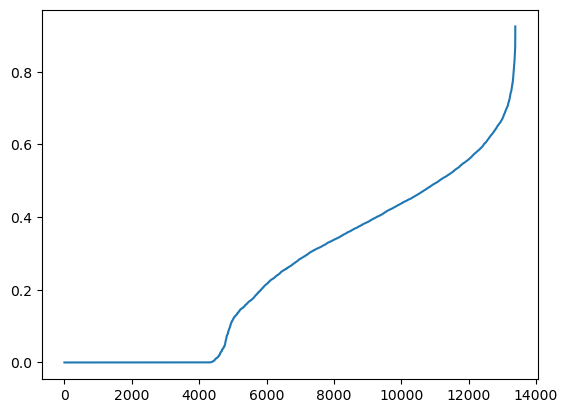

In [234]:
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)

In [236]:
px.line(y = distances, x = range(len(distances)))

In [239]:
print(list(frame_sub.columns))

['id', 'threadId', 'labelIds', 'snippet', 'payload', 'sizeEstimate', 'historyId', 'internalDate', 'headers', 'headers_keys', 'from', 'from_email', 'from_name', 'subject', 'snippet_subject', 'tokenized_text', 'PCAComp0', 'PCAComp1', 'PCAComp2', 'PCAComp3', 'PCAComp4', 'PCAComp5', 'PCAComp6', 'Comp0', 'Comp1', 'Comp2', 'Comp3', 'Comp4', 'Comp5', 'Comp6', 'Comp7', 'Comp8', 'Comp9', 'Comp10', 'Comp11', 'Comp12', 'Comp13', 'Comp14', 'Comp15', 'Comp16', 'Comp17', 'Comp18', 'Comp19', 'Comp20', 'Comp21', 'Comp22', 'Comp23', 'Comp24', 'Comp25', 'Comp26', 'Comp27', 'Comp28', 'Comp29', 'Comp30', 'Comp31', 'Comp32', 'Comp33', 'Comp34', 'Comp35', 'Comp36', 'Comp37', 'Comp38', 'Comp39', 'Comp40', 'Comp41', 'Comp42', 'Comp43', 'Comp44', 'Comp45', 'Comp46', 'Comp47', 'Comp48', 'Comp49', 'Comp50', 'Comp51', 'Comp52', 'Comp53', 'Comp54', 'Comp55', 'Comp56', 'Comp57', 'Comp58', 'Comp59', 'Comp60', 'Comp61', 'Comp62', 'Comp63', 'Comp64', 'Comp65', 'Comp66', 'Comp67', 'Comp68', 'Comp69', 'Comp70', 'Comp71'

In [241]:
frame_sub.shape

(13386, 566)

In [260]:
frame_sub_dedup = frame_sub.drop_duplicates([f"Comp{i}" for i in range(542)])

In [261]:
X_transformed_vt_dedup = frame_sub_dedup[[f"Comp{i}" for i in range(542)]].values

In [262]:
neigh = NearestNeighbors(n_neighbors=2)
nbrs = neigh.fit(X_transformed_vt_dedup)
distances, indices = nbrs.kneighbors(X_transformed_vt_dedup)

distances = np.sort(distances, axis=0)
distances = distances[:,1]

px.line(y = distances, x = range(len(distances)))

In [247]:
distances, indices = nbrs.kneighbors(X_transformed_vt_dedup)

In [254]:
indices[:,1][distances[:,1] == 0]

array([ 2508,    55,    57, ..., 11354, 11354,  1225])

In [258]:
frame_sub_dedup.iloc[5]["snippet_subject"]

'TaxInvoice - KA1192001BZ57235 Hi, Please find attached Tax Invoice for your booking. Thanks and Regards GoIndigo Download IndiGo mobile app now from Apple iPhone Store or Google Play Store &amp; enjoy the hassle free experience on'

In [259]:
frame_sub_dedup.iloc[2508]["snippet_subject"]

'TaxInvoice - MP1192002AK69291 Hi, Please find attached Tax Invoice for your booking. Thanks and Regards GoIndigo Download IndiGo mobile app now from Apple iPhone Store or Google Play Store &amp; enjoy the hassle free experience on'

In [253]:
for elem in distances[:,1] == 0:
    print(elem)

False
False
False
False
False
True
False
False
False
False
False
False
False
False
False
False
False
False
False
False
True
False
False
False
False
False
False
False
False
False
False
False
True
False
False
False
False
True
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
True
True
False
True
False
False
False
False
False
False
False
False
False
True
True
False
False
False
False
False
False
True
False
False
False
False
False
False
False
False
True
False
False
False
False
False
False
True
False
False
False
False
False
False
True
False
False
False
False
False
False
False
False
False
False
False
False
False
False
True
True
True
False
False
False
False
False
False
True
False
False
False
False
False
False
False
False
False
True
False
True
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
True
False
True
False
False
False
False
False
False
False
False
True
False
False
True
False
False
False
False
Fal

In [273]:
for i, v in frame_sub.groupby("from", as_index = False)["id"].nunique().sort_values("id", ascending = False).iterrows():
    print(v)

from    LinkedIn <jobs-noreply@linkedin.com>
id                                       253
Name: 1731, dtype: object
from    Google Calendar <calendar-notification@google....
id                                                    231
Name: 1326, dtype: object
from    Swiggy <no-reply@swiggy.in>
id                              209
Name: 2548, dtype: object
from    Citibank India <Service@india.citi.com>
id                                          184
Name: 960, dtype: object
from    CoinSwitch Kuber <no-reply@coinswitch.co>
id                                            177
Name: 987, dtype: object
from    Kaggle <noreply@kaggle.com>
id                              163
Name: 1649, dtype: object
from    noreply <noreply@actuariesindia.org>
id                                       163
Name: 3077, dtype: object
from    "Amazon.in" <shipment-tracking@amazon.in>
id                                            147
Name: 60, dtype: object
from    Swiggy <alerts@updates.swiggy.in>
id                

In [299]:
for i, v in frame_sub.groupby("from", as_index = False)["id"].nunique().sort_values("id", ascending = False).values:
    print(i,v)

LinkedIn <jobs-noreply@linkedin.com> 253
Google Calendar <calendar-notification@google.com> 231
Swiggy <no-reply@swiggy.in> 209
Citibank India <Service@india.citi.com> 184
CoinSwitch Kuber <no-reply@coinswitch.co> 177
Kaggle <noreply@kaggle.com> 163
noreply <noreply@actuariesindia.org> 163
"Amazon.in" <shipment-tracking@amazon.in> 147
Swiggy <alerts@updates.swiggy.in> 139
NSE-Direct <nse-direct@nse.co.in> 135
Brilliant <notifications@brilliant.org> 133
"ABC – Aditya Birla Money" <adityabirla.money@abm.adityabirlacapital.org> 127
Aayush Agrawal <aagrawal52@gmail.com> 120
Medium Membership <members@medium.com> 109
MakeMyTrip <noreply@makemytrip.com> 105
Spotify <no-reply@spotify.com> 103
Jabong <fashion@crm.jabong.com> 103
Marketing Manager <marketing@actuariesindia.org> 100
Fitbit <noreply@fitbit.com> 92
"Amazon.in" <order-update@amazon.in> 92
notifications_jiofiber@jio.com 91
"BAJAAO.COM" <helpdesk@bajaao.com> 91
ABC - Aditya Birla Money <noreply@abm.adityabirlacapital.org> 89
Citibank

In [301]:
for i, v in frame_sub.groupby("from_email", as_index = False)["id"].nunique().sort_values("id", ascending = False).values:
    print(i,v)

newsletters@mailsupplies.in 313
jobs-noreply@linkedin.com 253
info@sacustomerdelight.co.in 252
no-reply@swiggy.in 236
calendar-notification@google.com 231
no-reply@coinswitch.co 194
Service@india.citi.com 184
alerts@updates.swiggy.in 175
noreply@kaggle.com 163
noreply@actuariesindia.org 163
noreply@abm.adityabirlacapital.org 157
shipment-tracking@amazon.in 147
apps+zj4ocfo4jo06@facebookappmail.com 140
nse-direct@nse.co.in 139
newsletter@businessmint.com 135
notifications@brilliant.org 133
adityabirla.money@abm.adityabirlacapital.org 127
aagrawal52@gmail.com 121
newsletters@backendmails.com 118
members@medium.com 110
noreply@makemytrip.com 105
fashion@crm.jabong.com 104
hello@mailerassist.com 104
no-reply@spotify.com 103
newsletters@kinkroot.com 100
marketing@actuariesindia.org 100
helpdesk@bajaao.com 97
order-update@amazon.in 97
noreply@fitbit.com 93
notification@trigen.in 93
noreply-local-guides@google.com 91
newsletters@brandshop.co.in 91
noreply@zomato.com 88
net.statement@citicorp.

In [302]:
l = []
for i, v in frame_sub.groupby("from_email", as_index = False)["id"].nunique().sort_values("id", ascending = False).values:
    if v >= 6:
        l.append(i)
l

['newsletters@mailsupplies.in',
 'jobs-noreply@linkedin.com',
 'info@sacustomerdelight.co.in',
 'no-reply@swiggy.in',
 'calendar-notification@google.com',
 'no-reply@coinswitch.co',
 'Service@india.citi.com',
 'alerts@updates.swiggy.in',
 'noreply@kaggle.com',
 'noreply@actuariesindia.org',
 'noreply@abm.adityabirlacapital.org',
 'shipment-tracking@amazon.in',
 'apps+zj4ocfo4jo06@facebookappmail.com',
 'nse-direct@nse.co.in',
 'newsletter@businessmint.com',
 'notifications@brilliant.org',
 'adityabirla.money@abm.adityabirlacapital.org',
 'aagrawal52@gmail.com',
 'newsletters@backendmails.com',
 'members@medium.com',
 'noreply@makemytrip.com',
 'fashion@crm.jabong.com',
 'hello@mailerassist.com',
 'no-reply@spotify.com',
 'newsletters@kinkroot.com',
 'marketing@actuariesindia.org',
 'helpdesk@bajaao.com',
 'order-update@amazon.in',
 'noreply@fitbit.com',
 'notification@trigen.in',
 'noreply-local-guides@google.com',
 'newsletters@brandshop.co.in',
 'noreply@zomato.com',
 'net.statement@

In [314]:
m = []
for elem in l:
    print(elem)
    print(elem.split("@")[0])
    print(elem.split("@")[1])
    print(elem.split("@")[1].split(".")[1])
    m.append([elem.split("@")[0], ".".join(elem.split("@")[1].split(".")[:-1]), elem.split("@")[1].split(".")[-1]])
    print("---")

newsletters@mailsupplies.in
newsletters
mailsupplies.in
in
---
jobs-noreply@linkedin.com
jobs-noreply
linkedin.com
com
---
info@sacustomerdelight.co.in
info
sacustomerdelight.co.in
co
---
no-reply@swiggy.in
no-reply
swiggy.in
in
---
calendar-notification@google.com
calendar-notification
google.com
com
---
no-reply@coinswitch.co
no-reply
coinswitch.co
co
---
Service@india.citi.com
Service
india.citi.com
citi
---
alerts@updates.swiggy.in
alerts
updates.swiggy.in
swiggy
---
noreply@kaggle.com
noreply
kaggle.com
com
---
noreply@actuariesindia.org
noreply
actuariesindia.org
org
---
noreply@abm.adityabirlacapital.org
noreply
abm.adityabirlacapital.org
adityabirlacapital
---
shipment-tracking@amazon.in
shipment-tracking
amazon.in
in
---
apps+zj4ocfo4jo06@facebookappmail.com
apps+zj4ocfo4jo06
facebookappmail.com
com
---
nse-direct@nse.co.in
nse-direct
nse.co.in
co
---
newsletter@businessmint.com
newsletter
businessmint.com
com
---
notifications@brilliant.org
notifications
brilliant.org
org
---

In [315]:
m

[['newsletters', 'mailsupplies', 'in'],
 ['jobs-noreply', 'linkedin', 'com'],
 ['info', 'sacustomerdelight.co', 'in'],
 ['no-reply', 'swiggy', 'in'],
 ['calendar-notification', 'google', 'com'],
 ['no-reply', 'coinswitch', 'co'],
 ['Service', 'india.citi', 'com'],
 ['alerts', 'updates.swiggy', 'in'],
 ['noreply', 'kaggle', 'com'],
 ['noreply', 'actuariesindia', 'org'],
 ['noreply', 'abm.adityabirlacapital', 'org'],
 ['shipment-tracking', 'amazon', 'in'],
 ['apps+zj4ocfo4jo06', 'facebookappmail', 'com'],
 ['nse-direct', 'nse.co', 'in'],
 ['newsletter', 'businessmint', 'com'],
 ['notifications', 'brilliant', 'org'],
 ['adityabirla.money', 'abm.adityabirlacapital', 'org'],
 ['aagrawal52', 'gmail', 'com'],
 ['newsletters', 'backendmails', 'com'],
 ['members', 'medium', 'com'],
 ['noreply', 'makemytrip', 'com'],
 ['fashion', 'crm.jabong', 'com'],
 ['hello', 'mailerassist', 'com'],
 ['no-reply', 'spotify', 'com'],
 ['newsletters', 'kinkroot', 'com'],
 ['marketing', 'actuariesindia', 'org'],


In [316]:
def identity_tokenizer(text):
    return text

tfidf1 = TfidfVectorizer(tokenizer=identity_tokenizer, lowercase=False)    
email_tfidf = tfidf1.fit_transform(m)

tfidf1.get_feature_names()

['022subhadip',
 '160by2mail',
 '91digisales',
 'AmazonPay-balance',
 'CRA',
 'DONOTREPLY',
 'EA',
 'ED',
 'JioTV',
 'Rahul',
 'Samarth.Gupta',
 'Service',
 'Sony',
 'Tatasky',
 'aagrawal52',
 'abha.tiwari2010',
 'abm.adityabirlacapital',
 'acadaff',
 'academic.marketing.india',
 'access',
 'account-security-noreply',
 'account-update',
 'accountprotection.microsoft',
 'actuariesindia',
 'adisportsonline',
 'adityabirla.money',
 'admin',
 'admin.ox.ac',
 'admissions',
 'admissions.clsbe',
 'admissions.mitsloan',
 'admissionsupport',
 'advocat-in.puma',
 'ai',
 'alert',
 'alerts',
 'alerts.11xi',
 'alerts.indwealth',
 'alphonso',
 'amazon',
 'ananya_pari03',
 'angel',
 'anilkghosh',
 'anish.sarkar',
 'announcements.indwealth',
 'antar',
 'apartmentadda',
 'apl.cs',
 'appconapps',
 'appleid',
 'apps+zj4ocfo4jo06',
 'appsheet',
 'appstore',
 'ashisi',
 'athreya',
 'audible',
 'auquan',
 'ayanendranath.basu',
 'babson',
 'backendmails',
 'bajaao',
 'biz',
 'brand',
 'brandshop.co',
 'brill

In [319]:
neigh = NearestNeighbors(n_neighbors=2)
nbrs = neigh.fit(email_tfidf)
distances, indices = nbrs.kneighbors(email_tfidf)

distances = np.sort(distances, axis=0)
distances = distances[:,1]

px.line(y = distances, x = range(len(distances)))

In [335]:
from sklearn.cluster import DBSCAN
clustering = DBSCAN(eps=1.32, min_samples=2).fit(email_tfidf)
clustering.labels_

array([ 0,  1,  2,  2,  3,  2,  4,  5,  2,  2,  2,  6, -1,  5,  2,  2,  2,
        7,  0, -1,  2, -1,  2,  2,  0,  2, -1,  6,  2,  8,  3,  0,  2, -1,
       -1,  2,  2,  2,  9,  1,  2,  2,  2, -1, 10,  1,  2,  0,  0,  2, -1,
        2,  2,  2,  2, -1, 11, -1,  5,  2, 12,  6, -1, 13,  2,  2, -1,  2,
        8,  2, 14, 15,  5,  2, 16,  7, -1,  7, -1, -1,  2,  1, -1,  2,  2,
        2, -1,  2, -1,  1,  2,  2,  2,  2,  2,  9,  2, 10, -1,  2,  2,  3,
        9,  2,  2, -1,  2, 17,  2, -1,  3, 18,  2,  2,  0,  7,  2, 19, -1,
        2, 14,  7,  0,  2,  9, -1, -1,  2, 13, -1, 14,  2, 13,  2,  2, 20,
       19,  2, -1, 13,  2, 13, 20, -1,  2,  2,  2,  2, 21, 11, -1,  2,  6,
       -1, 15,  2,  2, -1,  2,  3,  2,  7, -1,  7,  2, -1,  2,  2,  2,  7,
        2,  2, -1,  1,  2,  2,  2,  2,  2,  2,  2, 19,  3,  2,  2, 16, -1,
        6, 13, -1,  2,  2, -1, 17, -1,  2,  3, 13, -1,  0, 22, -1,  4, -1,
        2,  2,  7, -1, -1, 17, -1,  7, 13, -1,  6,  9, -1,  7, 14,  2, -1,
       13,  2,  2,  9,  2

In [336]:
for elem in set(clustering.labels_):
    print(elem)
    print(np.array(l)[clustering.labels_ == elem])

0
['newsletters@mailsupplies.in' 'newsletters@backendmails.com'
 'newsletters@kinkroot.com' 'newsletters@brandshop.co.in'
 'newsletters@prasscross.com' 'newsletters@educationation.pro'
 'newsletters@buzz-india.com' 'newsletters@smtpmailbox.com'
 'newsletters@shopatbest.com' 'newsletters@lapnikmail.com']
1
['jobs-noreply@linkedin.com' 'messaging-digest-noreply@linkedin.com'
 'inmail-hit-reply@linkedin.com' 'jobs-listings@linkedin.com'
 'hit-reply@linkedin.com' 'invitations@linkedin.com'
 'notifications-noreply@linkedin.com']
2
['info@sacustomerdelight.co.in' 'no-reply@swiggy.in'
 'no-reply@coinswitch.co' 'noreply@kaggle.com'
 'noreply@actuariesindia.org' 'noreply@abm.adityabirlacapital.org'
 'newsletter@businessmint.com' 'notifications@brilliant.org'
 'adityabirla.money@abm.adityabirlacapital.org' 'noreply@makemytrip.com'
 'hello@mailerassist.com' 'no-reply@spotify.com'
 'marketing@actuariesindia.org' 'noreply@fitbit.com' 'noreply@zomato.com'
 'no-reply@m.mail.coursera.org' 'info@newsle

In [ ]:
cluster_dict = {}
for elem in set(clustering.labels_):
    cluster_dict[elem] = frame_sub[clustering.labels_ == elem]["from"].shape[0]
cluster_dict

In [ ]:
from sklearn.feature_selection import VarianceThreshold
selector = VarianceThreshold(threshold=400e-6)
X_transformed_vt = selector.fit_transform(X_transformed)

temp = pd.Series(selector.variances_.reshape(-1,).tolist(), index = tfidf.get_feature_names(), name="Variance").reset_index()
px.box(temp, y = "Variance", hover_data=["index"], points="all")

X_transformed.shape

In [294]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))



import os.path

from google.auth.transport.requests import Request
from google.oauth2.credentials import Credentials
from google_auth_oauthlib.flow import InstalledAppFlow
from googleapiclient.discovery import build
from googleapiclient.errors import HttpError

# If modifying these scopes, delete the file token.json.
SCOPES = ['https://www.googleapis.com/auth/gmail.modify']

creds = None

if os.path.exists('token.json'):
    creds = Credentials.from_authorized_user_file('token.json', SCOPES)

service = build('gmail', 'v1', credentials=creds)

In [295]:
results = service.users().messages().list(userId='me', maxResults=500, labelIds=['INBOX'], q = "from:(care@easemytrip.com)").execute()
results

{'messages': [{'id': '156e185c51463696', 'threadId': '156e185c51463696'},
  {'id': '156e18570e690f50', 'threadId': '156e17ee3c3900f4'},
  {'id': '156e1841f9a14b8e', 'threadId': '156e1841f9a14b8e'},
  {'id': '156e17f2b9d169d8', 'threadId': '156e17f2b9d169d8'},
  {'id': '156e17ee3c3900f4', 'threadId': '156e17ee3c3900f4'},
  {'id': '156e17d230e85fbd', 'threadId': '156e17d230e85fbd'}],
 'resultSizeEstimate': 6}

In [296]:
service.users().messages().get(userId = "me", id = "156e185c51463696").execute()

{'id': '156e185c51463696',
 'threadId': '156e185c51463696',
 'labelIds': ['IMPORTANT', 'CATEGORY_UPDATES', 'INBOX'],
 'snippet': 'Dear aagrawal52@gmail.com, Kindly find your e-ticket attached with this email. Booking Date: Wed , 31 Aug 2016 | Booking Time: 22:26 Hi , Your flight ticket for Bangalore-Pune is confirm Your ticket is',
 'payload': {'partId': '',
  'mimeType': 'multipart/mixed',
  'filename': '',
  'headers': [{'name': 'Delivered-To', 'value': 'aagrawal52@gmail.com'},
   {'name': 'Received',
    'value': 'by 10.157.37.4 with SMTP id k4csp394216otb;        Wed, 31 Aug 2016 09:54:15 -0700 (PDT)'},
   {'name': 'X-Received',
    'value': 'by 10.237.56.170 with SMTP id k39mr11565009qte.138.1472662455621;        Wed, 31 Aug 2016 09:54:15 -0700 (PDT)'},
   {'name': 'Return-Path',
    'value': '<14725818029966593-9068-0-gmail.com@bounce.emt.easemytrip.com>'},
   {'name': 'Received',
    'value': 'from 101.emt.easemytrip.com (101.emt.easemytrip.com. [103.52.181.101])        by mx.go

In [297]:
service.users().messages().modify(userId='me', id="156e185c51463696", body={'addLabelIds': ['TRASH']}).execute()

{'id': '156e185c51463696',
 'threadId': '156e185c51463696',
 'labelIds': ['IMPORTANT', 'TRASH', 'CATEGORY_UPDATES']}

In [279]:
results = service.users().labels().list(userId='me').execute()
results

{'labels': [{'id': 'CHAT',
   'name': 'CHAT',
   'messageListVisibility': 'hide',
   'labelListVisibility': 'labelHide',
   'type': 'system'},
  {'id': 'SENT',
   'name': 'SENT',
   'messageListVisibility': 'hide',
   'labelListVisibility': 'labelShow',
   'type': 'system'},
  {'id': 'INBOX',
   'name': 'INBOX',
   'messageListVisibility': 'hide',
   'labelListVisibility': 'labelShow',
   'type': 'system'},
  {'id': 'IMPORTANT',
   'name': 'IMPORTANT',
   'messageListVisibility': 'hide',
   'labelListVisibility': 'labelShow',
   'type': 'system'},
  {'id': 'TRASH',
   'name': 'TRASH',
   'messageListVisibility': 'hide',
   'labelListVisibility': 'labelHide',
   'type': 'system'},
  {'id': 'DRAFT',
   'name': 'DRAFT',
   'messageListVisibility': 'hide',
   'labelListVisibility': 'labelShow',
   'type': 'system'},
  {'id': 'SPAM',
   'name': 'SPAM',
   'messageListVisibility': 'hide',
   'labelListVisibility': 'labelHide',
   'type': 'system'},
  {'id': 'CATEGORY_FORUMS', 'name': 'CATEGO

In [ ]:
1. Distance based on 